<a href="https://colab.research.google.com/github/PedroBVidal/t5_visao/blob/main/NN_scratch_irirs_TA05.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

MULTI-LAYER PERCEPTRON FROM SCRATCH
Adapted from original notebook from Vítor Gama Lemos

[kaggle-notebook](https://www.kaggle.com/code/vitorgamalemos/multilayer-perceptron-from-scratch)


In [ ]:
import random
import seaborn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm

seaborn.set(style='whitegrid'); seaborn.set_context('talk')
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

from sklearn.datasets import load_iris
iris_data = load_iris()

In [ ]:
print(iris_data['DESCR'])

.. _iris_dataset:

Iris plants dataset
--------------------

**Data Set Characteristics:**

:Number of Instances: 150 (50 in each of three classes)
:Number of Attributes: 4 numeric, predictive attributes and the class
:Attribute Information:
    - sepal length in cm
    - sepal width in cm
    - petal length in cm
    - petal width in cm
    - class:
            - Iris-Setosa
            - Iris-Versicolour
            - Iris-Virginica

:Summary Statistics:

============== ==== ==== ======= ===== ====================
                Min  Max   Mean    SD   Class Correlation
============== ==== ==== ======= ===== ====================
sepal length:   4.3  7.9   5.84   0.83    0.7826
sepal width:    2.0  4.4   3.05   0.43   -0.4194
petal length:   1.0  6.9   3.76   1.76    0.9490  (high!)
petal width:    0.1  2.5   1.20   0.76    0.9565  (high!)
============== ==== ==== ======= ===== ====================

:Missing Attribute Values: None
:Class Distribution: 33.3% for each of 3 classes.
:Cr

{'data': array([[5.1, 3.5, 1.4, 0.2],
       [4.9, 3. , 1.4, 0.2],
       [4.7, 3.2, 1.3, 0.2],
       [4.6, 3.1, 1.5, 0.2],
       [5. , 3.6, 1.4, 0.2],
       [5.4, 3.9, 1.7, 0.4],
       [4.6, 3.4, 1.4, 0.3],
       [5. , 3.4, 1.5, 0.2],
       [4.4, 2.9, 1.4, 0.2],
       [4.9, 3.1, 1.5, 0.1],
       [5.4, 3.7, 1.5, 0.2],
       [4.8, 3.4, 1.6, 0.2],
       [4.8, 3. , 1.4, 0.1],
       [4.3, 3. , 1.1, 0.1],
       [5.8, 4. , 1.2, 0.2],
       [5.7, 4.4, 1.5, 0.4],
       [5.4, 3.9, 1.3, 0.4],
       [5.1, 3.5, 1.4, 0.3],
       [5.7, 3.8, 1.7, 0.3],
       [5.1, 3.8, 1.5, 0.3],
       [5.4, 3.4, 1.7, 0.2],
       [5.1, 3.7, 1.5, 0.4],
       [4.6, 3.6, 1. , 0.2],
       [5.1, 3.3, 1.7, 0.5],
       [4.8, 3.4, 1.9, 0.2],
       [5. , 3. , 1.6, 0.2],
       [5. , 3.4, 1.6, 0.4],
       [5.2, 3.5, 1.5, 0.2],
       [5.2, 3.4, 1.4, 0.2],
       [4.7, 3.2, 1.6, 0.2],
       [4.8, 3.1, 1.6, 0.2],
       [5.4, 3.4, 1.5, 0.4],
       [5.2, 4.1, 1.5, 0.1],
       [5.5, 4.2, 1.4, 0.2],
     

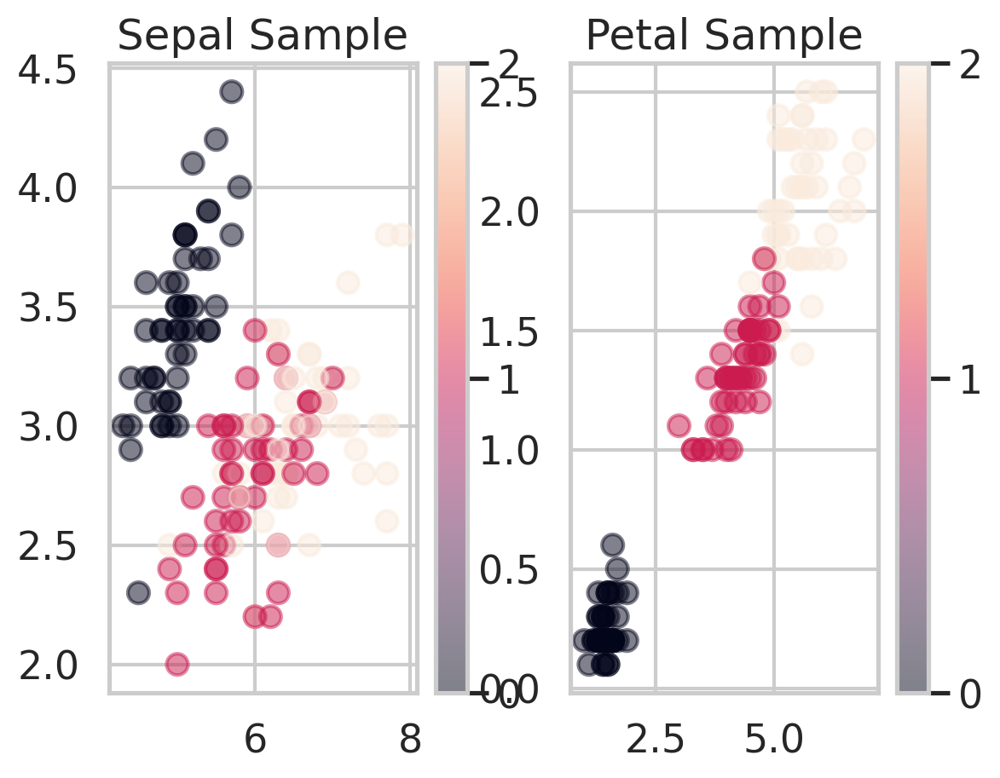

In [ ]:
n_samples, n_features = iris_data.data.shape

print(iris_data)

p = np.random.permutation(len(iris_data.data))

print(p)

iris_data.data, iris_data.target = iris_data.data[p], iris_data.target[p]


print(f"Number of samples: {n_samples}")
print(f"Number of features: {n_features} \n")

plt.subplot(1, 2, 1)
scatter_plot = plt.scatter(iris_data.data[:,0], iris_data.data[:,1], alpha=0.5,
                           c=iris_data.target)
plt.colorbar(ticks=([0, 1, 2]))
plt.title('Sepal Sample');

plt.subplot(1, 2, 2)
scatter_plot_2 = plt.scatter(iris_data.data[:,2], iris_data.data[:,3], alpha=0.5,
                           c=iris_data.target)
plt.colorbar(ticks=([0, 1, 2]))
plt.title('Petal Sample');


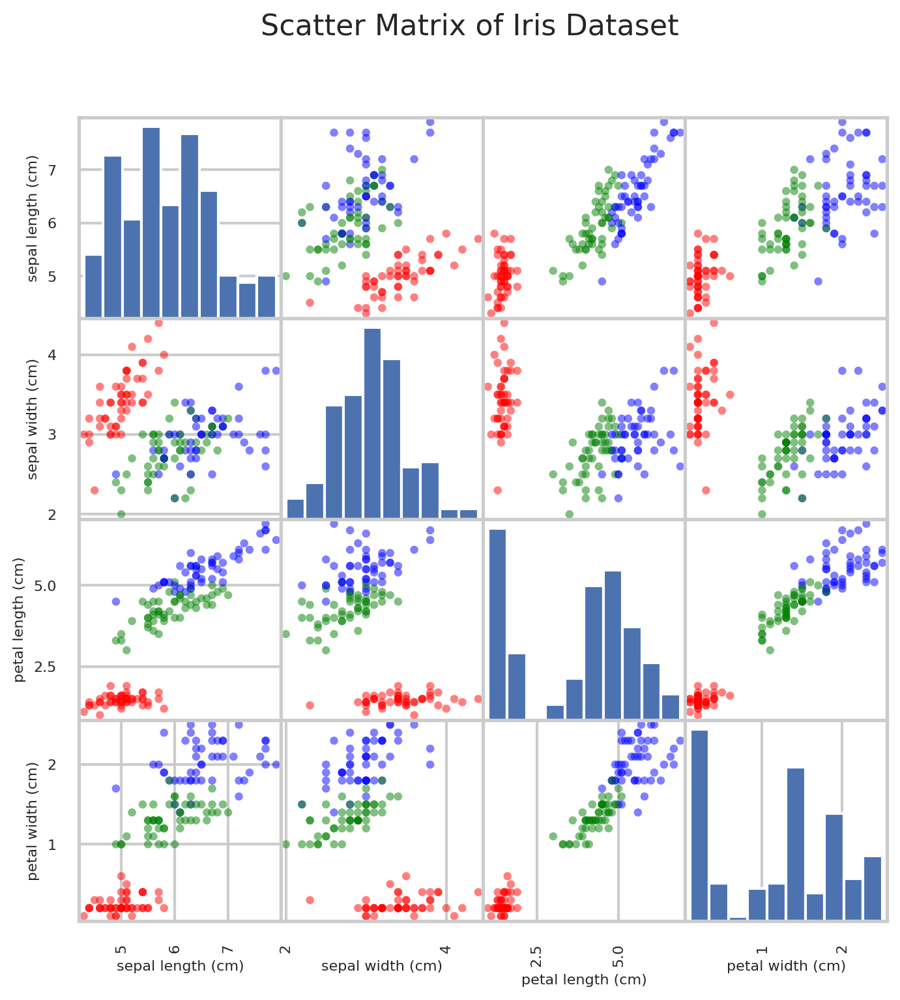

In [ ]:
import pandas
from pandas.plotting import scatter_matrix


# Cria um DataFrame com os dados e os nomes das colunas
df = pd.DataFrame(iris_data.data, columns=iris_data.feature_names)
df['target'] = iris_data.target

# Mapeia os números das classes para nomes legíveis
target_names = iris_data.target_names
df['target_name'] = df['target'].apply(lambda i: target_names[i])

# Escolhe uma paleta de cores
colors = {'setosa': 'red', 'versicolor': 'green', 'virginica': 'blue'}
df['color'] = df['target_name'].map(colors)

# Gera o scatter_matrix
axes = scatter_matrix(df[iris_data.feature_names],
               figsize=(8, 8),
               diagonal='hist',
               color=df['color'],
               alpha=0.5)

# Reduz o tamanho da fonte dos rótulos dos eixos
for ax in axes.ravel():
    ax.set_xlabel(ax.get_xlabel(), fontsize=8)
    ax.set_ylabel(ax.get_ylabel(), fontsize=8)

plt.suptitle("Scatter Matrix of Iris Dataset", fontsize=16)
plt.show()

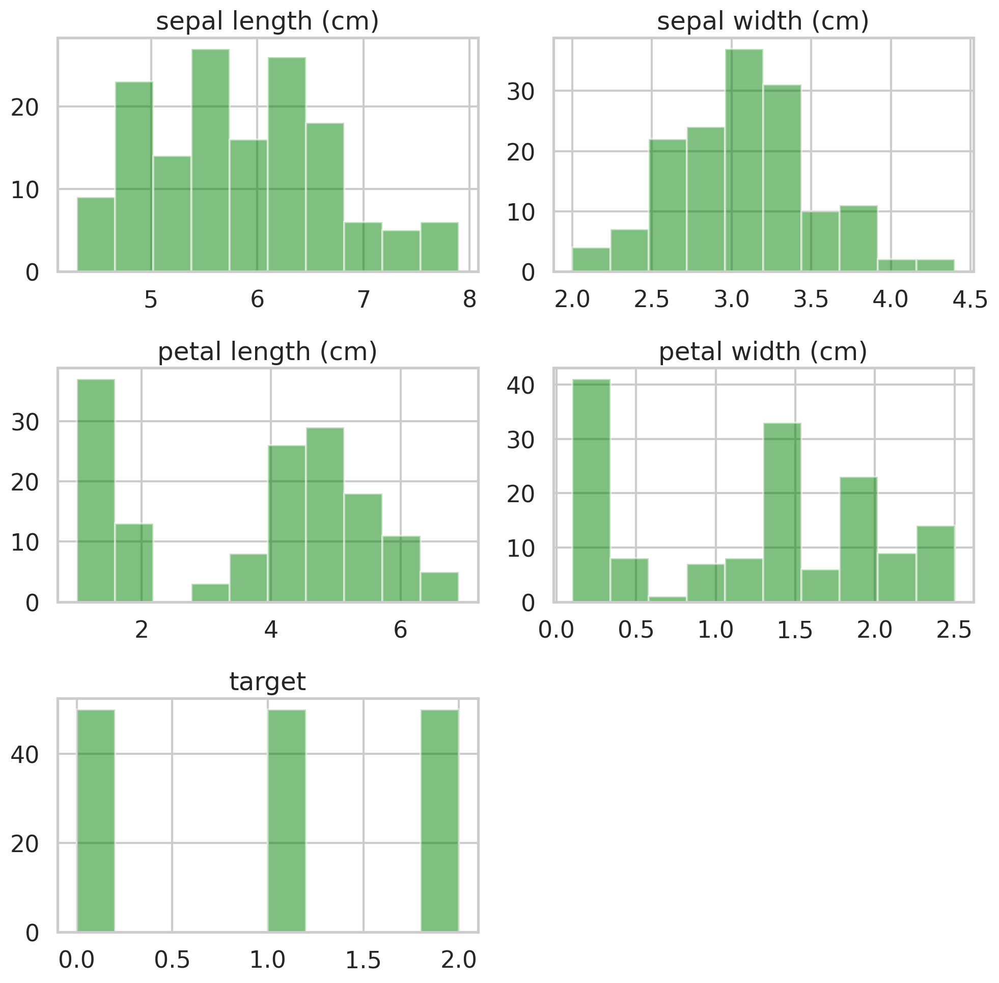

In [ ]:
axes = df.hist(alpha=0.5, figsize=(10, 10), color='green')

plt.tight_layout()
plt.show()

In [ ]:
import numpy as np
import random
from sklearn.model_selection import train_test_split
from sklearn.datasets import load_iris

# Load the Iris dataset
#iris_data = load_iris()
# Join features and labels into a single array
iris_dataset = np.column_stack((iris_data.data, iris_data.target.T))  # shape (150, 5)

cont_zero = cont_one = cont_two = 0
for i in iris_dataset:
  if (i[4] == 0):
    cont_zero += 1
  elif (i[4] == 1):
    cont_one += 1
  elif (i[4] == 2):
    cont_two += 1

print(cont_zero,cont_one,cont_two)

# Shuffle the dataset (optional: for reproducibility)
#random.seed(123)
#random.shuffle(iris_dataset)

cont_zero = cont_one = cont_two = 0
for i in iris_dataset:
  if (i[4] == 0):
    cont_zero += 1
  elif (i[4] == 1):
    cont_one += 1
  elif (i[4] == 2):
    cont_two += 1

print(cont_zero,cont_one,cont_two)

# Split features (X) and labels (y)
X = np.array([i[:4] for i in iris_dataset])  # shape (150, 4)
y = np.array([i[4] for i in iris_dataset])   # shape (150,)

# Use train_test_split to divide into 80% train, 20% test
train_X, test_X, train_y, test_y = train_test_split(
    X, y,
    test_size=0.3,
    random_state=11,  # set for reproducibility
    stratify=y        # keep label proportions balanced
)

# Now you have train_X, train_y, test_X, test_y ready

print(test_y)

50 50 50
50 50 50
[0. 0. 0. 1. 0. 2. 2. 2. 1. 2. 1. 1. 1. 2. 1. 0. 0. 2. 1. 1. 0. 0. 0. 0.
 0. 2. 0. 1. 2. 1. 2. 2. 1. 0. 0. 1. 2. 1. 2. 2. 1. 2. 2. 0. 1.]


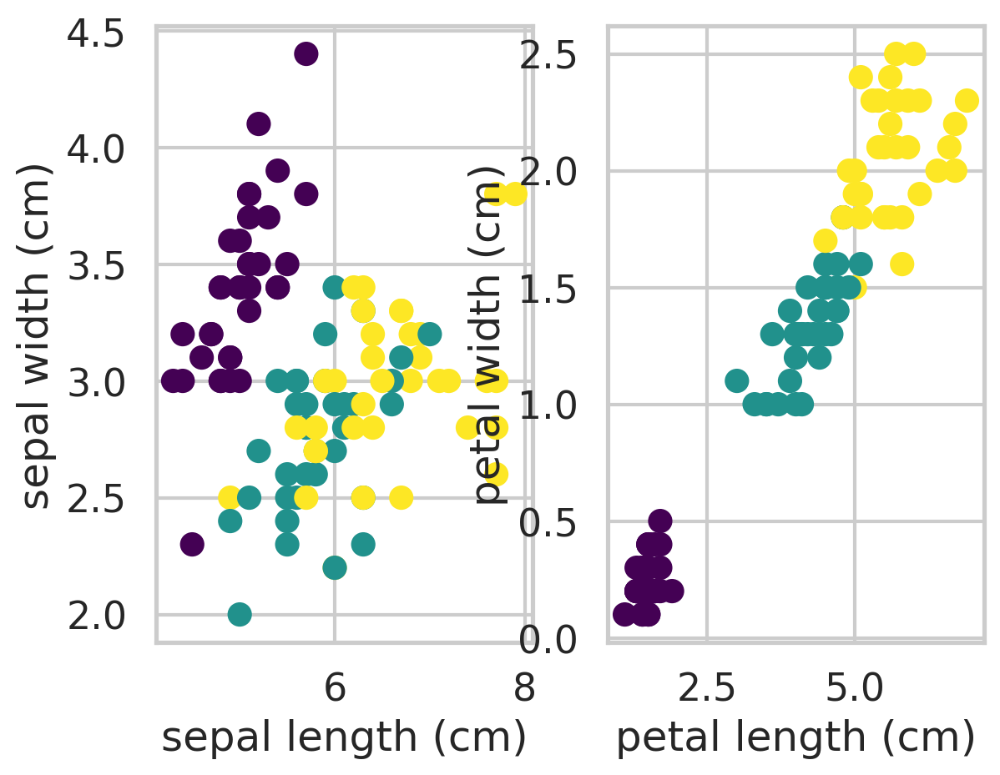

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm

# Plot training Samples

plt.subplot(1, 2, 1)
plt.scatter(train_X[:,0],train_X[:,1],c=train_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[0])
plt.ylabel(iris_data.feature_names[1])

plt.subplot(1, 2, 2)
plt.scatter(train_X[:,2],train_X[:,3],c=train_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[2])
plt.ylabel(iris_data.feature_names[3]);

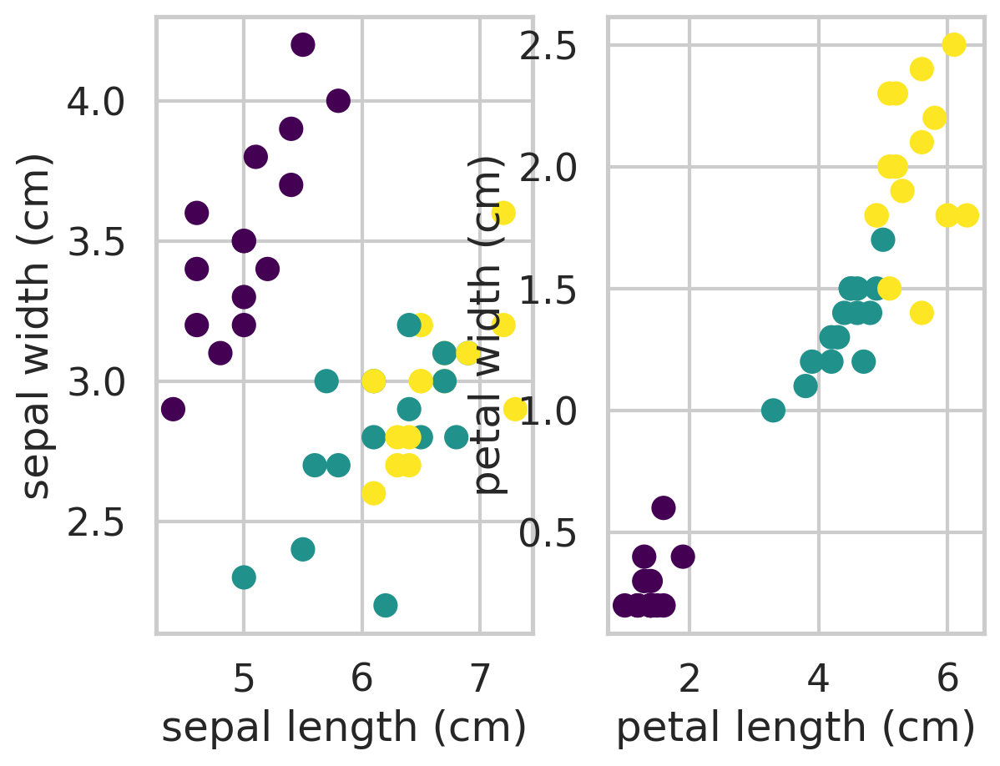

In [ ]:
# Plot test samples
plt.subplot(1, 2, 1)
plt.scatter(test_X[:,0],test_X[:,1],c=test_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[0])
plt.ylabel(iris_data.feature_names[1])

plt.subplot(1, 2, 2)
plt.scatter(test_X[:,2],test_X[:,3],c=test_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[2])
plt.ylabel(iris_data.feature_names[3]);

In [ ]:
# Implementation the Multilayer Perceptron in Python
from sklearn.base import BaseEstimator, ClassifierMixin, RegressorMixin
import random
import numpy as np
import matplotlib.pyplot as plt

class MultiLayerPerceptron(BaseEstimator, ClassifierMixin):

    def __init__(self, params=None):
        # Store the params argument to satisfy BaseEstimator requirements
        self.params = params
        if (params == None):
            self.inputLayer = 4                        # Input Layer
            self.hiddenLayer = 5                       # Hidden Layer
            self.outputLayer = 3                       # Outpuy Layer
            self.learningRate = 0.005                  # Learning rate
            self.max_epochs = 600                      # Epochs
            self.iasHiddenValue = -1                   # Bias HiddenLayer
            self.BiasOutputValue = -1                  # Bias OutputLayer
            self.activation = self.ativacao['sigmoid'] # Activation function
            self.deriv = self.derivada['sigmoid']
        else:
            self.inputLayer = params['InputLayer']
            self.hiddenLayer = params['HiddenLayer']
            self.outputLayer = params['OutputLayer']
            self.learningRate = params['LearningRate']
            self.max_epochs = params['Epocas']
            self.BiasHiddenValue = params['BiasHiddenValue']
            self.BiasOutputValue = params['BiasOutputValue']
            self.activation = self.ativacao[params['ActivationFunction']]
            self.deriv = self.derivada[params['ActivationFunction']]

        # Starting Bias and Weights
        # assign ramdom values [-1 .. +1] in order to start with some weights
        # not so symmetric
        # Weight initialization: passing correct arguments to starting_weights
        self.WEIGHT_hidden = self.starting_weights(self.inputLayer, self.hiddenLayer)
        self.WEIGHT_output = self.starting_weights(self.hiddenLayer, self.outputLayer)

        self.BIAS_hidden = np.array([self.BiasHiddenValue for i in range(self.hiddenLayer)])
        self.BIAS_output = np.array([self.BiasOutputValue for i in range(self.outputLayer)]) # Corrected attribute name
        self.classes_number = 3

    pass

    # This function creates a 2D matrix of random values between -1 and +1
    # Shape: rows x columns
    def starting_weights(self, rows, columns):
        random.seed(522)
        return [[2  * random.random() - 1 for _ in range(columns)] for _ in range(rows)]

    ativacao = {
         'sigmoid': (lambda x: 1/(1 + np.exp(-x))),
            'tanh': (lambda x: np.tanh(x)),
            'Relu': (lambda x: x*(x > 0)),
               }
    derivada = {
         'sigmoid': (lambda x: x*(1-x)),
            'tanh': (lambda x: 1-x**2),
            'Relu': (lambda x: 1 * (x>0))
               }

    # This calculates the error at the output layer and then propagates it
    # backward through the network to update the weights in each layer
    def Backpropagation_Algorithm(self, x):
        DELTA_output = []
        # Stage 1 - Error: OutputLayer (target - predicted)
        ERROR_output = self.output - self.OUTPUT_L2
        DELTA_output = ((-1)*(ERROR_output) * self.deriv(self.OUTPUT_L2))

        arrayStore = []
        # Stage 2 - Update weights OutputLayer and HiddenLayer
        for i in range(self.hiddenLayer):
            for j in range(self.outputLayer): # Corrected attribute name
                self.WEIGHT_output[i][j] -= (self.learningRate * (DELTA_output[j] * self.OUTPUT_L1[i]))
                self.BIAS_output[j] -= (self.learningRate * DELTA_output[j])

        # Stage 3 - Error: HiddenLayer
        delta_hidden = np.matmul(self.WEIGHT_output, DELTA_output)* self.deriv(self.OUTPUT_L1)

        # Stage 4 - Update weights HiddenLayer and InputLayer(x)
        for i in range(self.inputLayer):
            for j in range(self.hiddenLayer):
                self.WEIGHT_hidden[i][j] -= (self.learningRate * (delta_hidden[j] * x[i]))
                self.BIAS_hidden[j] -= (self.learningRate * delta_hidden[j])



    def show_err_graphic(self,v_erro,v_erro_test, v_epoca):
        plt.figure(figsize=(9,4))
        plt.plot(v_epoca, v_erro, color="b", marker=11)
        plt.plot(v_epoca, v_erro_test, color="g", marker=11)
        plt.legend(['train','test'])
        plt.xlabel("Number of Epochs")
        plt.ylabel("Squared error (MSE) ");
        plt.title("Error Minimization")
        plt.show()

    def show_acc_graphic(self,hits_train,hits_test, v_epoca):
      plt.figure(figsize=(9,4))
      plt.plot(v_epoca, hits_train, color="b", marker=11, label="train")
      plt.plot(v_epoca, hits_test, color="g", marker=11, label="test")
      max_hits_test = max(hits_test)
      plt.legend(['train','test'])
      plt.xlabel("Number of Epochs")
      plt.ylabel("Acc");
      plt.title("Acurracy")
      plt.show()
      return max_hits_test

    def predict(self, X, y):
        'Returns the predictions for every element of X'
        my_predictions = []
        'Forward Propagation'
        forward = np.matmul(X,self.WEIGHT_hidden) + self.BIAS_hidden
        forward = np.matmul(forward, self.WEIGHT_output) + self.BIAS_output
        for i in forward:
            my_predictions.append(max(enumerate(i), key=lambda x:x[1])[0])

        array_score = []
        for i in range(len(my_predictions)):
            if my_predictions[i] == 0:
                array_score.append([i, 'Iris-setosa', my_predictions[i], y[i]])
            elif my_predictions[i] == 1:
                 array_score.append([i, 'Iris-versicolour', my_predictions[i], y[i]])
            elif my_predictions[i] == 2:
                 array_score.append([i, 'Iris-virginica', my_predictions[i], y[i]])

        dataframe = pd.DataFrame(array_score, columns=['_id', 'class', 'output', 'hoped_output'])
        return my_predictions, dataframe

    def fit(self, X, y, X_test, y_test):
        count_epoch = 1
        total_error = 0
        total_error_test = 0
        n = len(X);
        n_test = len(X_test)
        epoch_array = []
        error_array = []
        error_array_test = []
        # Initialize lists to store specific weight values for plotting
        weight_over_epochs_W0_plot = []
        weight_over_epochs_W1_plot = []

        hits_list_test = []
        hits_list_train = []

        while(count_epoch <= self.max_epochs):

            for idx,inputs in enumerate(X_test):
              self.output = np.zeros(self.classes_number)
              'Stage 1 - (Forward Propagation)'
              self.OUTPUT_L1 = self.activation((np.dot(inputs, self.WEIGHT_hidden) + self.BIAS_hidden))
              self.OUTPUT_L2 = self.activation((np.dot(self.OUTPUT_L1, self.WEIGHT_output) + self.BIAS_output))
              'Stage 2 - One-Hot-Encoding'
              if(y_test[idx] == 0):
                  self.output = np.array([1,0,0]) #Class1 {1,0,0}
              elif(y_test[idx] == 1):
                  self.output = np.array([0,1,0]) #Class2 {0,1,0}
              elif(y_test[idx] == 2):
                  self.output = np.array([0,0,1]) #Class3 {0,0,1}

              square_error = 0
              for i in range(self.outputLayer):
                  erro = (self.output[i] - self.OUTPUT_L2[i])**2
                  square_error = (square_error + (0.05 * erro))
                  total_error_test = total_error_test + square_error


            for idx,inputs in enumerate(X):
                self.output = np.zeros(self.classes_number)
                'Stage 1 - (Forward Propagation)'
                self.OUTPUT_L1 = self.activation((np.dot(inputs, self.WEIGHT_hidden) + self.BIAS_hidden))
                self.OUTPUT_L2 = self.activation((np.dot(self.OUTPUT_L1, self.WEIGHT_output) + self.BIAS_output))
                'Stage 2 - One-Hot-Encoding'
                if(y[idx] == 0):
                    self.output = np.array([1,0,0]) #Class1 {1,0,0}
                elif(y[idx] == 1):
                    self.output = np.array([0,1,0]) #Class2 {0,1,0}
                elif(y[idx] == 2):
                    self.output = np.array([0,0,1]) #Class3 {0,0,1}

                square_error = 0
                for i in range(self.outputLayer):
                    erro = (self.output[i] - self.OUTPUT_L2[i])**2
                    square_error = (square_error + (0.05 * erro))
                    total_error = total_error + square_error

                'Backpropagation : Update Weights'
                self.Backpropagation_Algorithm(inputs)

            # The original code calculates total_error per batch, then divides by n (number of samples).
            # It's more standard to calculate the mean squared error per epoch by summing errors over
            # all samples in the epoch and then dividing by the number of output neurons.
            # Keeping the original logic for total_error calculation, but this is not
            # a standard MSE calculation.
            total_error = (total_error / n)
            total_error_test = (total_error_test / n_test)
            if((count_epoch % 50 == 0)or(count_epoch == 1)):
                print("Epoch ", count_epoch, "- Total Error: ",total_error)
                error_array.append(total_error)
                epoch_array.append(count_epoch)
                error_array_test.append(total_error_test)

                # Append the specific weight values only when we are recording the epoch
                weight_over_epochs_W0_plot.append(self.WEIGHT_hidden[0][0])
                weight_over_epochs_W1_plot.append(self.WEIGHT_output[0][0])

                prev, dataframe = Perceptron.predict(test_X, test_y)
                hits = n_set = n_vers = n_virg = 0
                score_set = score_vers = score_virg = 0
                for j in range(len(test_y)):
                    if(test_y[j] == 0): n_set += 1
                    elif(test_y[j] == 1): n_vers += 1
                    elif(test_y[j] == 2): n_virg += 1

                for i in range(len(test_y)):
                    if test_y[i] == prev[i]:
                        hits += 1
                    if test_y[i] == prev[i] and test_y[i] == 0:
                        score_set += 1
                    elif test_y[i] == prev[i] and test_y[i] == 1:
                        score_vers += 1
                    elif test_y[i] == prev[i] and test_y[i] == 2:
                        score_virg += 1

                hits = (hits / len(test_y)) * 100
                faults = 100 - hits
                print("hits test", hits)
                hits_list_test.append(hits)


                prev, dataframe = Perceptron.predict(train_X, train_y)
                hits = n_set = n_vers = n_virg = 0
                score_set = score_vers = score_virg = 0
                for j in range(len(train_y)):
                    if(train_y[j] == 0): n_set += 1
                    elif(train_y[j] == 1): n_vers += 1
                    elif(train_y[j] == 2): n_virg += 1

                for i in range(len(train_y)):
                    if train_y[i] == prev[i]:
                        hits += 1
                    if train_y[i] == prev[i] and train_y[i] == 0:
                        score_set += 1
                    elif train_y[i] == prev[i] and train_y[i] == 1:
                        score_vers += 1
                    elif train_y[i] == prev[i] and train_y[i] == 2:
                        score_virg += 1

                hits = (hits / len(train_y)) * 100
                faults = 100 - hits
                print("hits train ", hits)
                hits_list_train.append(hits)

            # Reset total_error for the next epoch
            total_error = 0
            total_error_test = 0

            count_epoch += 1
        self.show_err_graphic(error_array,error_array_test, epoch_array)
        max_hits_test = self.show_acc_graphic(hits_list_train, hits_list_test, epoch_array)

        # Plot the change of a *single* weight over the epochs that were recorded
        plt.figure(figsize=(8, 4))
        # Use the new lists which have the same length as epoch_array
        plt.plot(epoch_array, weight_over_epochs_W0_plot, label='Weight[0][0]')
        plt.title('Change of a Sample Weight (Input 0 to Hidden 0) over Epochs')
        plt.xlabel('Number of Epochs')
        plt.ylabel('Weight Value')
        plt.legend()
        plt.show()

        plt.figure(figsize=(8, 4))
        # Use the new lists which have the same length as epoch_array
        plt.plot(epoch_array, weight_over_epochs_W1_plot, label='Weight[0][0]')
        plt.title('Change of a Sample Weight (Hidden 0 to Output 0) over Epochs')
        plt.xlabel('Number of Epochs')
        plt.ylabel('Weight Value')
        plt.legend()
        plt.show()

        print("Max test acc = ", max_hits_test)

        return self

(45,)
(105, 4) (105,) (45, 4) (45,)
Epoch  1 - Total Error:  0.18219397599861742
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.03734692309765312
hits test 0.0
hits train  0.9523809523809524
Epoch  100 - Total Error:  0.028405285783317868
hits test 33.33333333333333
hits train  32.38095238095238
Epoch  150 - Total Error:  0.02698416527577431
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.026492554807196766
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.02619372799749686
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.02598299606299375
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.025821183456727712
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  400 - Total Error:  0.025687841085051483
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  450 - Total Error:  0.02

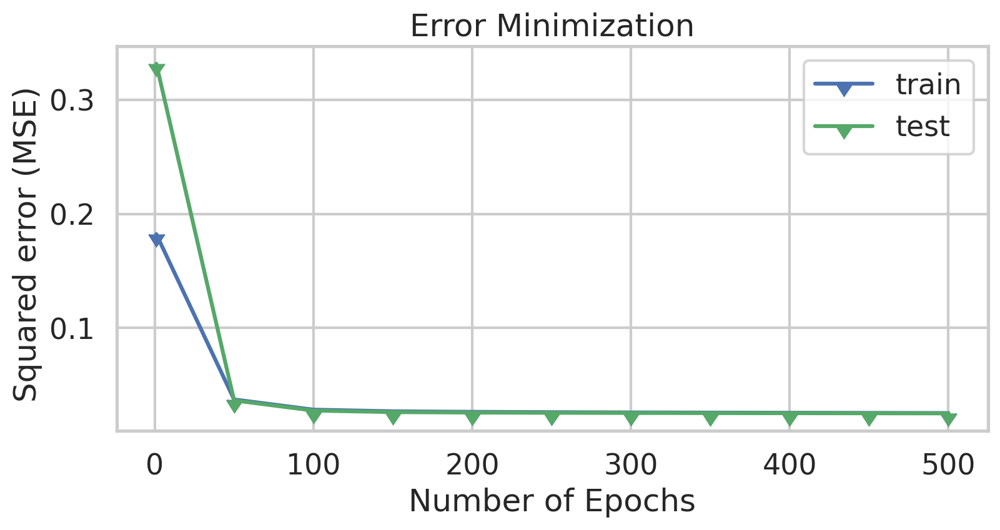

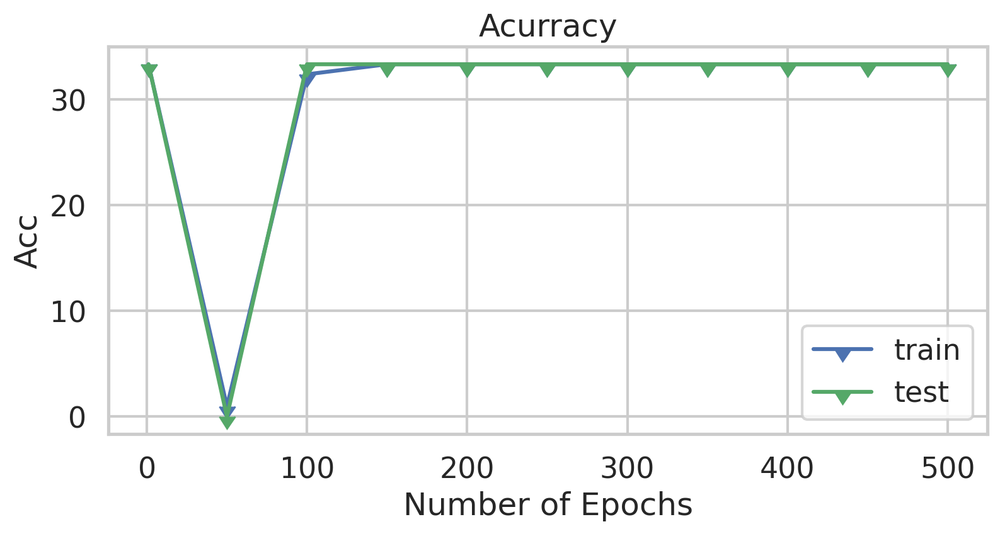

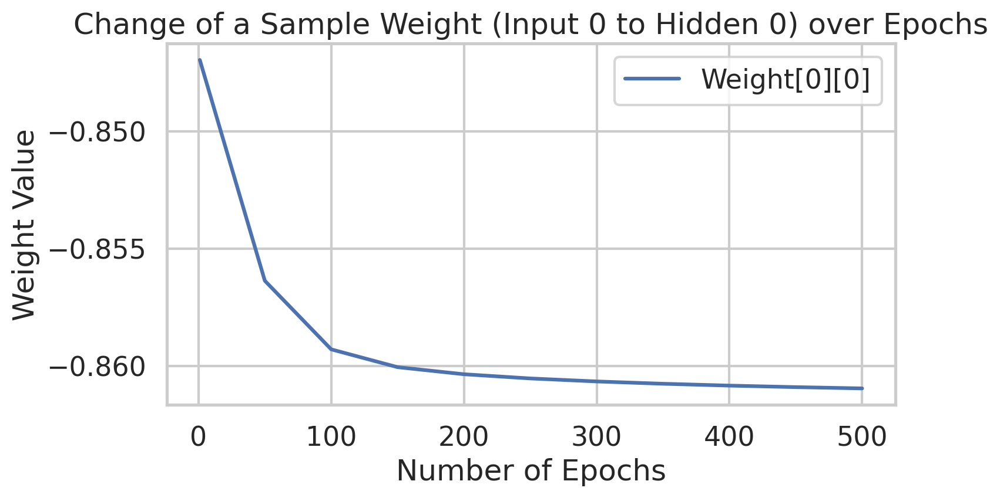

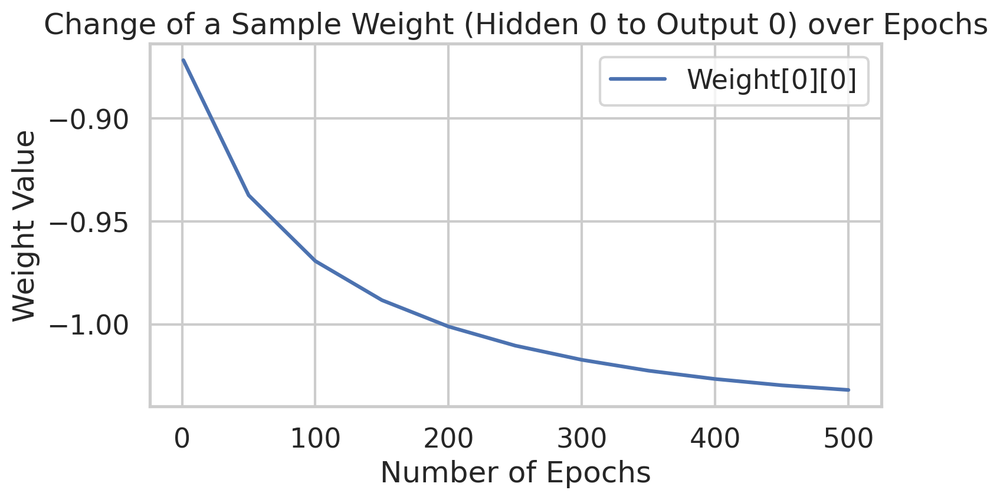

Max test acc =  33.33333333333333


MultiLayerPerceptron(params={'ActivationFunction': 'tanh',
                             'BiasHiddenValue': -1, 'BiasOutputValue': -1,
                             'Epocas': 500, 'HiddenLayer': 5, 'InputLayer': 4,
                             'LearningRate': 0.001, 'OutputLayer': 3})

In [ ]:
dictionary = {'InputLayer':4, 'HiddenLayer':5, 'OutputLayer':3,
              'Epocas':500, 'LearningRate':0.001,'BiasHiddenValue':-1,
              'BiasOutputValue':-1, 'ActivationFunction':'tanh'}

print(test_y.shape)
Perceptron = MultiLayerPerceptron(dictionary)
print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

Perceptron.fit(train_X,train_y,test_X, test_y)

In [ ]:
prev, dataframe = Perceptron.predict(test_X, test_y)
hits = n_set = n_vers = n_virg = 0
score_set = score_vers = score_virg = 0
for j in range(len(test_y)):
    if(test_y[j] == 0): n_set += 1
    elif(test_y[j] == 1): n_vers += 1
    elif(test_y[j] == 2): n_virg += 1

for i in range(len(test_y)):
    if test_y[i] == prev[i]:
        hits += 1
    if test_y[i] == prev[i] and test_y[i] == 0:
        score_set += 1
    elif test_y[i] == prev[i] and test_y[i] == 1:
        score_vers += 1
    elif test_y[i] == prev[i] and test_y[i] == 2:
        score_virg += 1

hits = (hits / len(test_y)) * 100
faults = 100 - hits

print("Porcents :","%.2f"%(hits),"% hits","and","%.2f"%(faults),"% faults")
print("Total samples of test",len(test_y))
print("*Iris-Setosa:",n_set,"samples", score_set, "hits")
print("*Iris-Versicolour:",n_vers,"samples", score_vers, "hits")
print("*Iris-Virginica:",n_virg,"samples", score_virg, "hits")

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 45
*Iris-Setosa: 15 samples 0 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 15 hits


In [ ]:
prev, dataframe = Perceptron.predict(train_X, train_y)
hits = n_set = n_vers = n_virg = 0
score_set = score_vers = score_virg = 0
for j in range(len(train_y)):
    if(train_y[j] == 0): n_set += 1
    elif(train_y[j] == 1): n_vers += 1
    elif(train_y[j] == 2): n_virg += 1

for i in range(len(test_y)):
    if train_y[i] == prev[i]:
        hits += 1
    if train_y[i] == prev[i] and train_y[i] == 0:
        score_set += 1
    elif train_y[i] == prev[i] and train_y[i] == 1:
        score_vers += 1
    elif train_y[i] == prev[i] and train_y[i] == 2:
        score_virg += 1

hits = (hits / len(train_y)) * 100
faults = 100 - hits

print("Porcents :","%.2f"%(hits),"% hits","and","%.2f"%(faults),"% faults")
print("Total samples of test",len(train_y))
print("*Iris-Setosa:",n_set,"samples", score_set, "hits")
print("*Iris-Versicolour:",n_vers,"samples", score_vers, "hits")
print("*Iris-Virginica:",n_virg,"samples", score_virg, "hits")

Porcents : 14.29 % hits and 85.71 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 1 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 14 hits


- Acurracy Iris-Setosa: 2.86 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 40.00 %


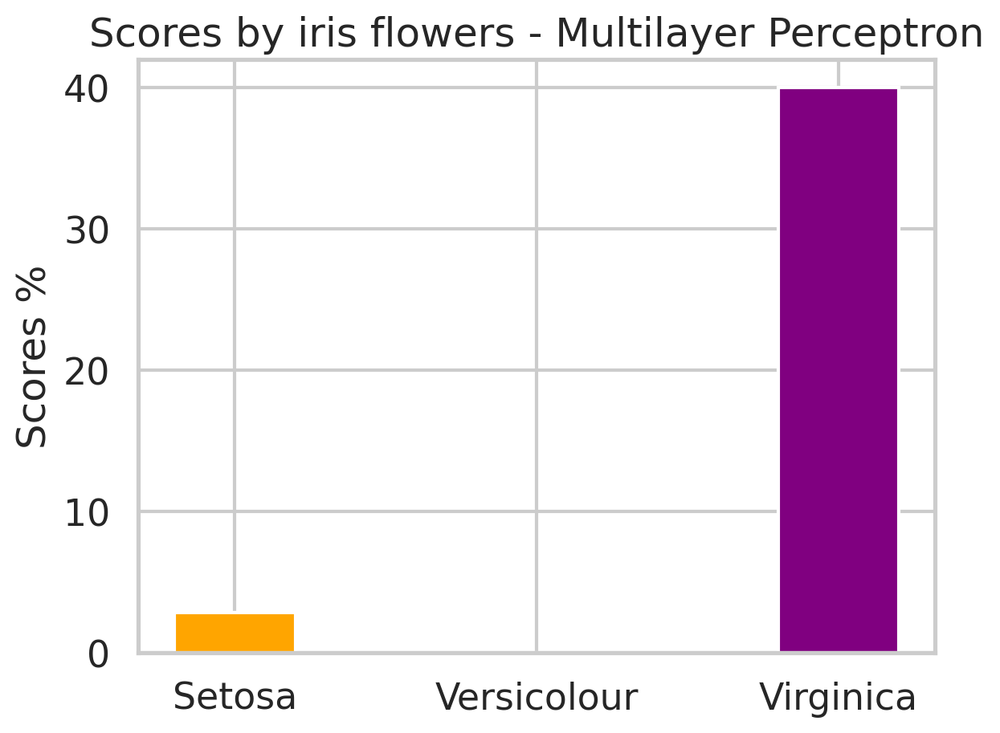

In [ ]:
acc_set = (score_set/n_set)*100
acc_vers = (score_vers/n_vers)*100
acc_virg = (score_virg/n_virg)*100
print("- Acurracy Iris-Setosa:","%.2f"%acc_set, "%")
print("- Acurracy Iris-Versicolour:","%.2f"%acc_vers, "%")
print("- Acurracy Iris-Virginica:","%.2f"%acc_virg, "%")
names = ["Setosa","Versicolour","Virginica"]
x1 = [2.0,4.0,6.0]
fig, ax = plt.subplots()
r1 = plt.bar(x1[0], acc_set,color='orange',label='Iris-Setosa')
r2 = plt.bar(x1[1], acc_vers,color='green',label='Iris-Versicolour')
r3 = plt.bar(x1[2], acc_virg,color='purple',label='Iris-Virginica')
plt.ylabel('Scores %')
plt.xticks(x1, names);plt.title('Scores by iris flowers - Multilayer Perceptron')
plt.show()

Trying parameters: {'HiddenLayer': 5, 'Epocas': 500, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.18219397599861742
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.03734692309765312
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.028405285783317868
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.02698416527577431
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.026492554807196766
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.02619372799749686
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.02598299606299375
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.025821183456727712
hits test 33.33333333333333
hit

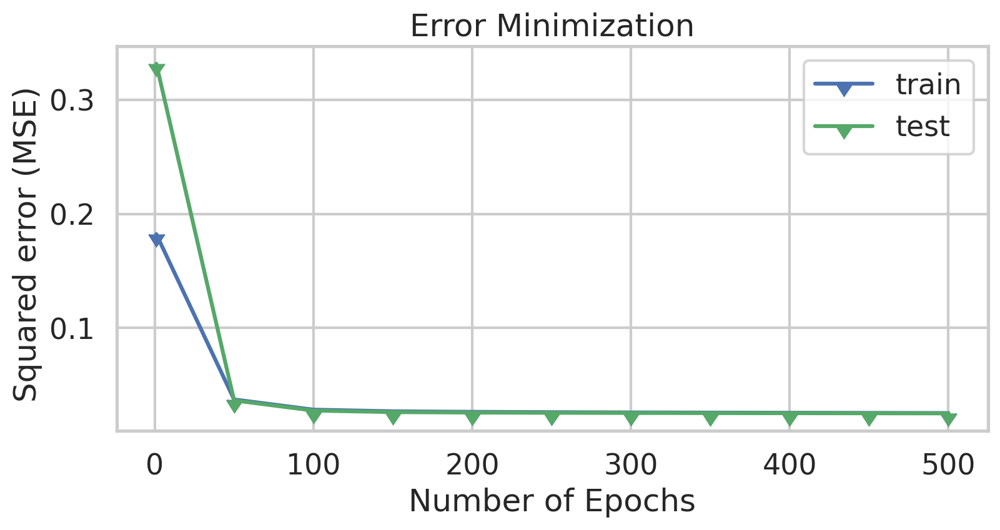

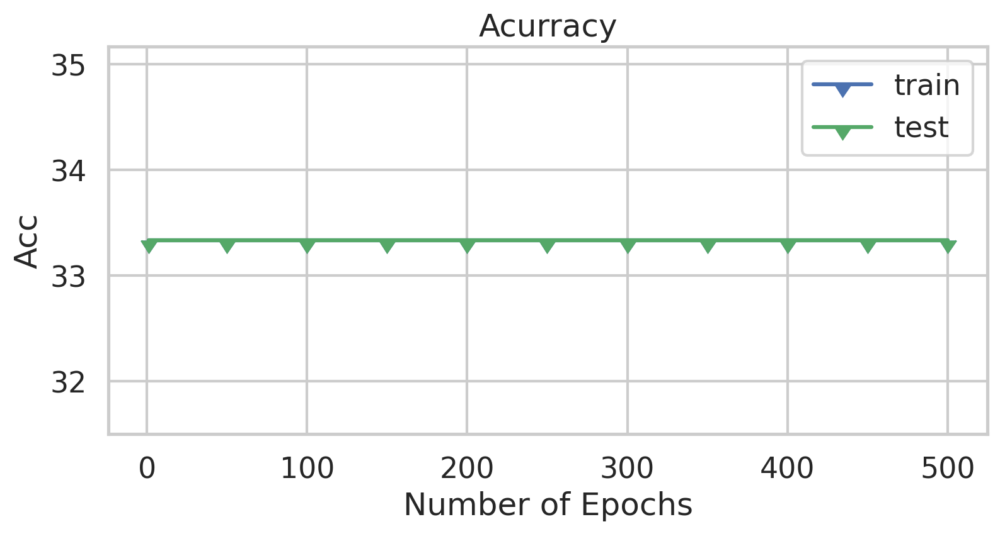

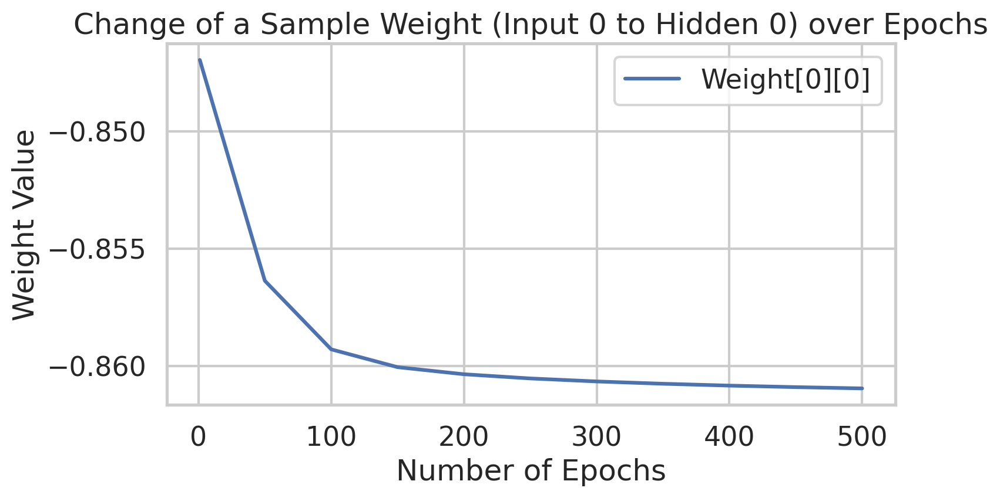

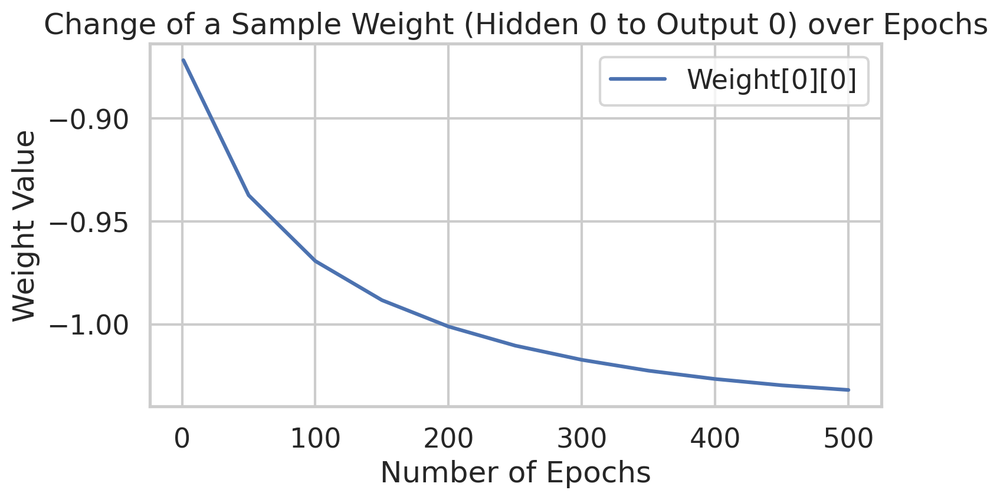

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


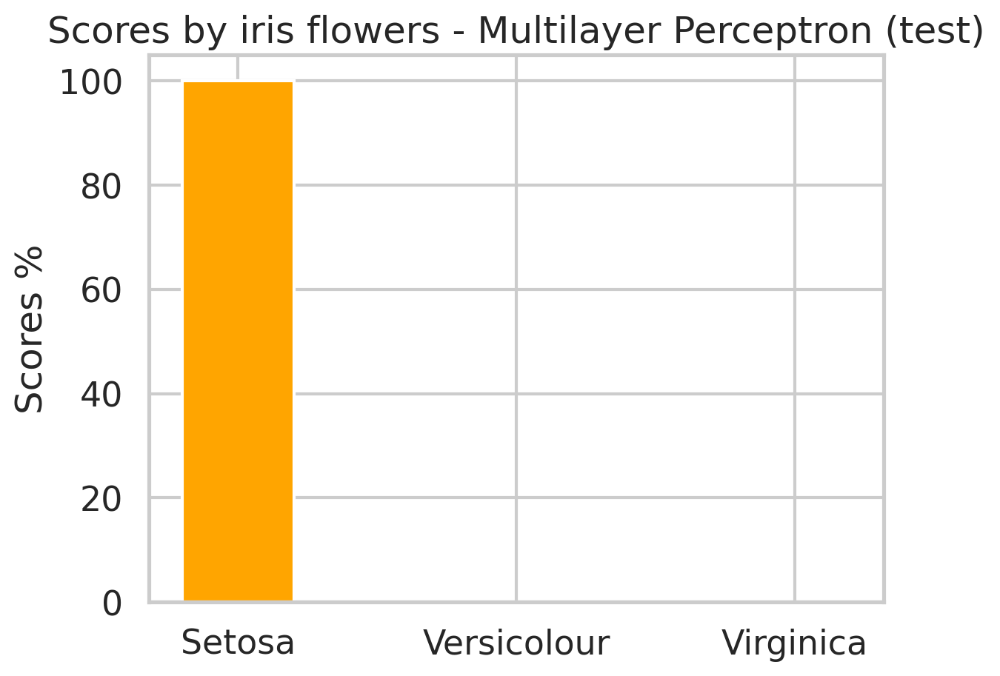

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


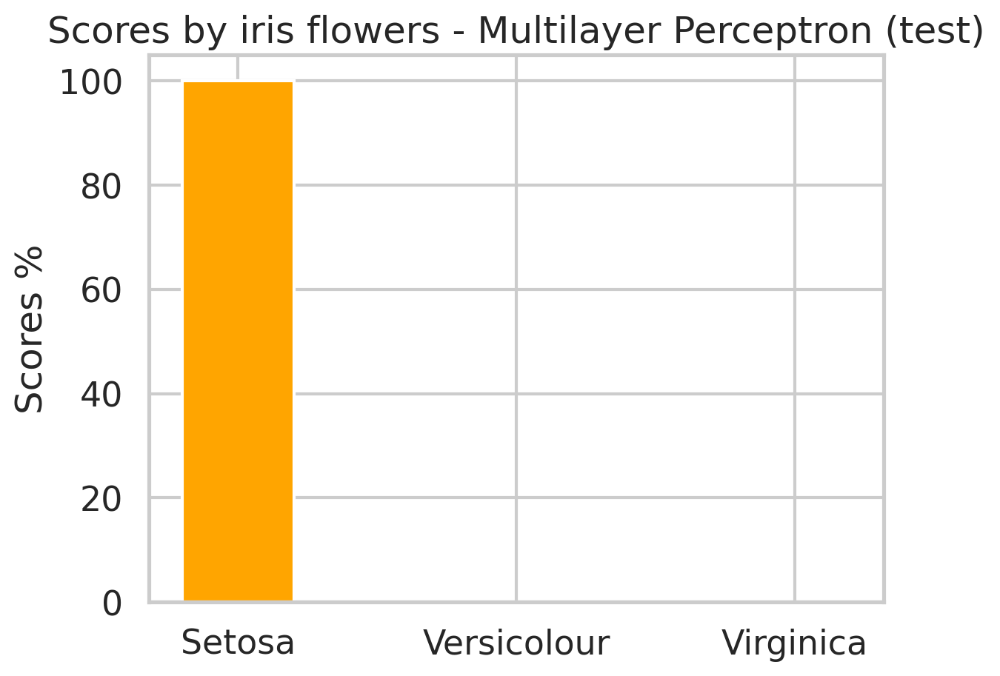

--> New best parameters found!
Trying parameters: {'HiddenLayer': 5, 'Epocas': 500, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.06964639109867243
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.06687532608199995
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06559897988736976
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.06458259563767342
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.06347669961687946
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.0621435651417964
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.060498632352632024
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.05853553575941271


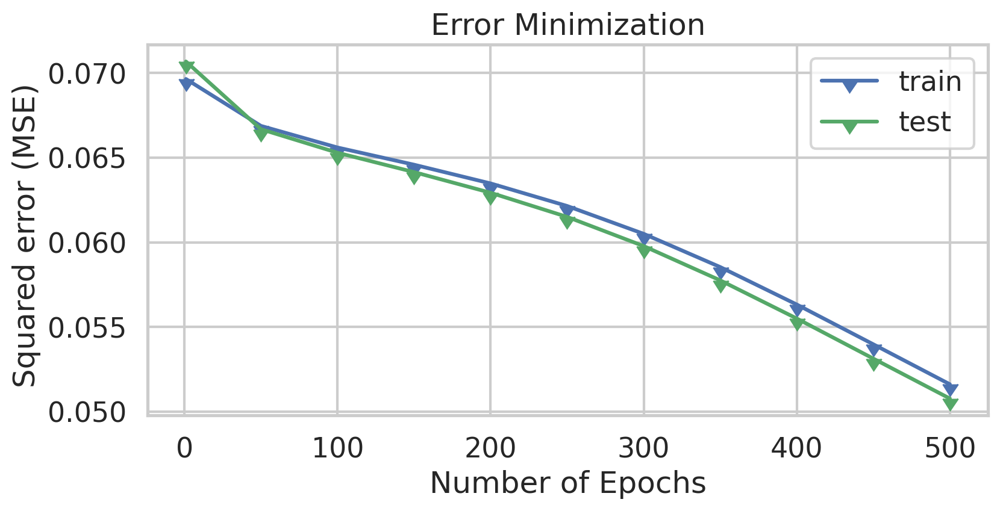

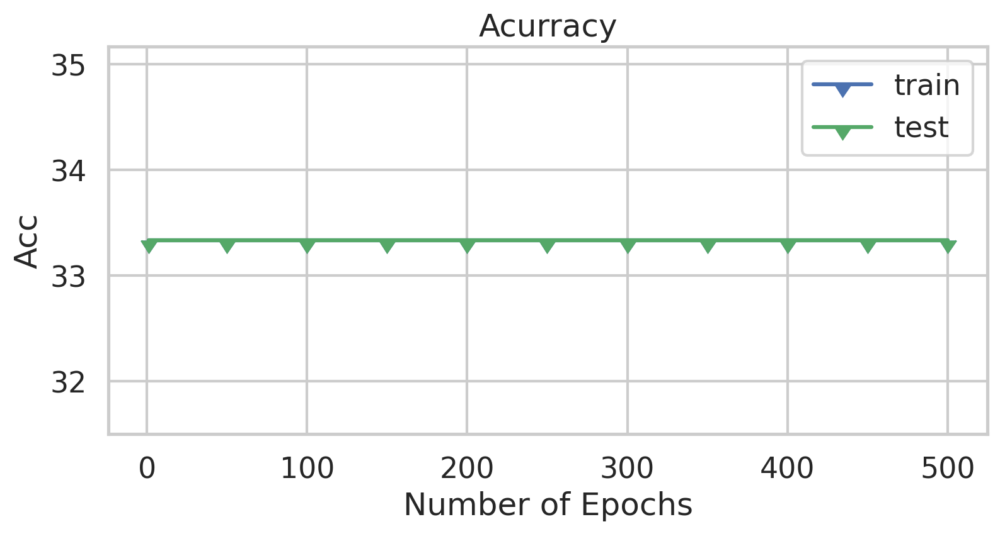

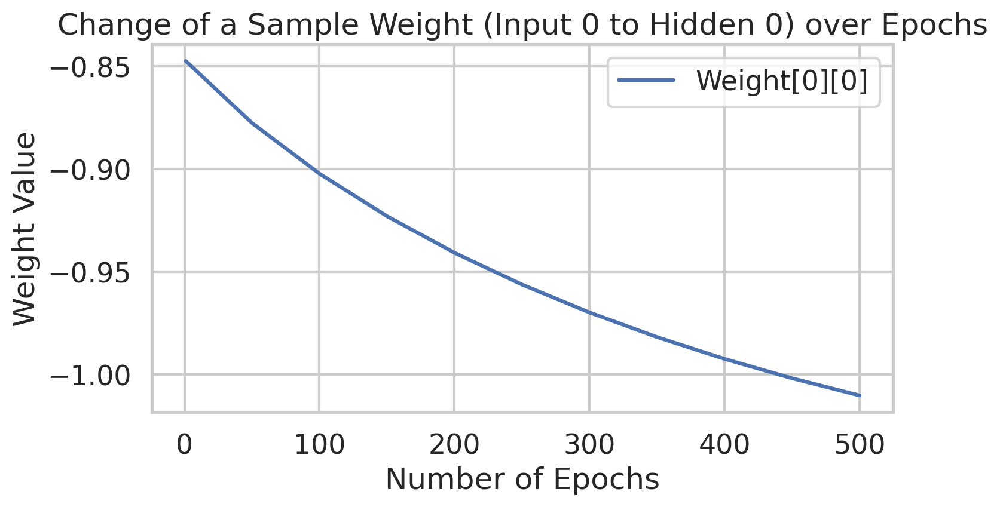

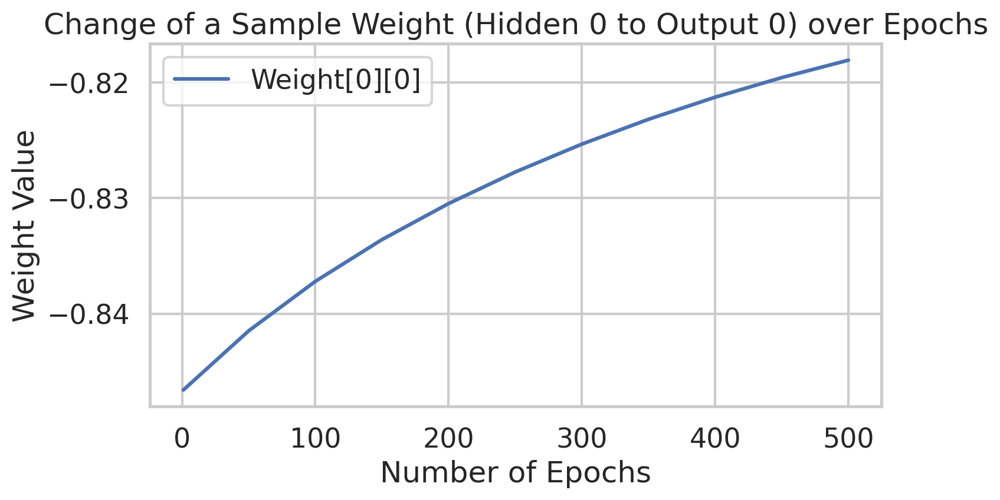

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


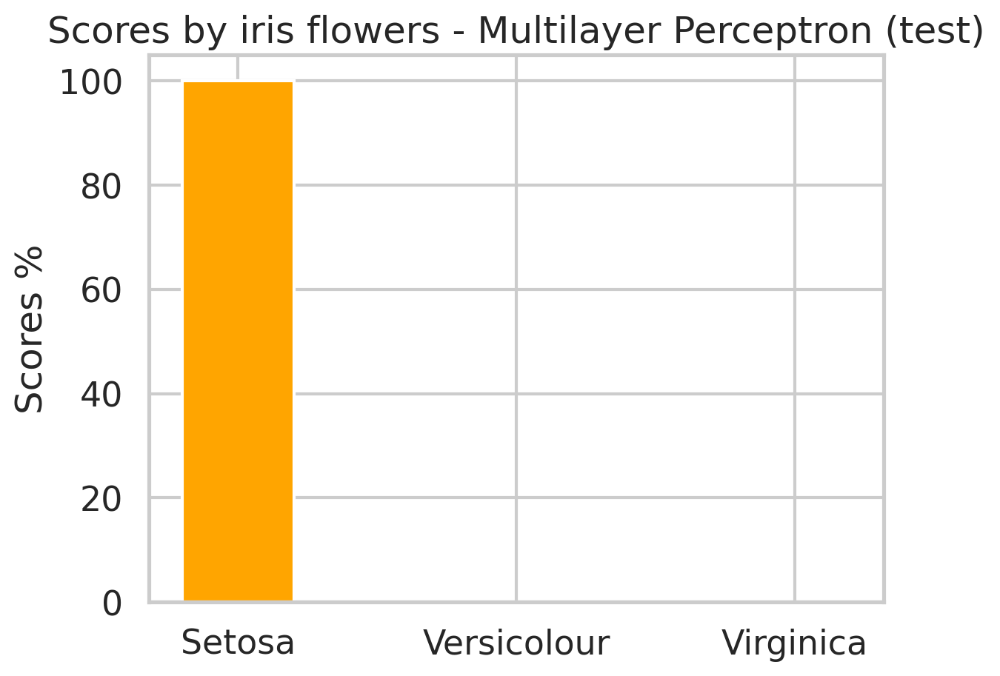

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


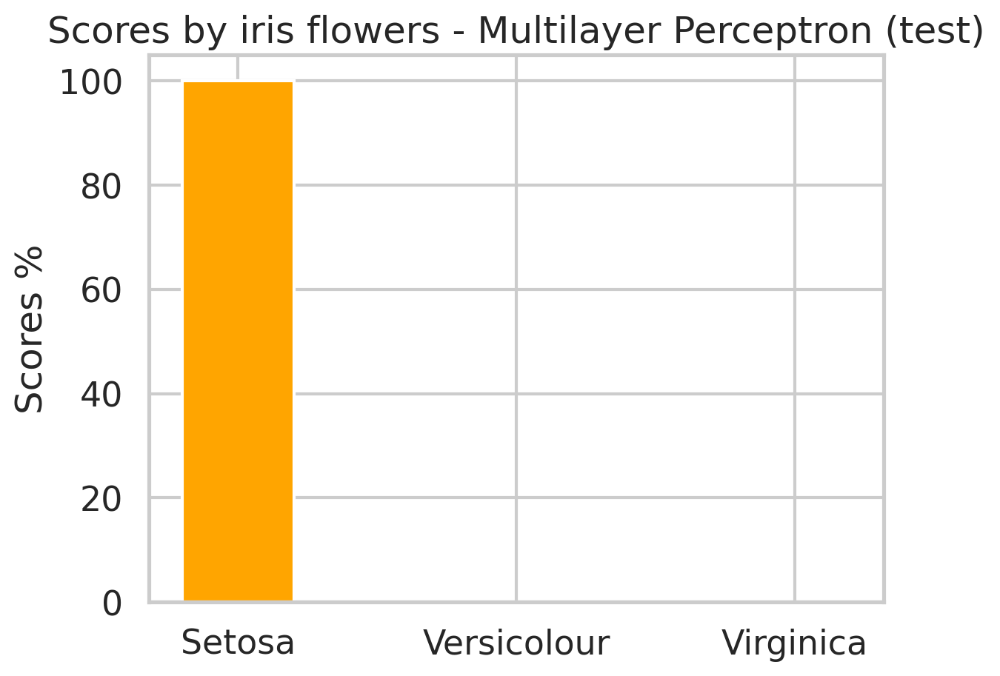

Trying parameters: {'HiddenLayer': 5, 'Epocas': 500, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.11133899397535113
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.0874458764374116
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.08745472572685109
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.08747179605956489
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.08749706277977555
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.08753068122638506
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.08106864393721037
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.08011178349884088
hits test 33.33333333333333
hits tr

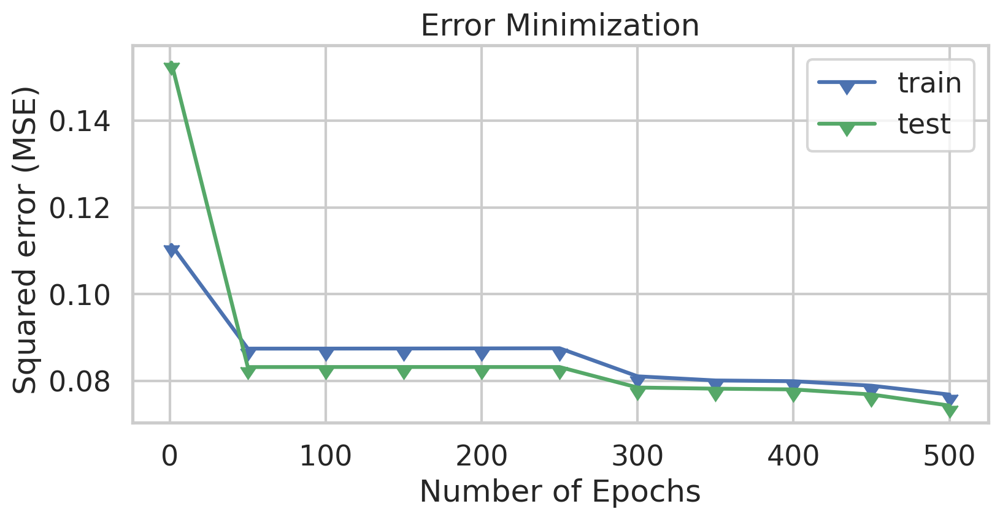

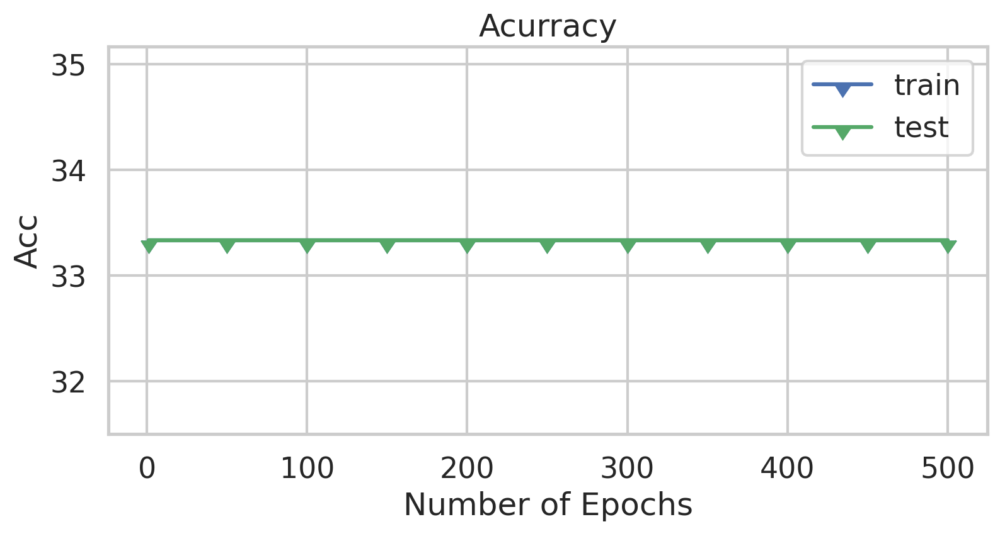

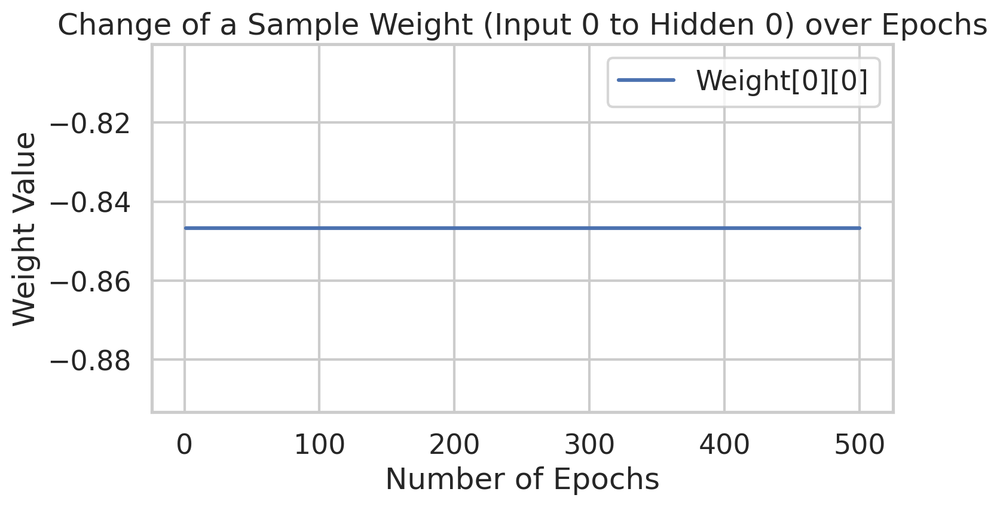

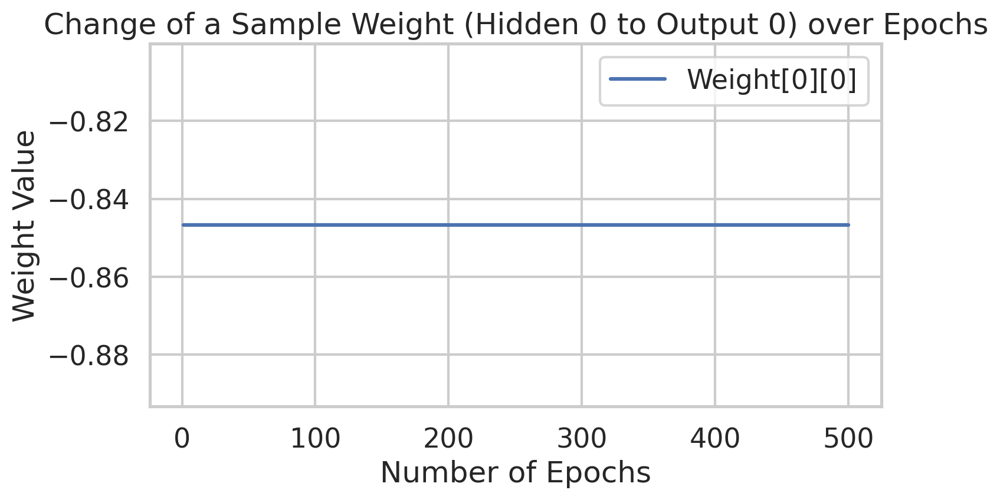

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


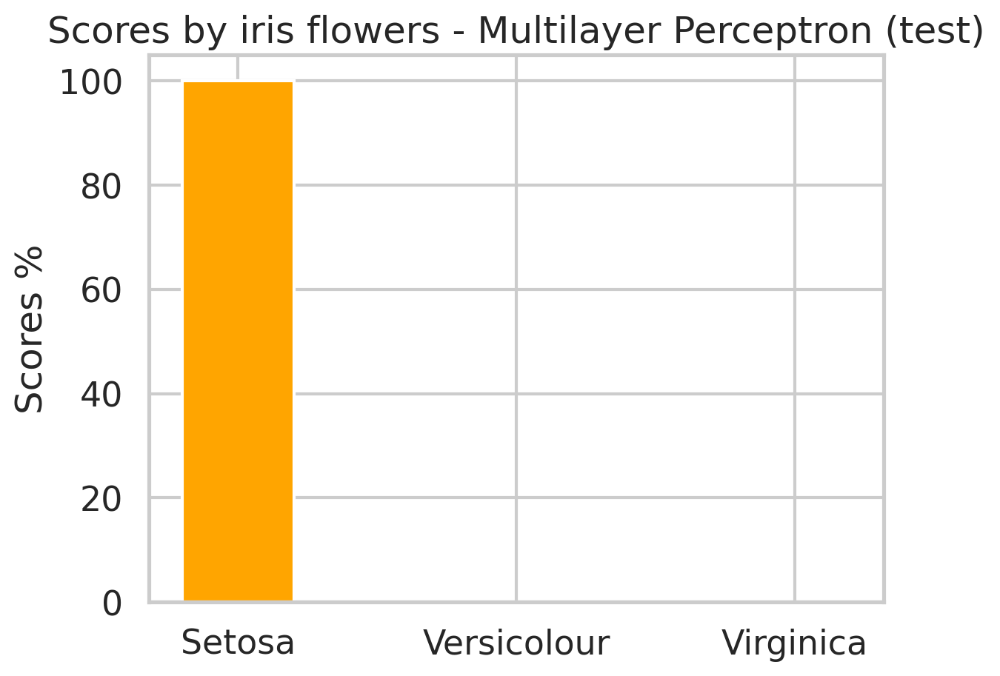

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


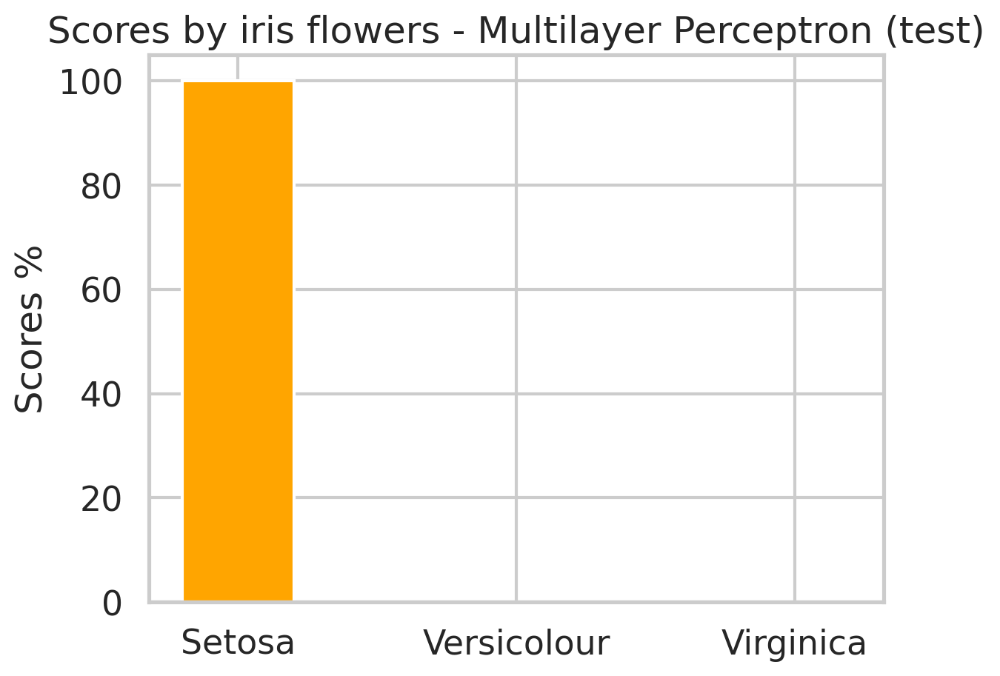

Trying parameters: {'HiddenLayer': 5, 'Epocas': 500, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.18851888618147852
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.12153464599772427
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06550274827600004
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.05933028138223925
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.054689814653289835
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.051171654865567774
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.04783615803033155
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.0446661603793413
hits test 33.33333333333333
hits

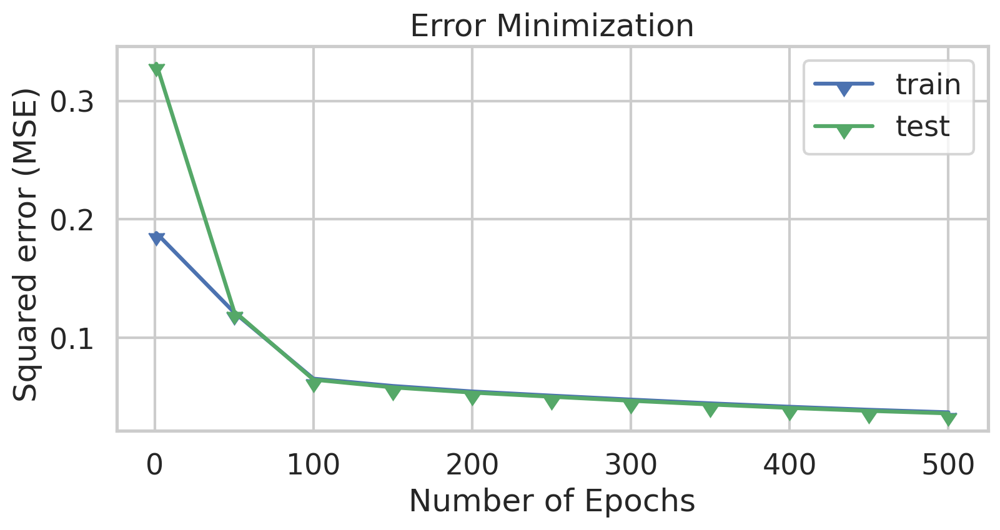

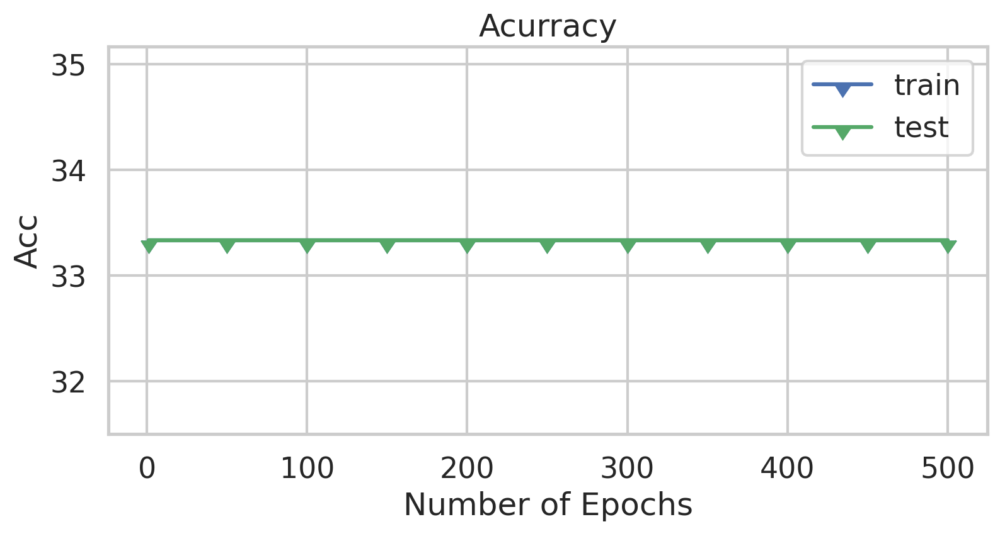

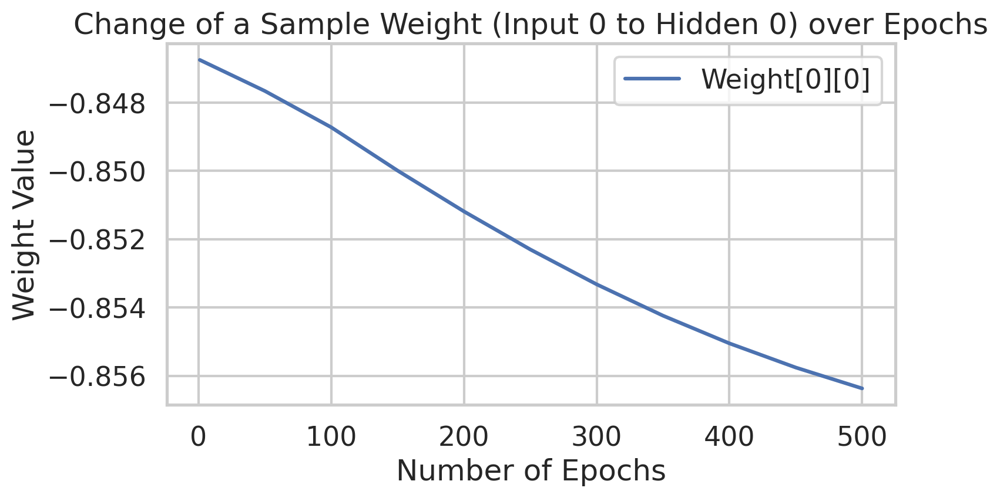

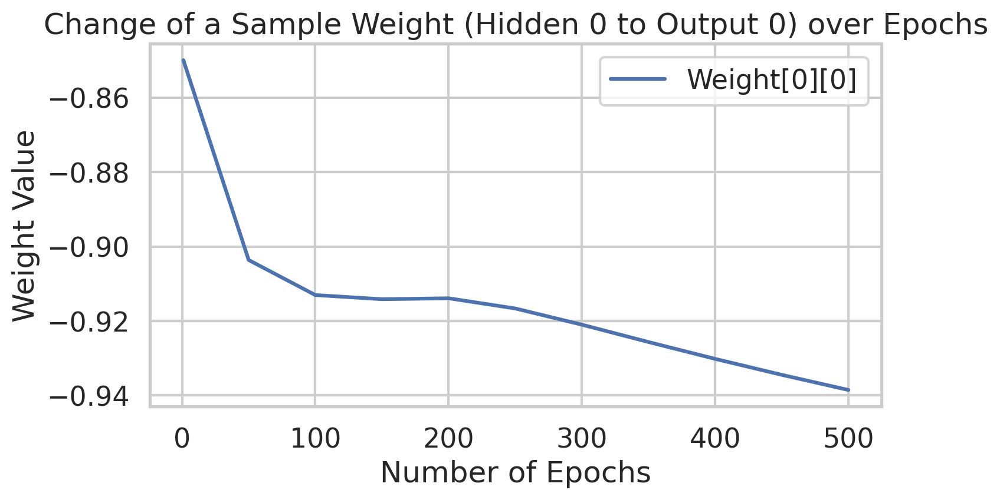

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


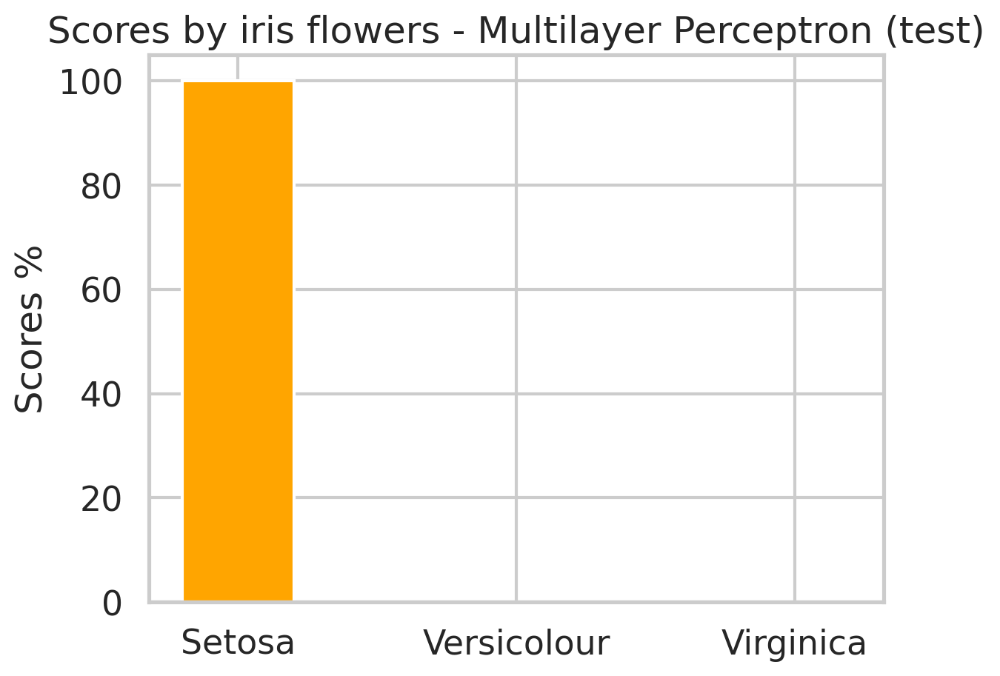

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


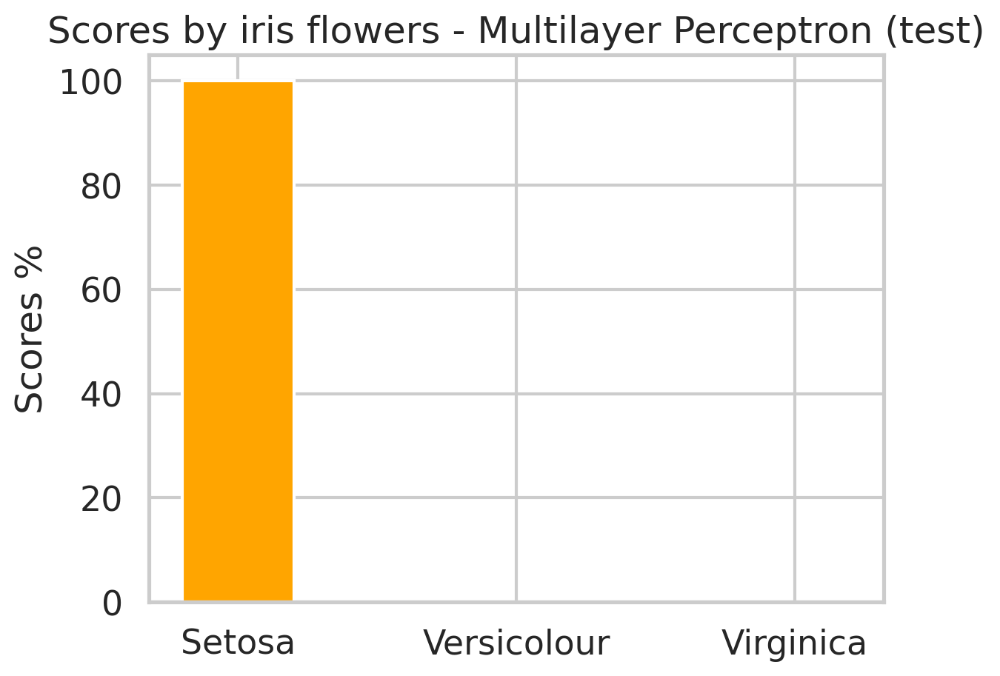

Trying parameters: {'HiddenLayer': 5, 'Epocas': 500, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.06967960493669281
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.06938141509029622
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06895407644233086
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.06857634789802394
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.06824154978923723
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.06794380186423034
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.06767794811209277
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.06743948200863614
hits test 33.33333333333333
hi

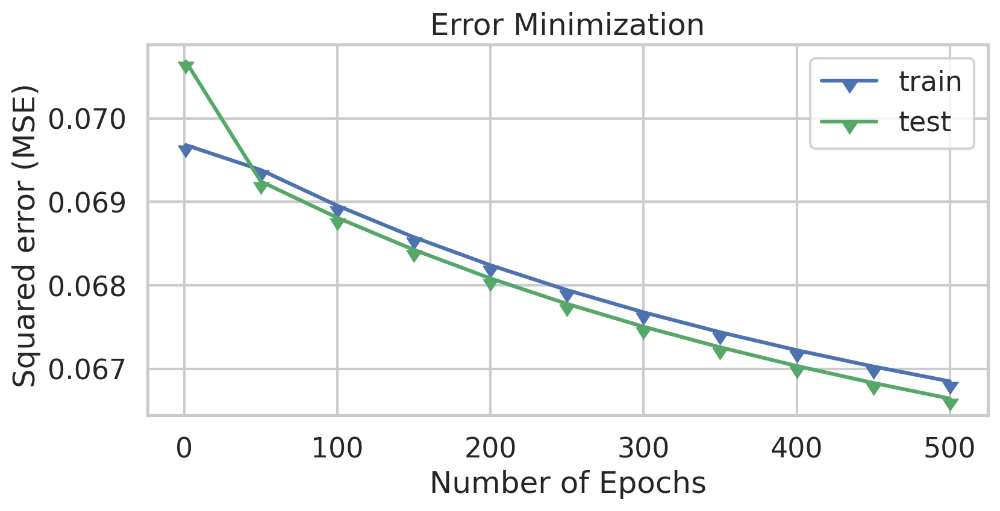

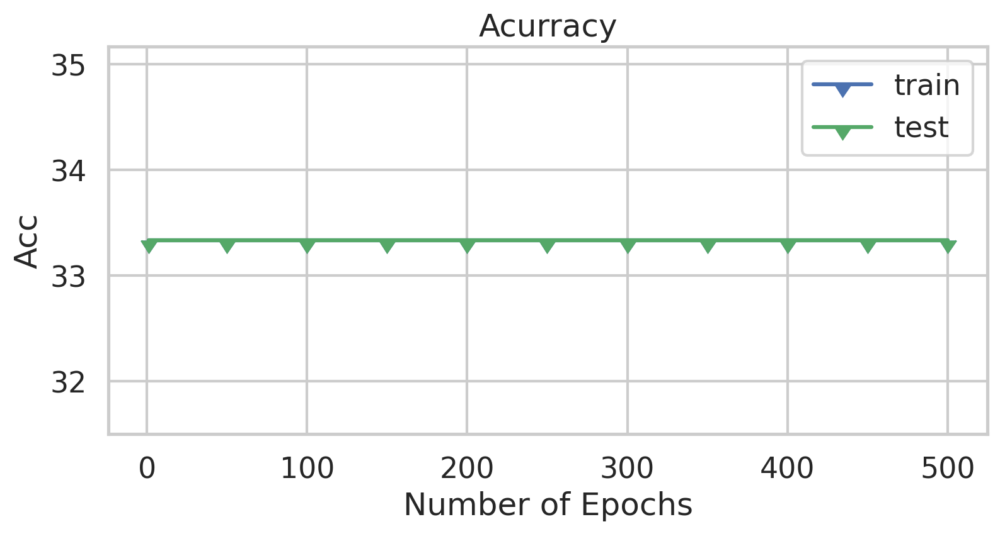

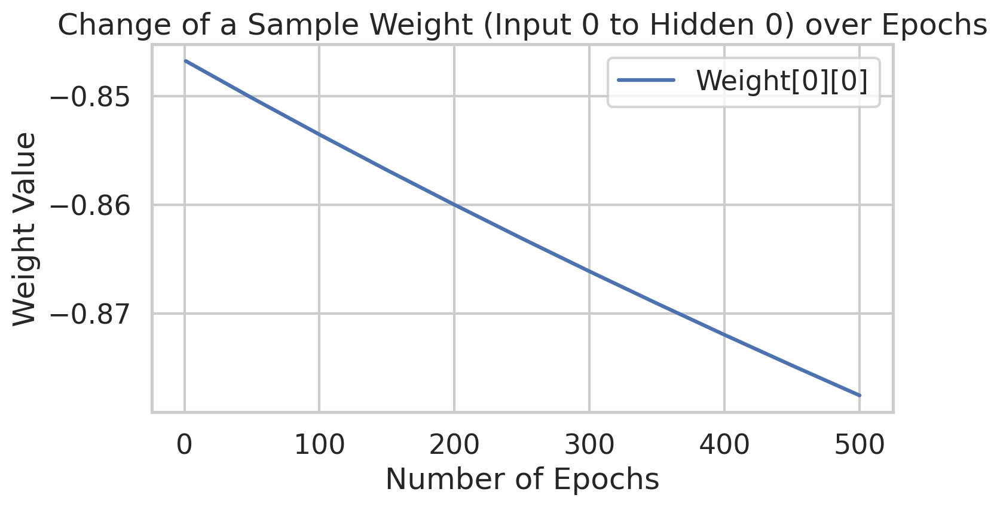

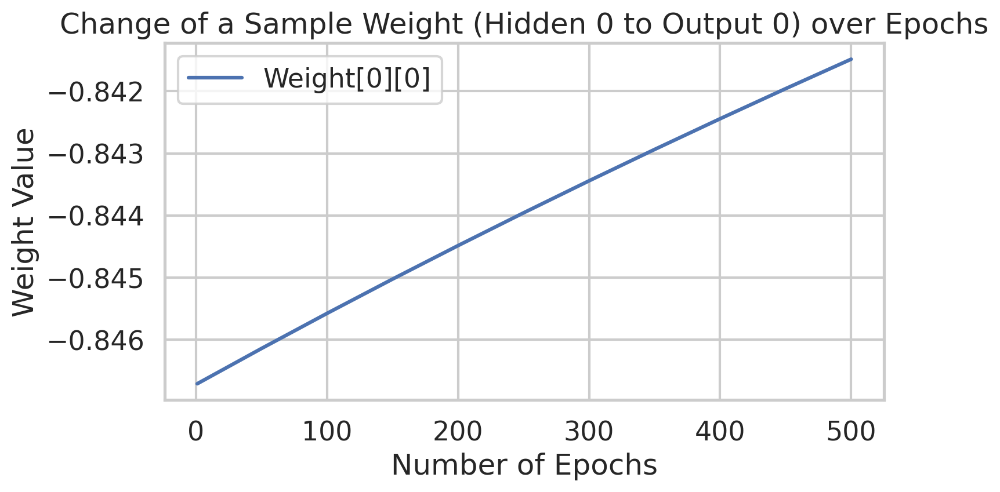

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


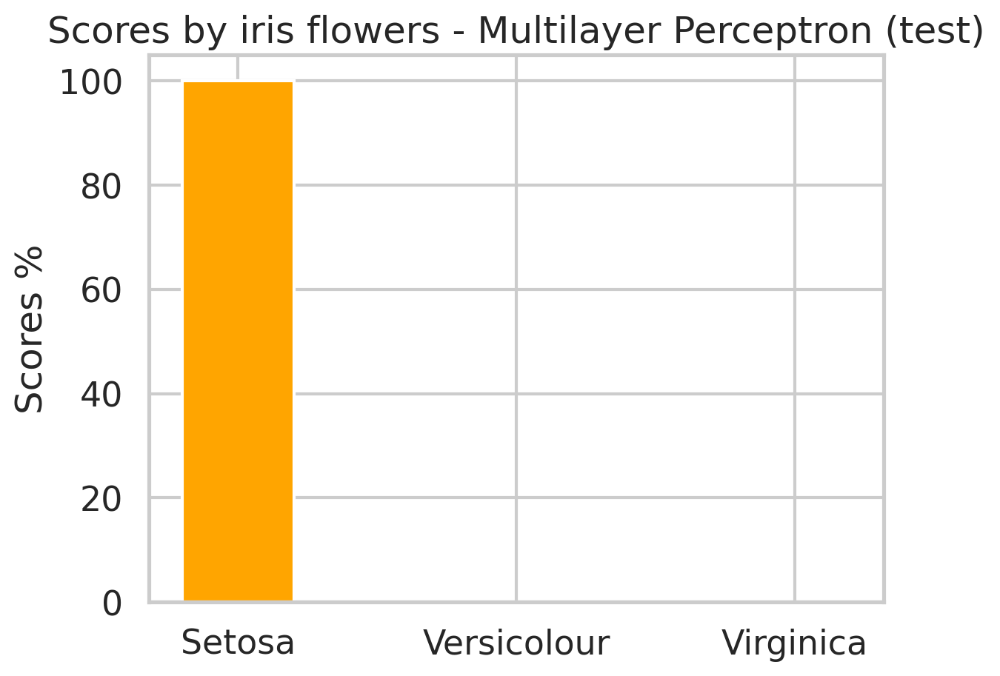

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


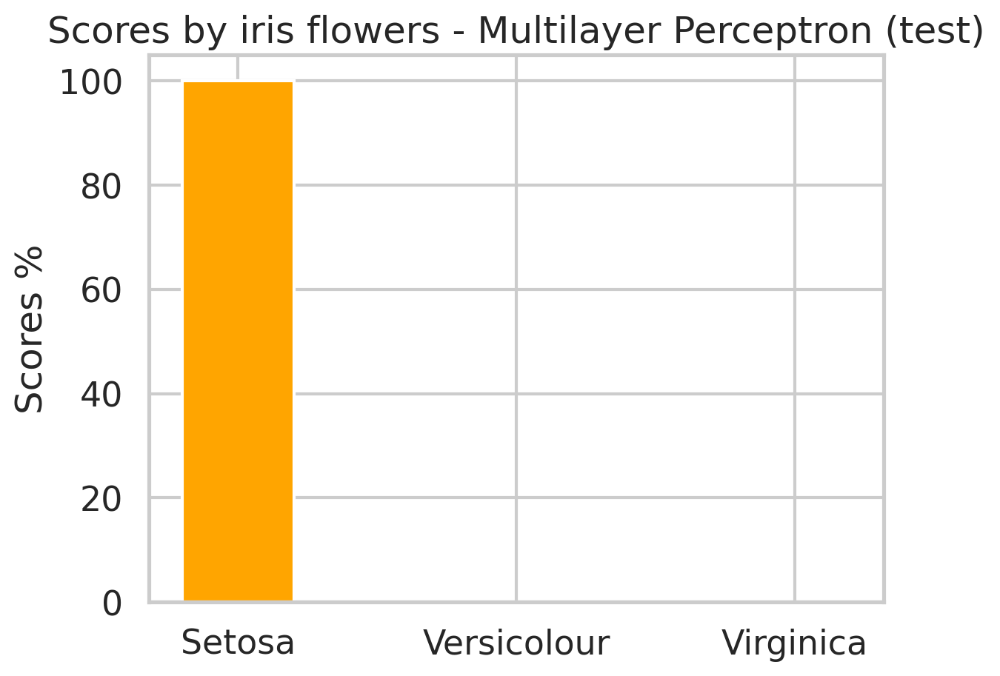

Trying parameters: {'HiddenLayer': 5, 'Epocas': 500, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.21618797396229972
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.07985862955381666
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.07943775845399763
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.07926843386927682
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.07908799689071627
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.07892675882239354
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.07879166531667992
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.07868113979138434
hits test 33.33333333333333
hits 

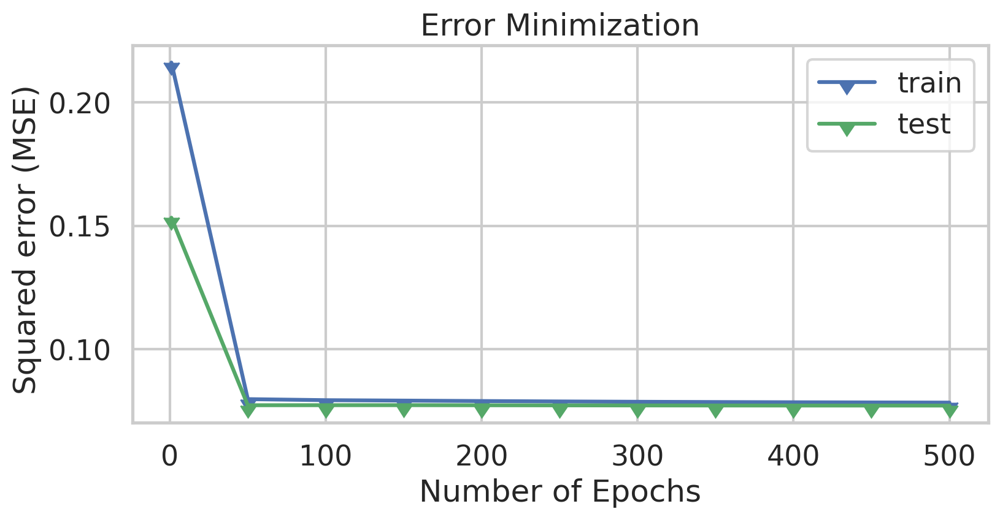

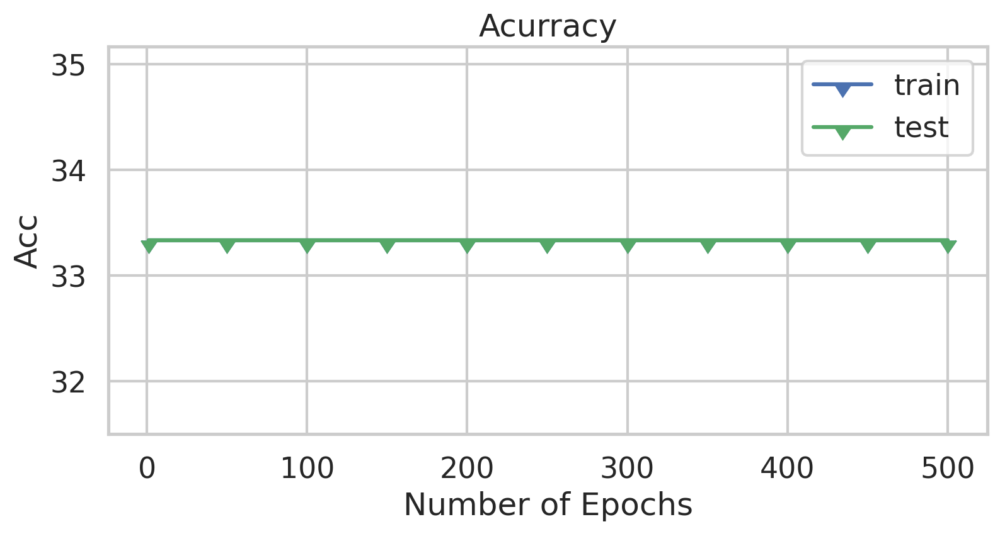

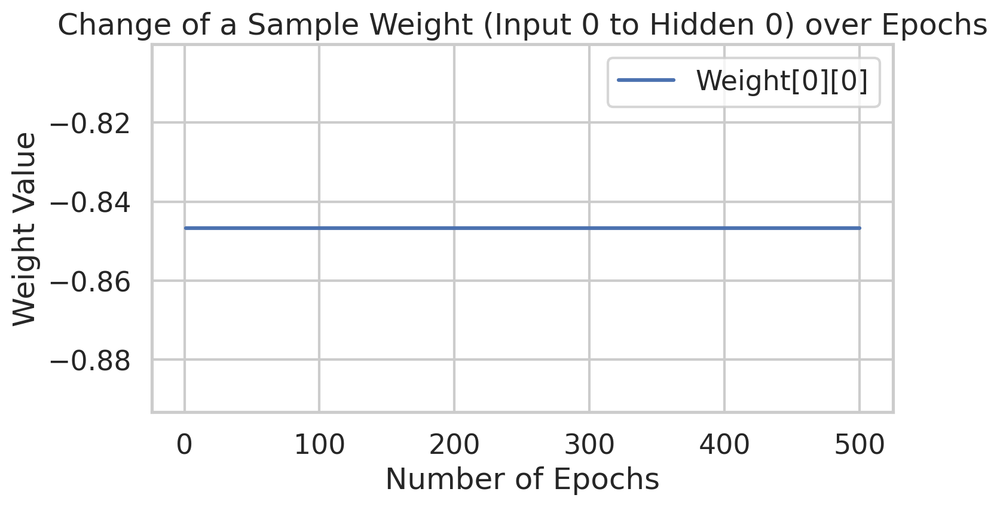

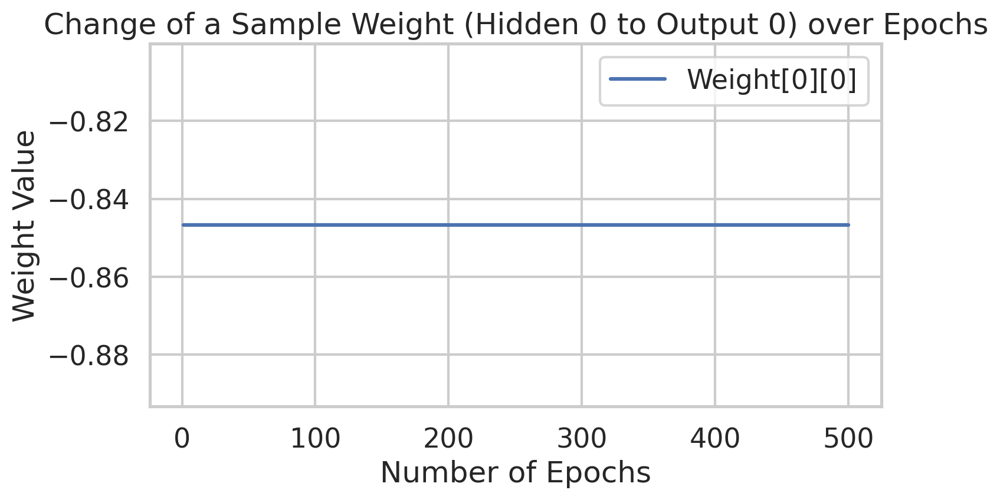

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


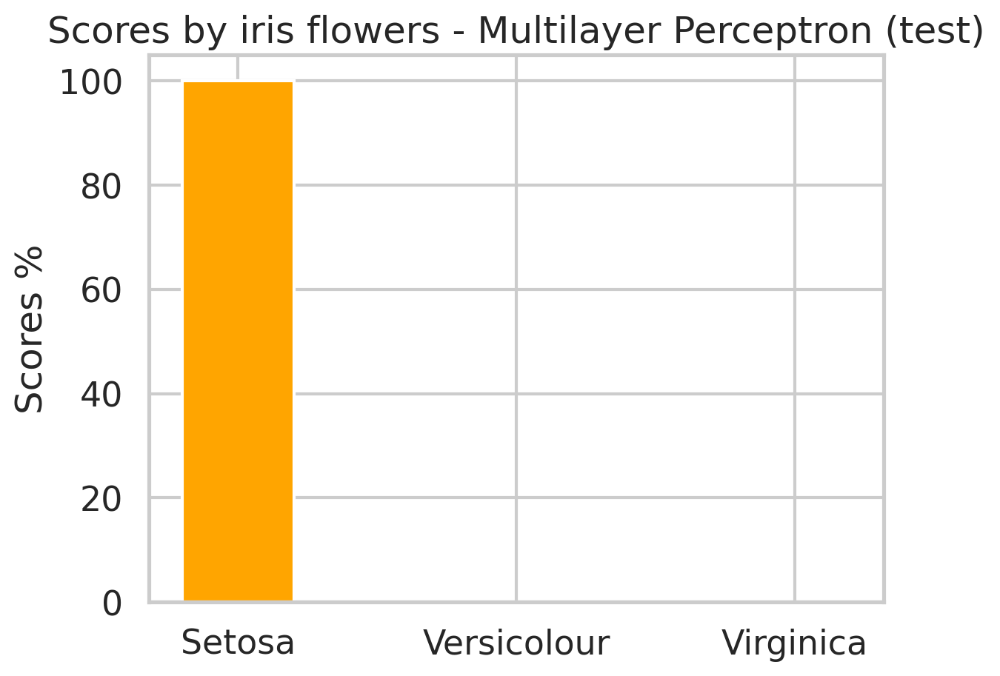

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


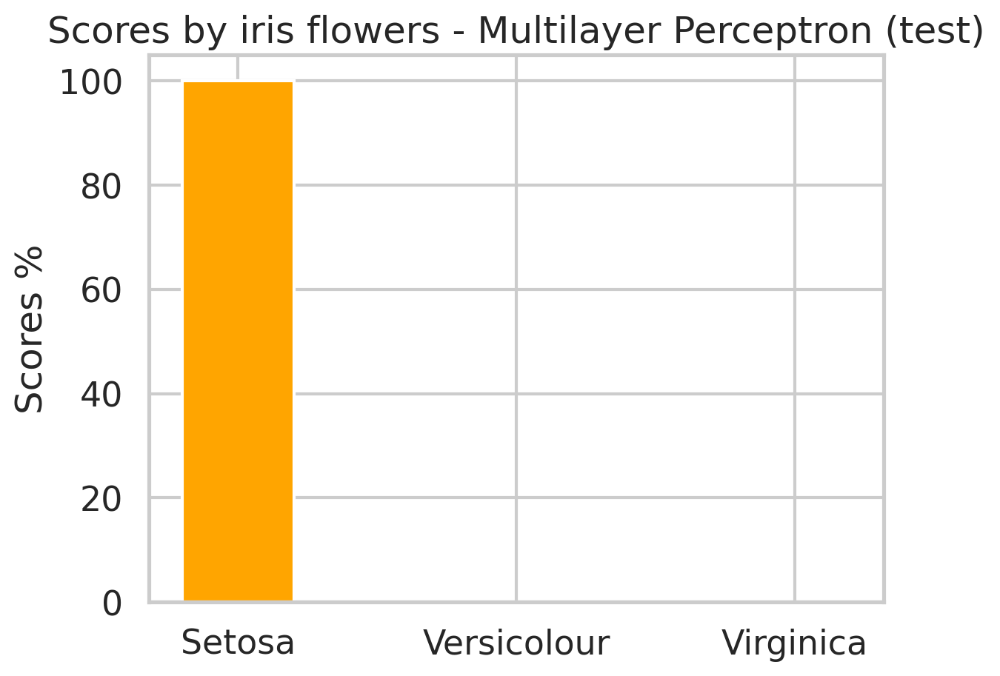

Trying parameters: {'HiddenLayer': 5, 'Epocas': 1000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.18219397599861742
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.03734692309765312
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.028405285783317868
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.02698416527577431
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.026492554807196766
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.02619372799749686
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.02598299606299375
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.025821183456727712
hits test 33.33333333333333
hi

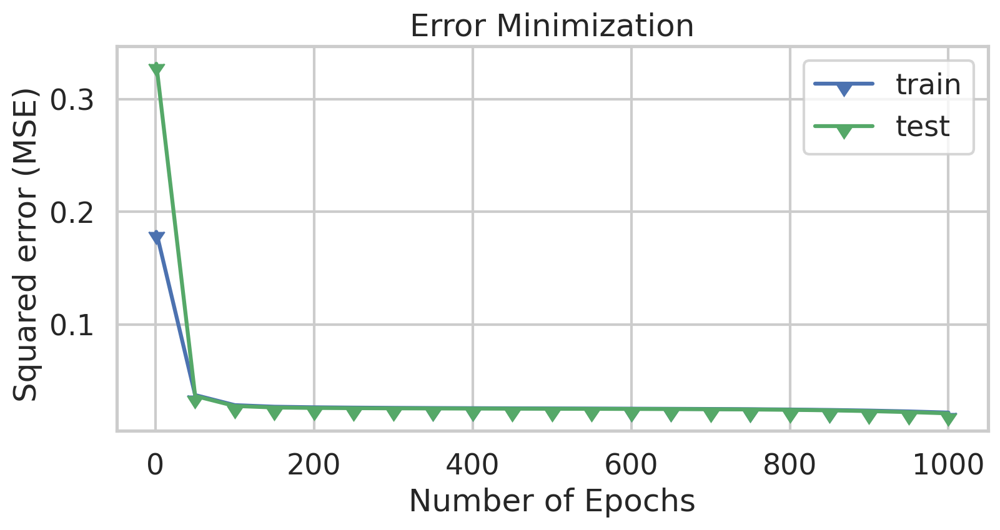

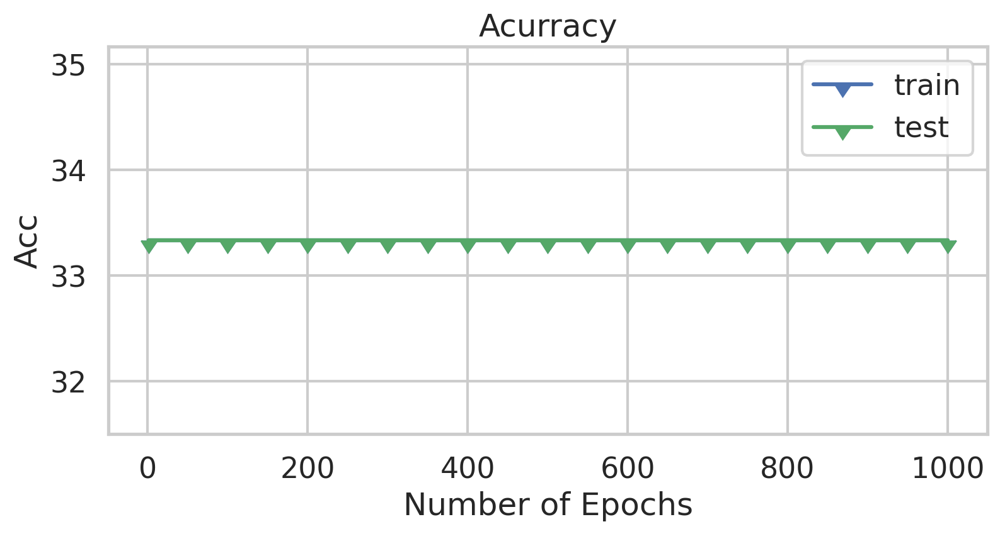

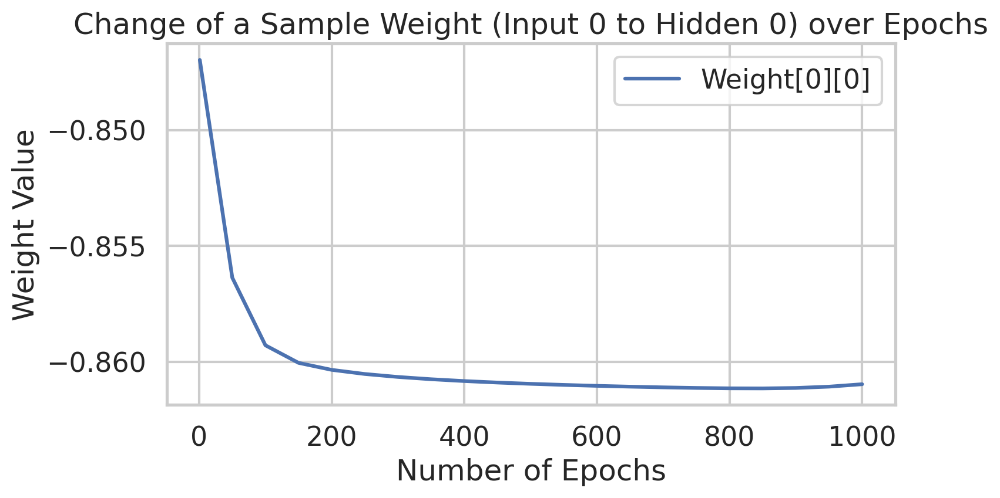

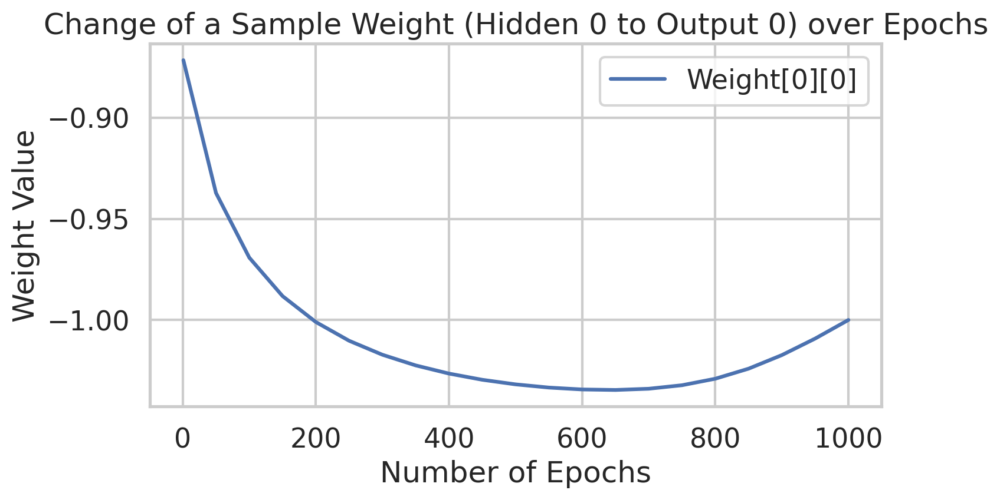

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


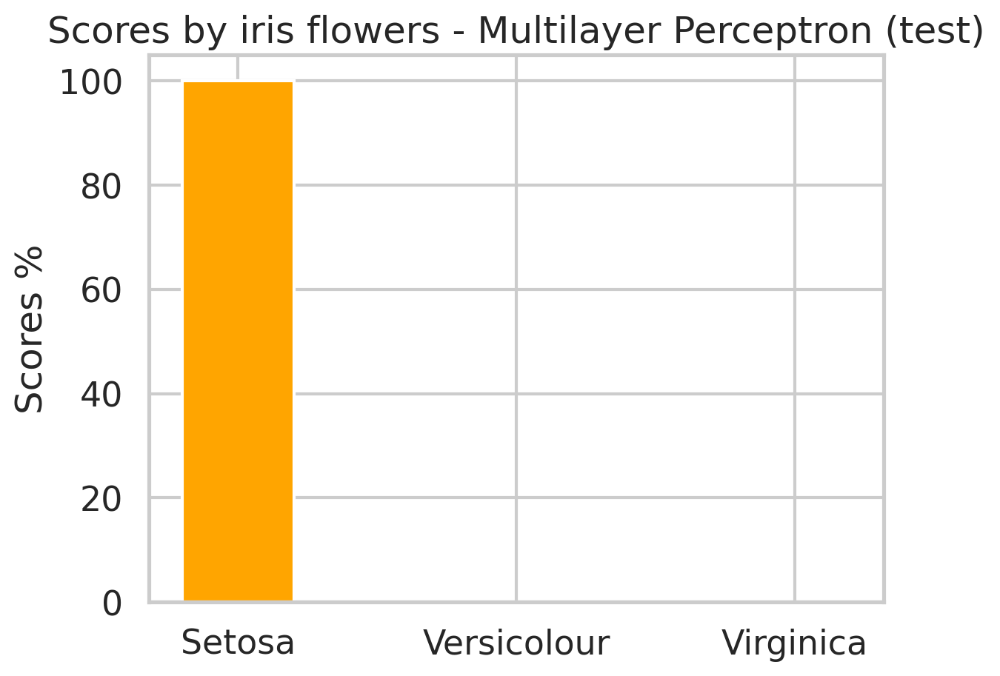

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


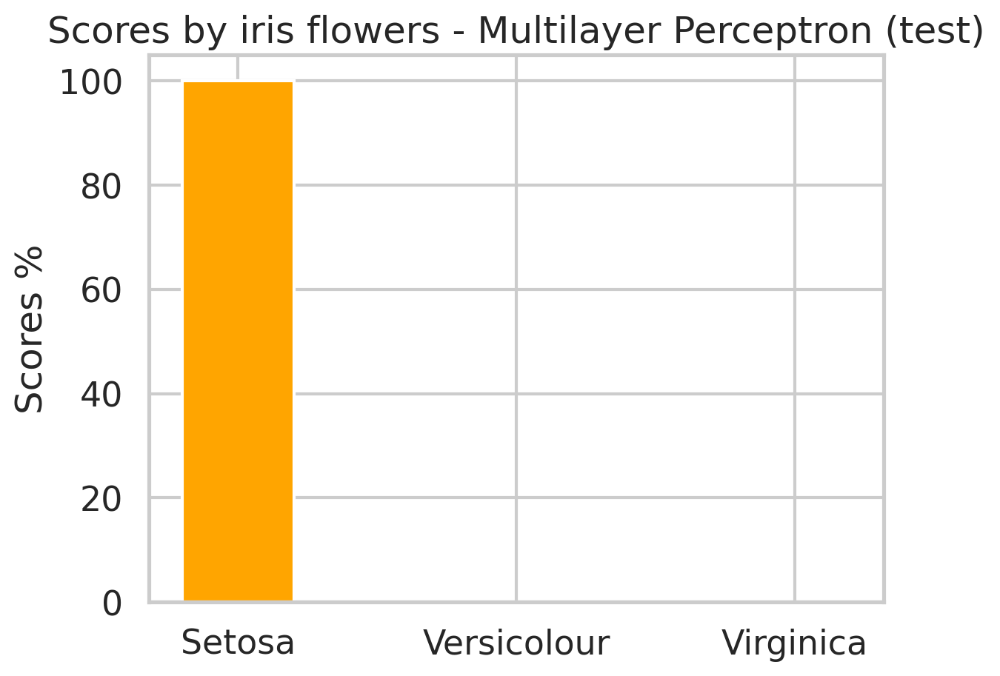

Trying parameters: {'HiddenLayer': 5, 'Epocas': 1000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.06964639109867243
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.06687532608199995
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06559897988736976
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.06458259563767342
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.06347669961687946
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.0621435651417964
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.060498632352632024
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.05853553575941271
hits test 33.33333333333333
hi

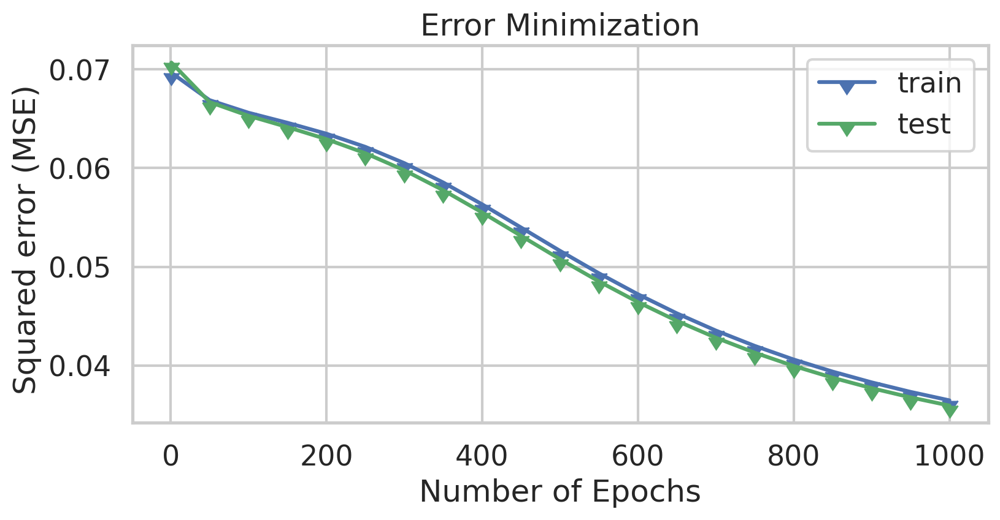

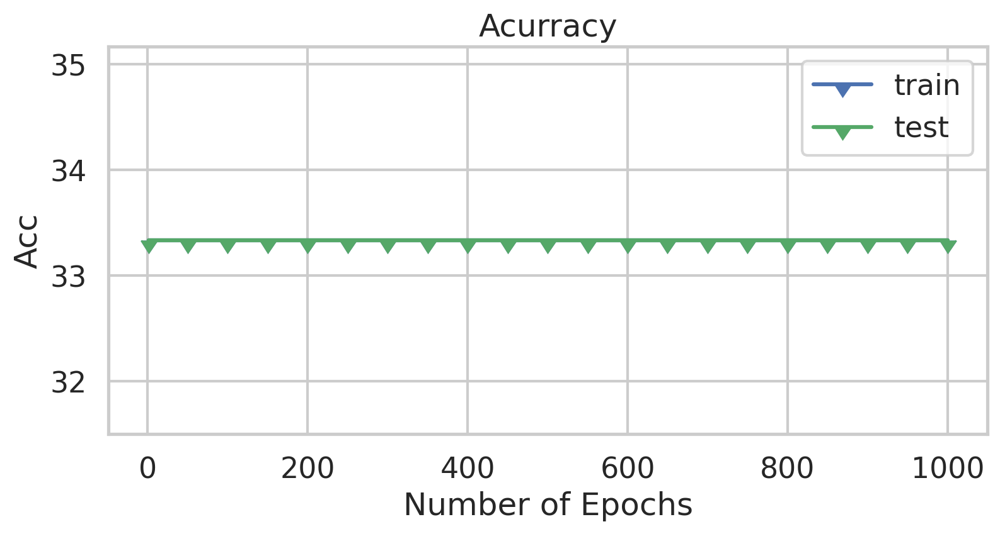

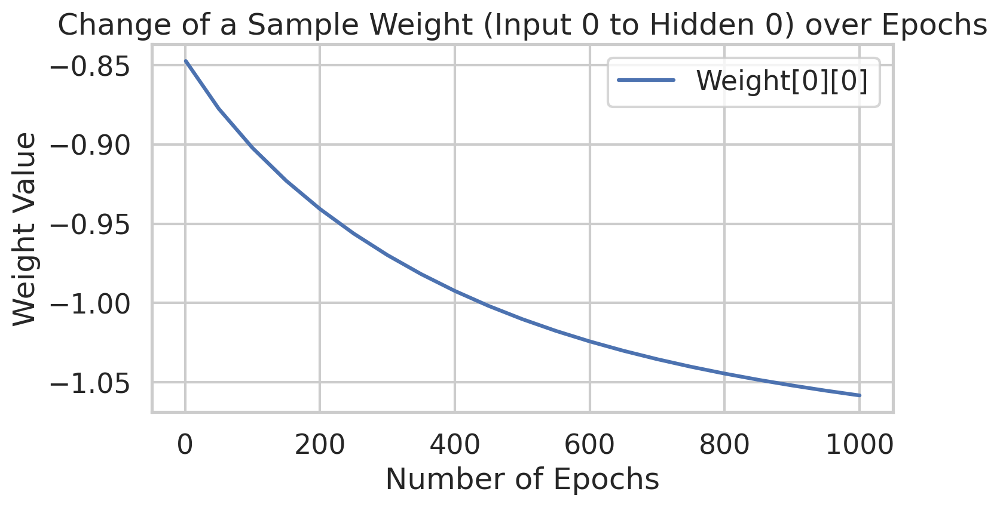

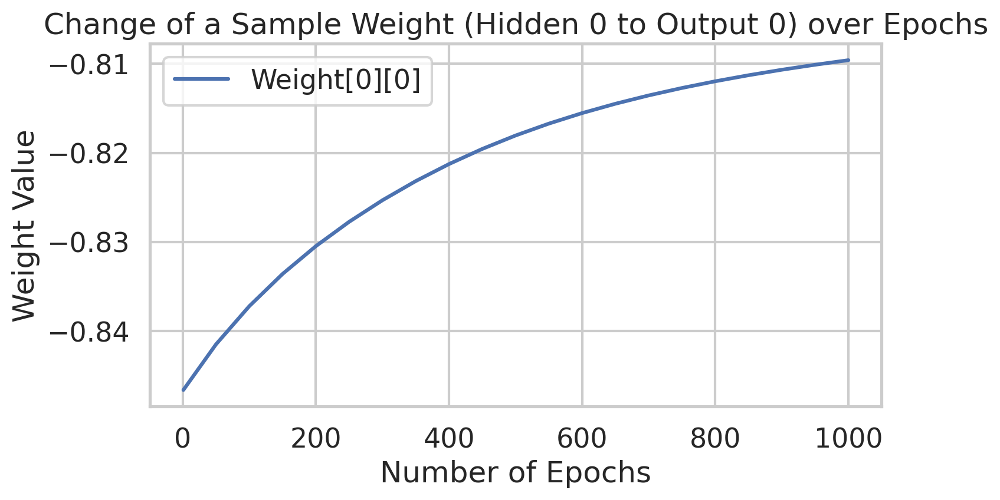

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


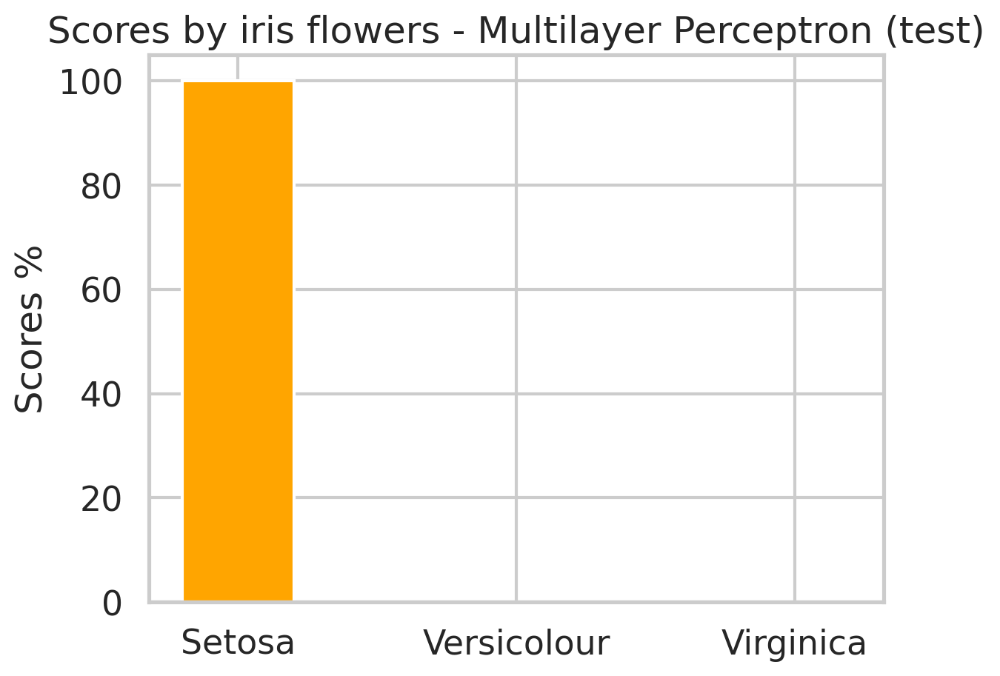

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


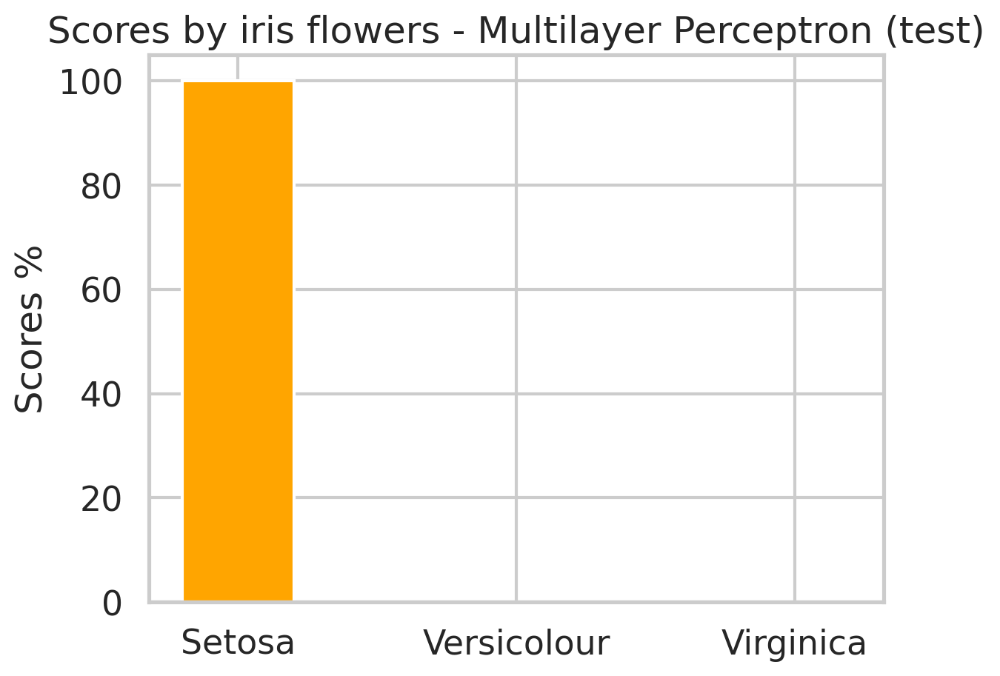

Trying parameters: {'HiddenLayer': 5, 'Epocas': 1000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.11133899397535113
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.0874458764374116
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.08745472572685109
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.08747179605956489
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.08749706277977555
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.08753068122638506
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.08106864393721037
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.08011178349884088
hits test 33.33333333333333
hits t

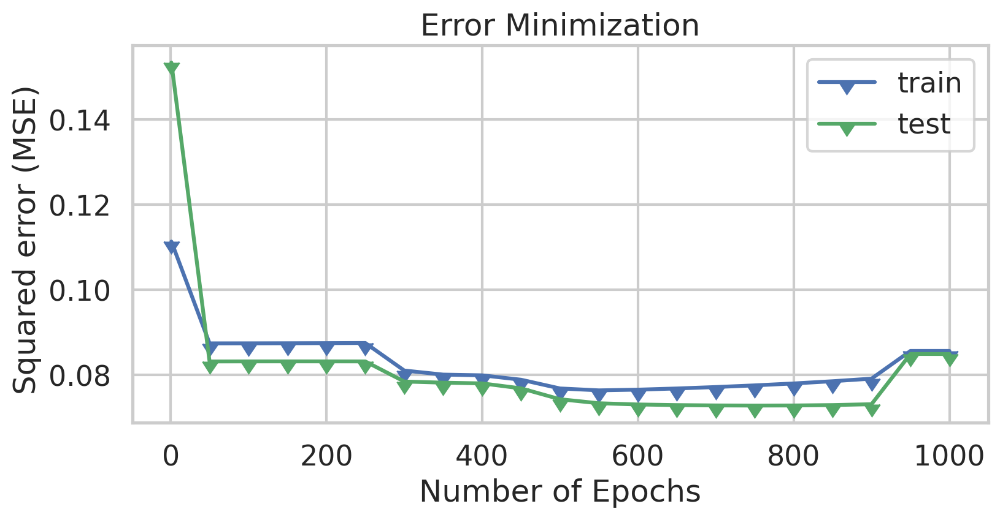

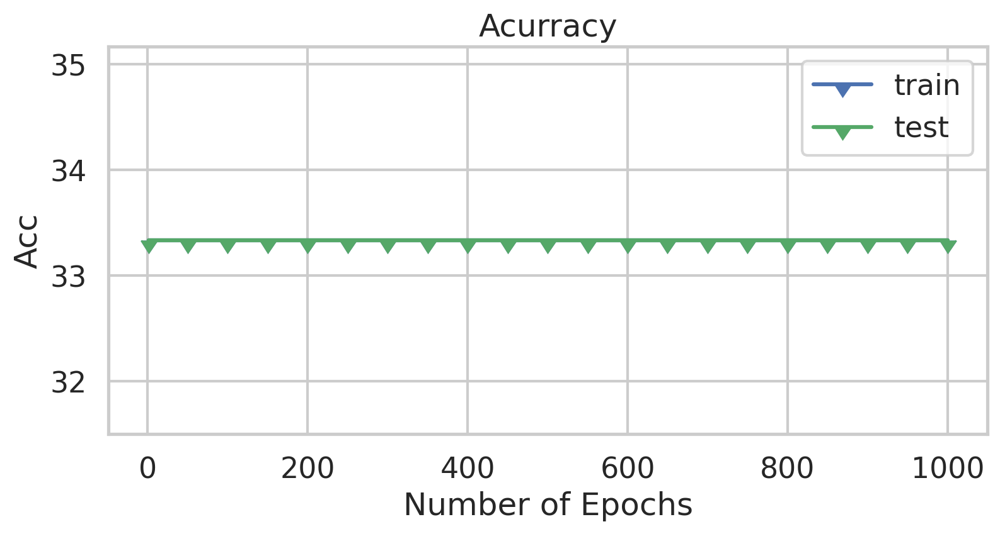

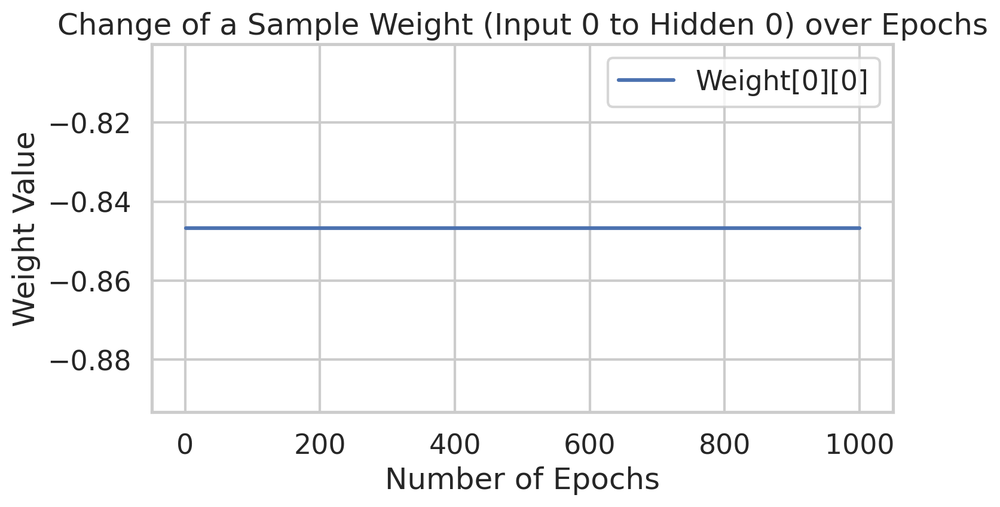

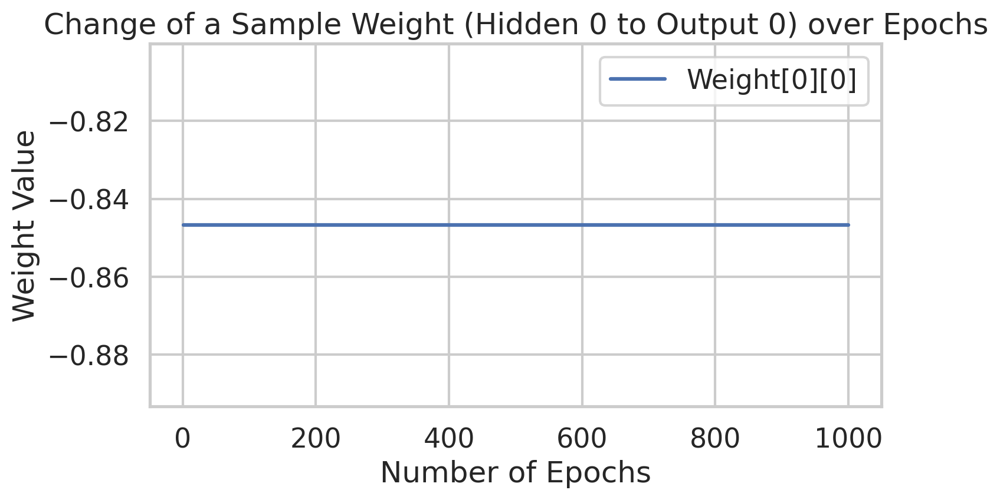

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


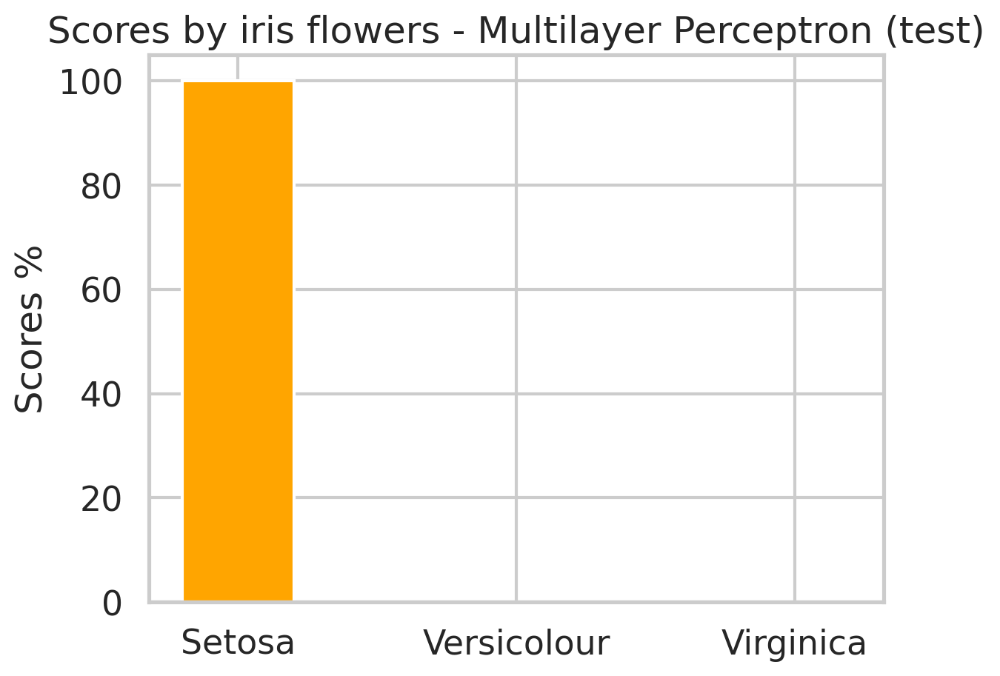

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


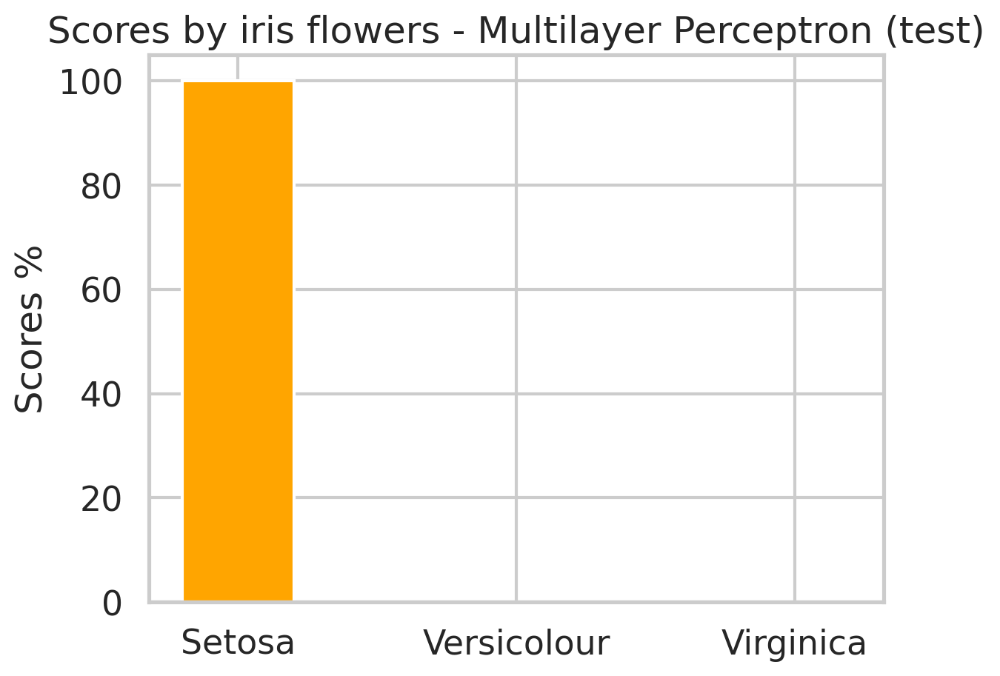

Trying parameters: {'HiddenLayer': 5, 'Epocas': 1000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.18851888618147852
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.12153464599772427
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06550274827600004
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.05933028138223925
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.054689814653289835
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.051171654865567774
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.04783615803033155
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.0446661603793413
hits test 33.33333333333333
hit

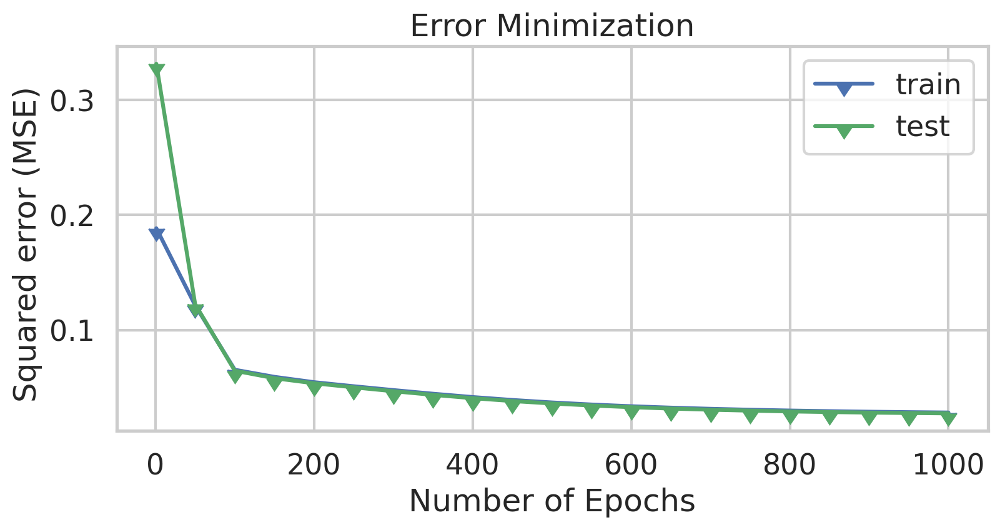

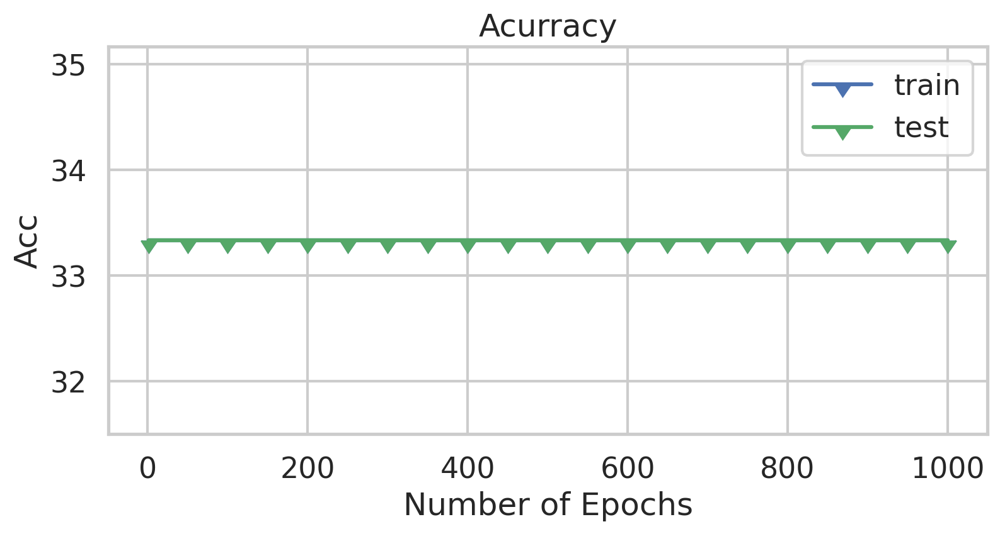

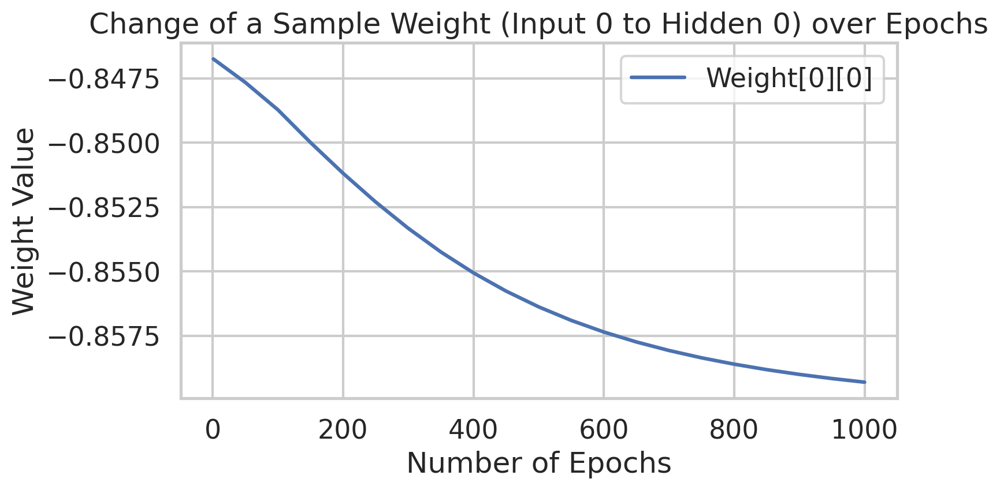

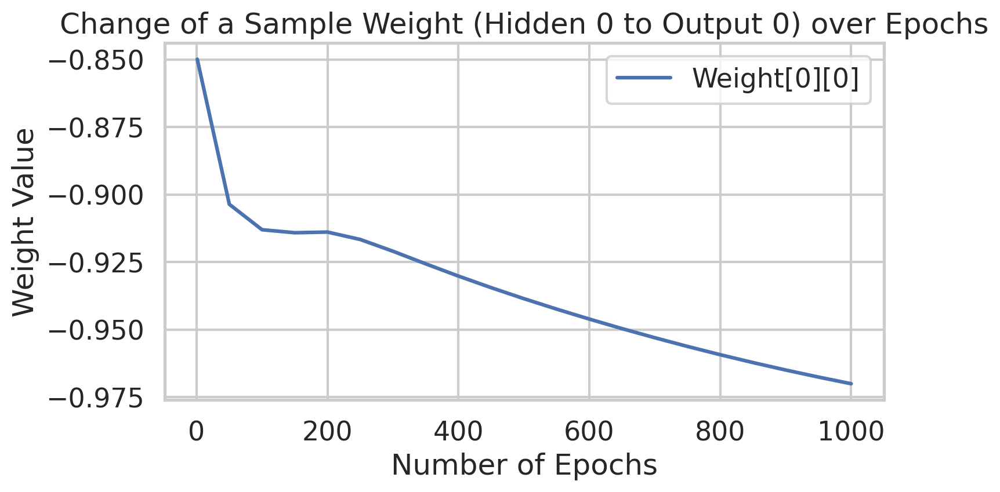

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


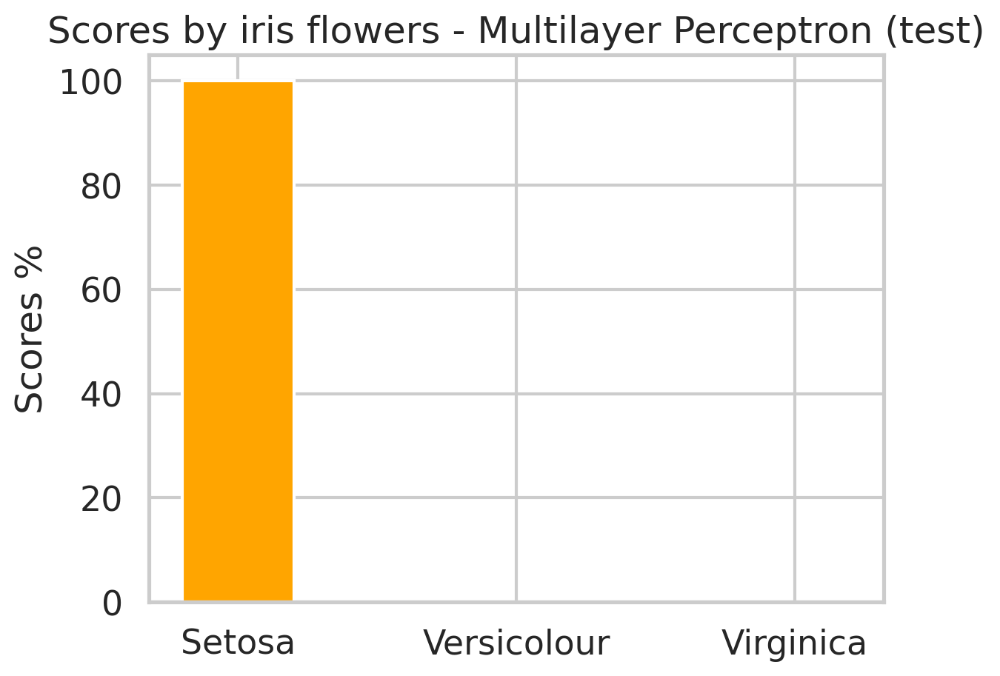

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


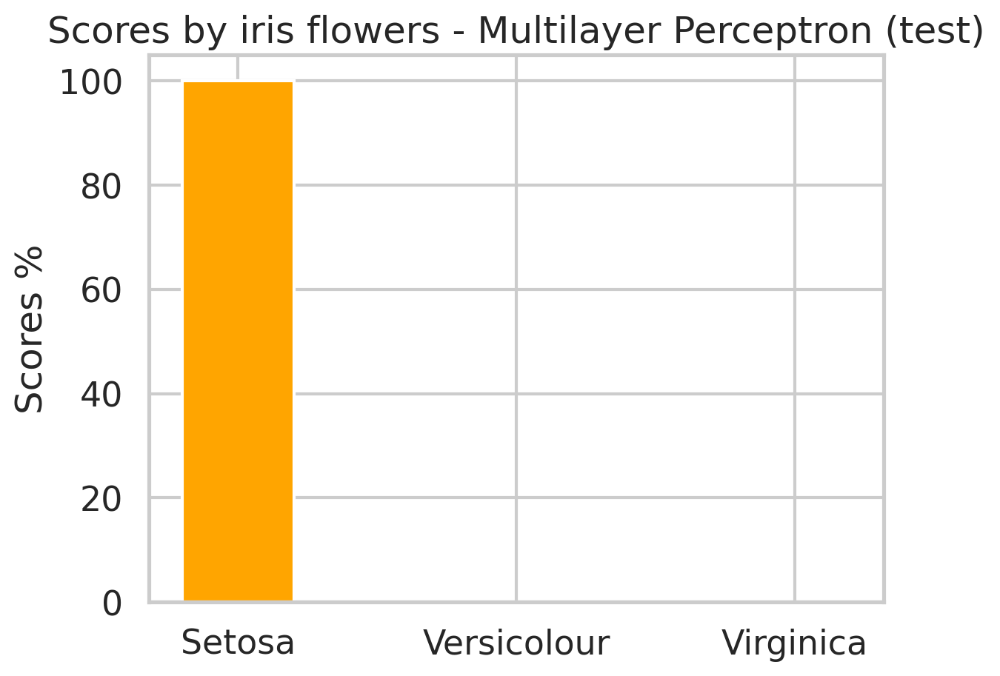

Trying parameters: {'HiddenLayer': 5, 'Epocas': 1000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.06967960493669281
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.06938141509029622
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06895407644233086
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.06857634789802394
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.06824154978923723
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.06794380186423034
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.06767794811209277
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.06743948200863614
hits test 33.33333333333333
h

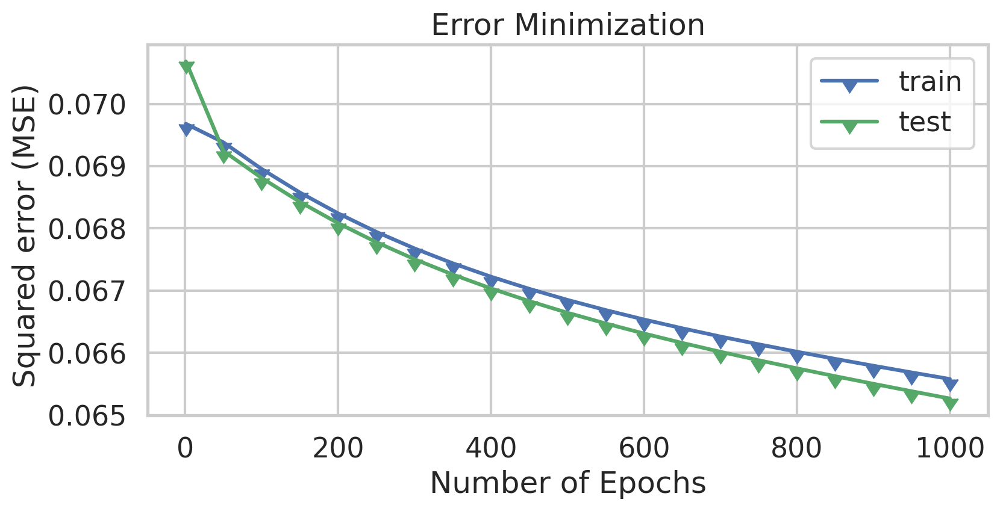

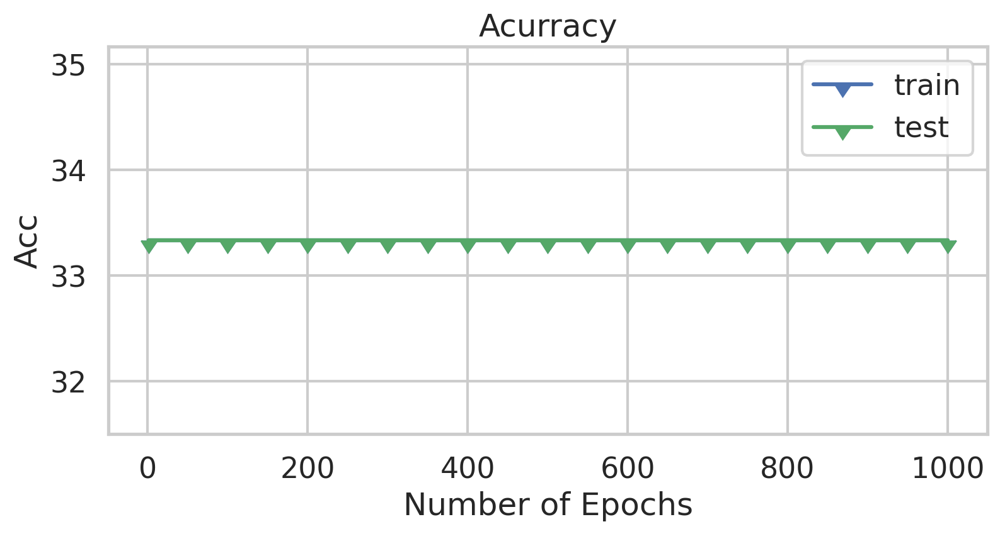

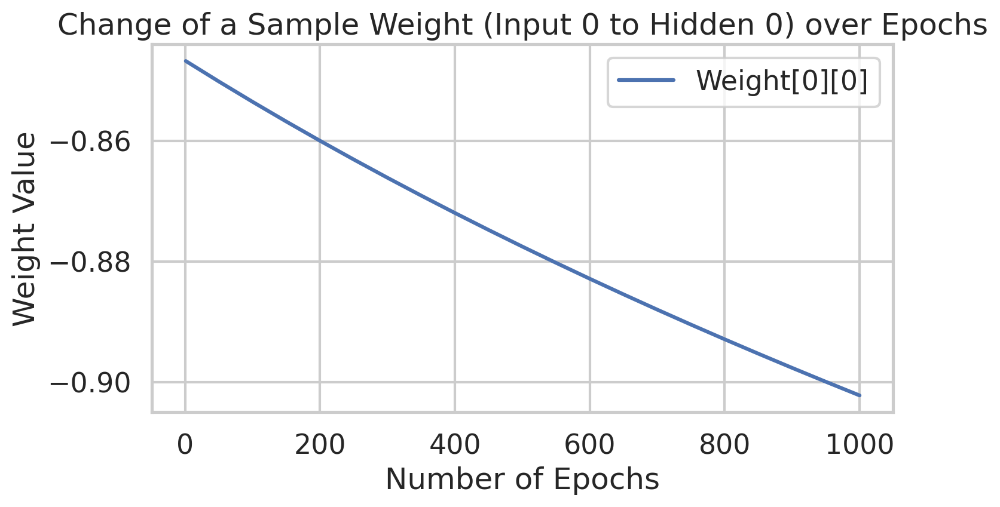

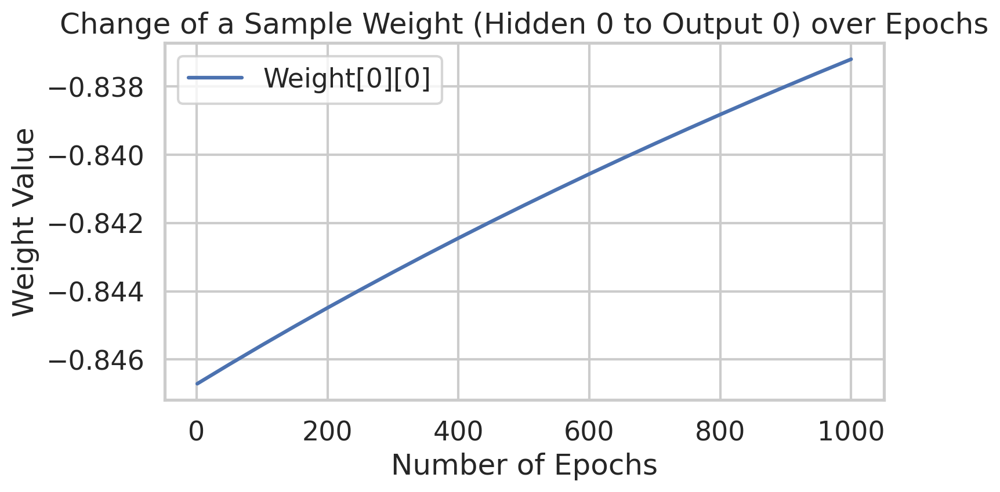

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


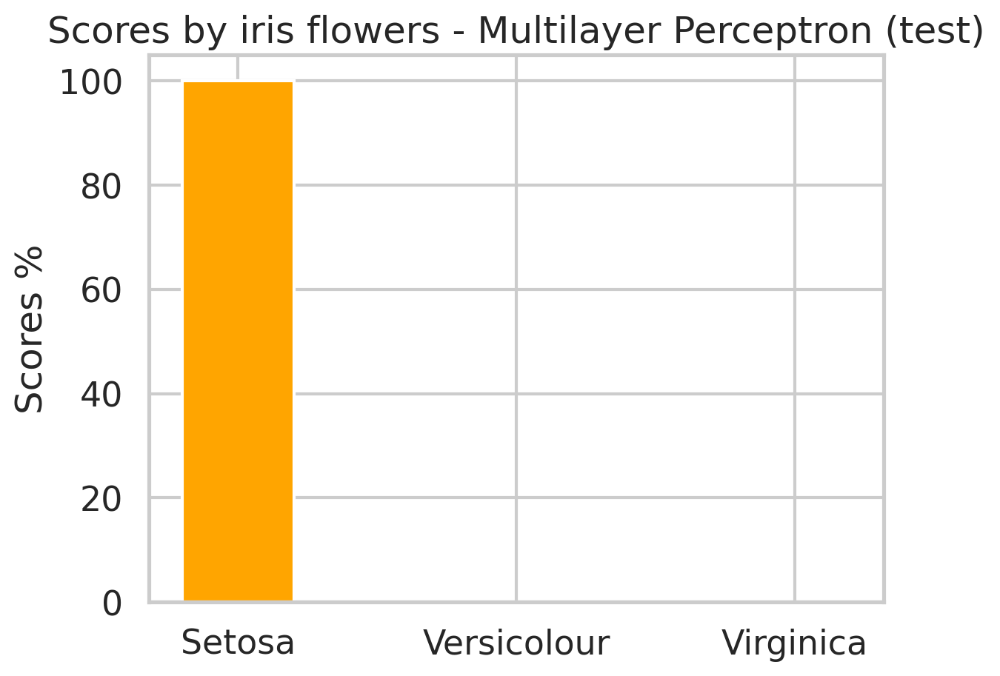

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


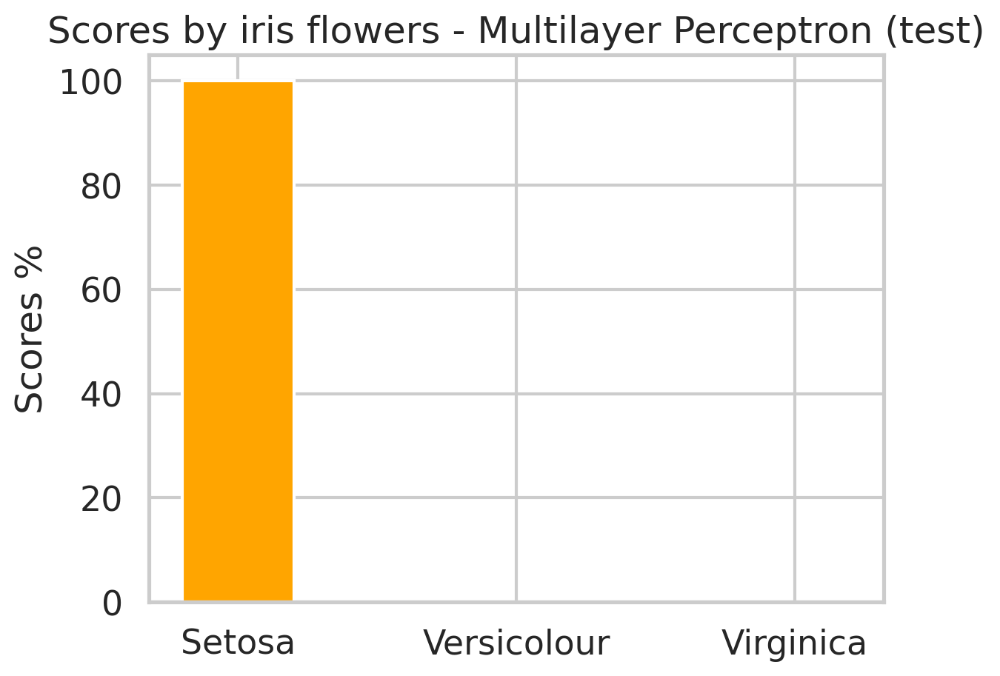

Trying parameters: {'HiddenLayer': 5, 'Epocas': 1000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.21618797396229972
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.07985862955381666
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.07943775845399763
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.07926843386927682
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.07908799689071627
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.07892675882239354
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.07879166531667992
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.07868113979138434
hits test 33.33333333333333
hits

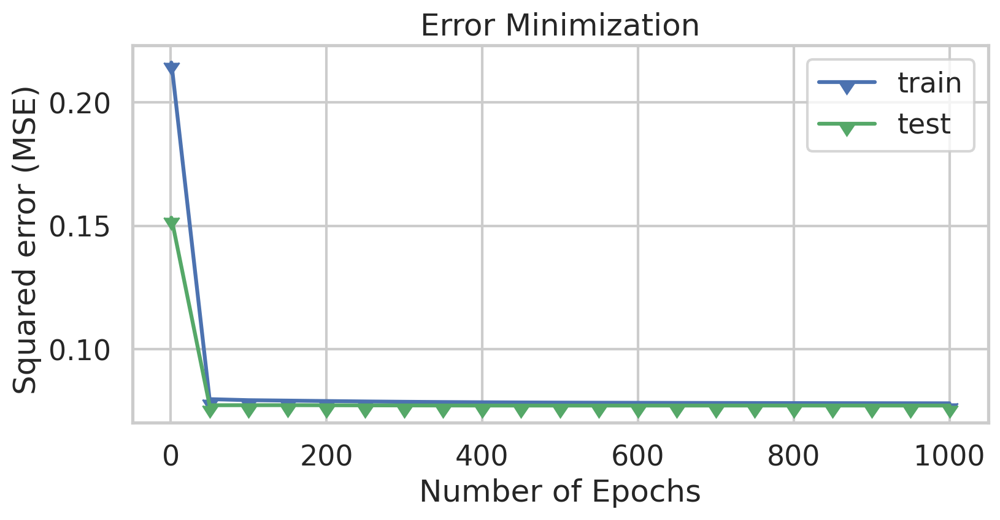

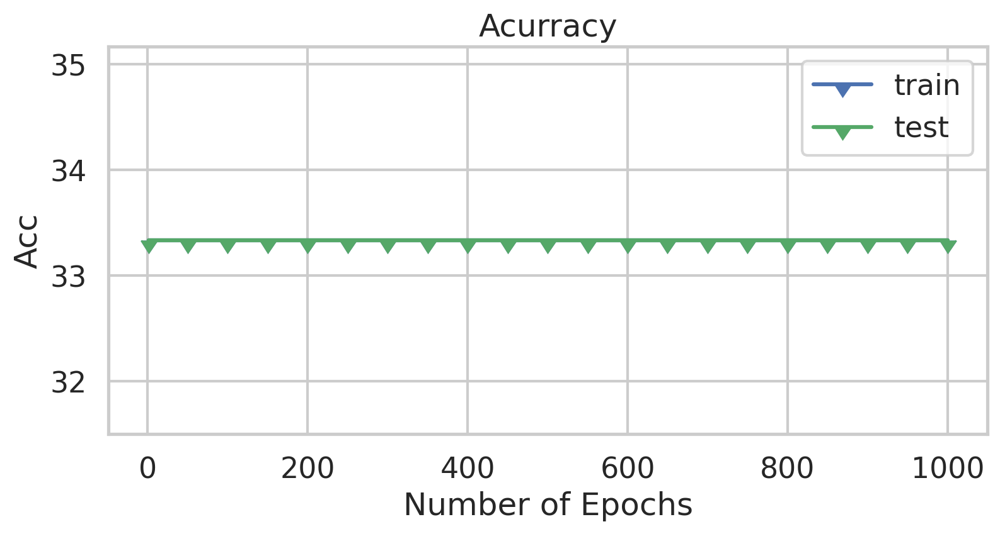

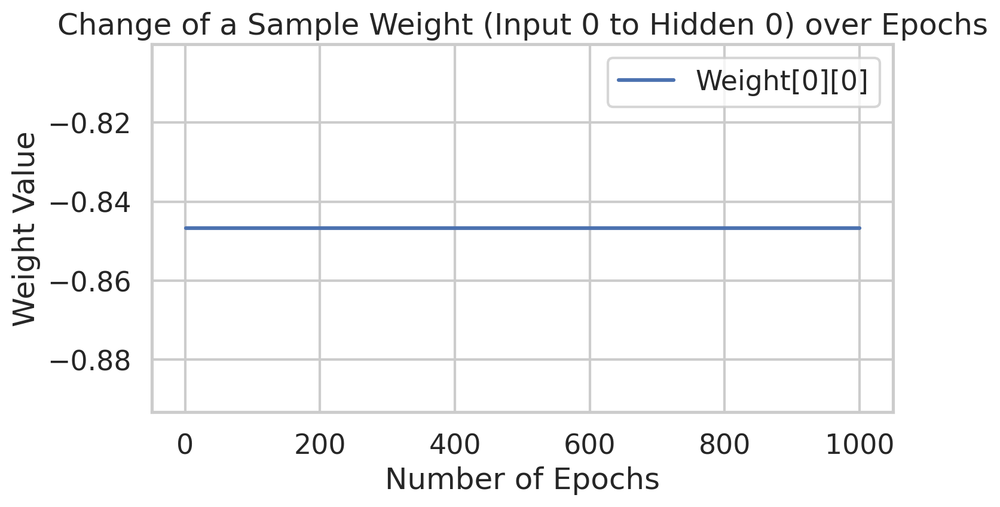

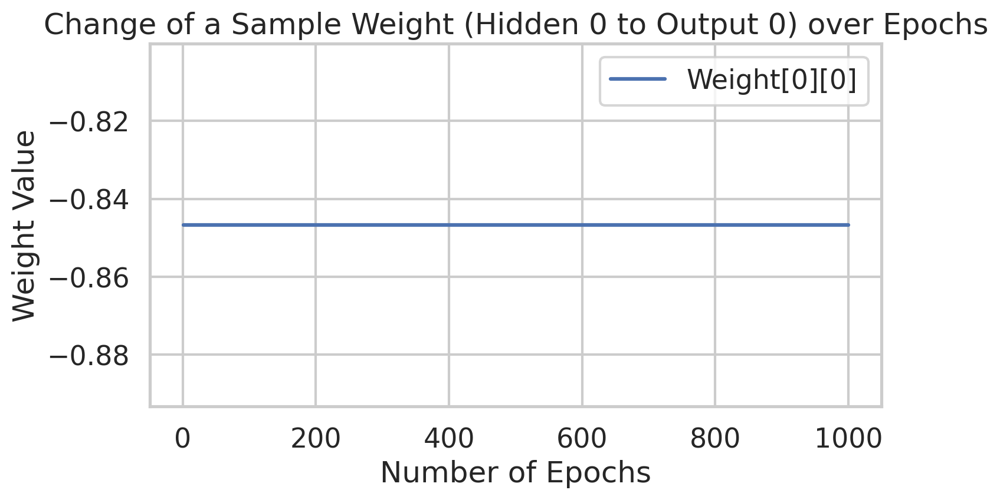

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


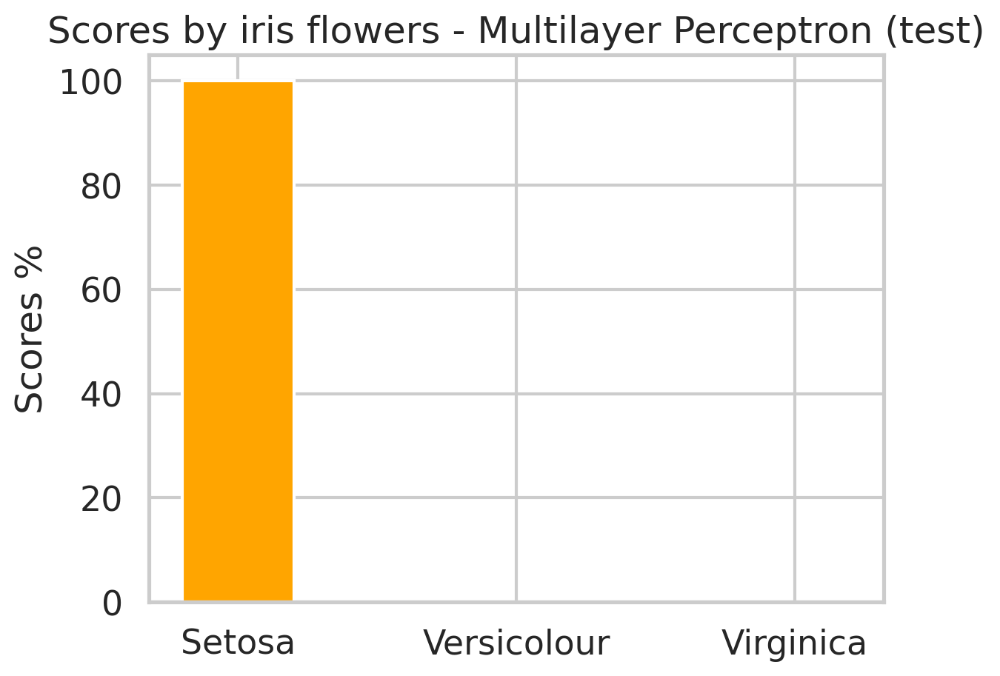

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


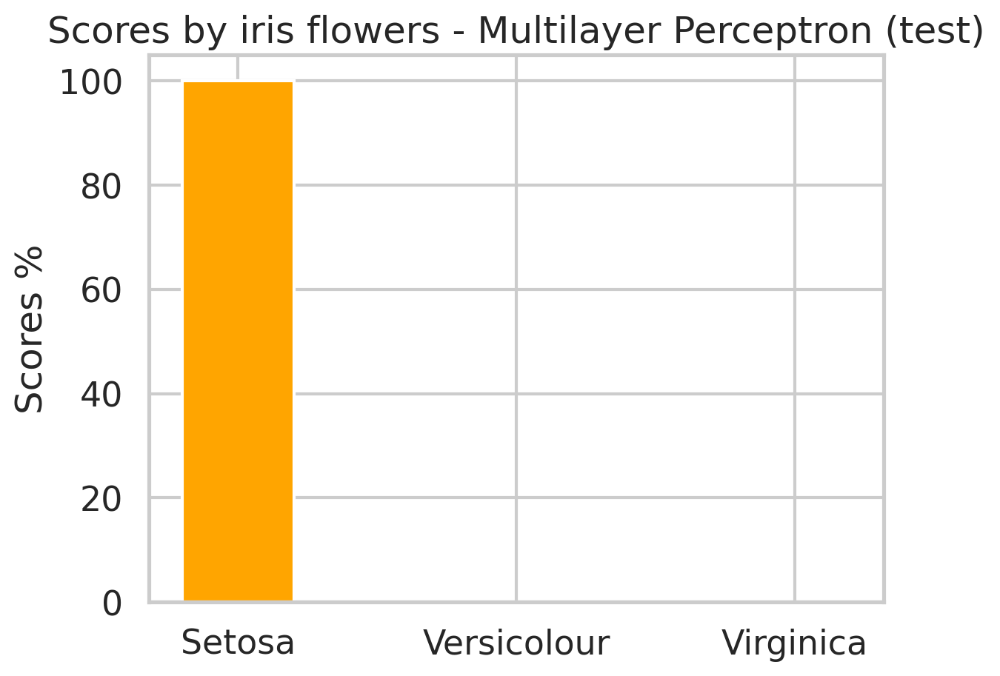

Trying parameters: {'HiddenLayer': 5, 'Epocas': 3000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.18219397599861742
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.03734692309765312
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.028405285783317868
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.02698416527577431
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.026492554807196766
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.02619372799749686
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.02598299606299375
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.025821183456727712
hits test 33.33333333333333
hi

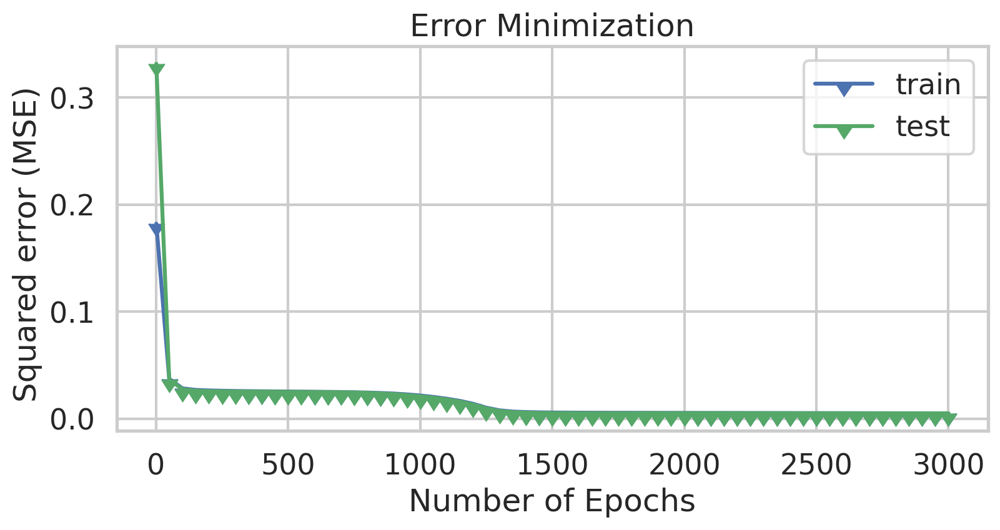

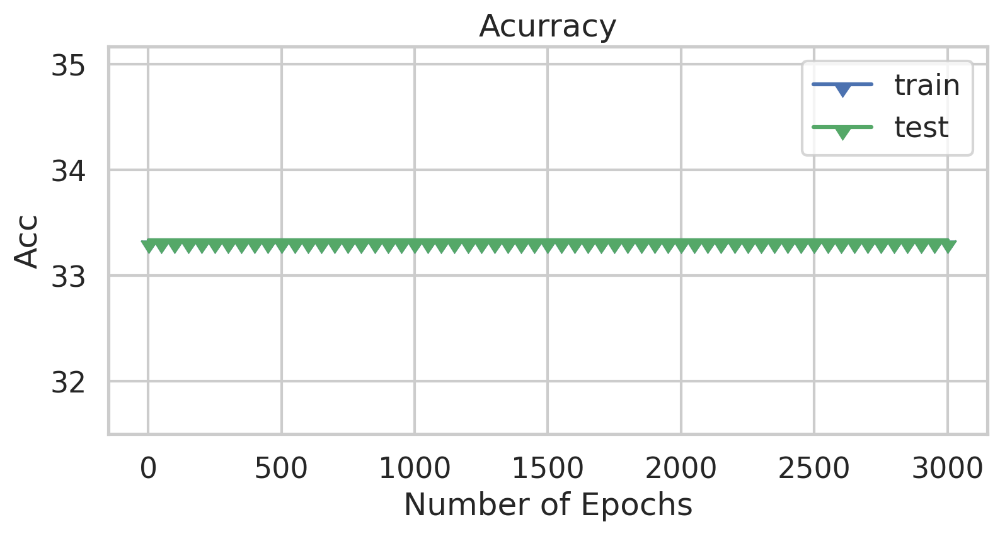

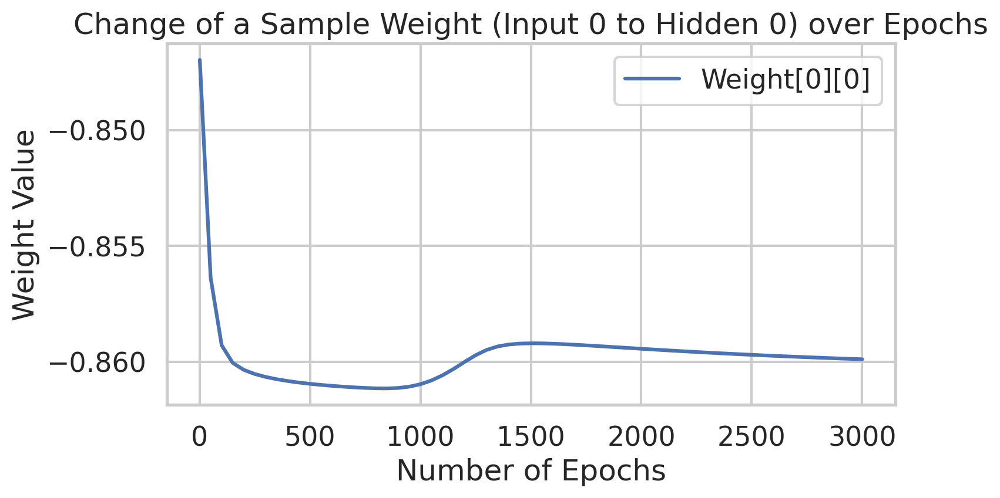

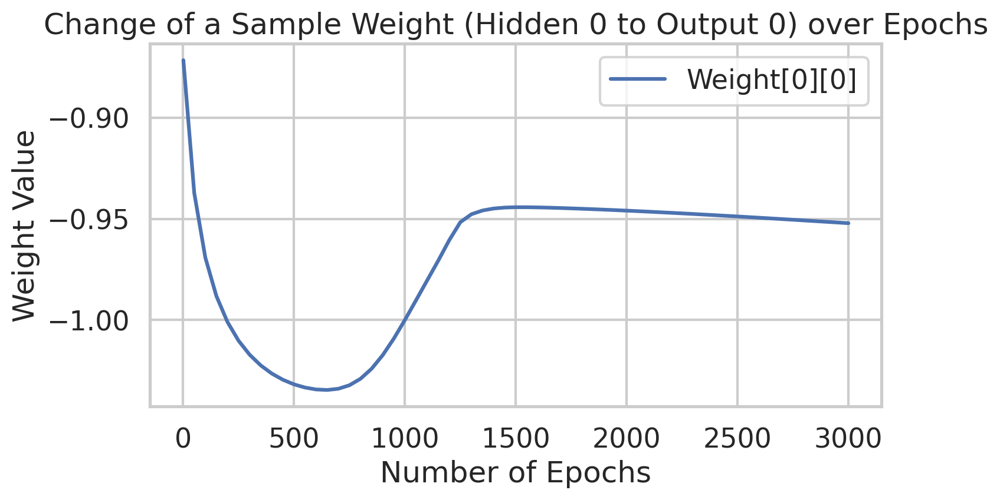

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


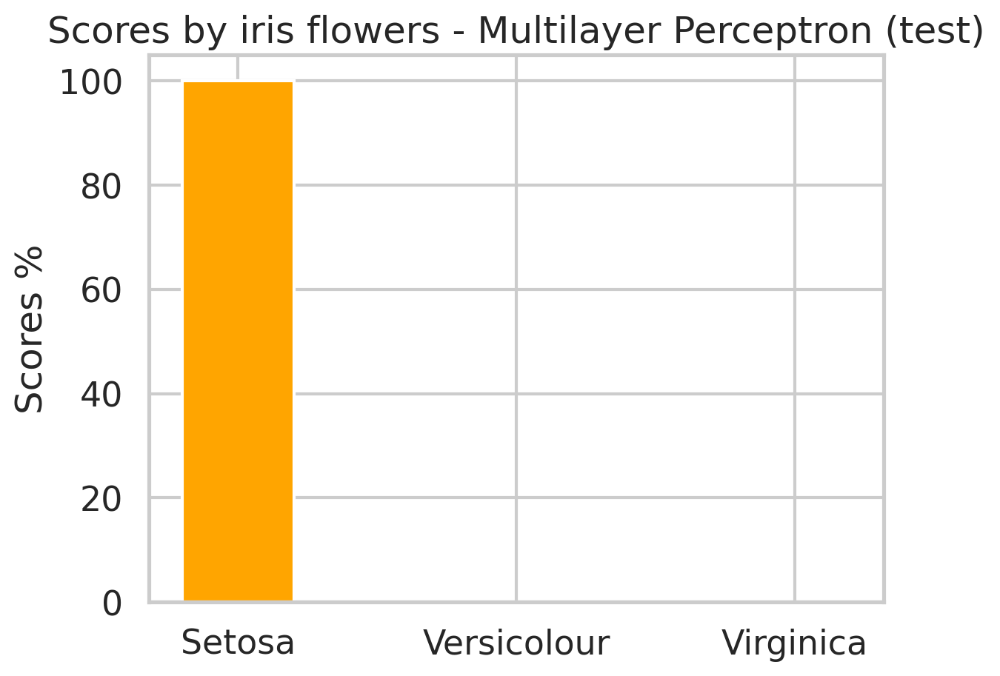

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


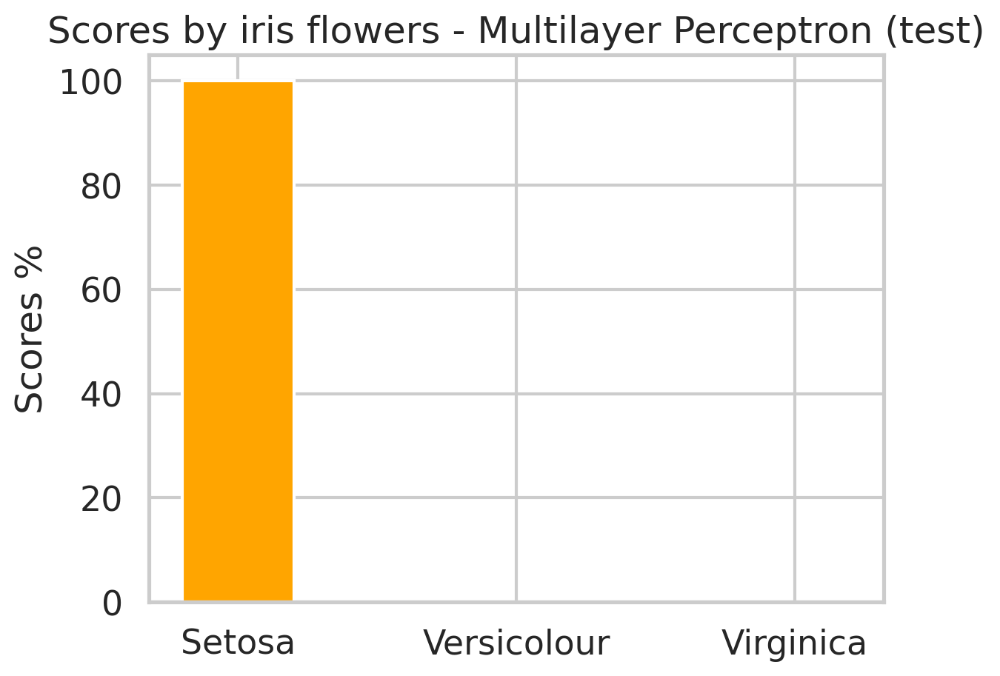

Trying parameters: {'HiddenLayer': 5, 'Epocas': 3000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.06964639109867243
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.06687532608199995
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06559897988736976
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.06458259563767342
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.06347669961687946
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.0621435651417964
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.060498632352632024
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.05853553575941271
hits test 33.33333333333333
hi

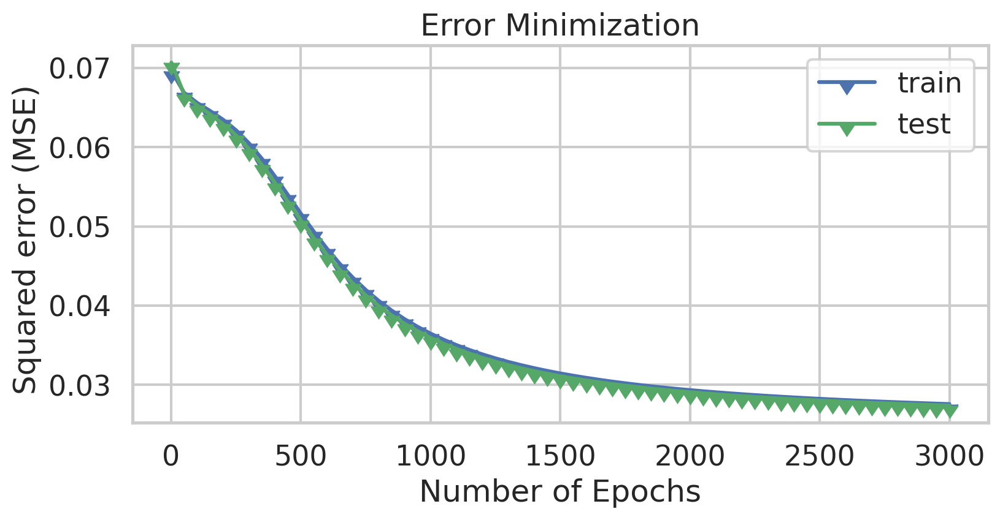

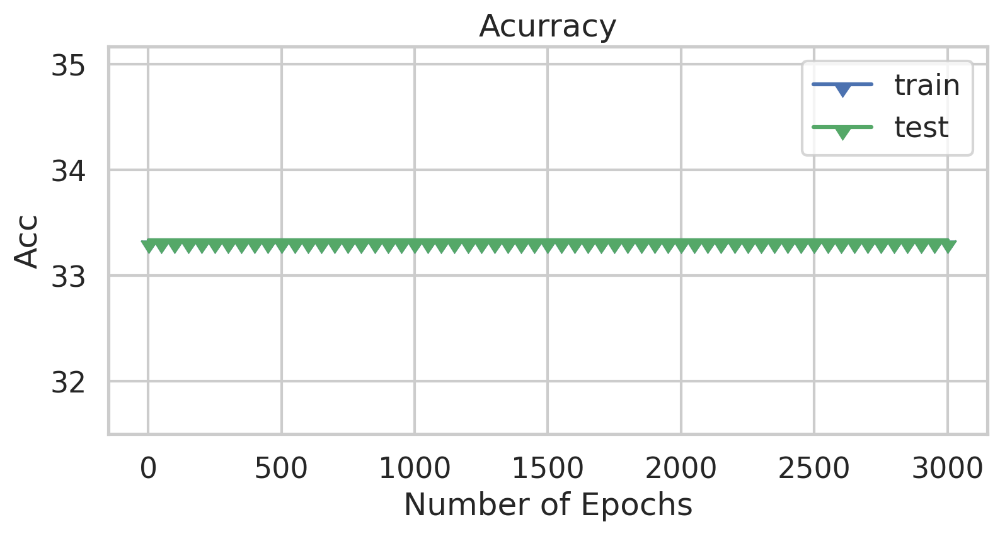

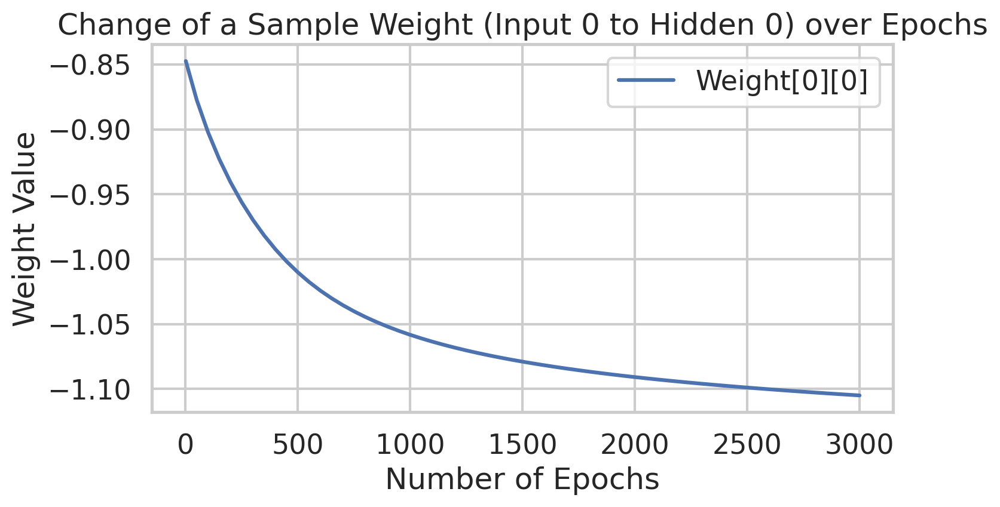

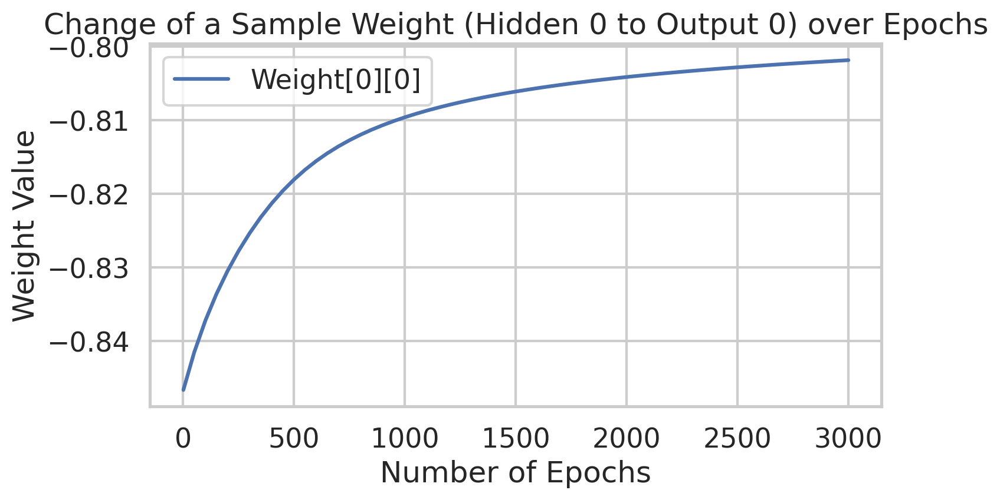

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


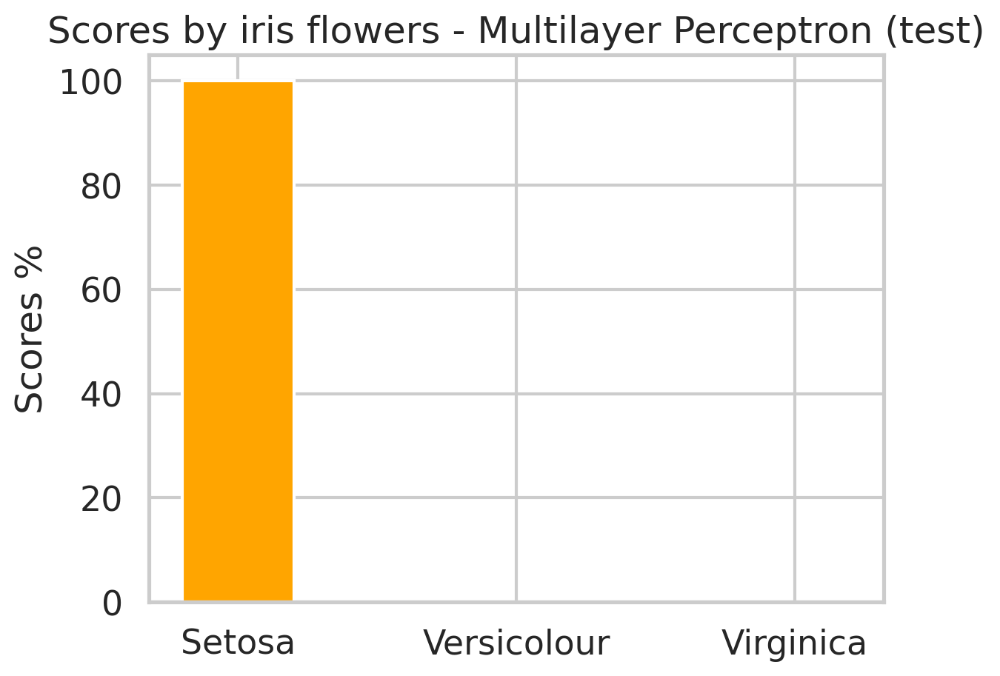

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


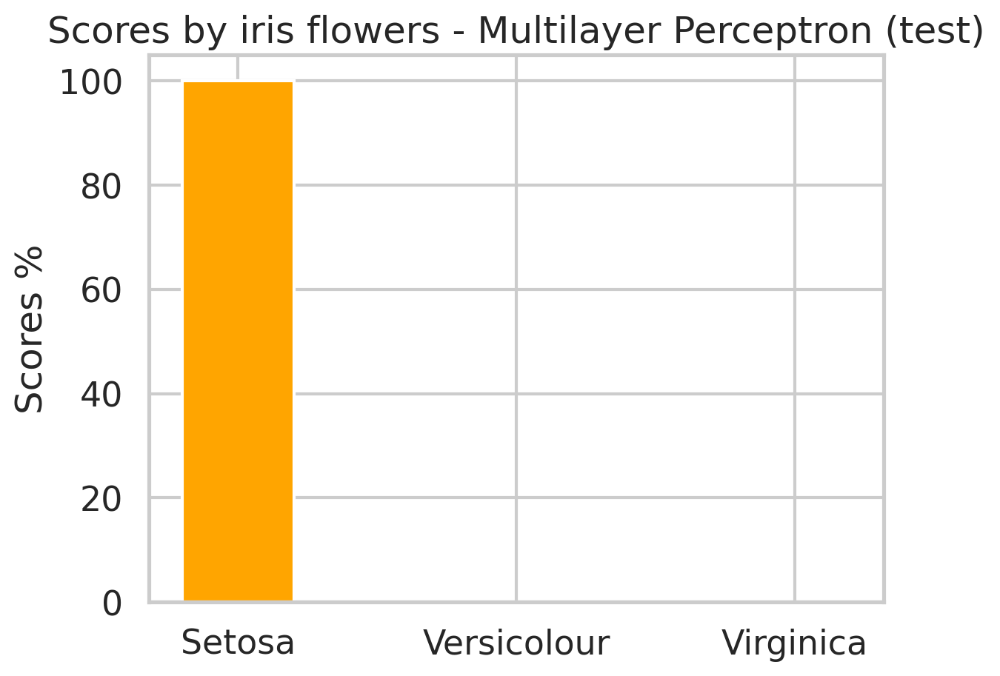

Trying parameters: {'HiddenLayer': 5, 'Epocas': 3000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.11133899397535113
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.0874458764374116
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.08745472572685109
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.08747179605956489
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.08749706277977555
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.08753068122638506
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.08106864393721037
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.08011178349884088
hits test 33.33333333333333
hits t

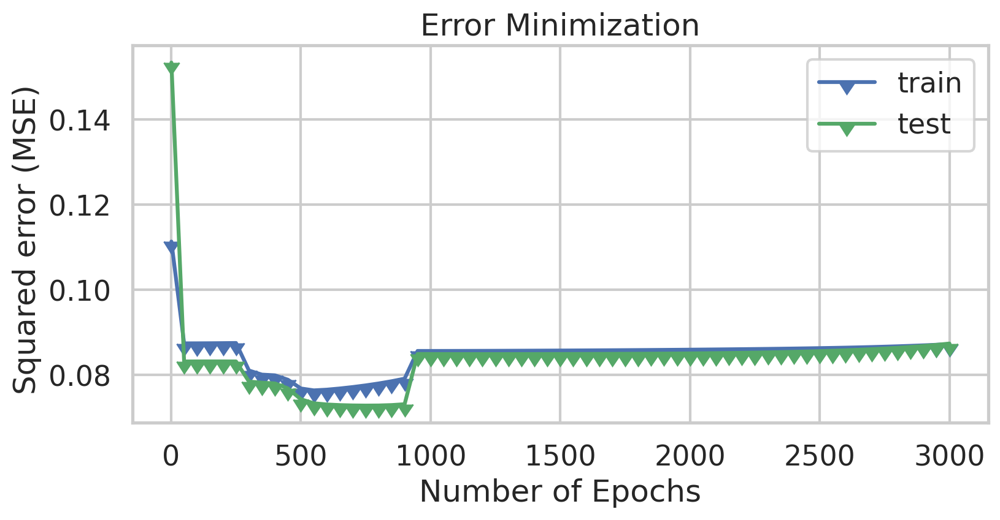

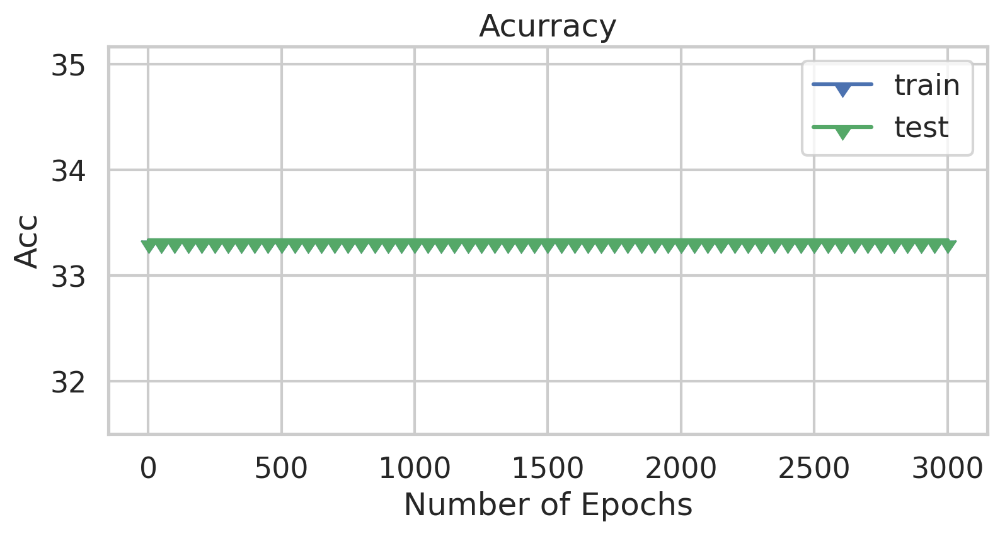

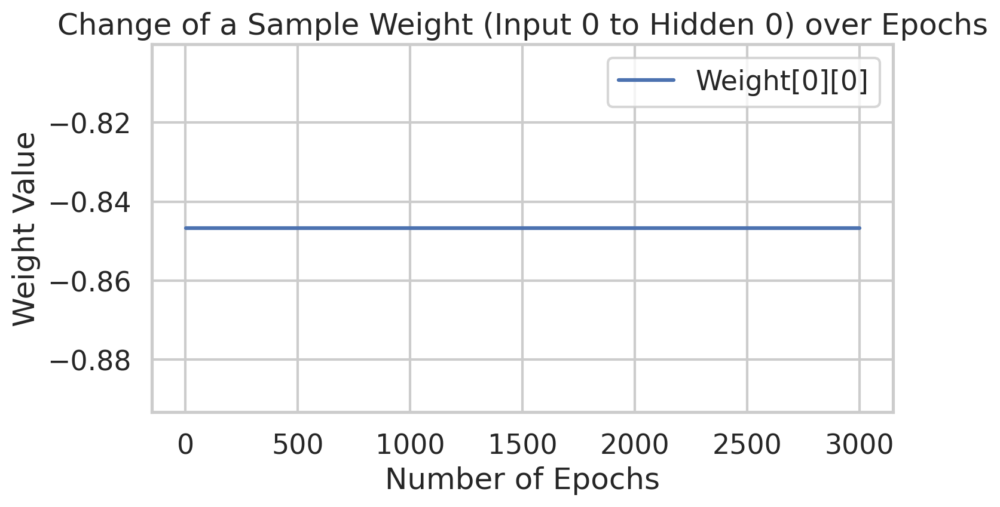

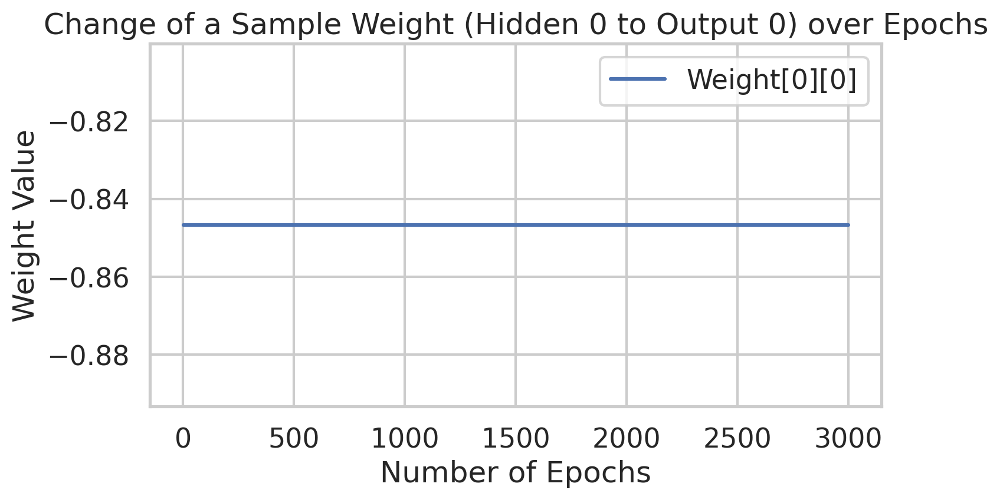

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


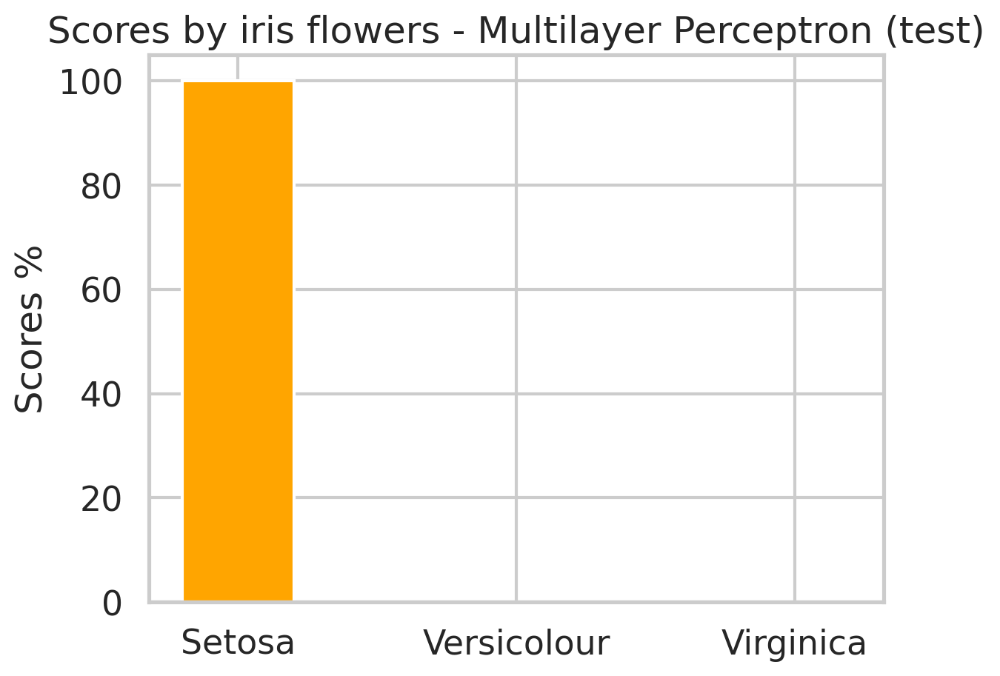

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


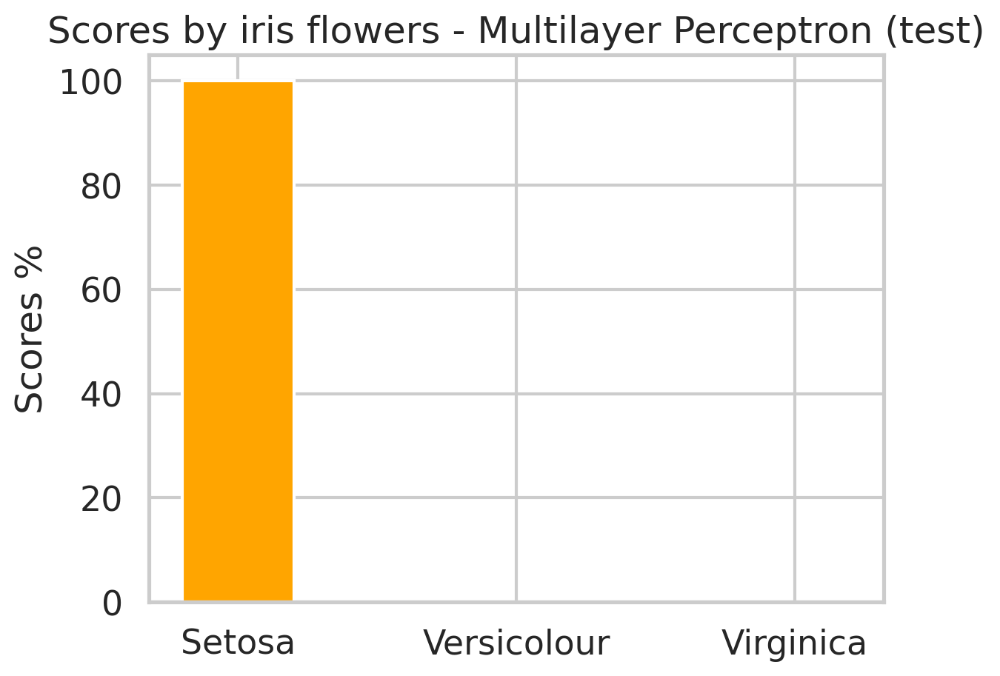

Trying parameters: {'HiddenLayer': 5, 'Epocas': 3000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.18851888618147852
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.12153464599772427
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06550274827600004
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.05933028138223925
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.054689814653289835
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.051171654865567774
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.04783615803033155
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.0446661603793413
hits test 33.33333333333333
hit

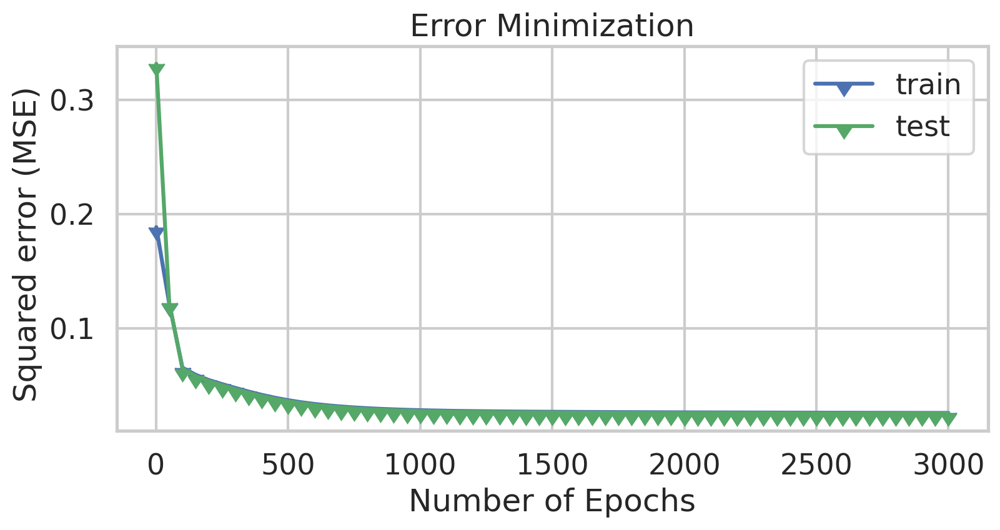

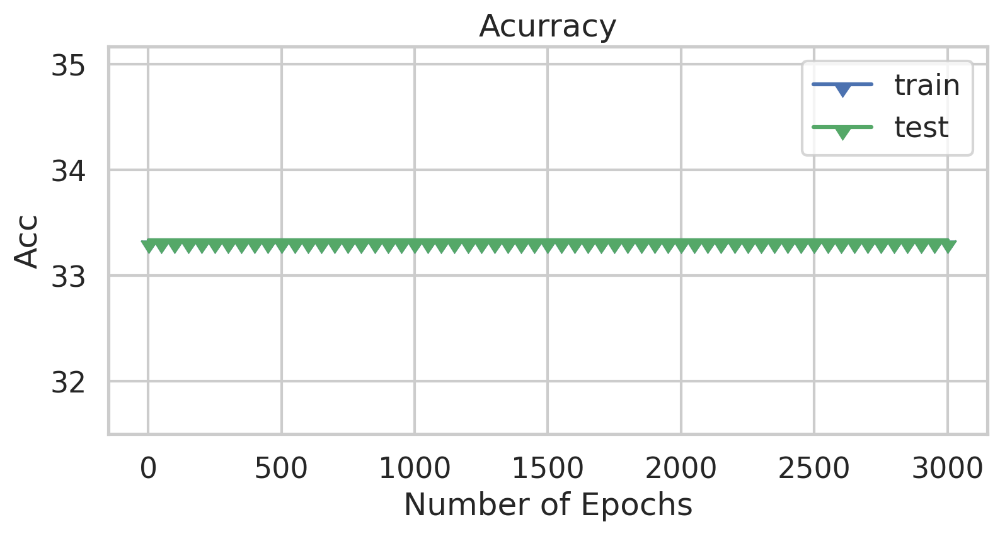

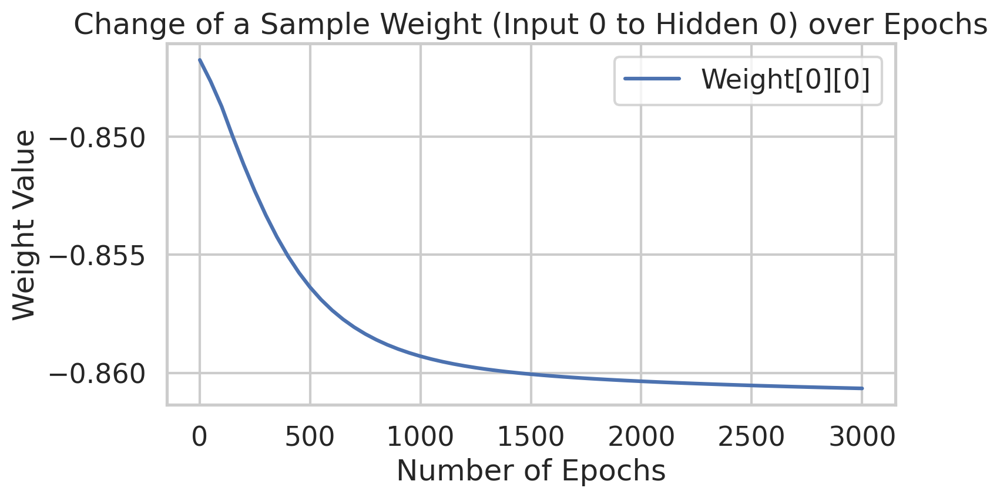

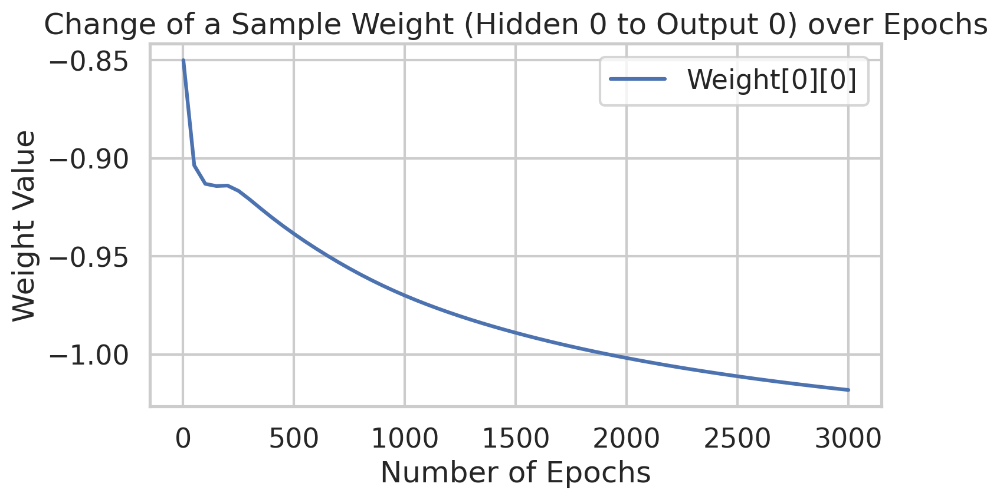

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


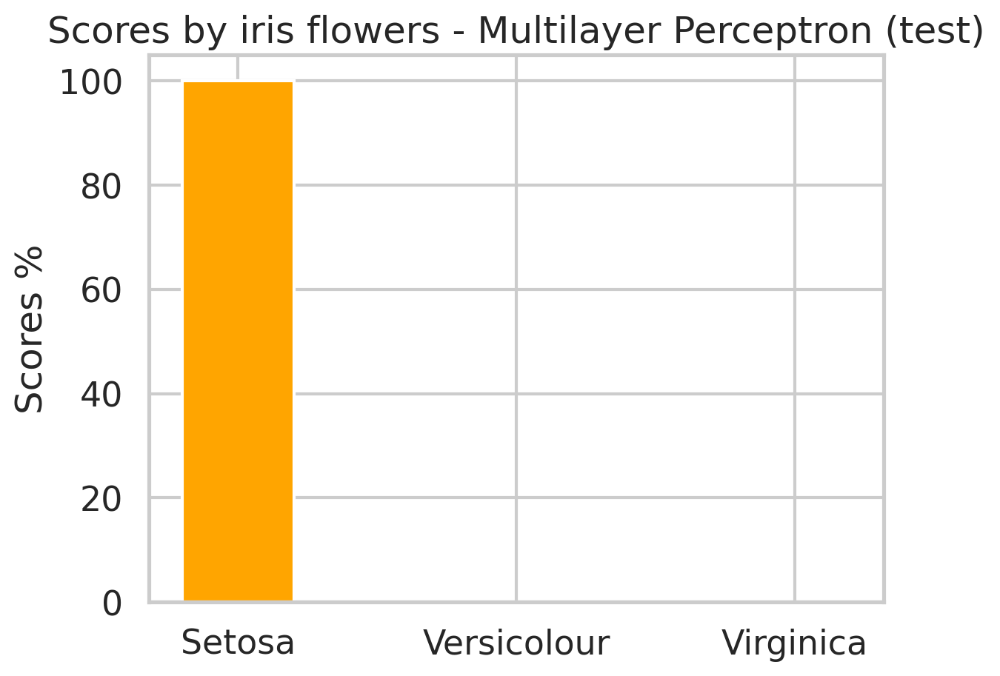

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


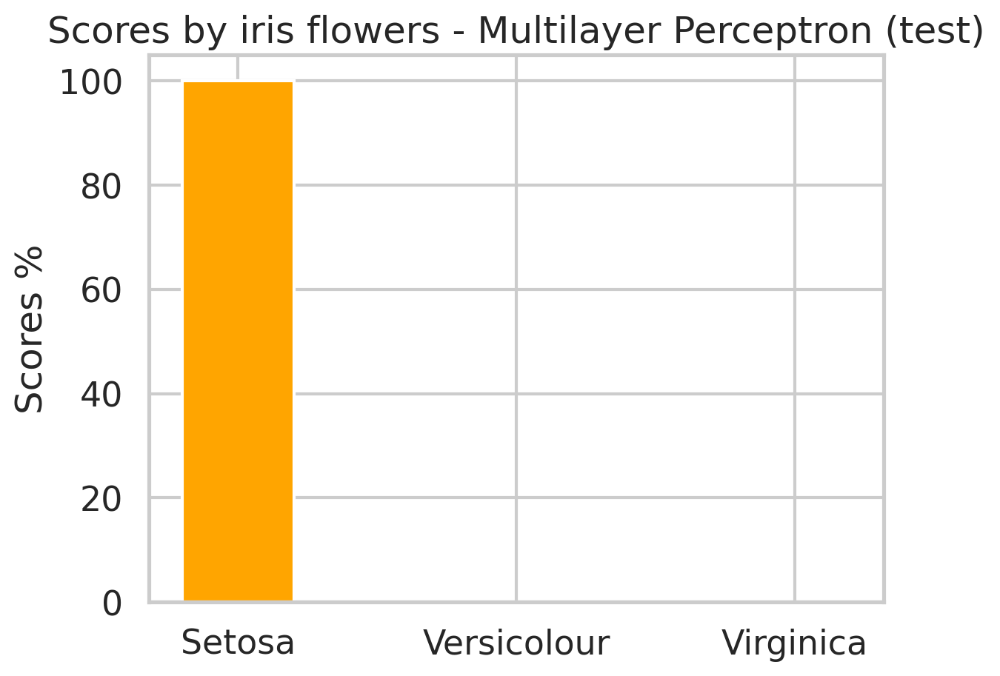

Trying parameters: {'HiddenLayer': 5, 'Epocas': 3000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.06967960493669281
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.06938141509029622
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06895407644233086
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.06857634789802394
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.06824154978923723
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.06794380186423034
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.06767794811209277
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.06743948200863614
hits test 33.33333333333333
h

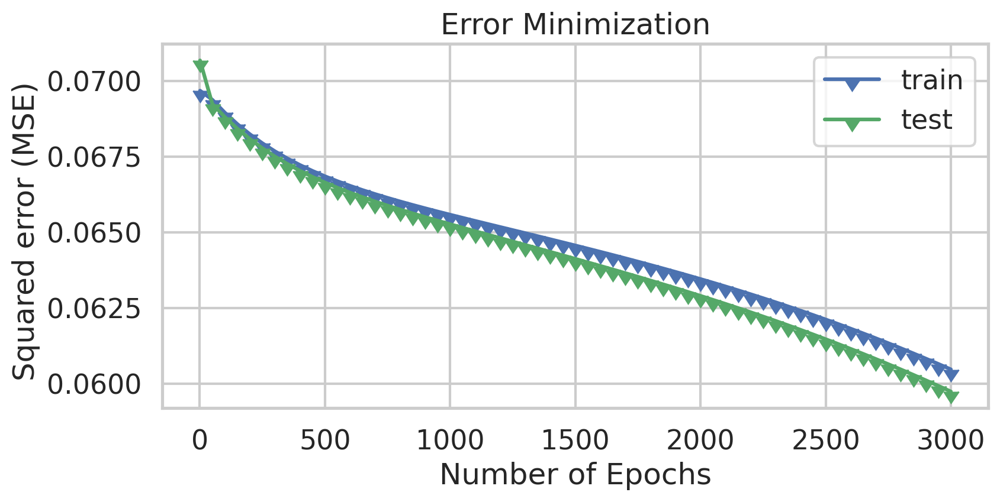

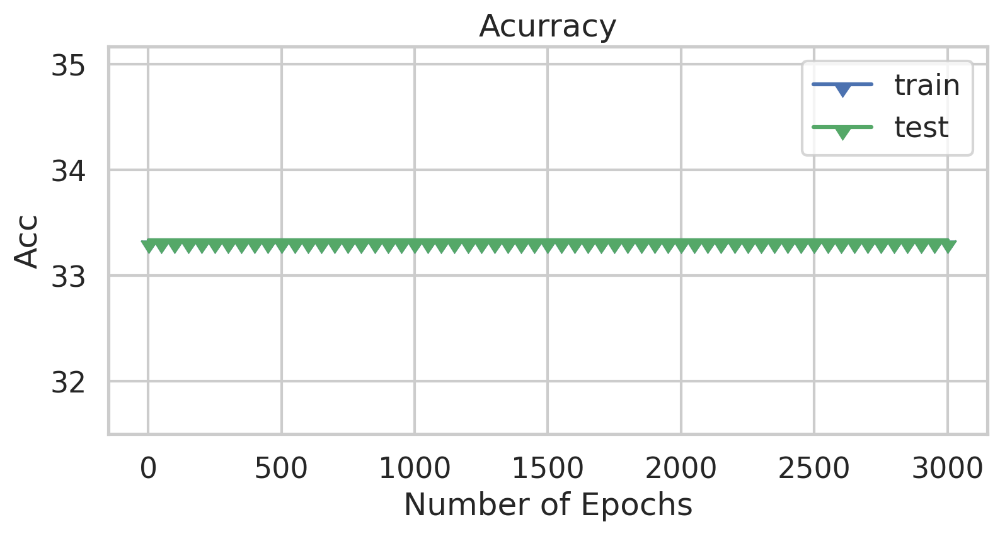

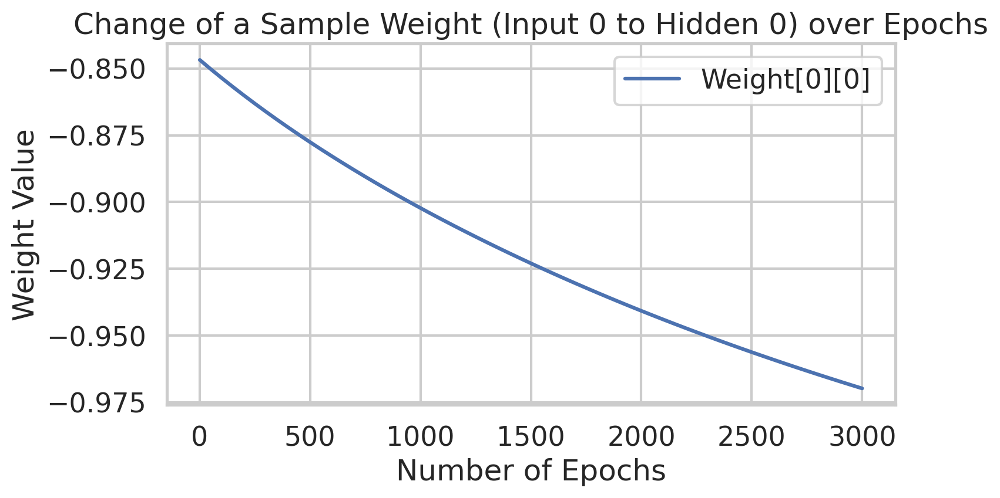

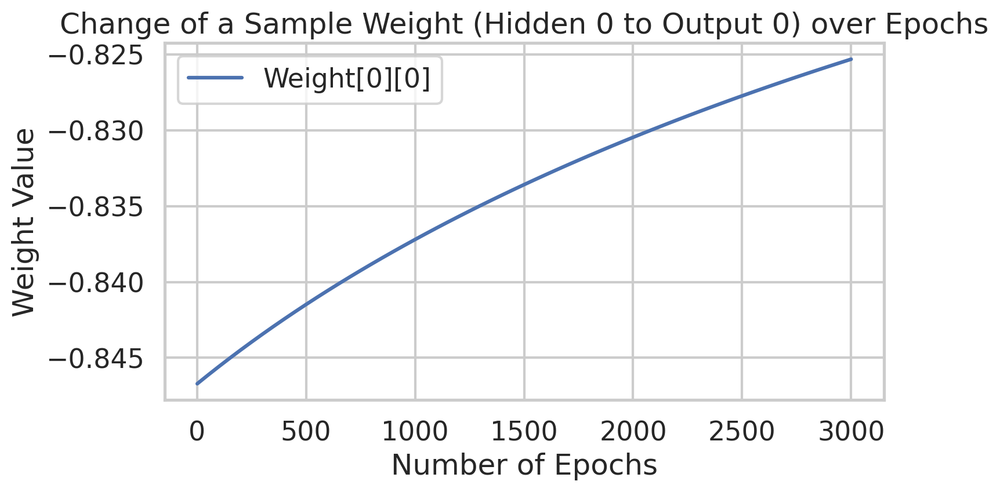

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


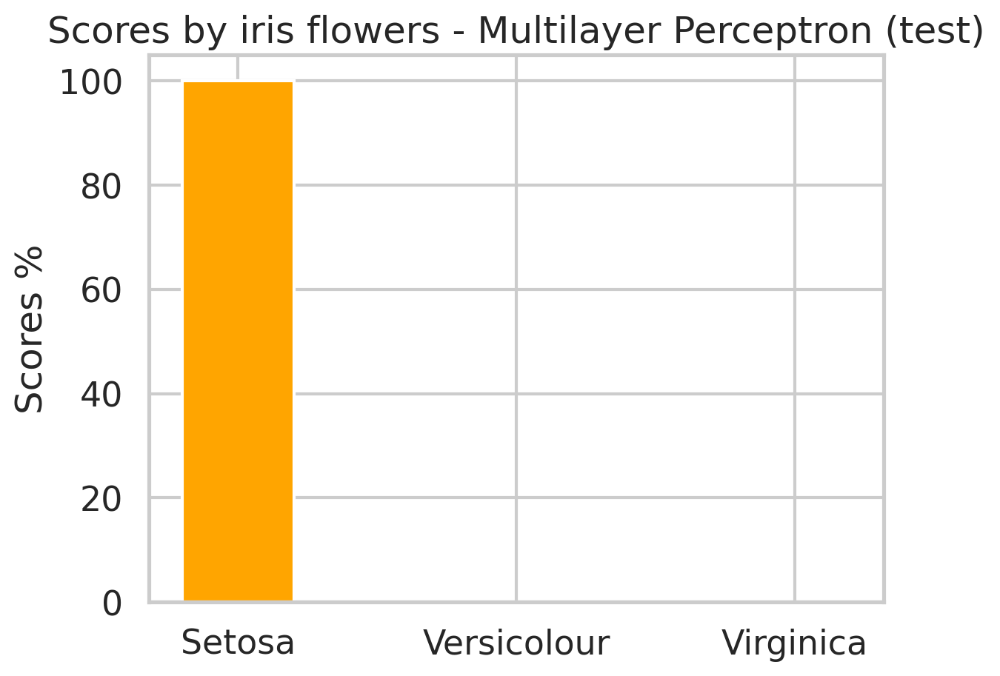

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


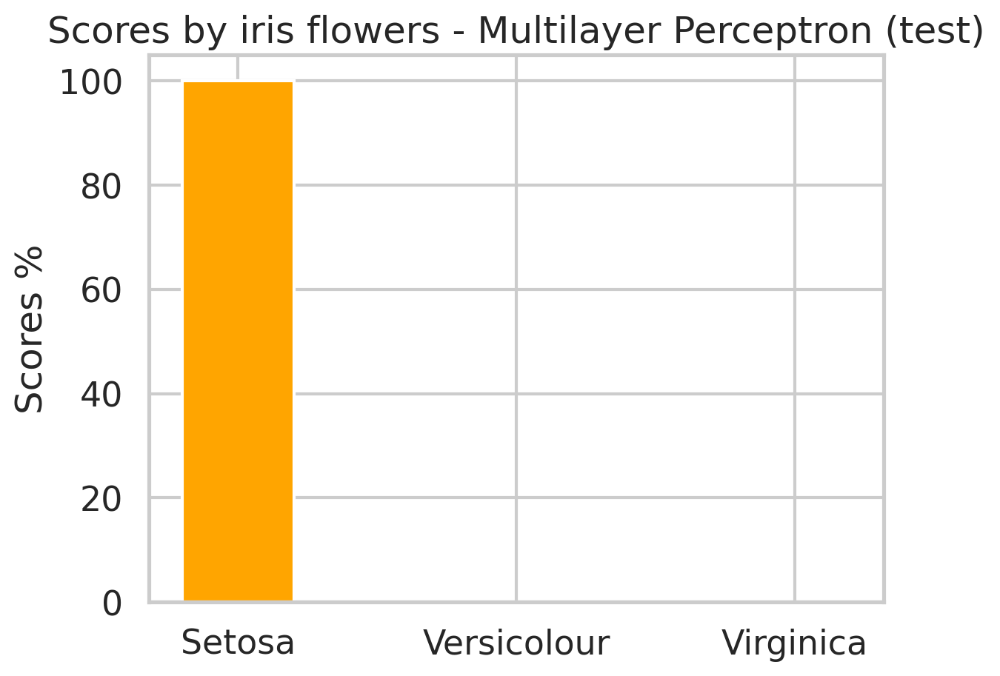

Trying parameters: {'HiddenLayer': 5, 'Epocas': 3000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.21618797396229972
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.07985862955381666
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.07943775845399763
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.07926843386927682
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.07908799689071627
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.07892675882239354
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.07879166531667992
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.07868113979138434
hits test 33.33333333333333
hits

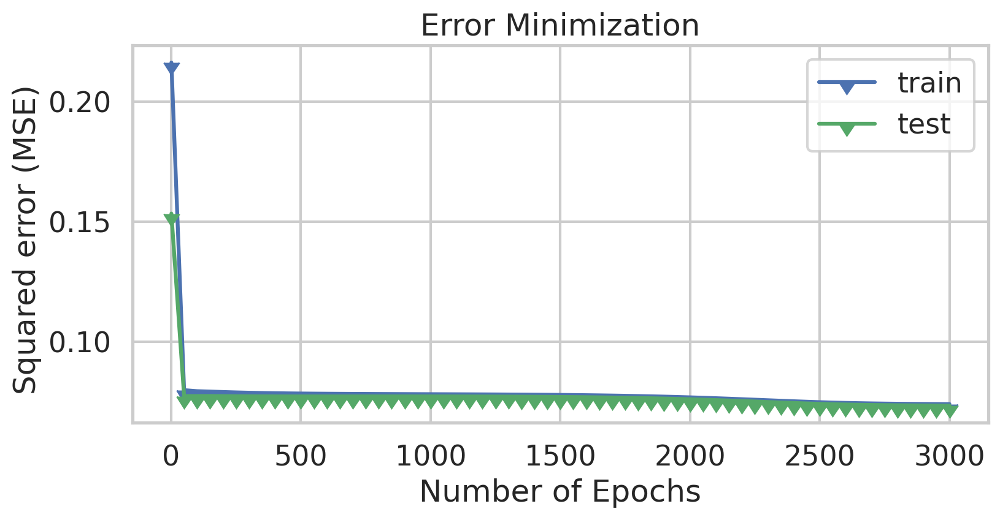

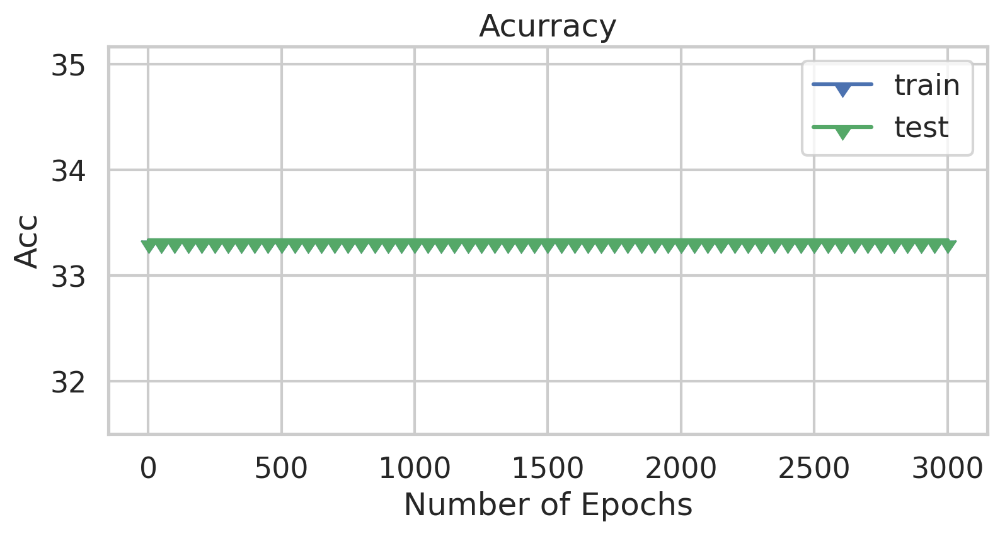

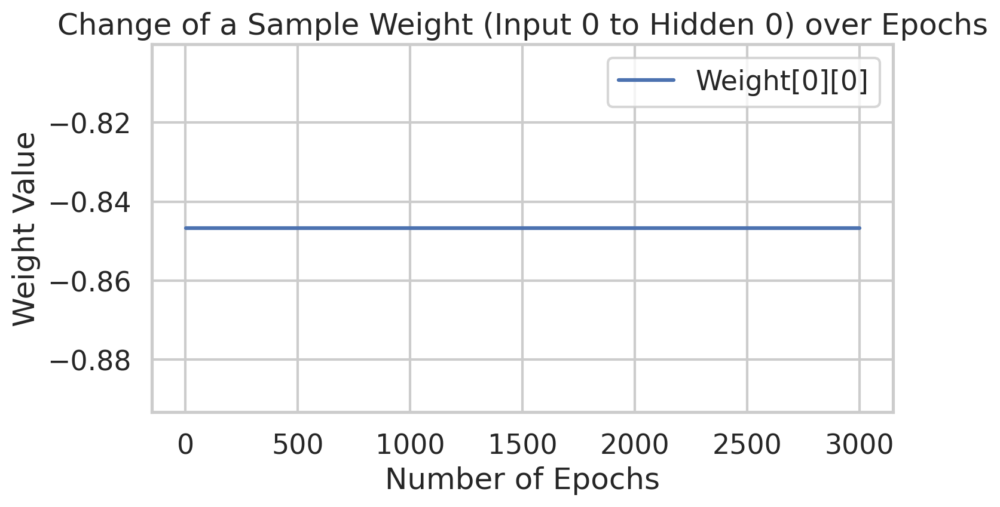

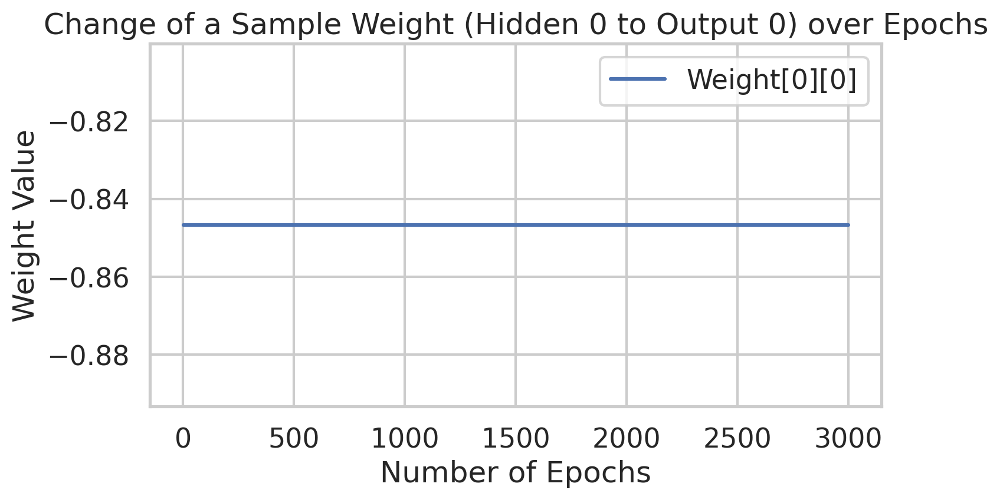

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


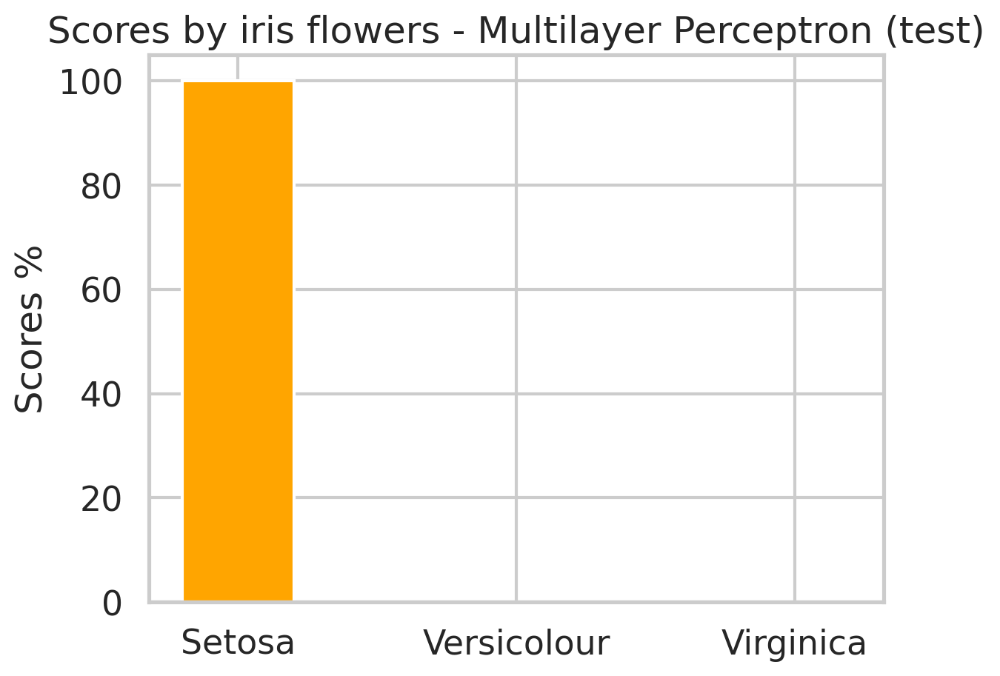

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


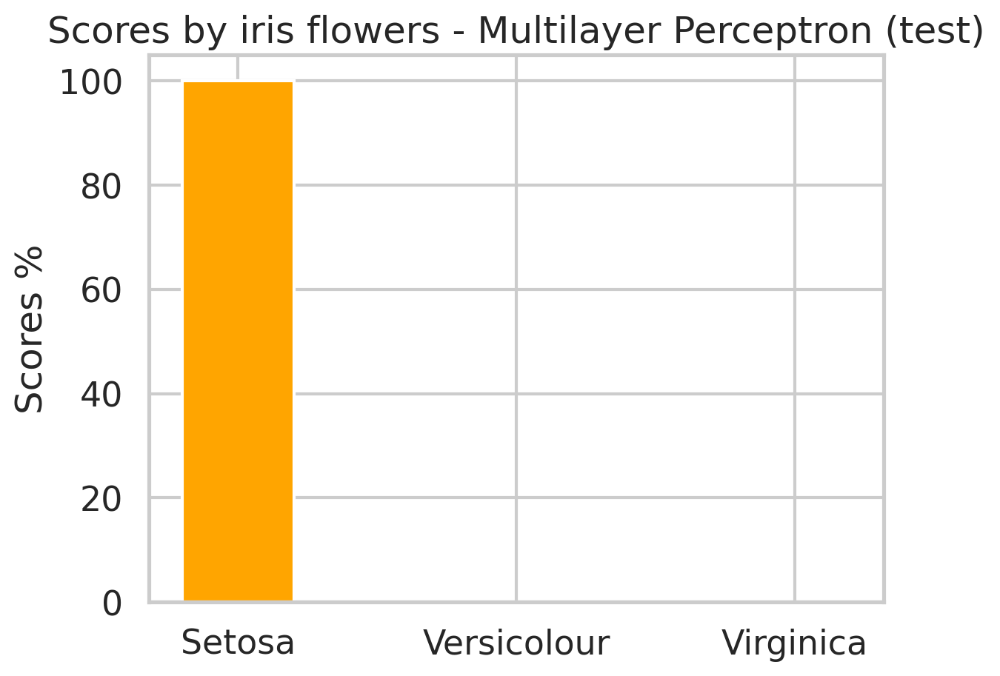

Trying parameters: {'HiddenLayer': 10, 'Epocas': 500, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.1967538337664844
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.04375473536327699
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.02845868115602301
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.023128907056150977
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.01876005056005235
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.013243090588723598
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.009783581081891835
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.008107173453971293
hits test 33.33333333333333
hi

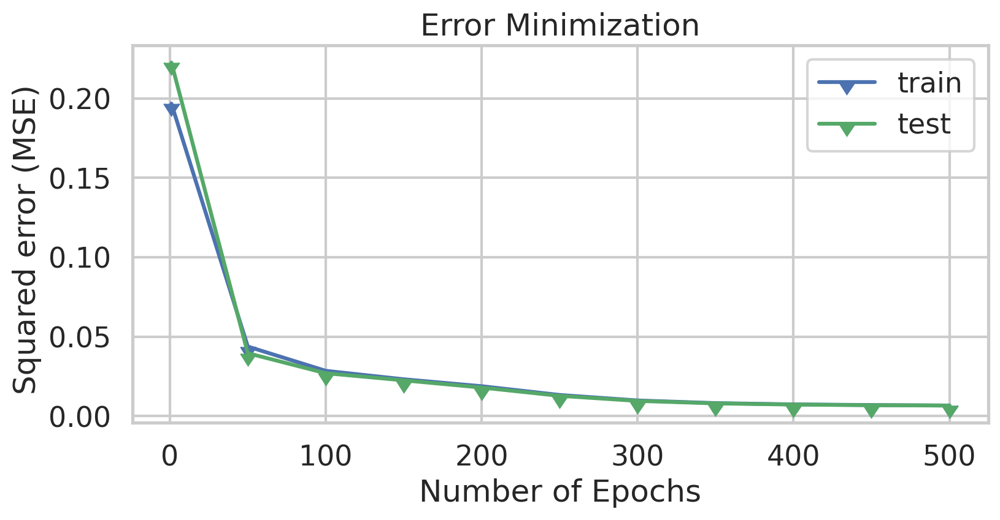

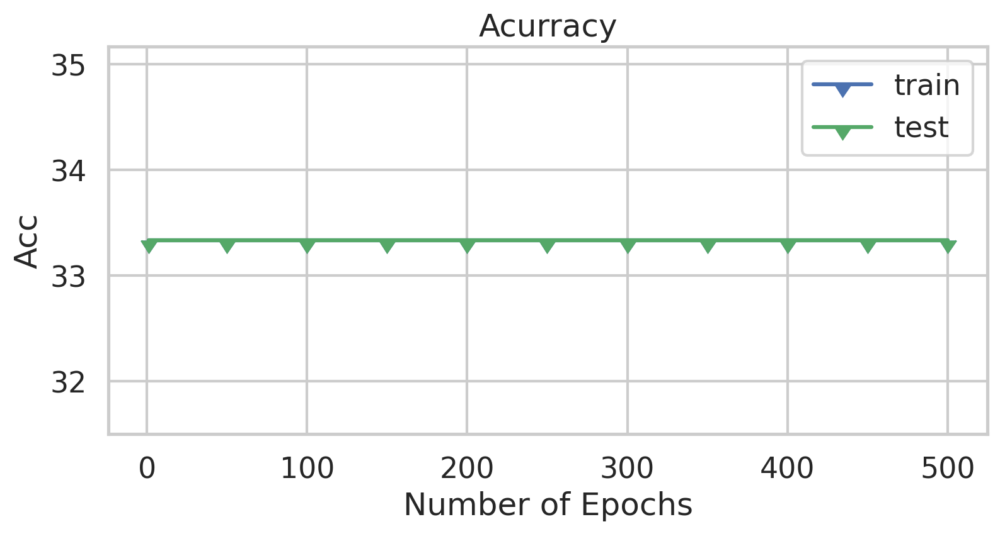

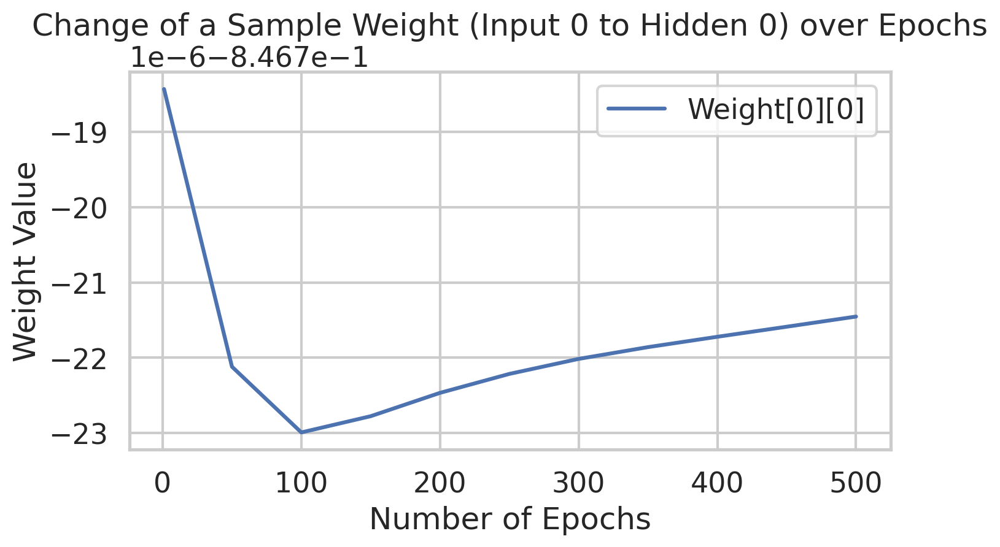

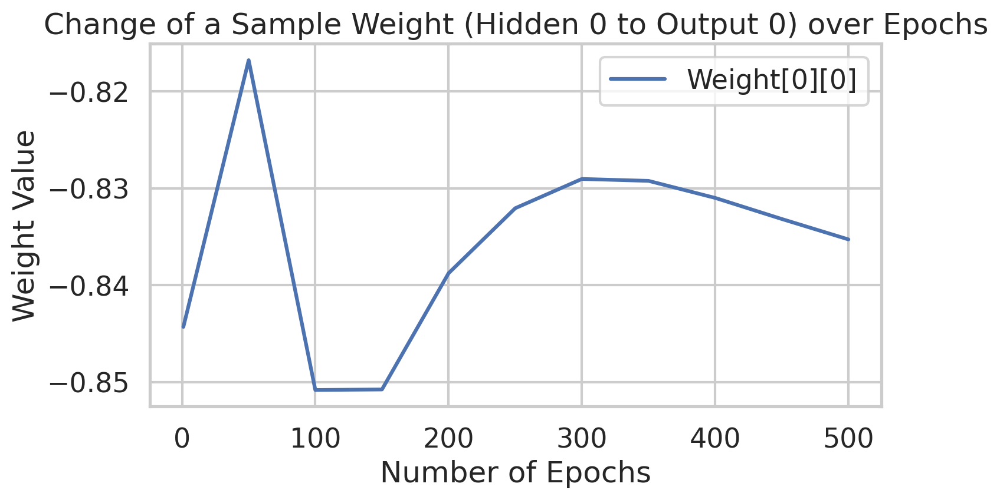

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


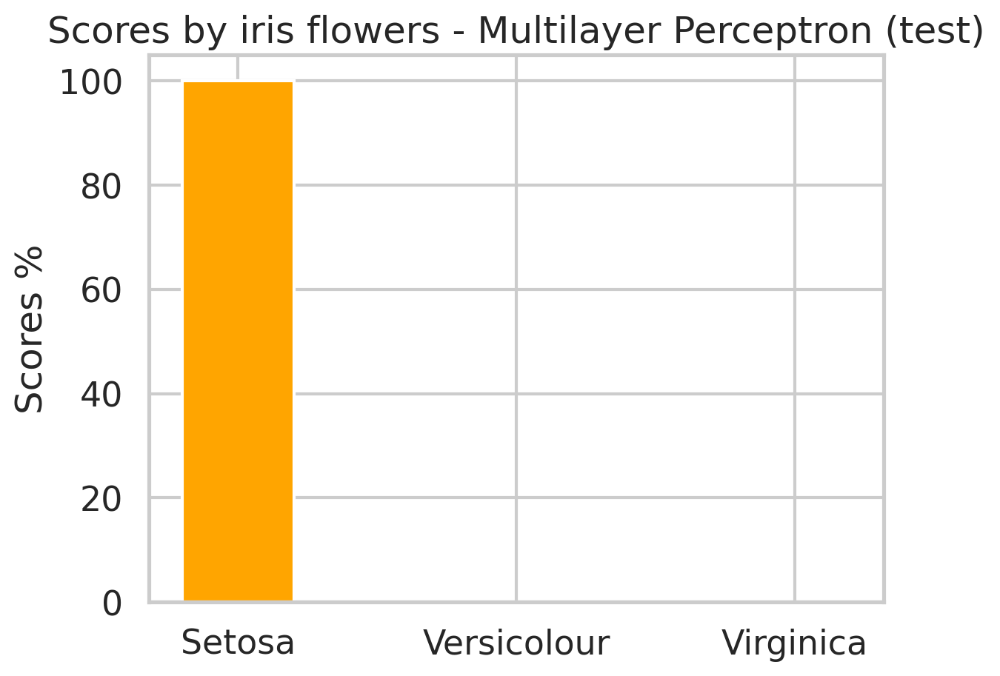

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


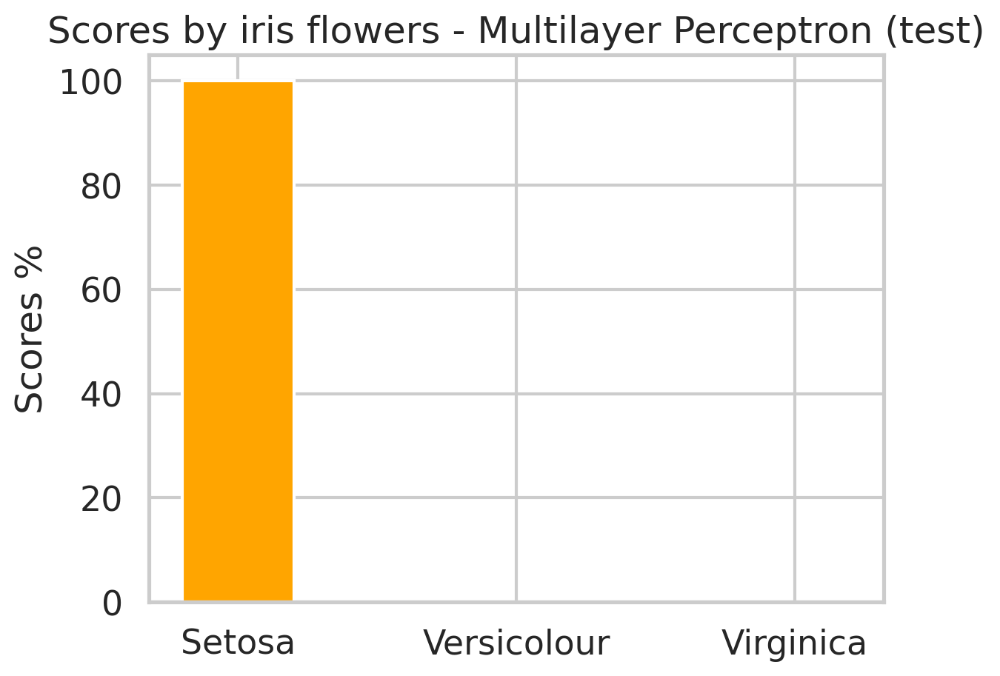

Trying parameters: {'HiddenLayer': 10, 'Epocas': 500, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.08362394702508398
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.06685577801291463
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.062342314044856836
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.05882672469323905
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.055557847016673836
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.052102962355923474
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.0485733148657611
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.04519664948831922
hits test 33.33333333333333


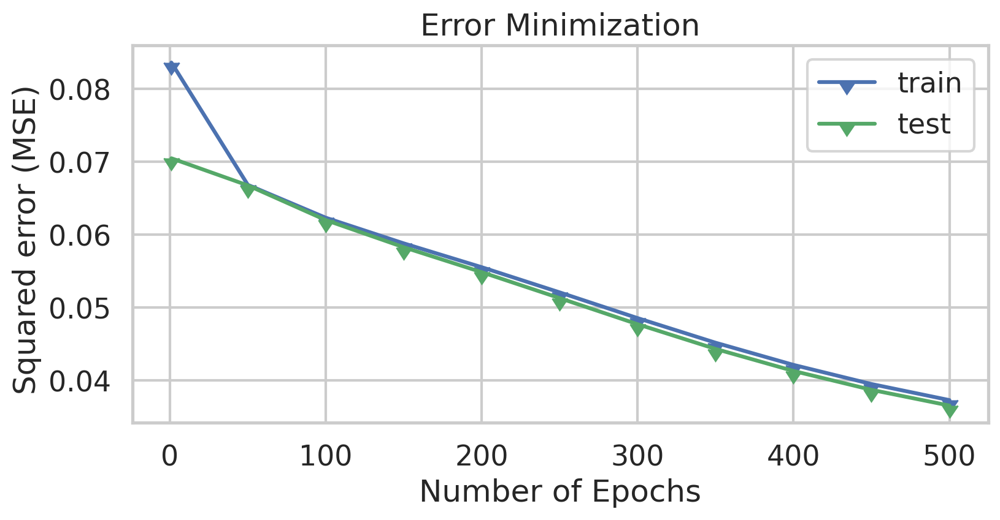

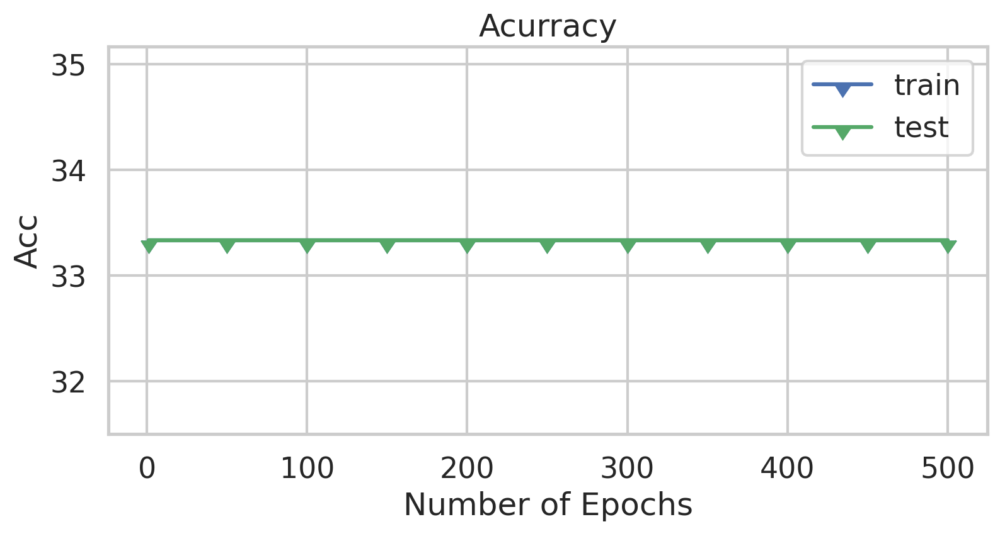

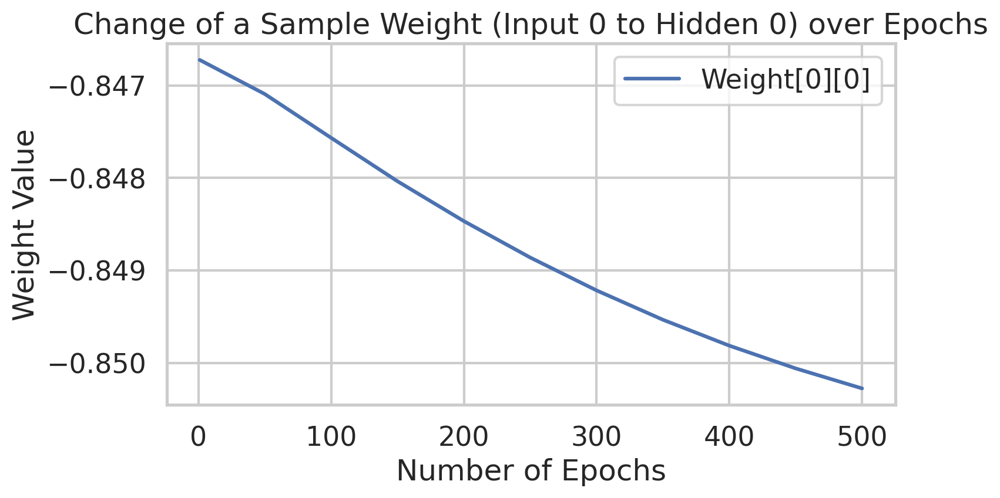

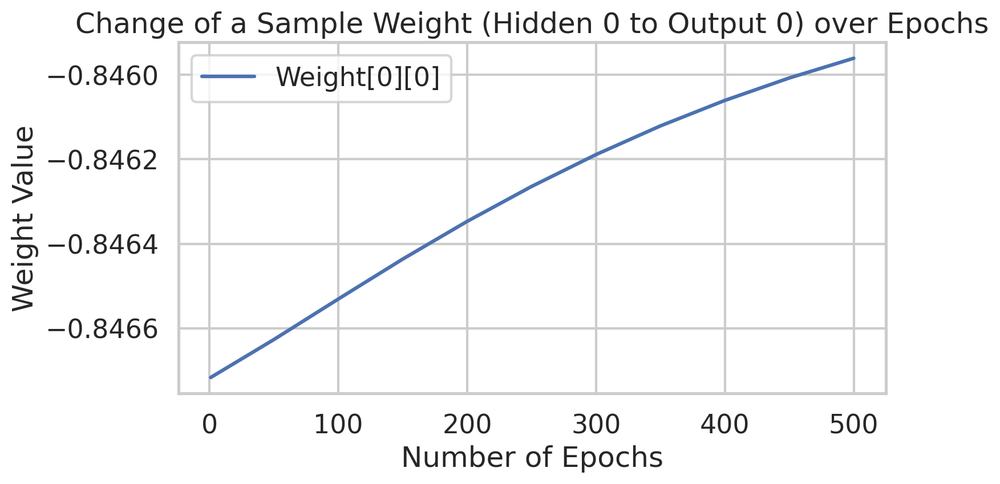

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


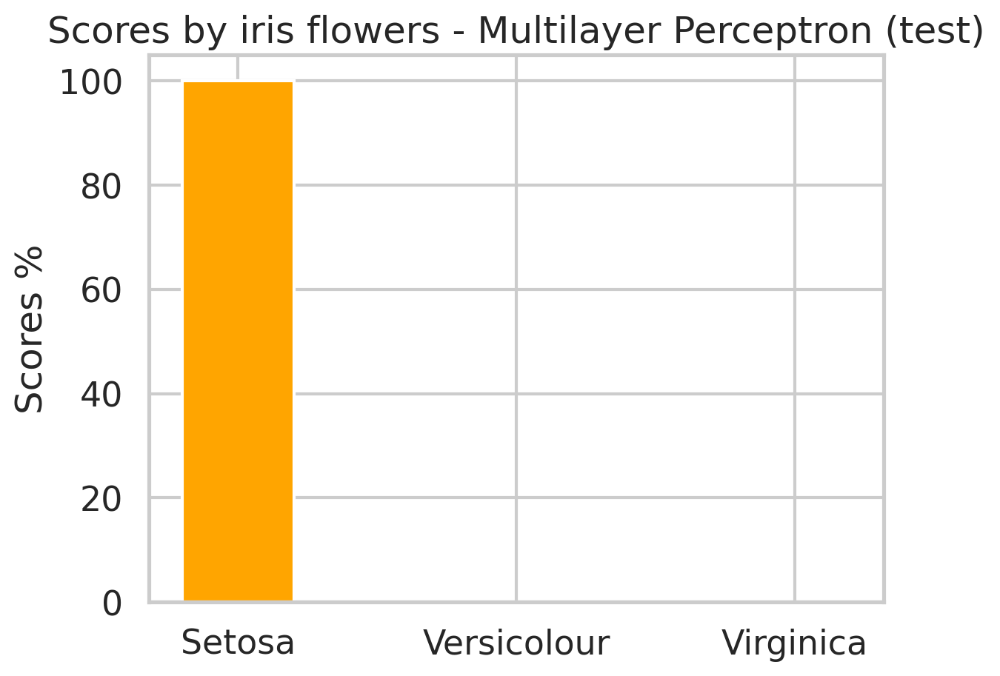

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


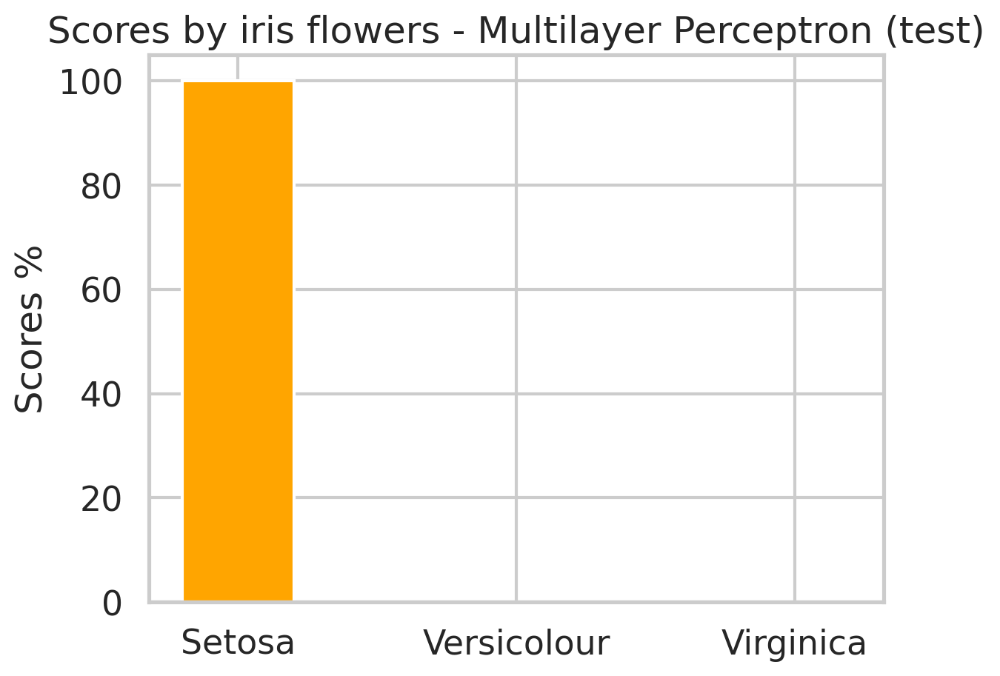

Trying parameters: {'HiddenLayer': 10, 'Epocas': 500, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits 

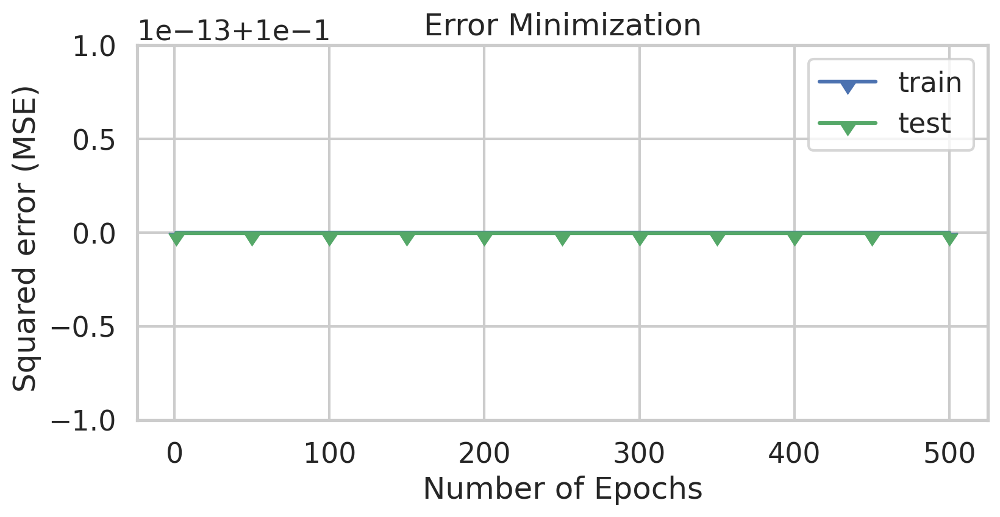

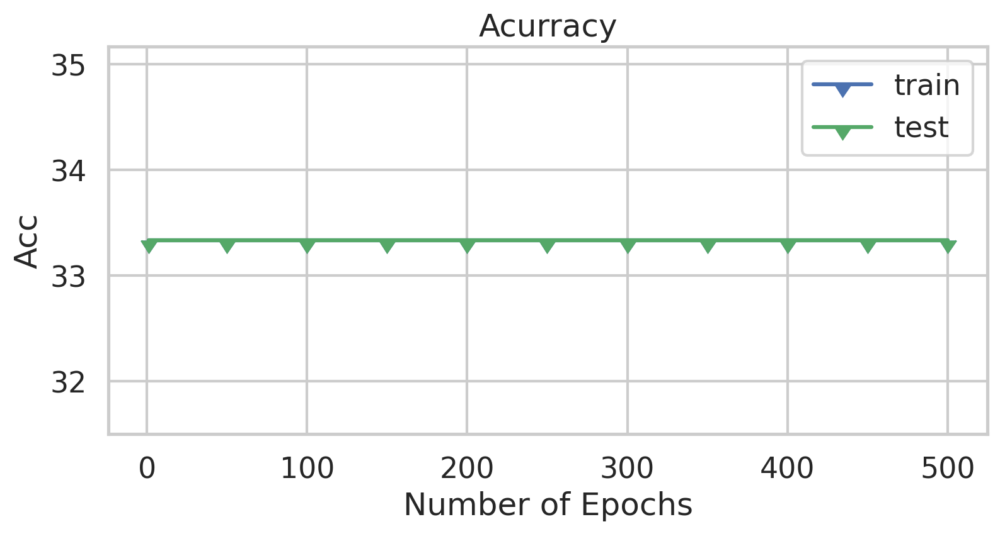

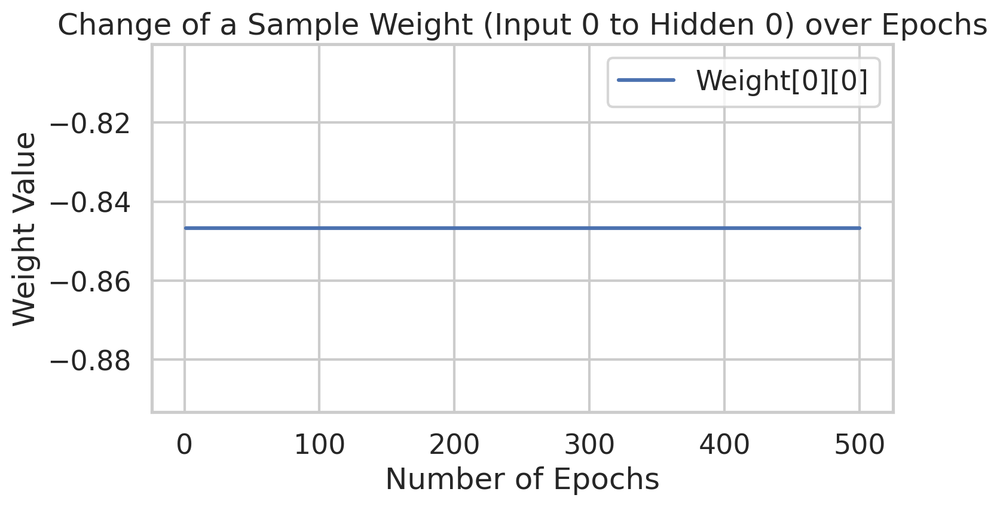

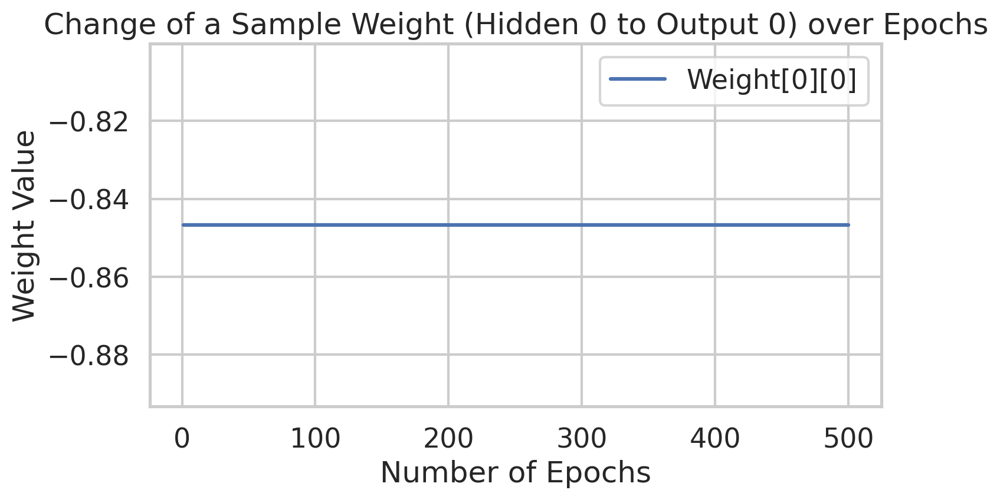

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


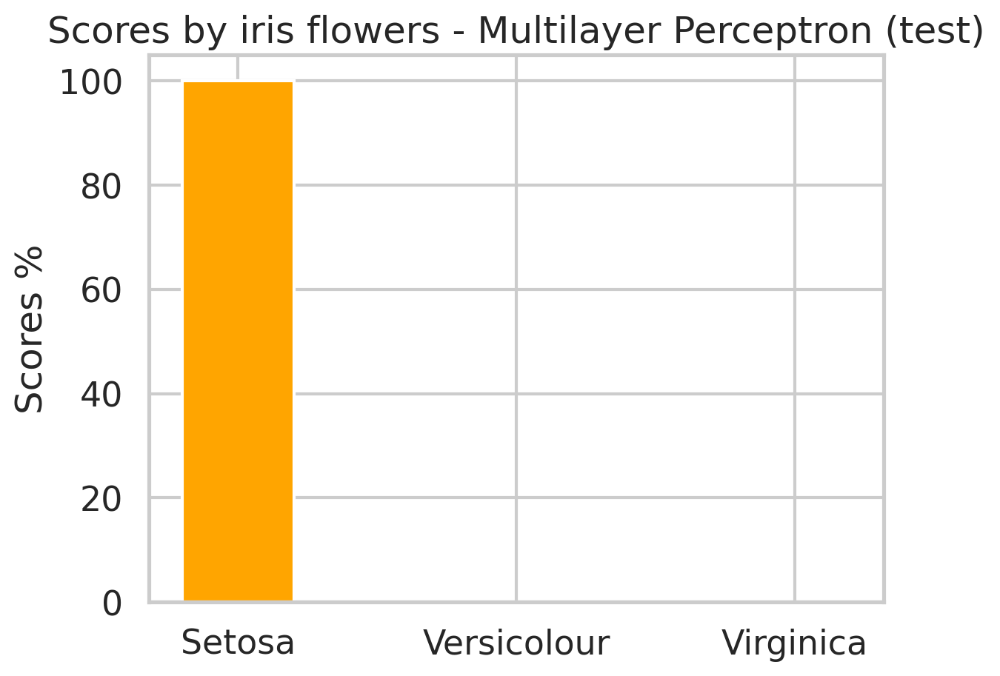

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


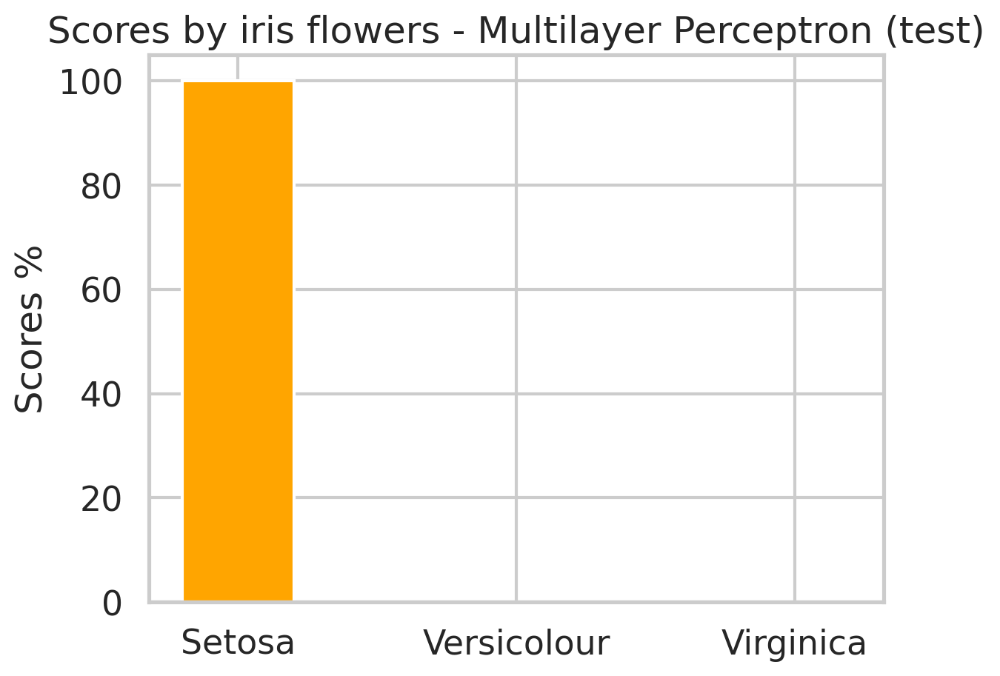

Trying parameters: {'HiddenLayer': 10, 'Epocas': 500, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.21314098548911667
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.07184202913179577
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06905624238753305
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.06823179313143446
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.06760453264343977
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.06687266587456529
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.06568984089323245
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.06297400548805994
hits test 33.33333333333333
hits

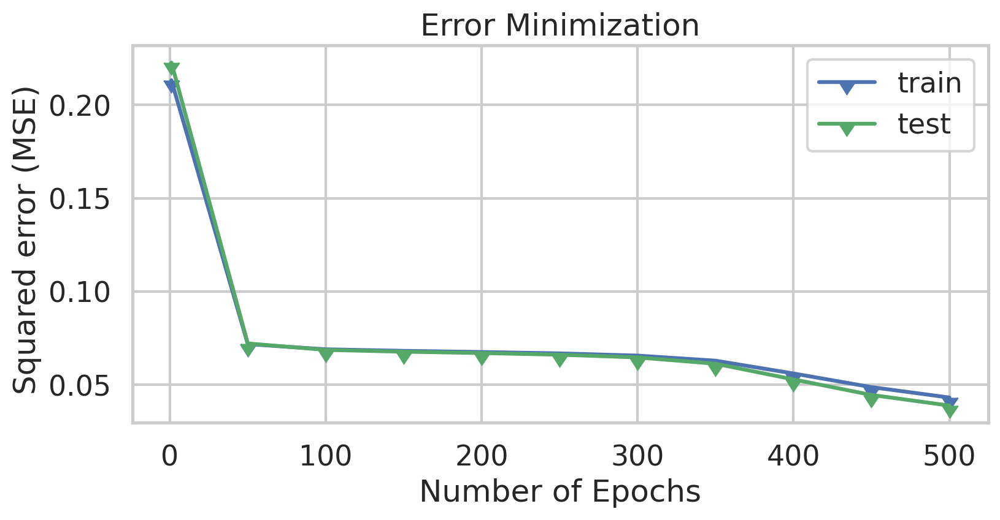

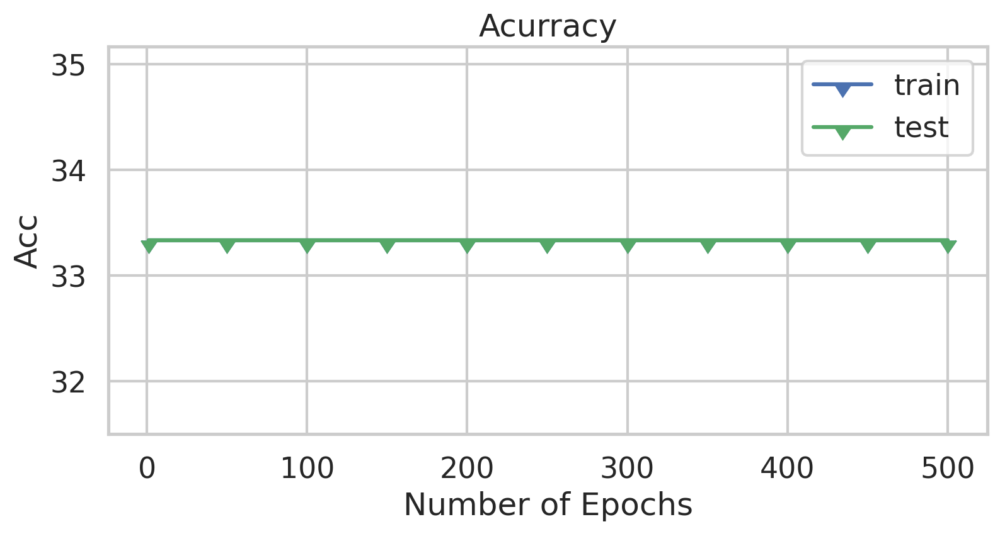

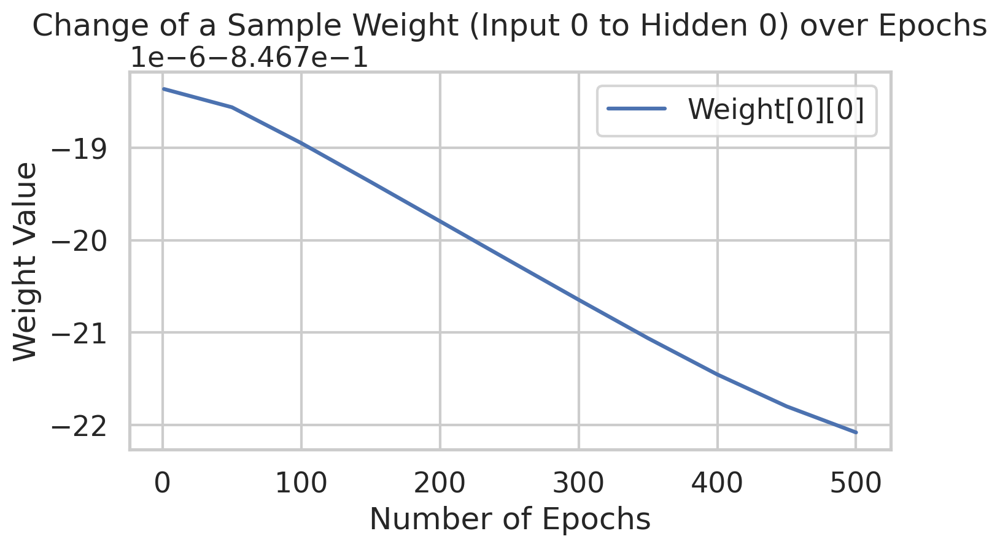

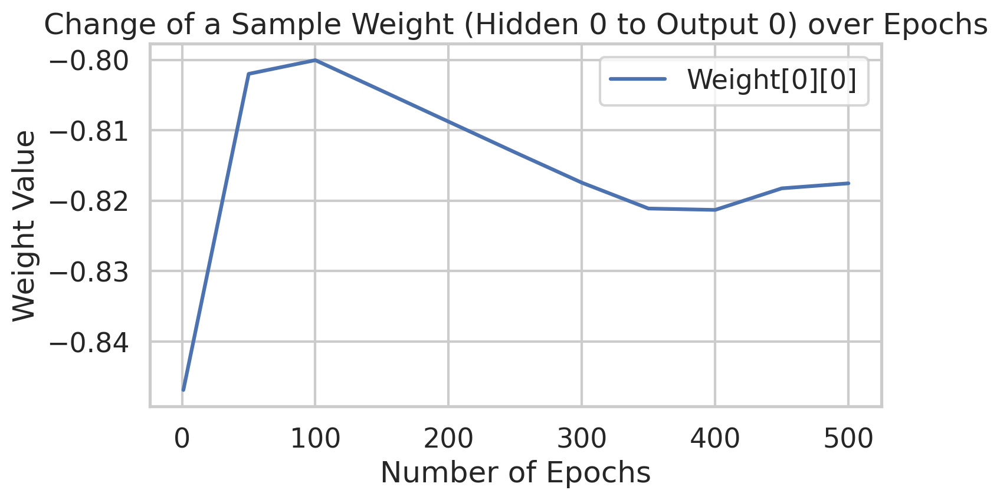

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


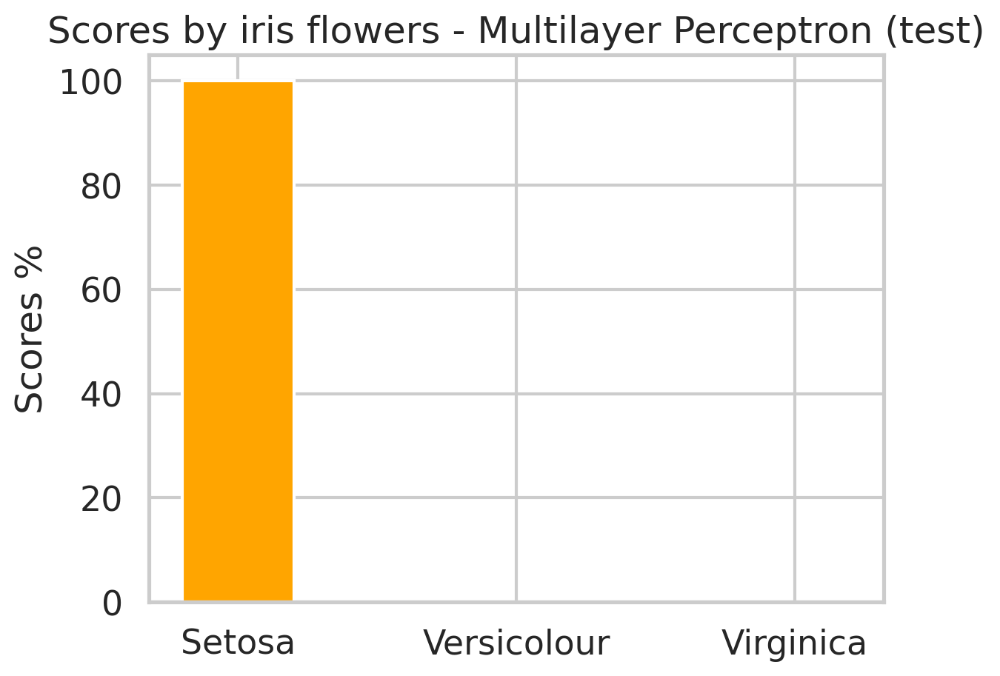

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


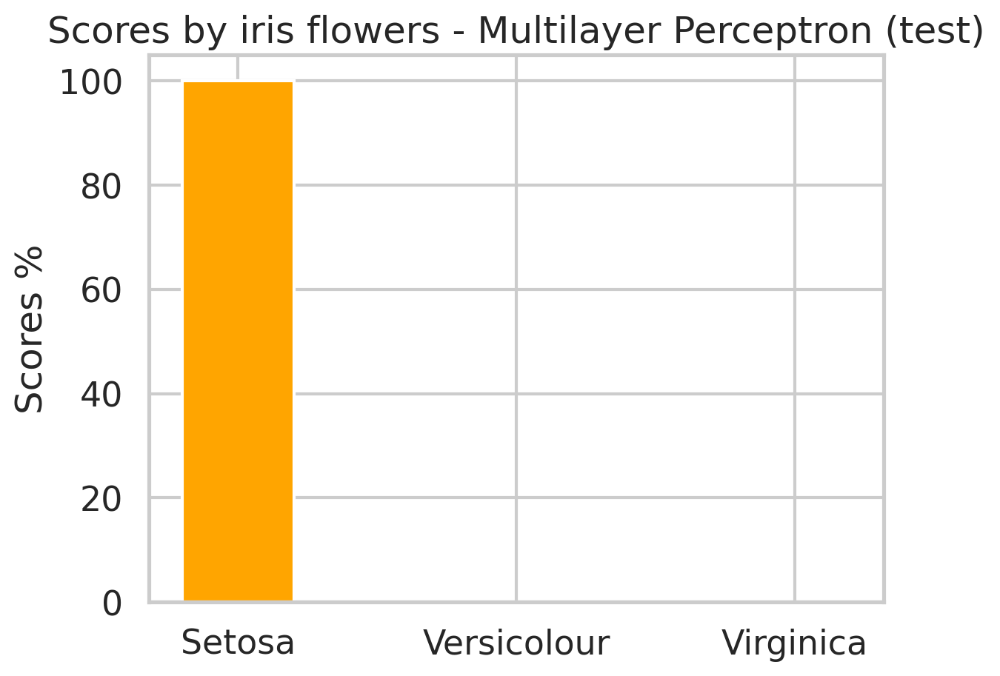

Trying parameters: {'HiddenLayer': 10, 'Epocas': 500, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.08418886718808734
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.07871984055073532
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.07473463638565922
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.07217812304845815
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.07052373269104573
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.06941185582048726
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.06862584167580736
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.06803790402036339
hits test 33.33333333333333
h

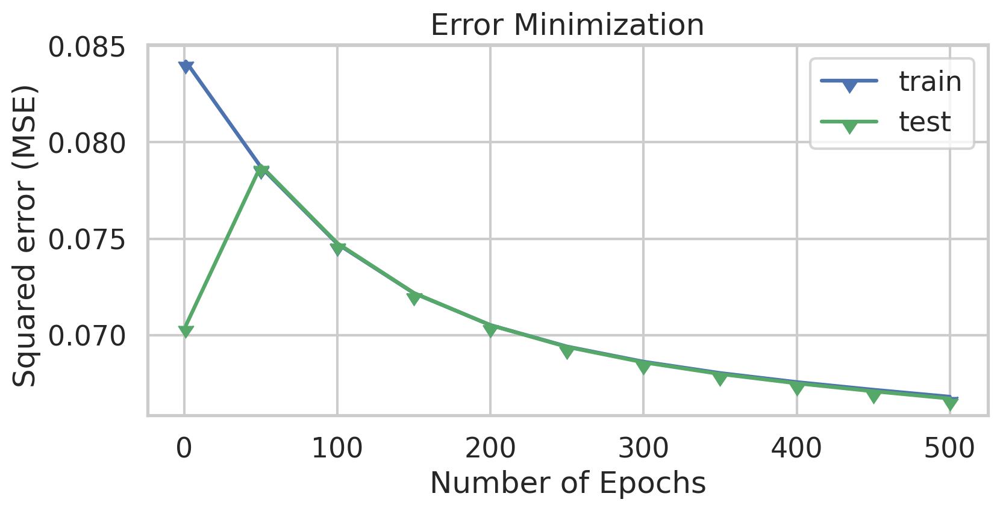

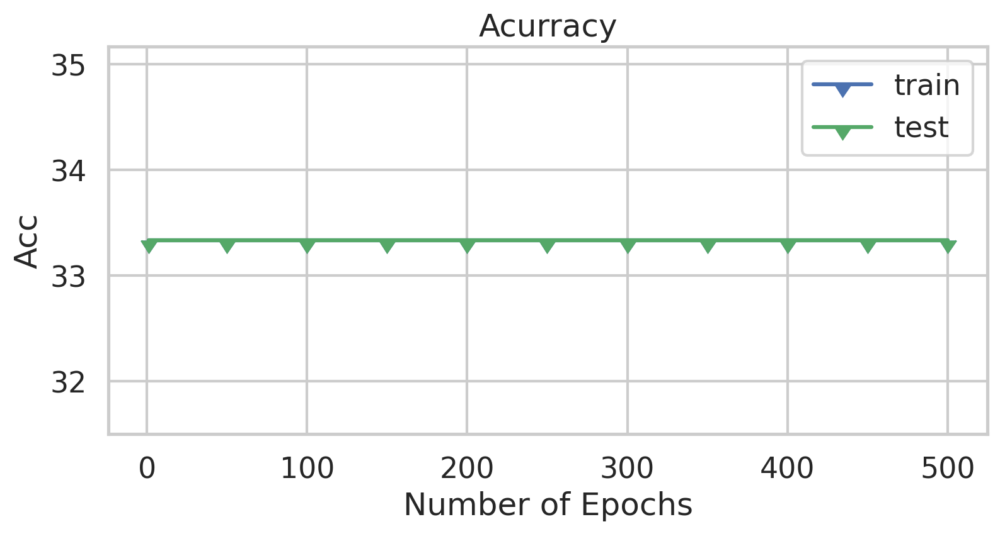

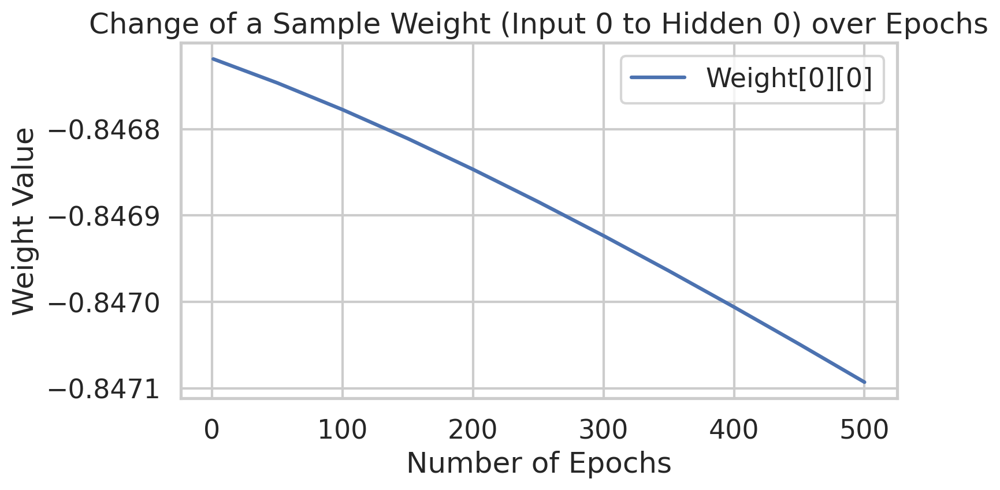

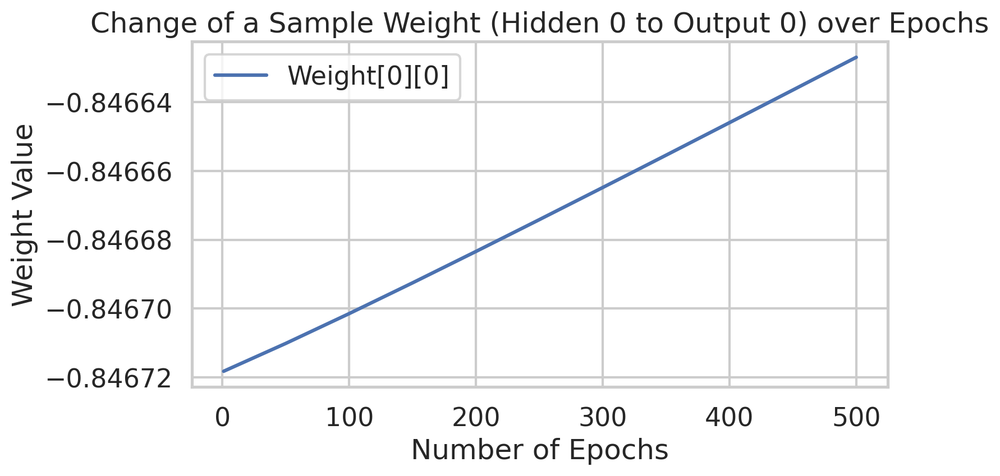

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


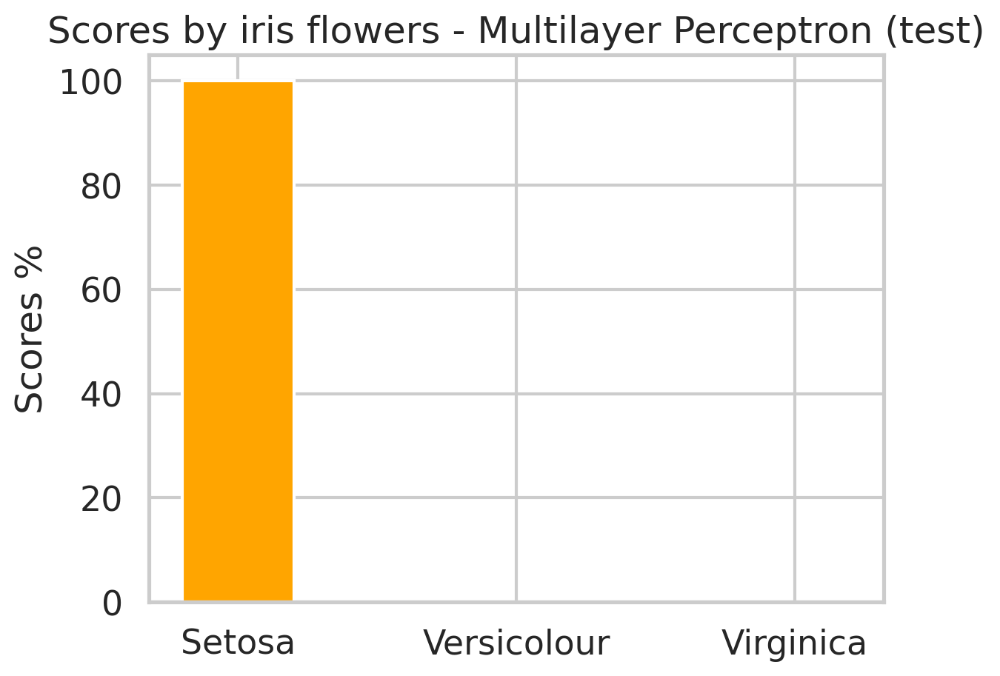

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


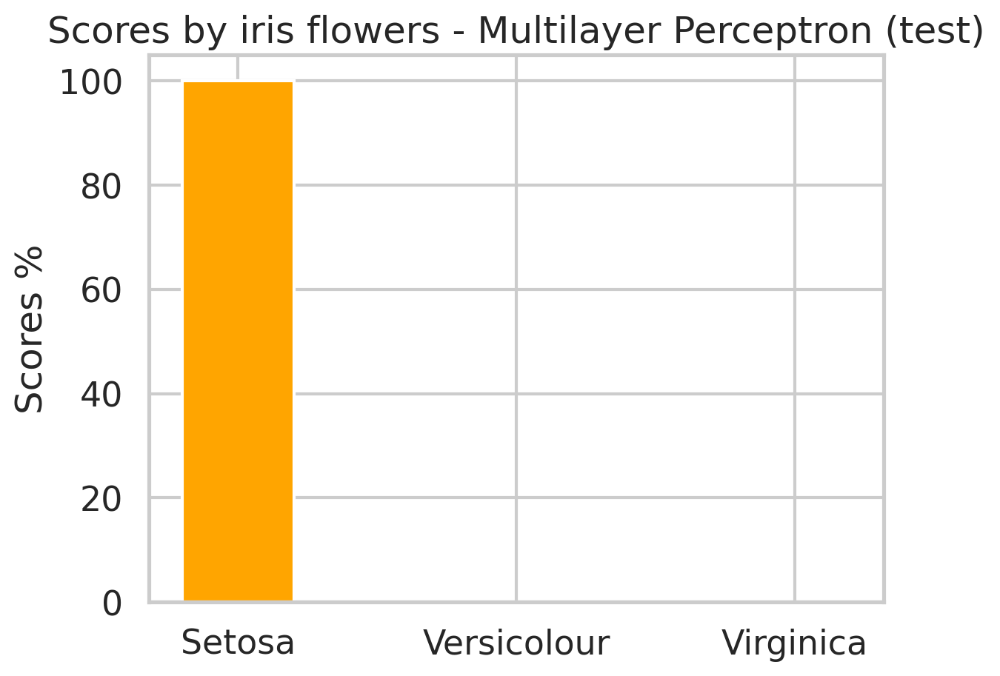

Trying parameters: {'HiddenLayer': 10, 'Epocas': 500, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits

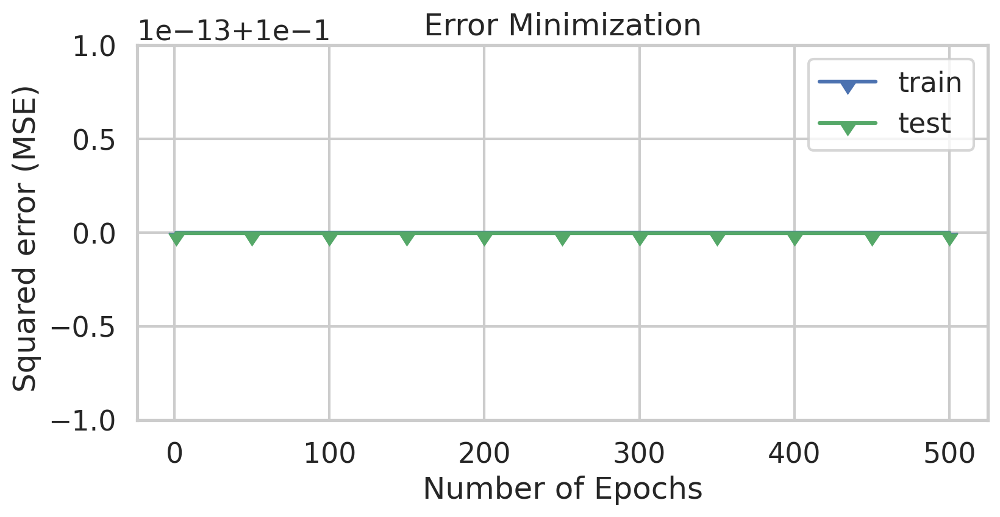

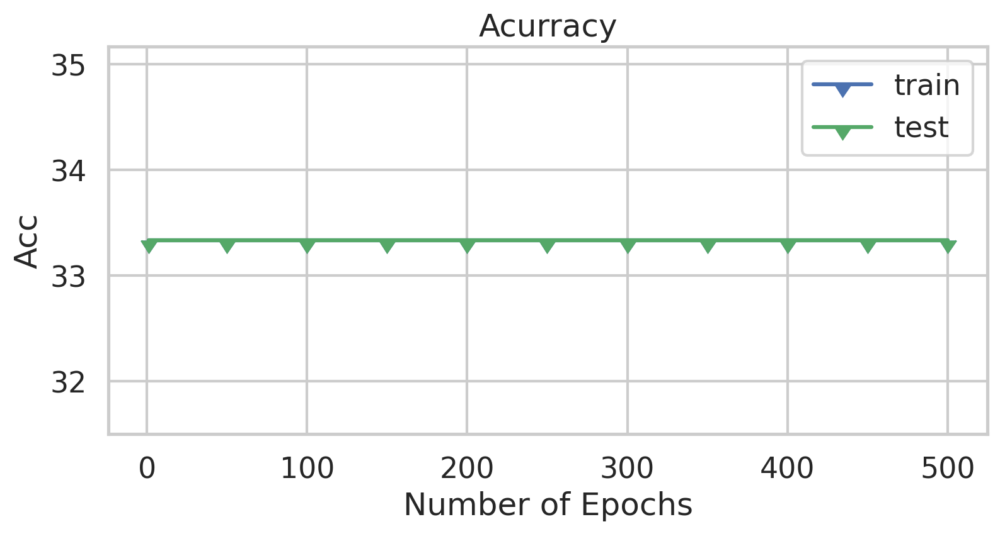

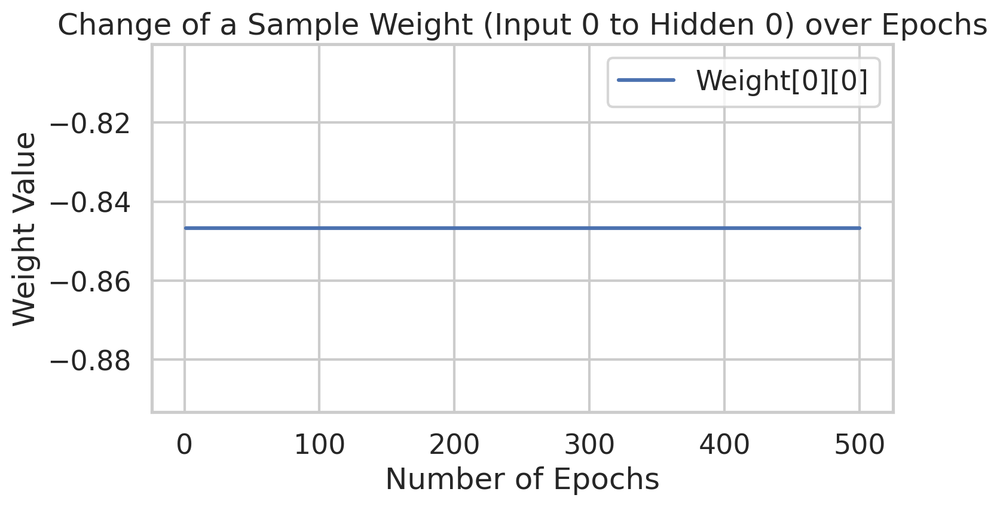

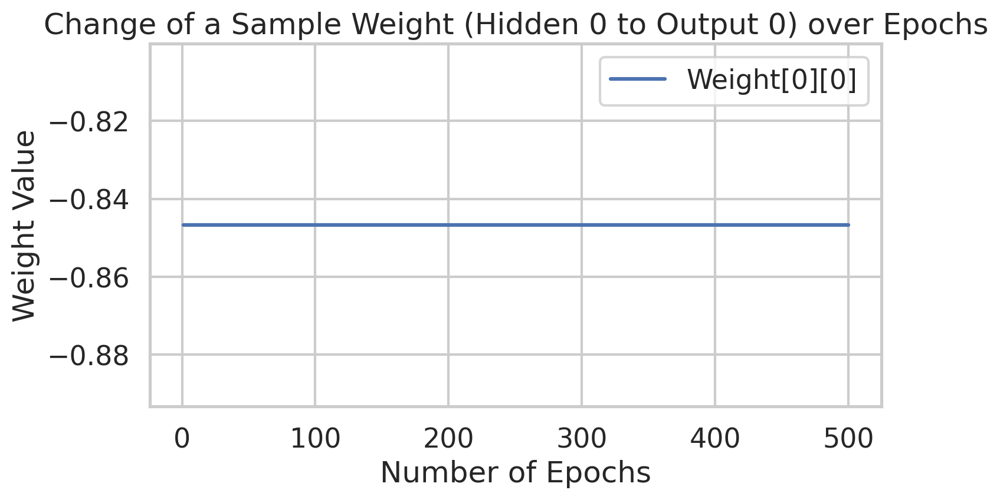

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


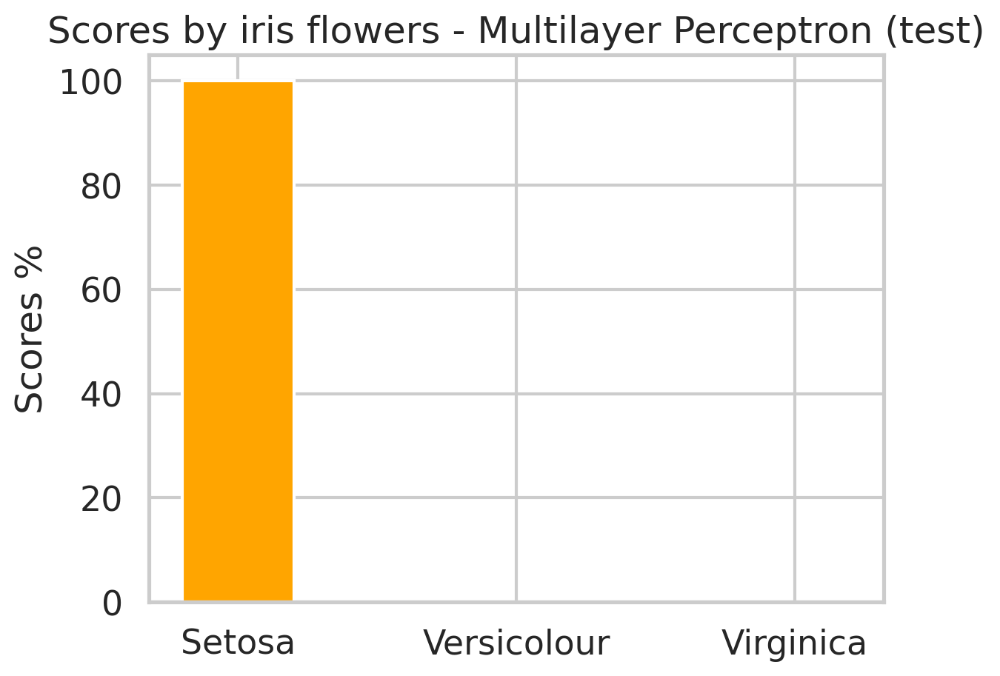

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


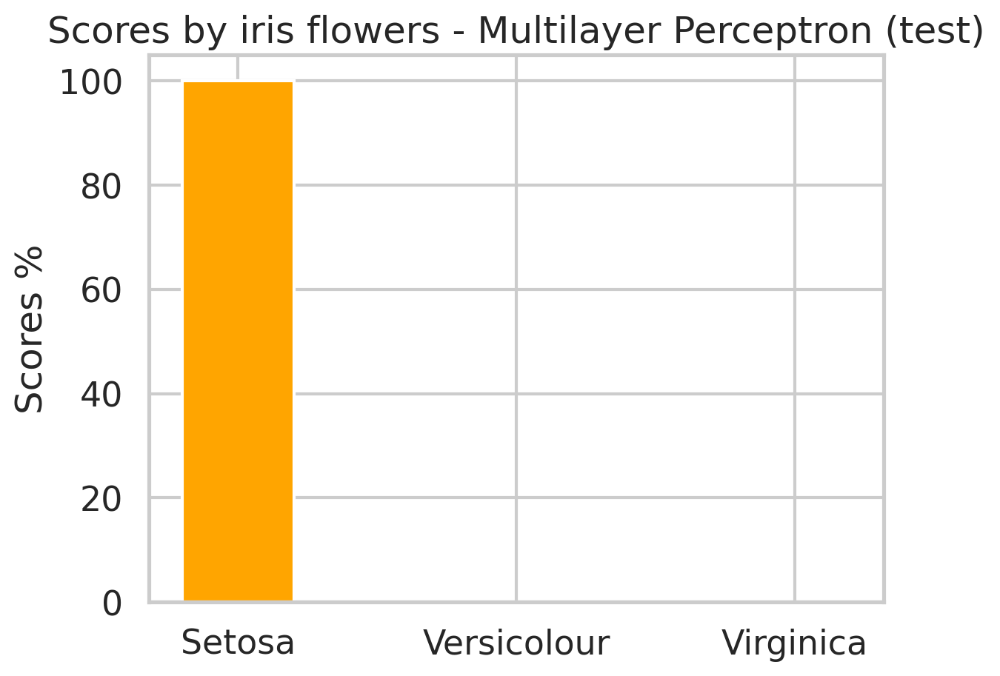

Trying parameters: {'HiddenLayer': 10, 'Epocas': 1000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.1967538337664844
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.04375473536327699
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.02845868115602301
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.023128907056150977
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.01876005056005235
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.013243090588723598
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.009783581081891835
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.008107173453971293
hits test 33.33333333333333
h

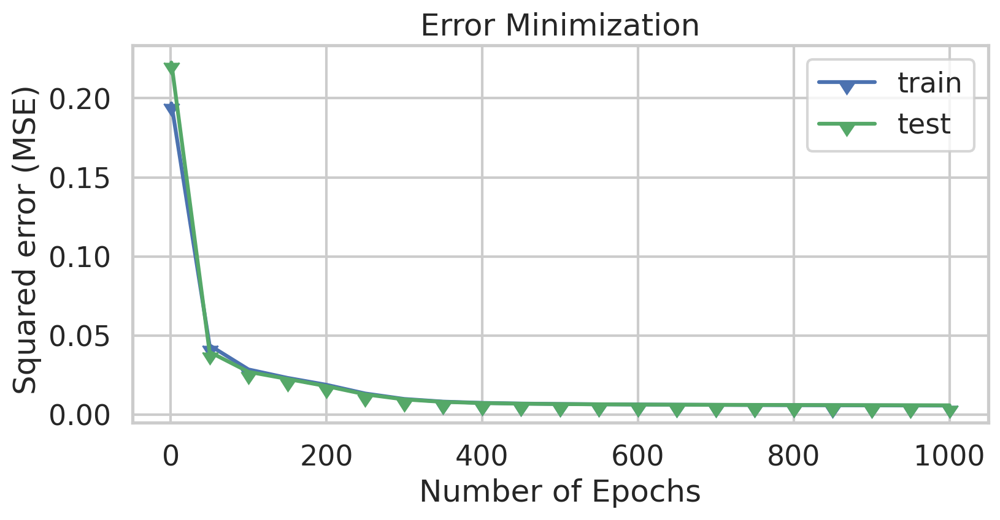

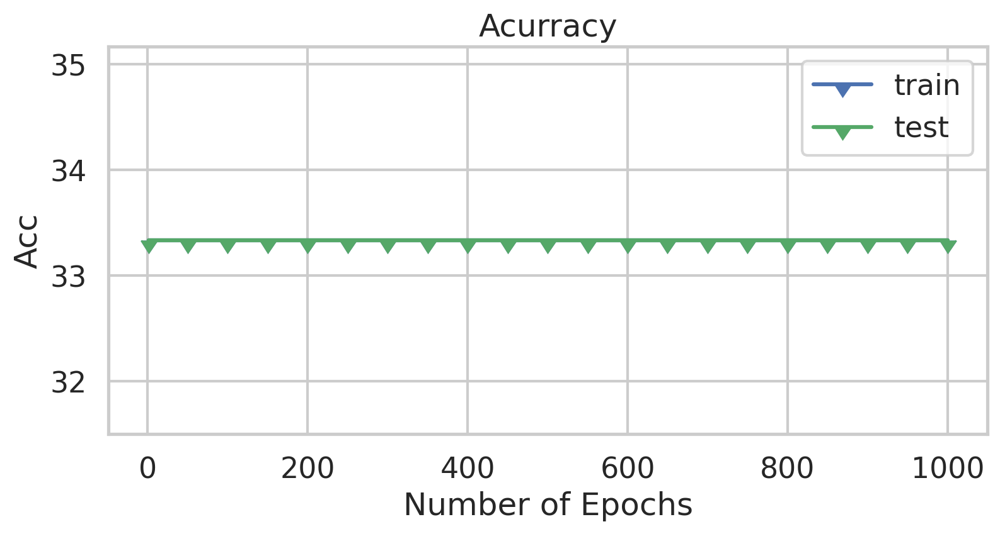

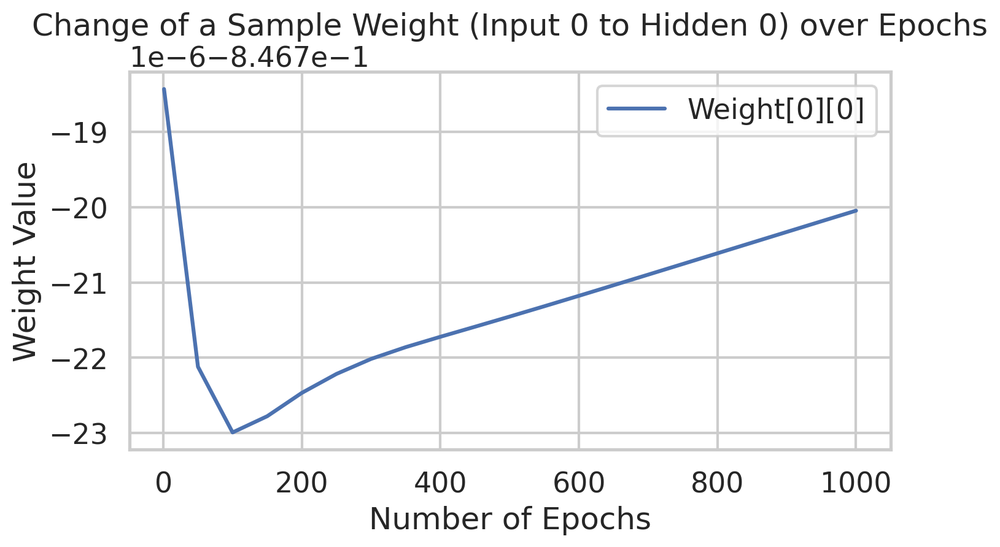

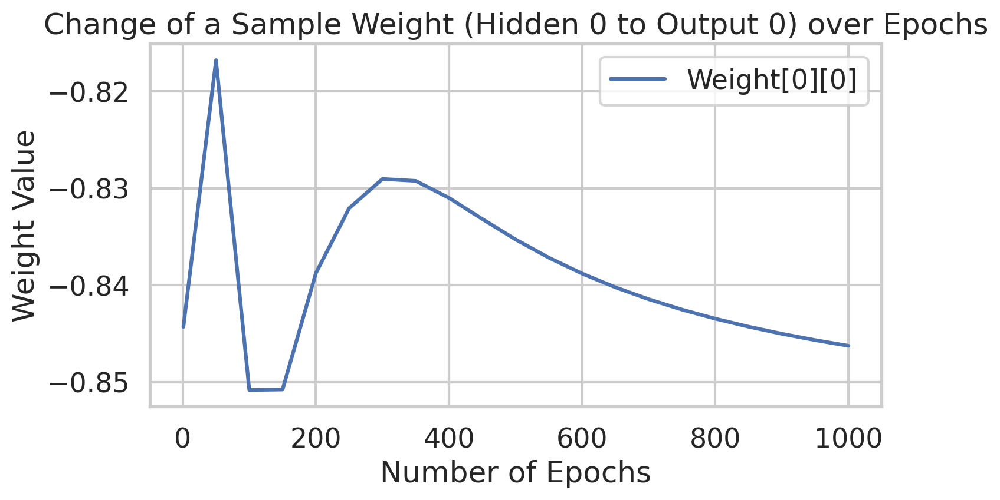

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


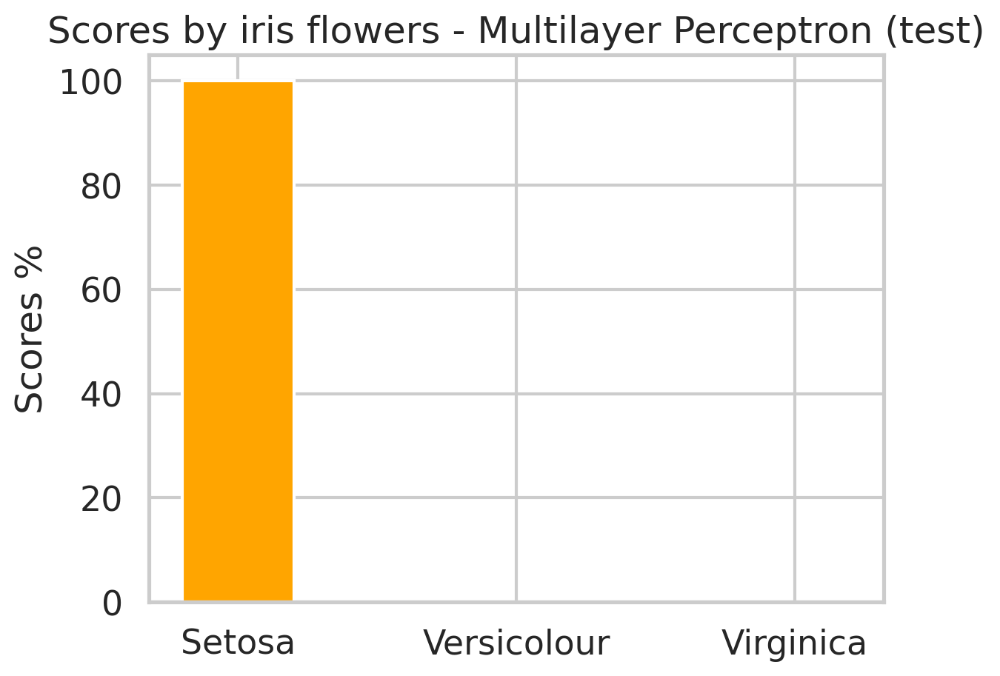

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


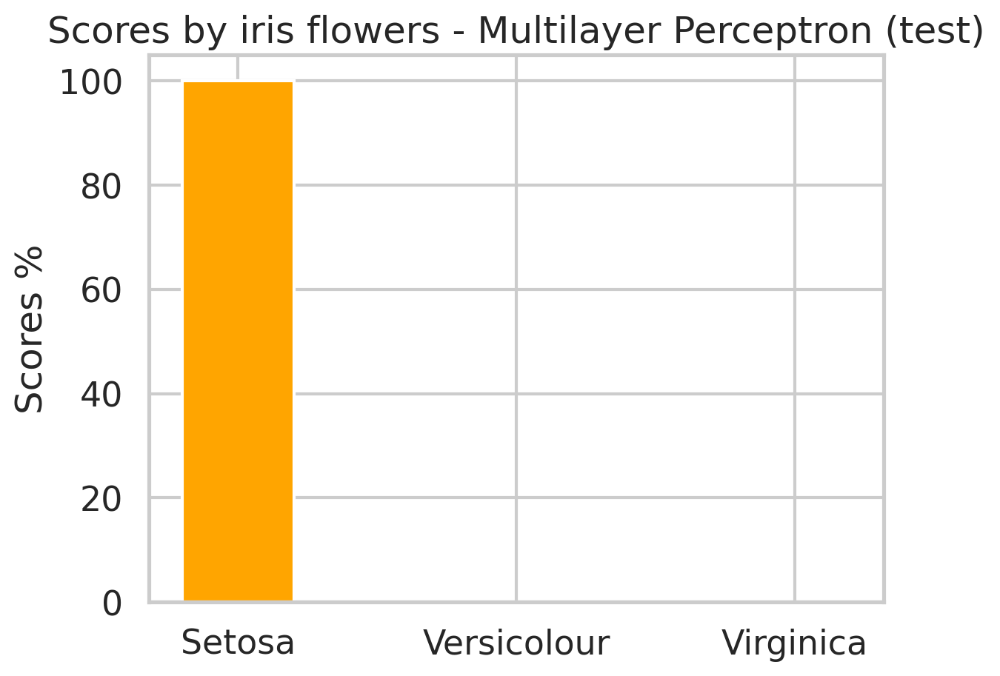

Trying parameters: {'HiddenLayer': 10, 'Epocas': 1000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.08362394702508398
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.06685577801291463
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.062342314044856836
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.05882672469323905
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.055557847016673836
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.052102962355923474
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.0485733148657611
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.04519664948831922
hits test 33.33333333333333

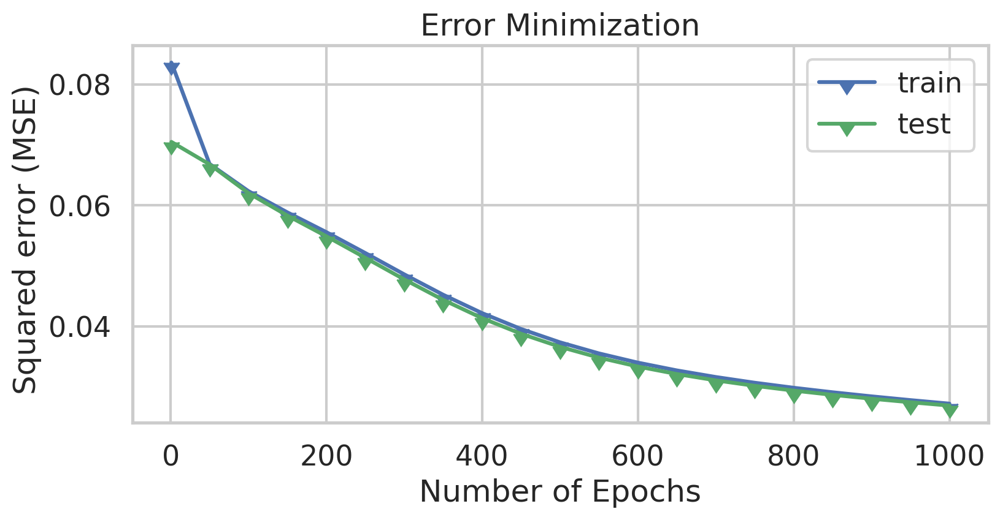

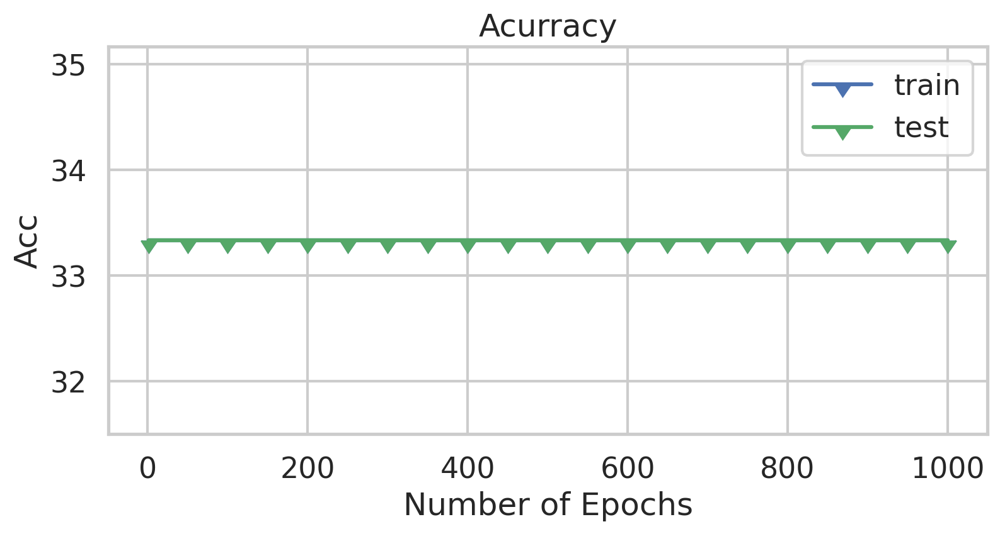

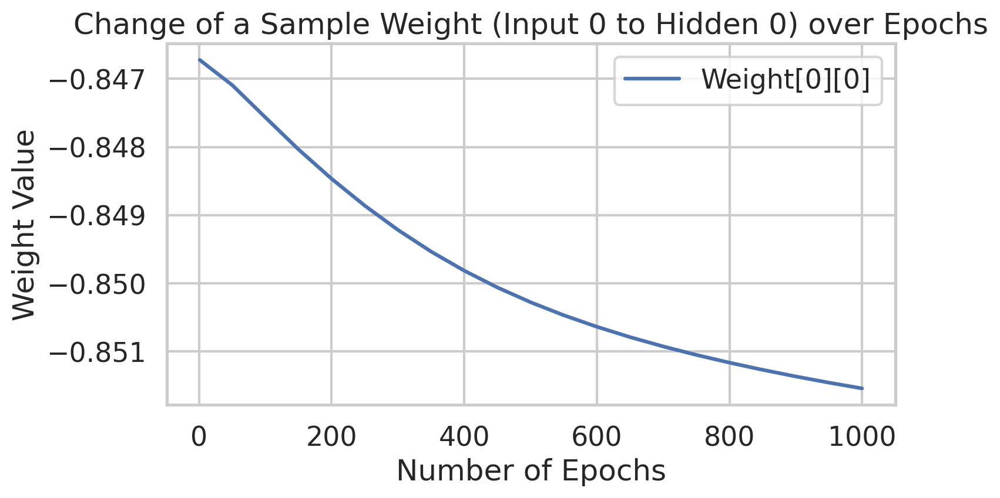

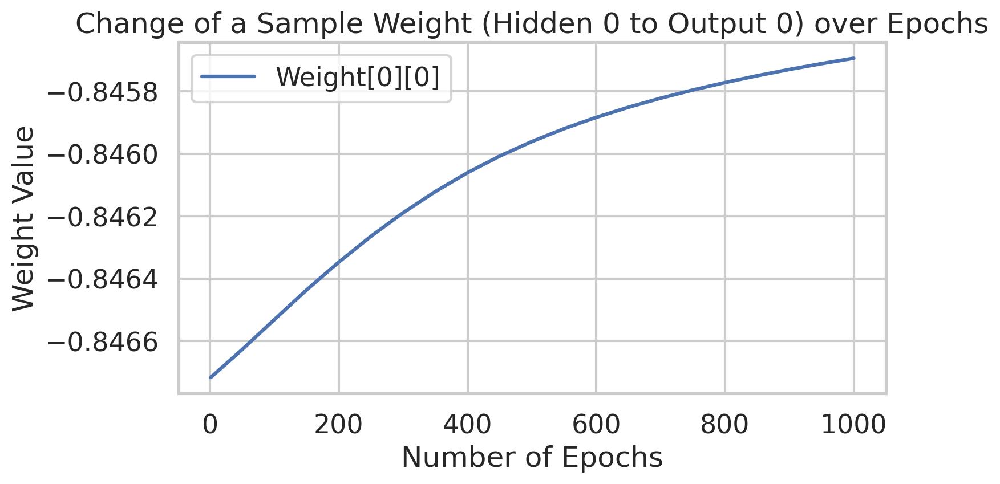

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


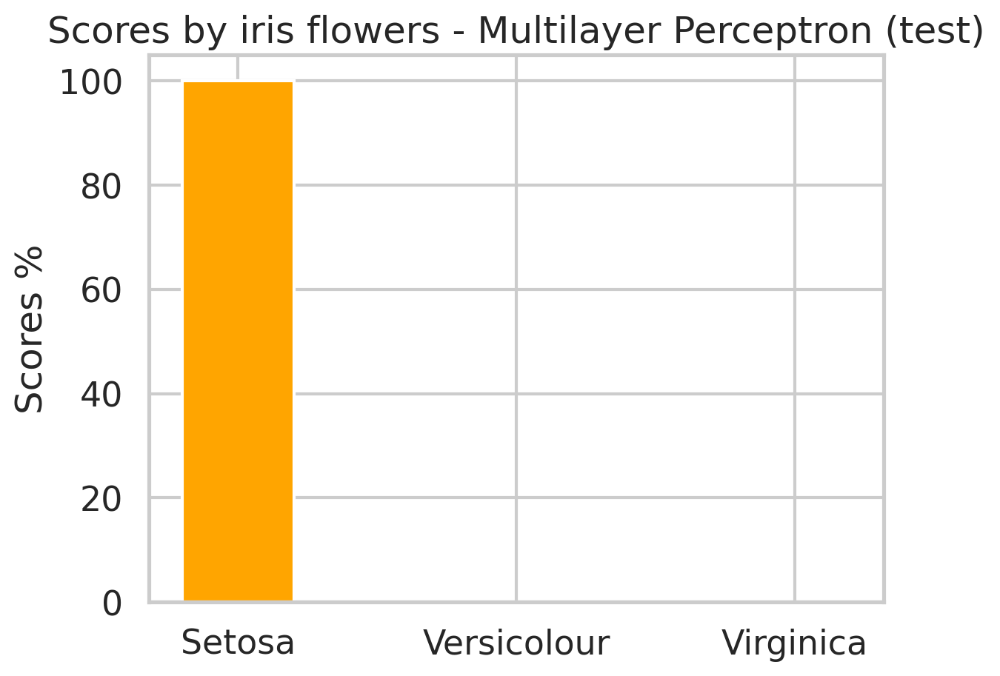

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


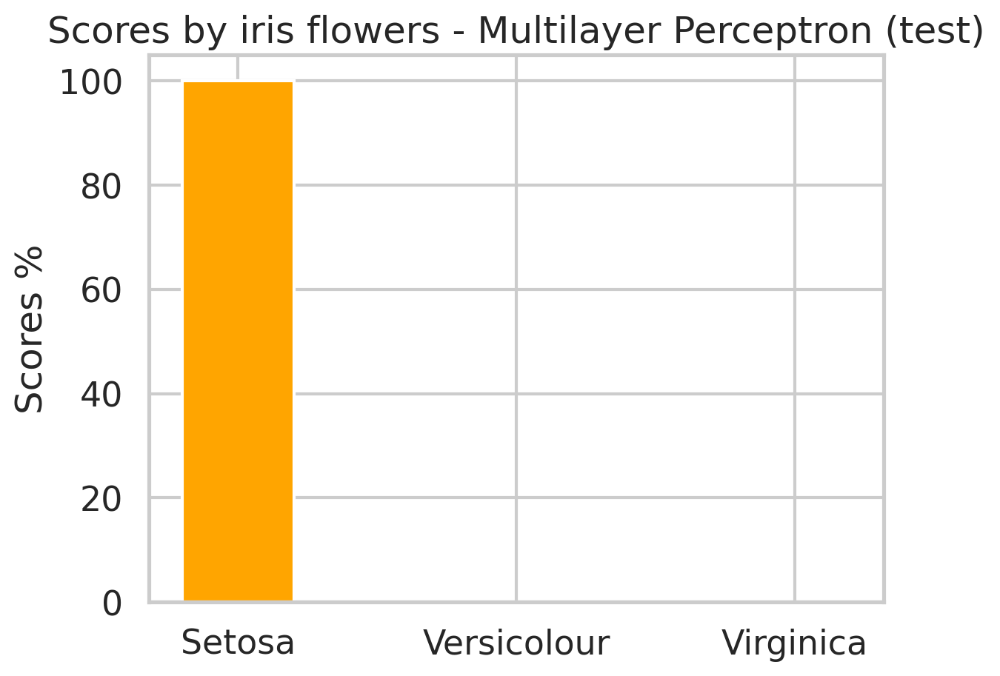

Trying parameters: {'HiddenLayer': 10, 'Epocas': 1000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits

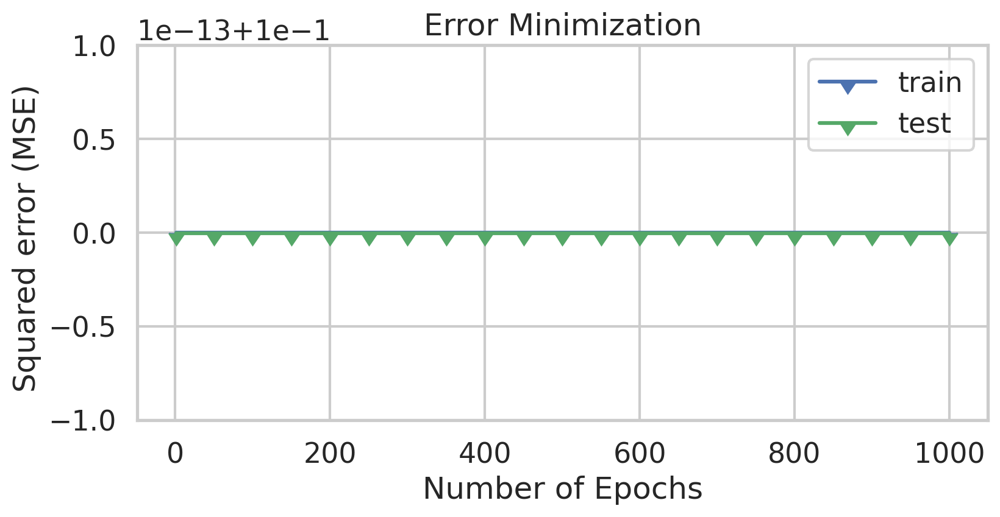

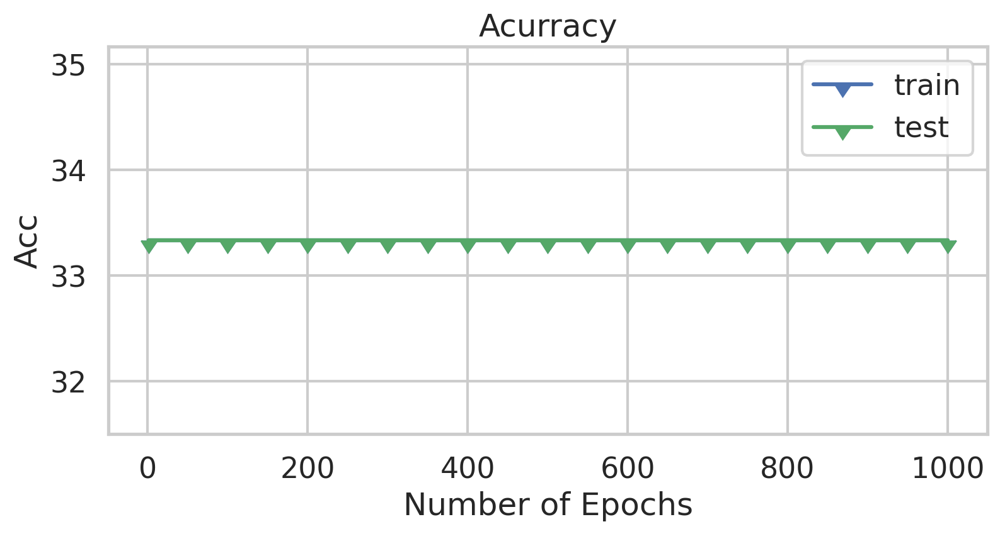

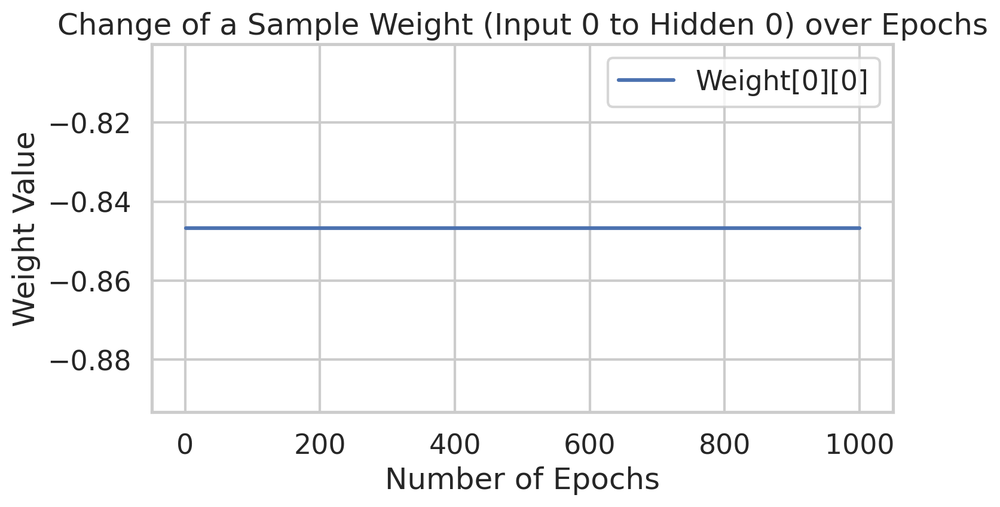

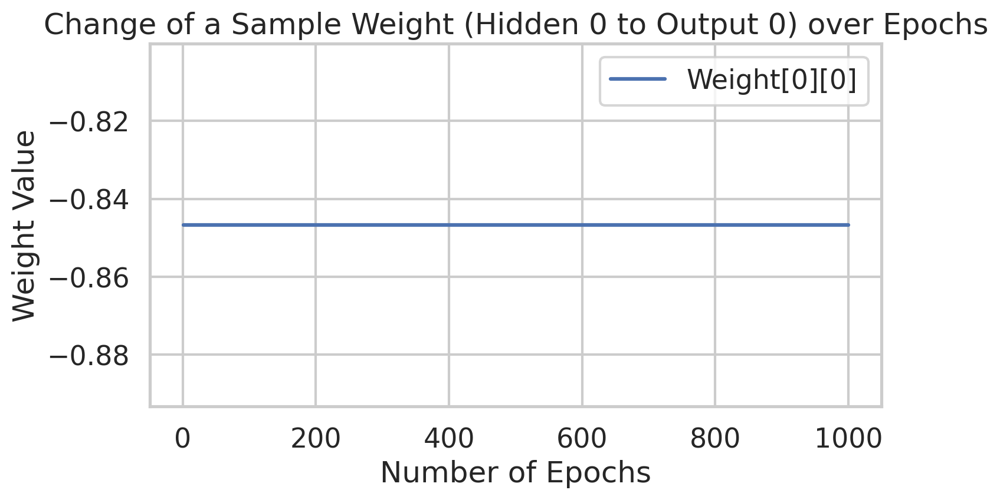

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


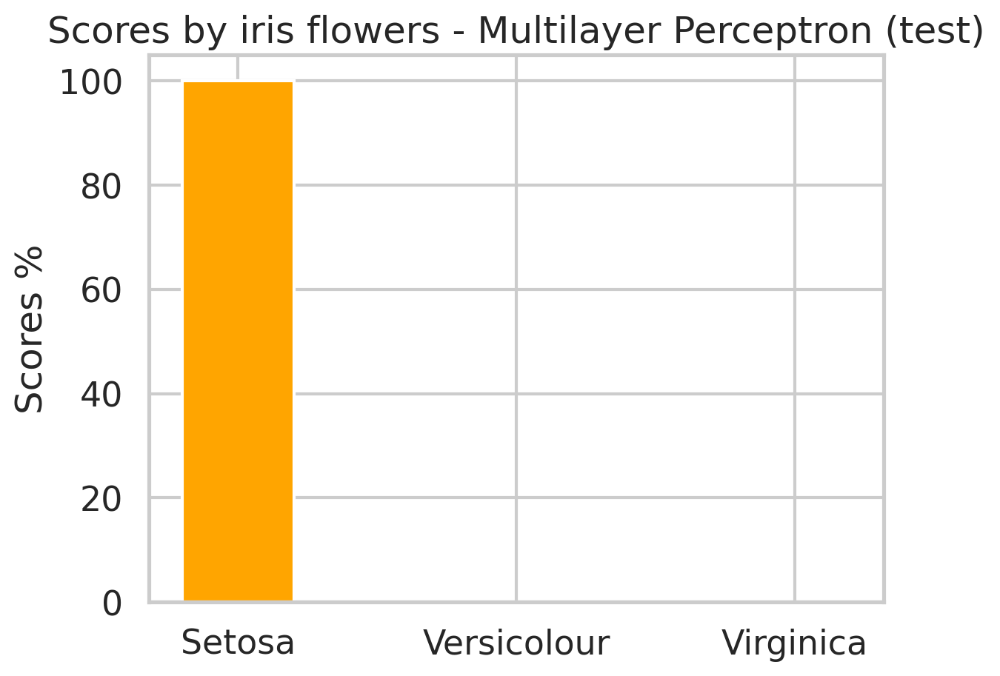

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


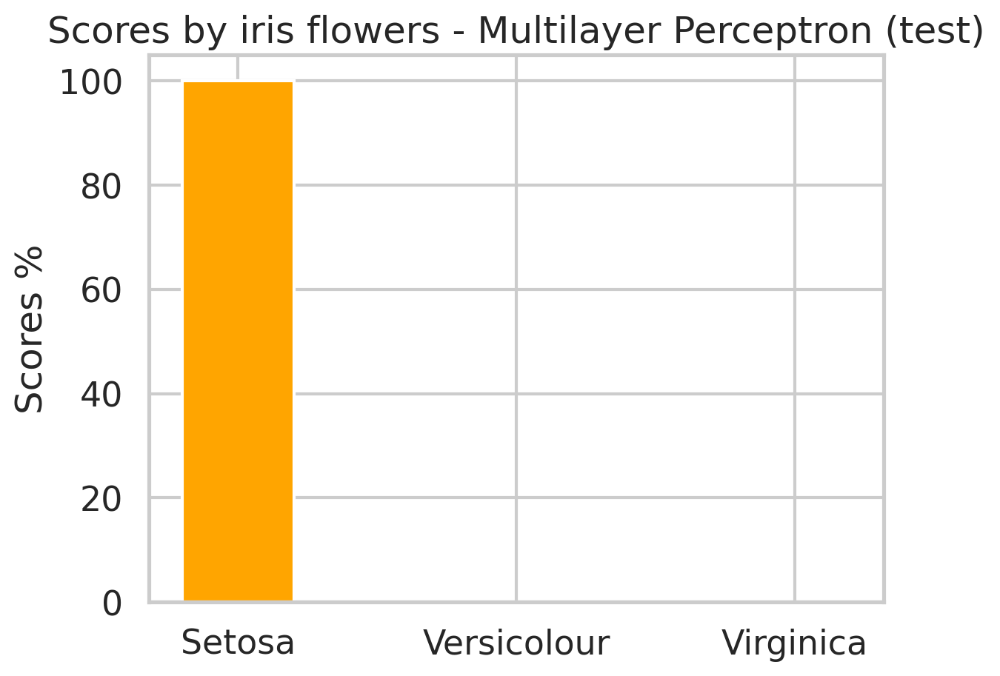

Trying parameters: {'HiddenLayer': 10, 'Epocas': 1000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.21314098548911667
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.07184202913179577
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06905624238753305
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.06823179313143446
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.06760453264343977
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.06687266587456529
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.06568984089323245
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.06297400548805994
hits test 33.33333333333333
hit

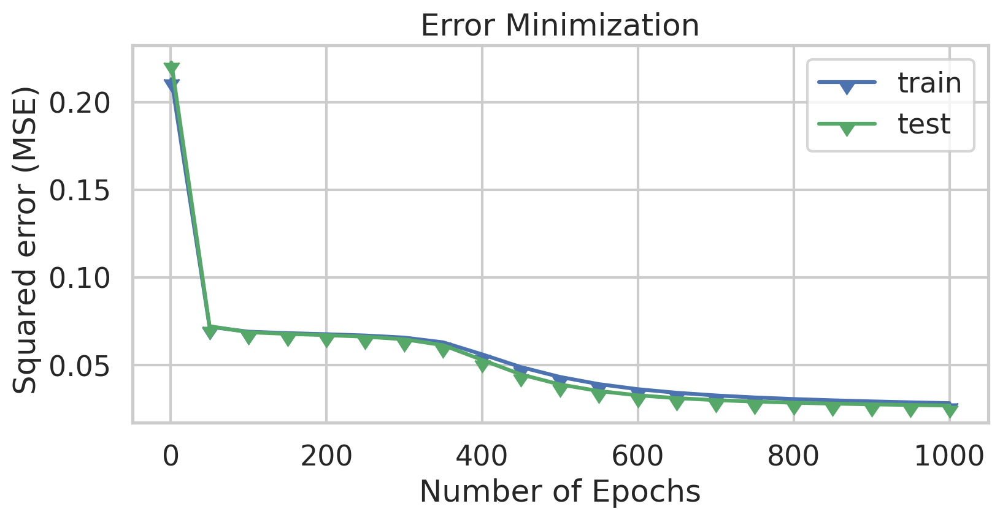

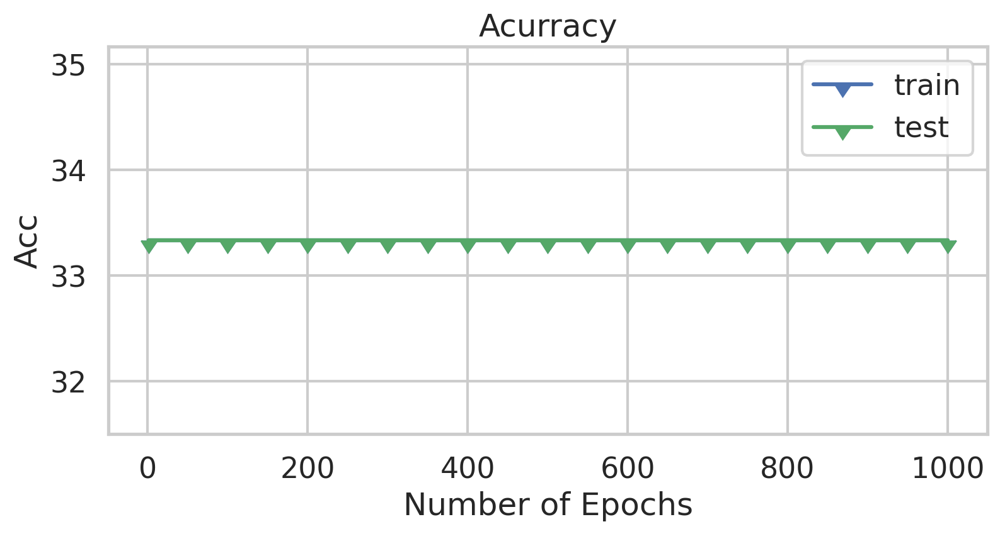

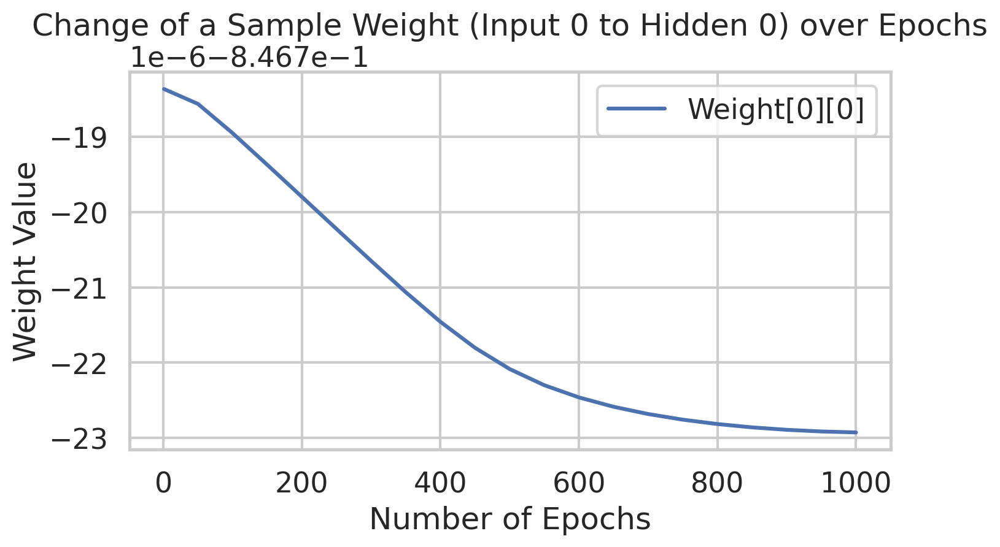

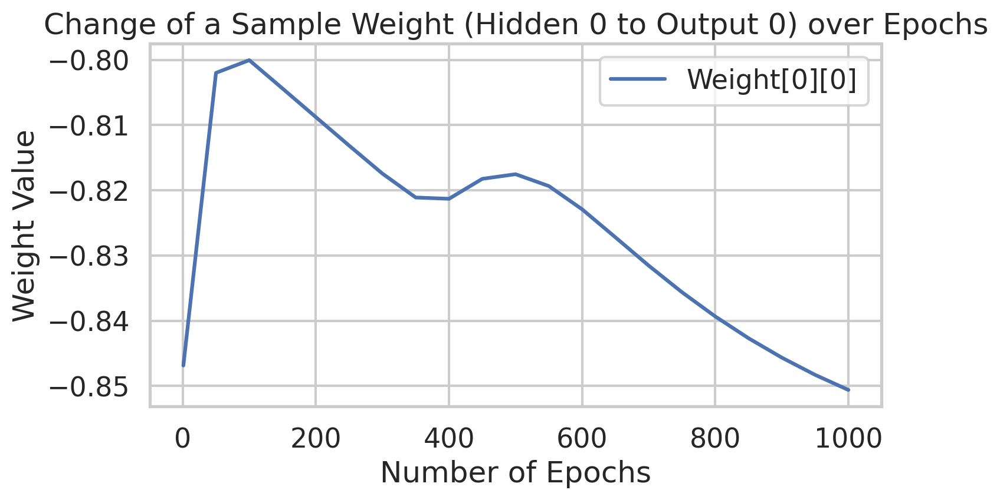

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


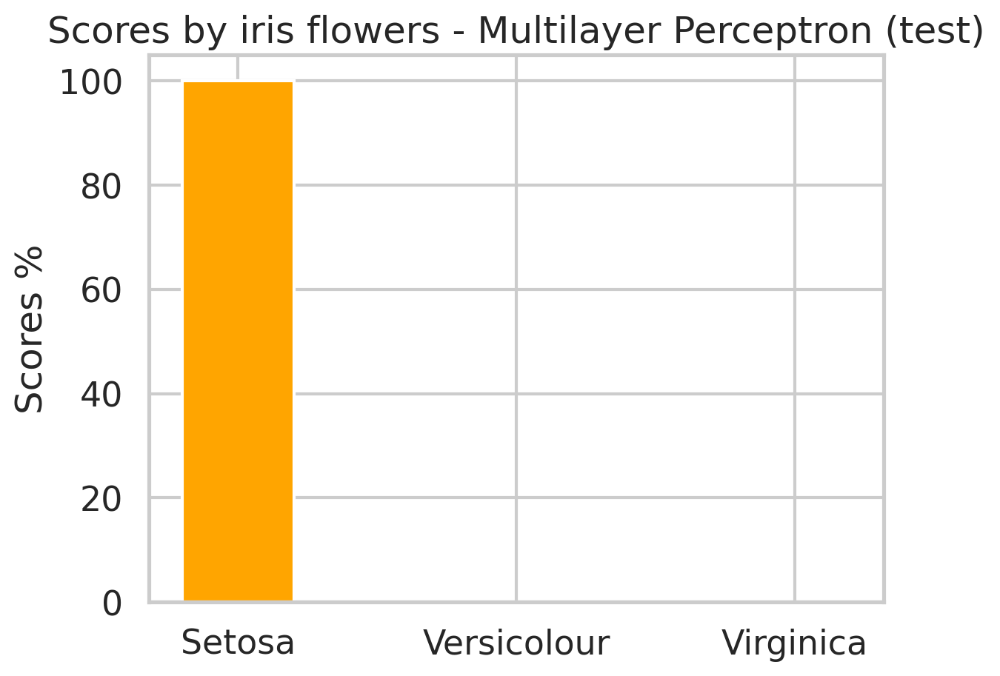

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


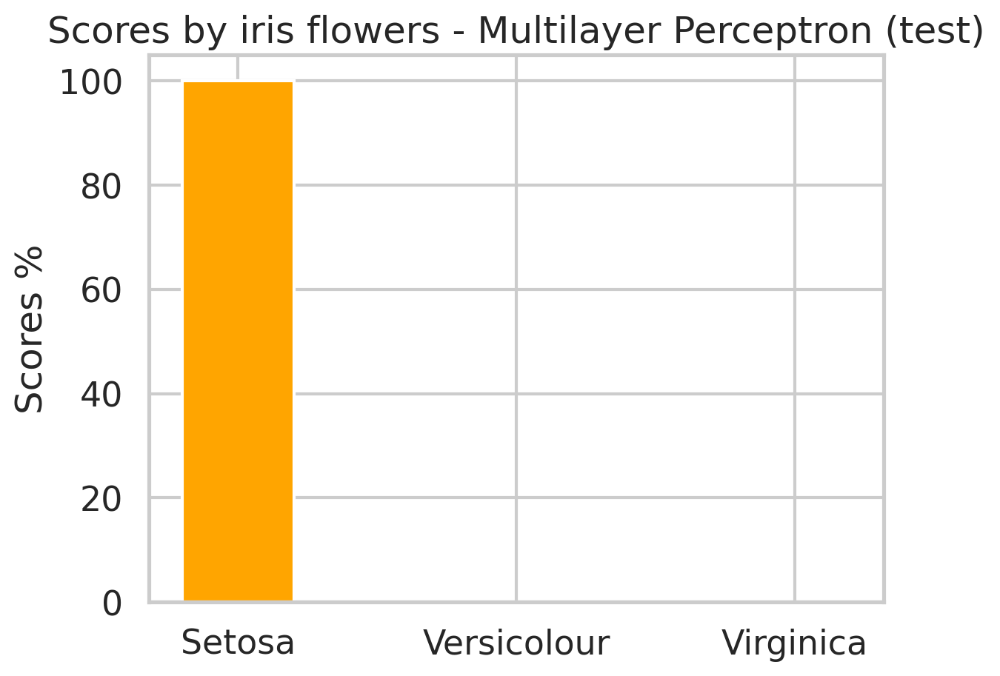

Trying parameters: {'HiddenLayer': 10, 'Epocas': 1000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.08418886718808734
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.07871984055073532
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.07473463638565922
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.07217812304845815
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.07052373269104573
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.06941185582048726
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.06862584167580736
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.06803790402036339
hits test 33.33333333333333


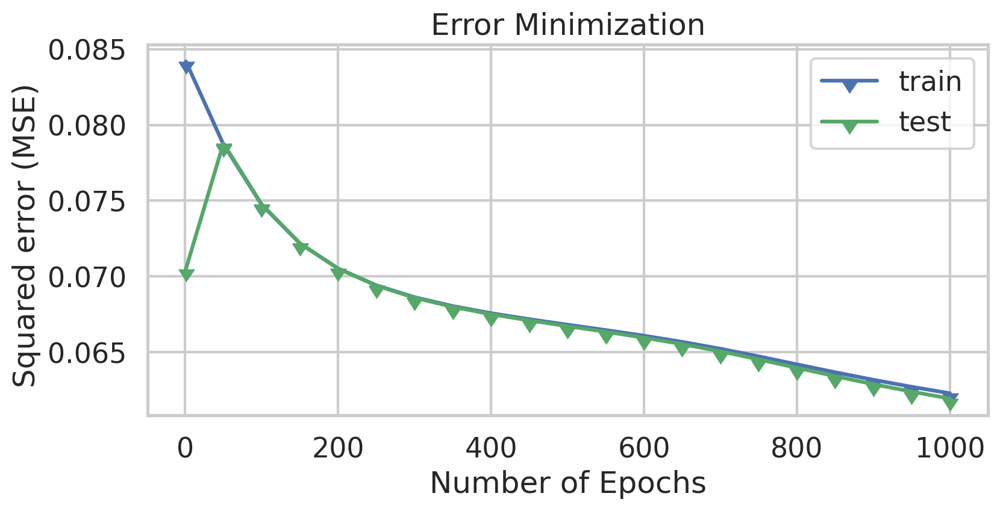

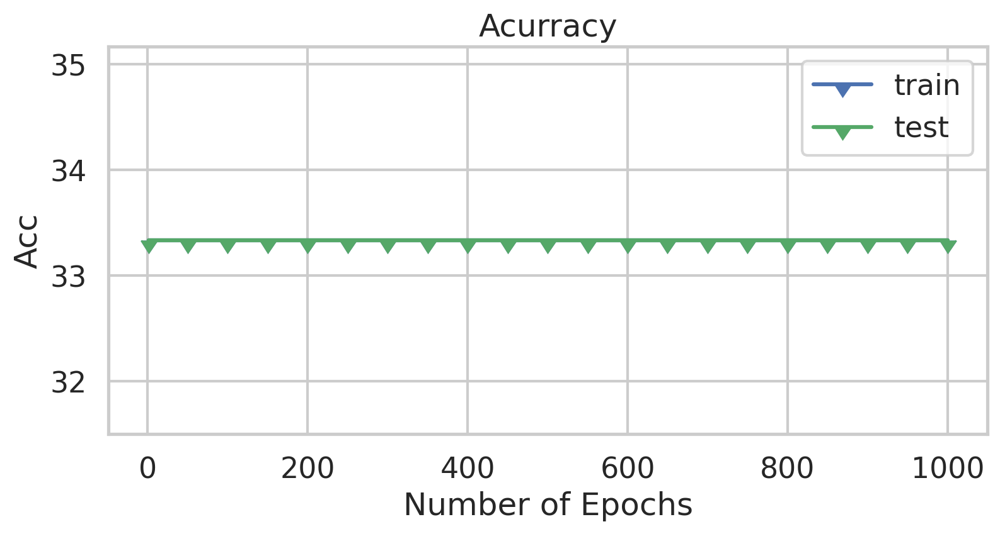

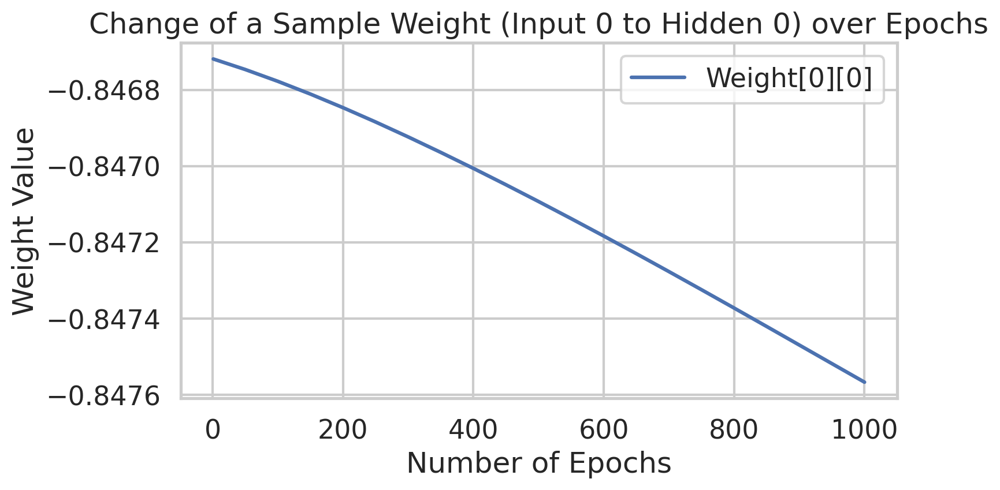

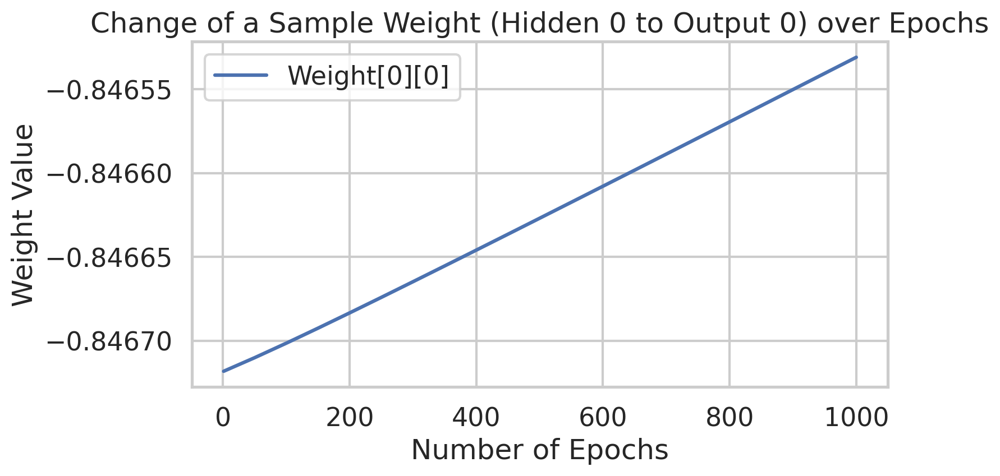

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


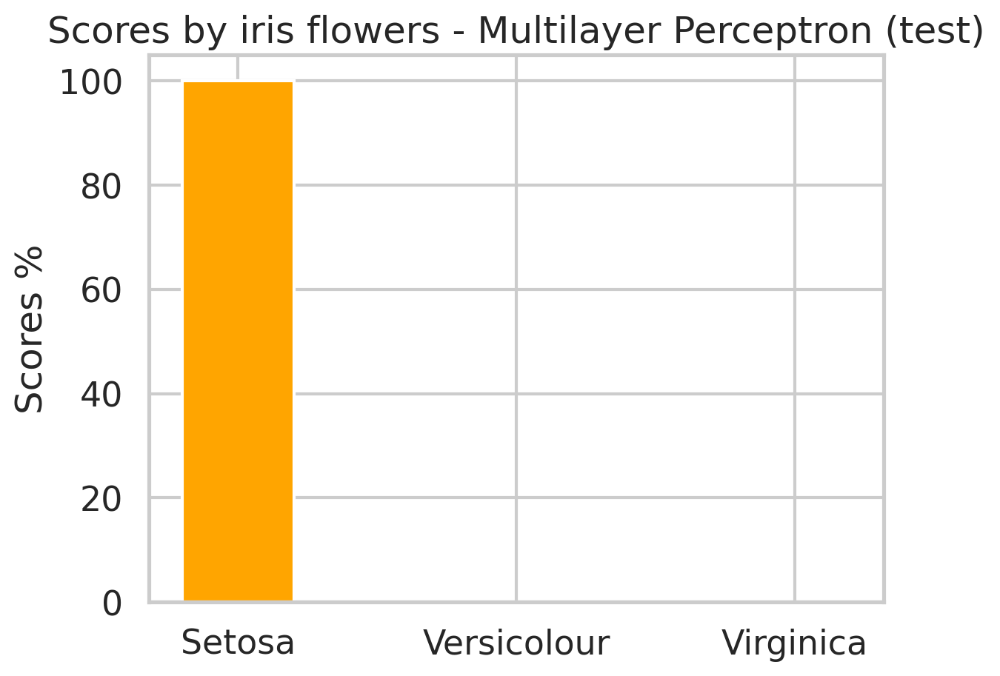

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


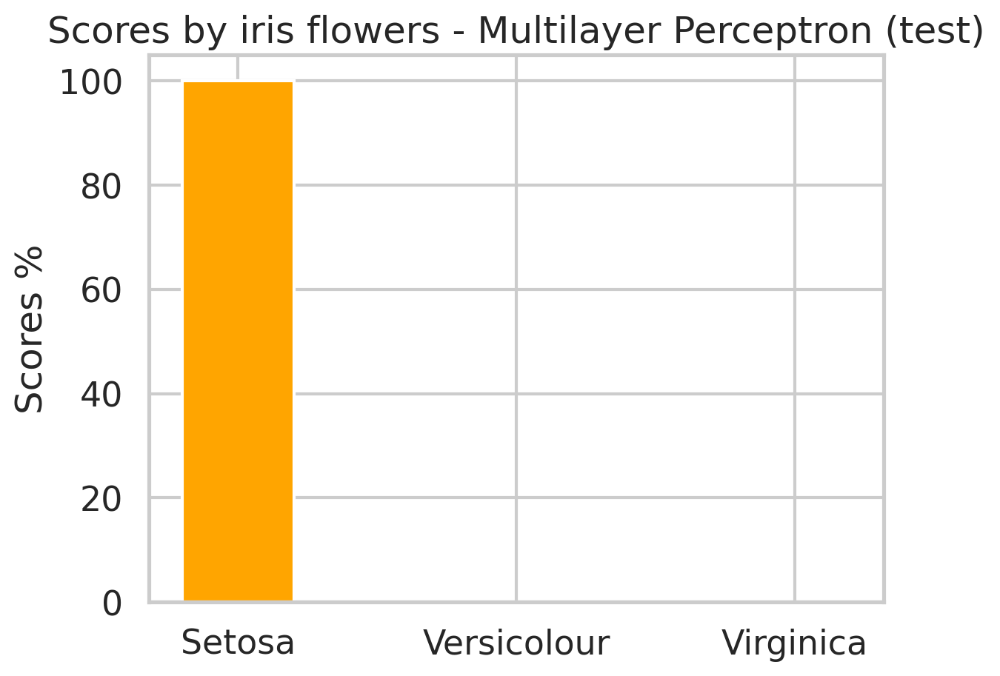

Trying parameters: {'HiddenLayer': 10, 'Epocas': 1000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hit

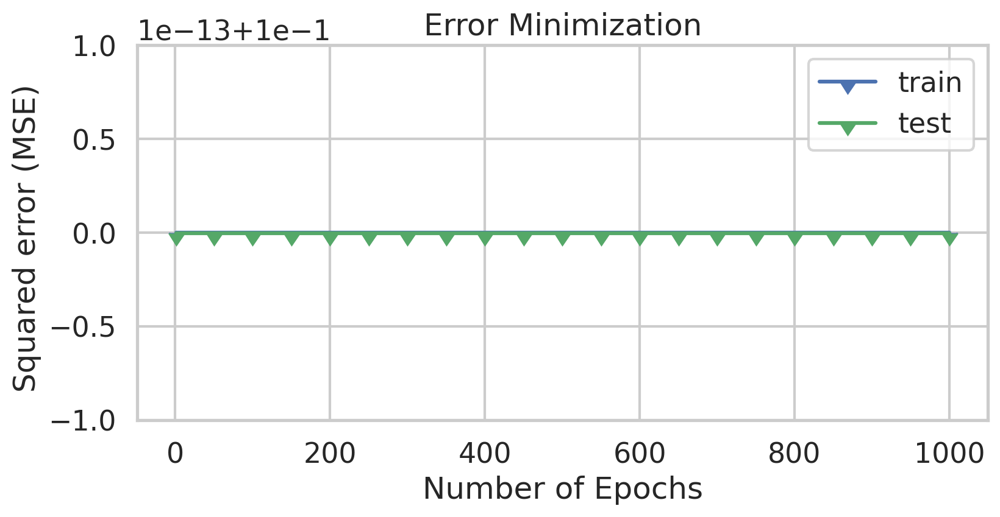

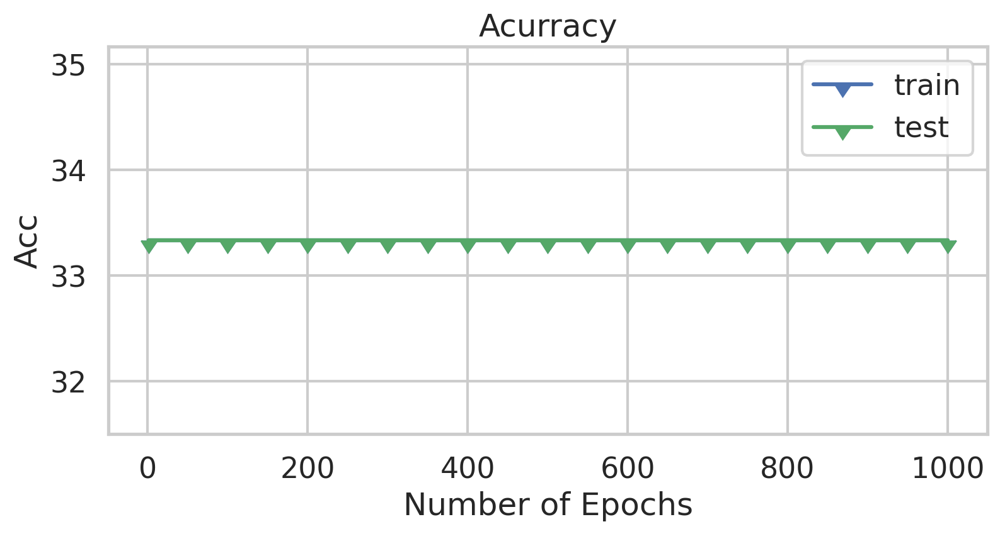

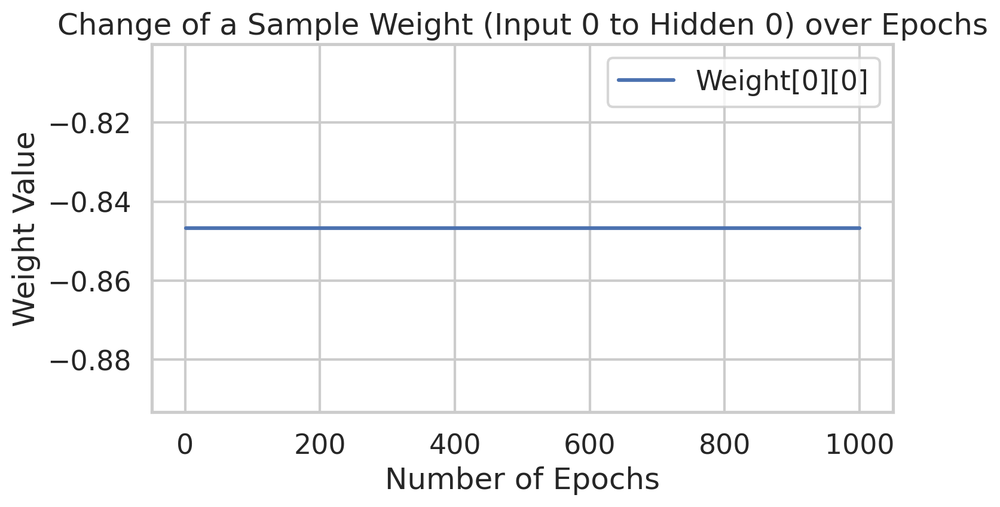

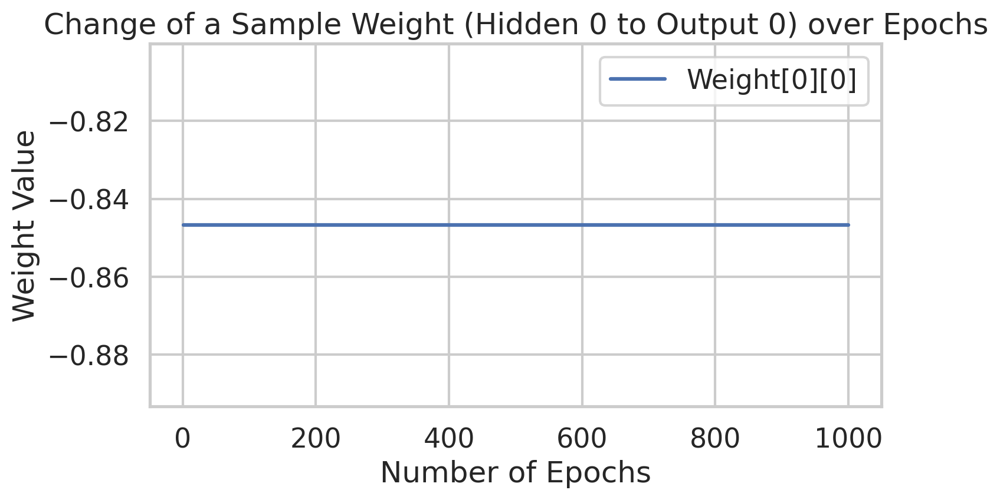

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


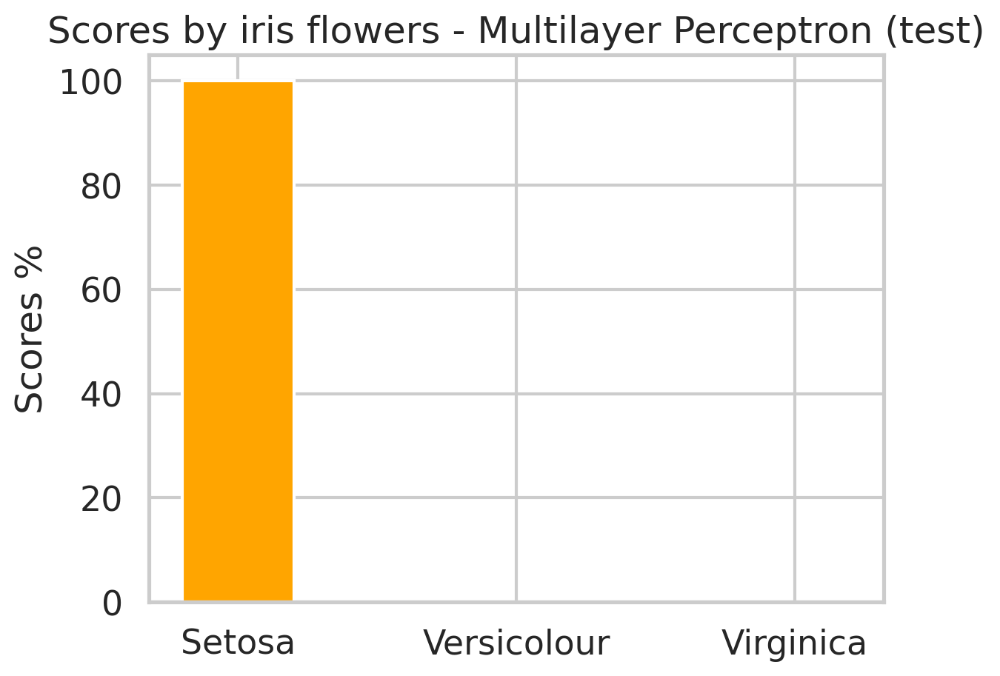

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


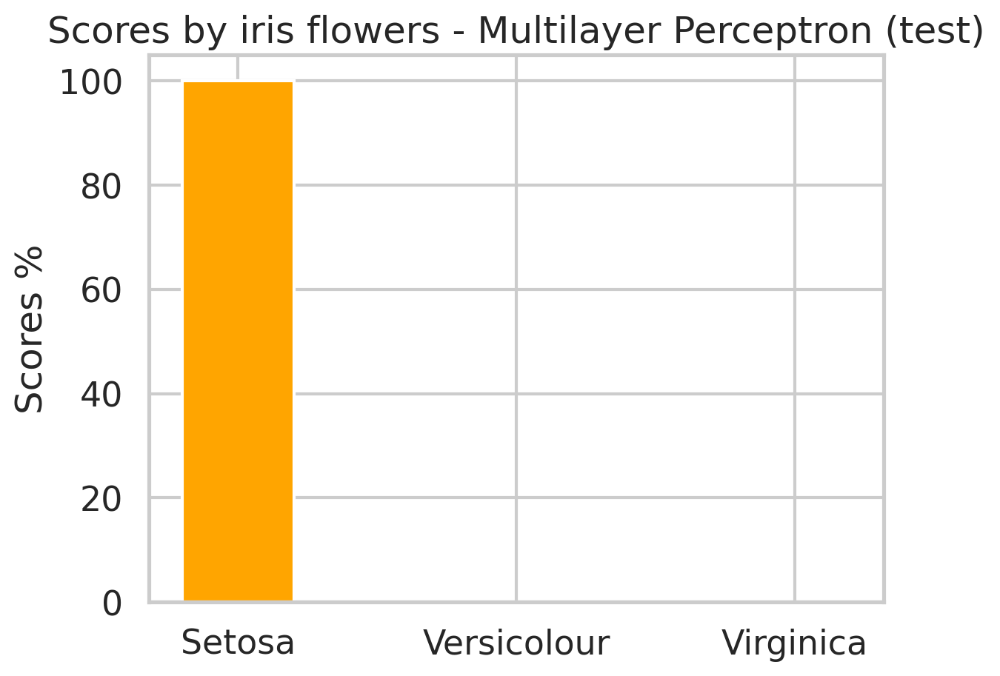

Trying parameters: {'HiddenLayer': 10, 'Epocas': 3000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.1967538337664844
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.04375473536327699
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.02845868115602301
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.023128907056150977
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.01876005056005235
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.013243090588723598
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.009783581081891835
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.008107173453971293
hits test 33.33333333333333
h

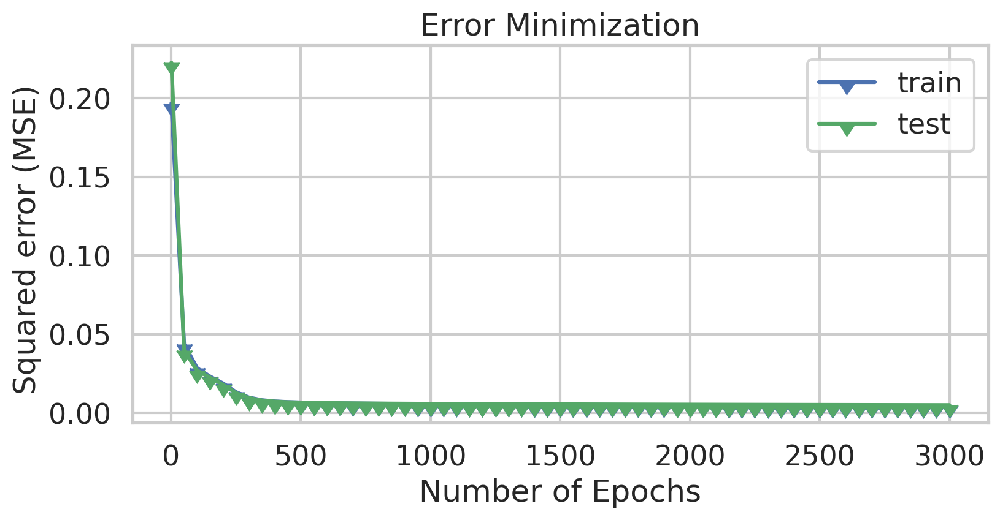

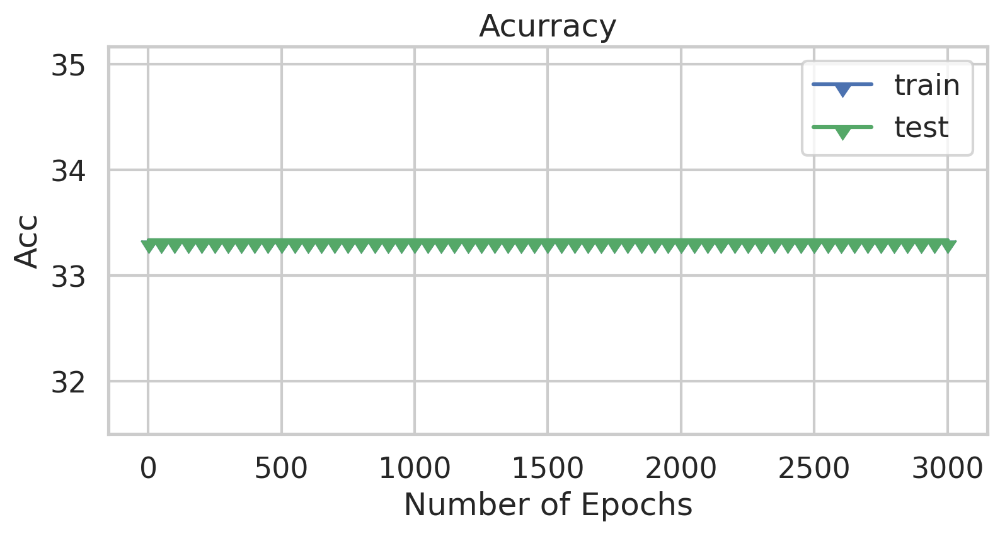

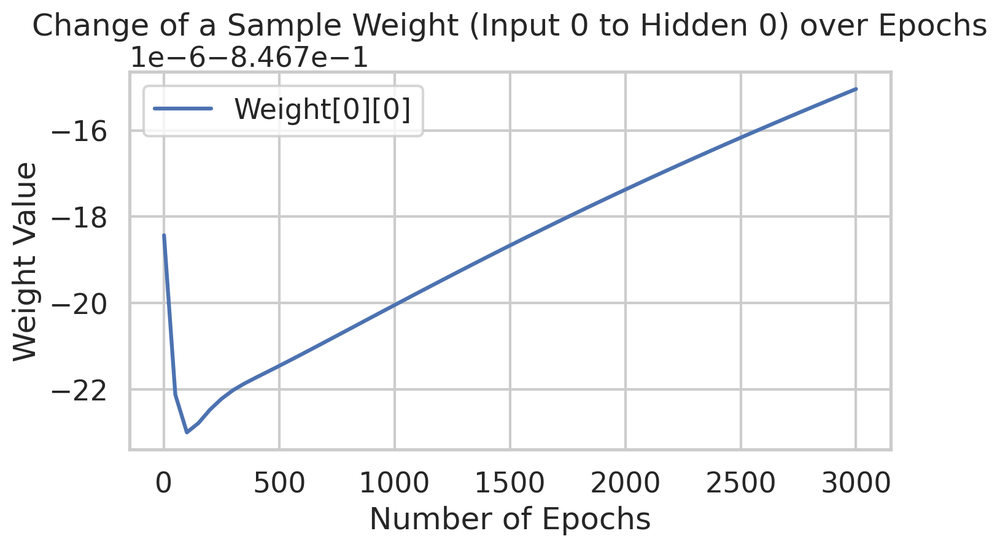

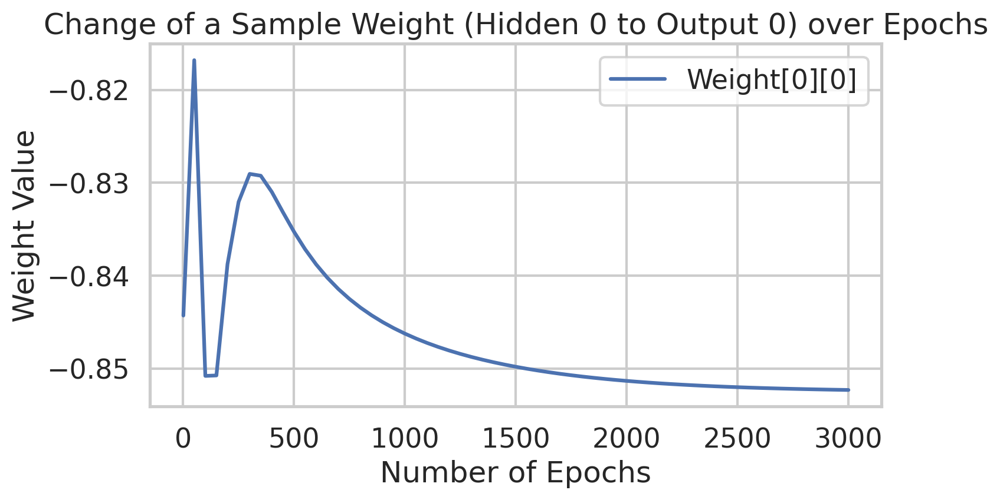

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


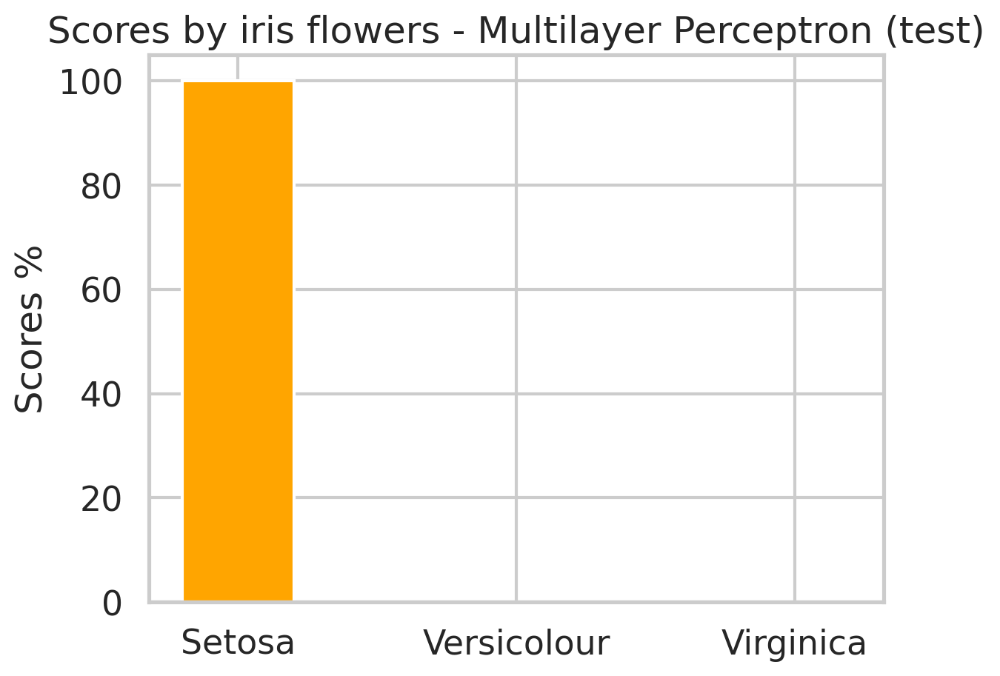

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


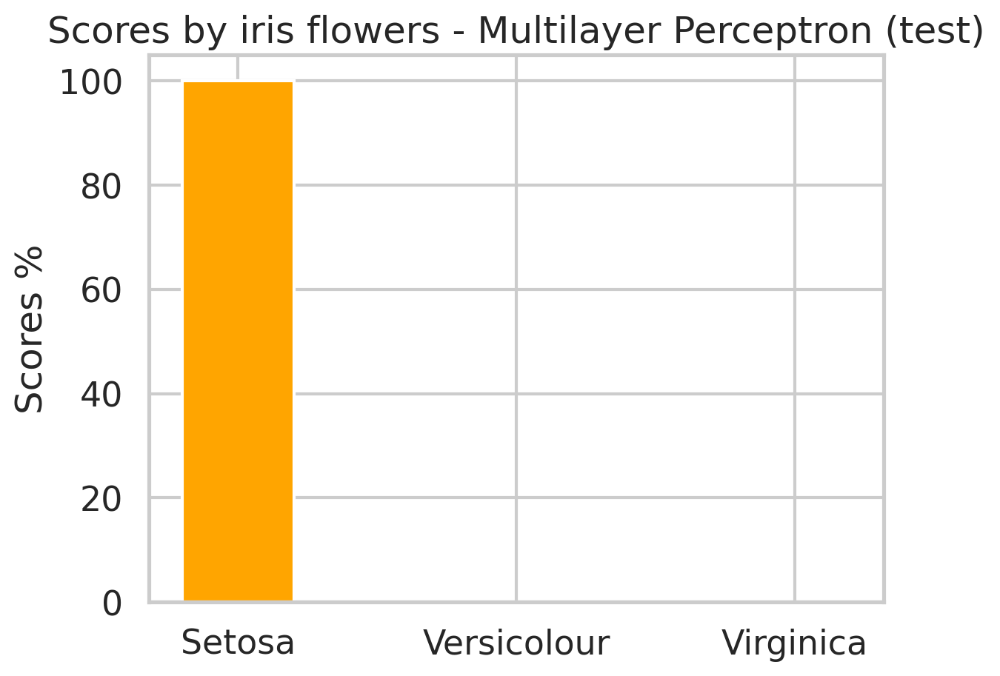

Trying parameters: {'HiddenLayer': 10, 'Epocas': 3000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.08362394702508398
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.06685577801291463
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.062342314044856836
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.05882672469323905
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.055557847016673836
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.052102962355923474
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.0485733148657611
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.04519664948831922
hits test 33.33333333333333

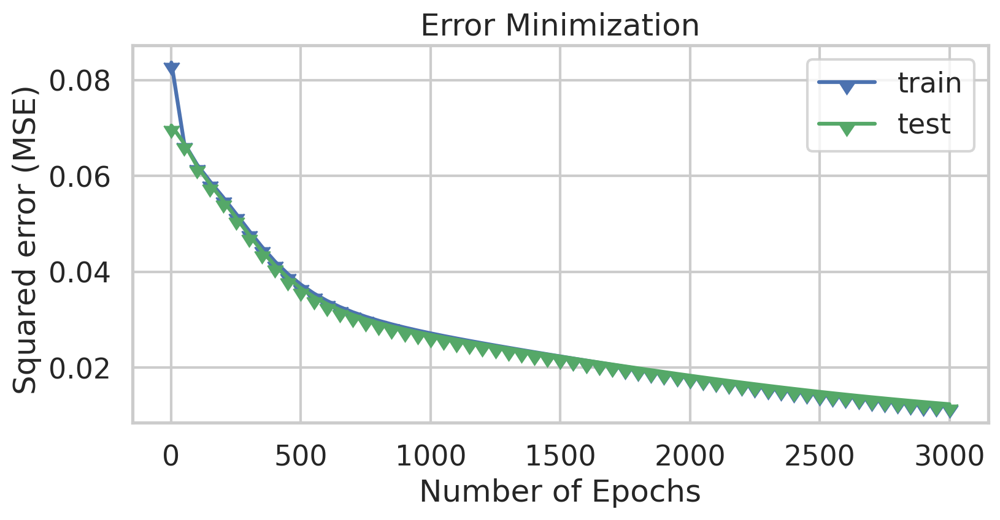

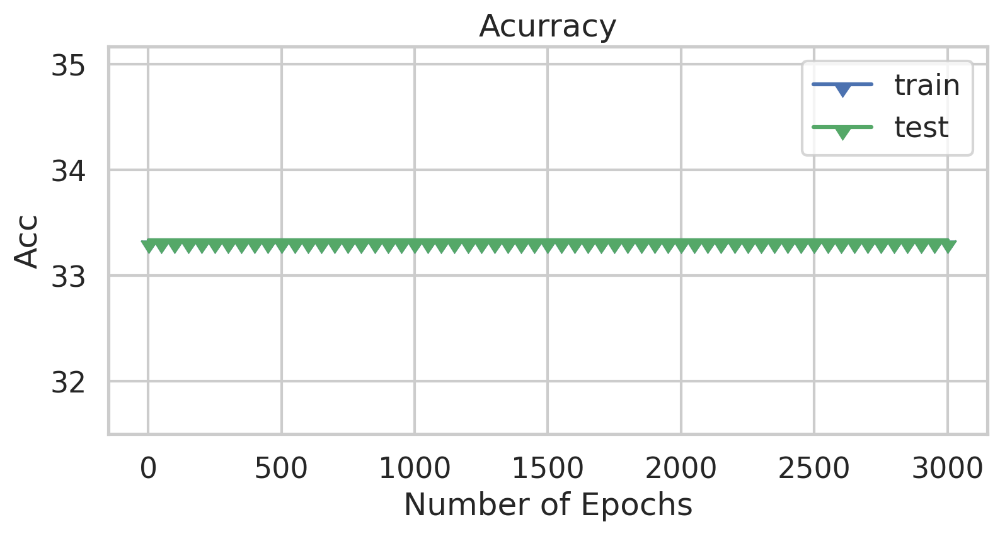

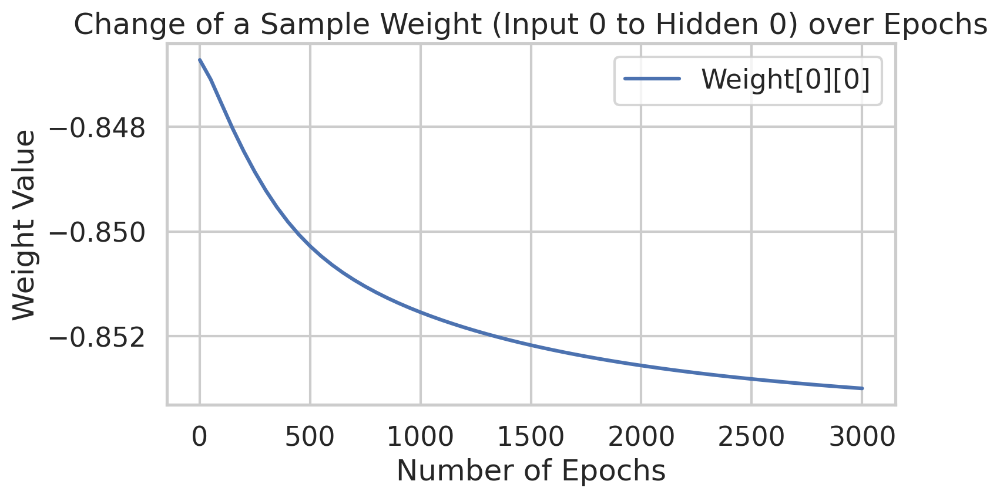

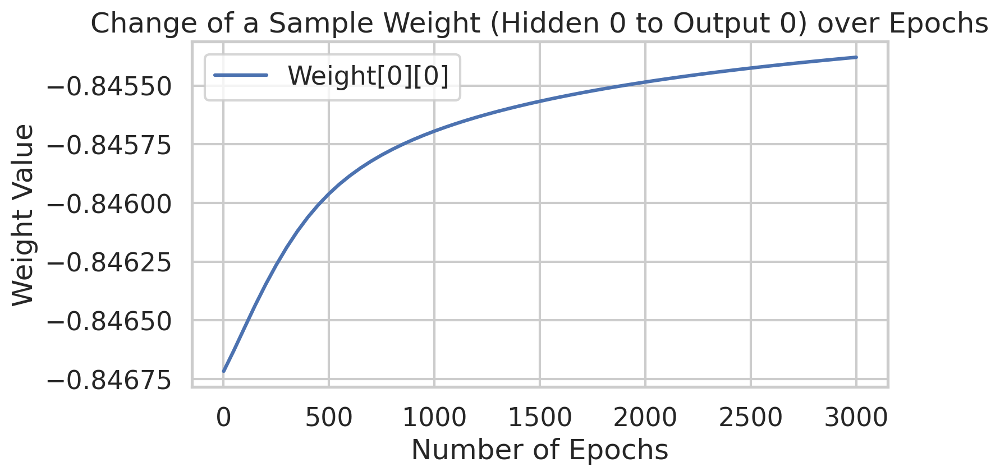

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


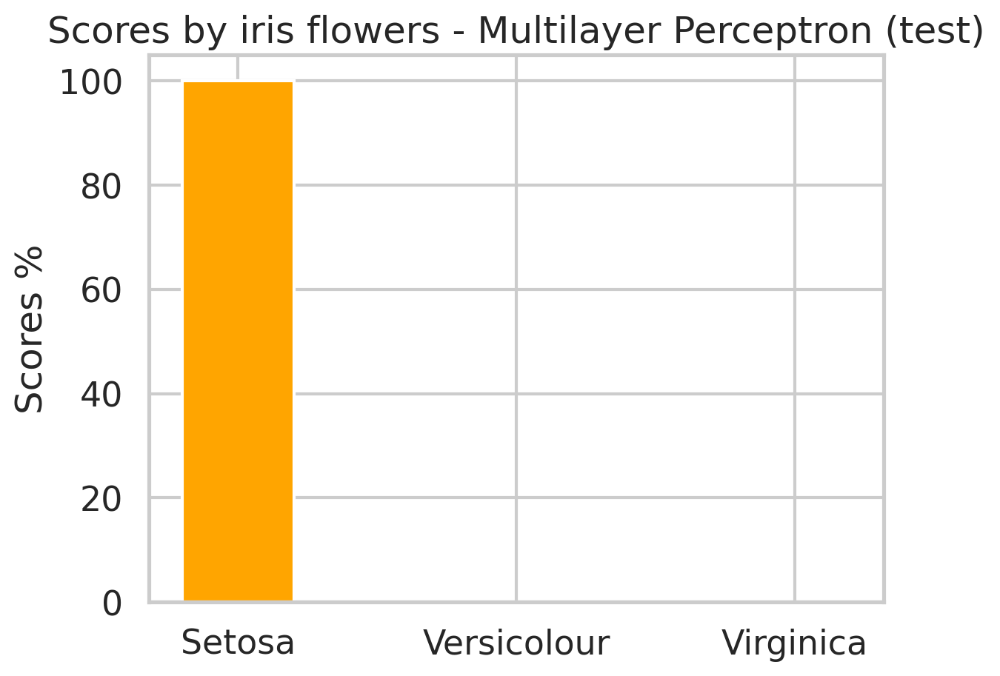

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


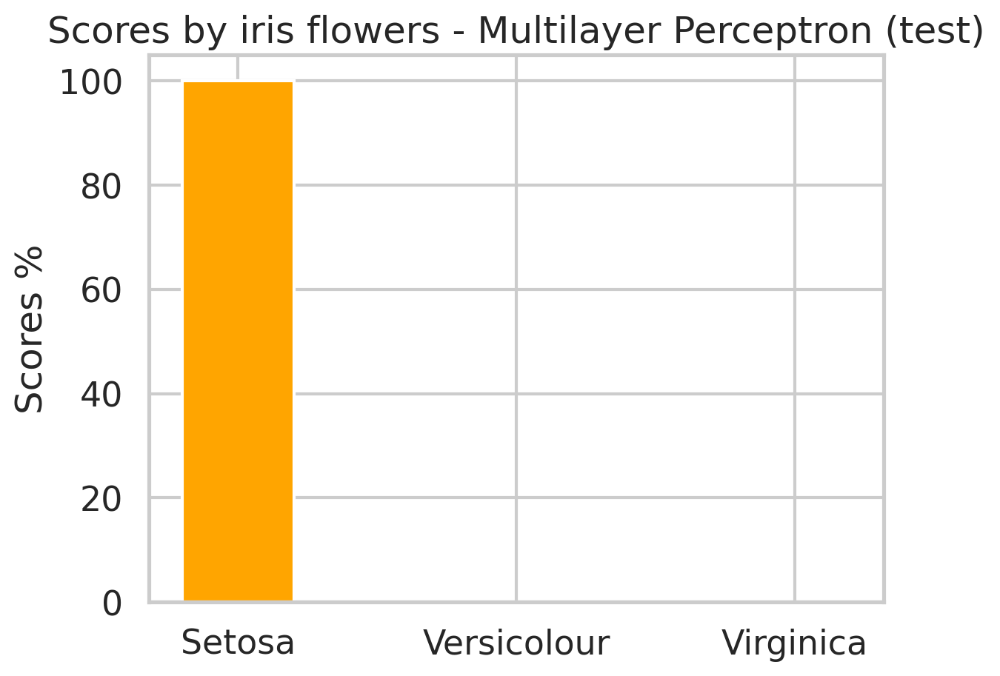

Trying parameters: {'HiddenLayer': 10, 'Epocas': 3000, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits

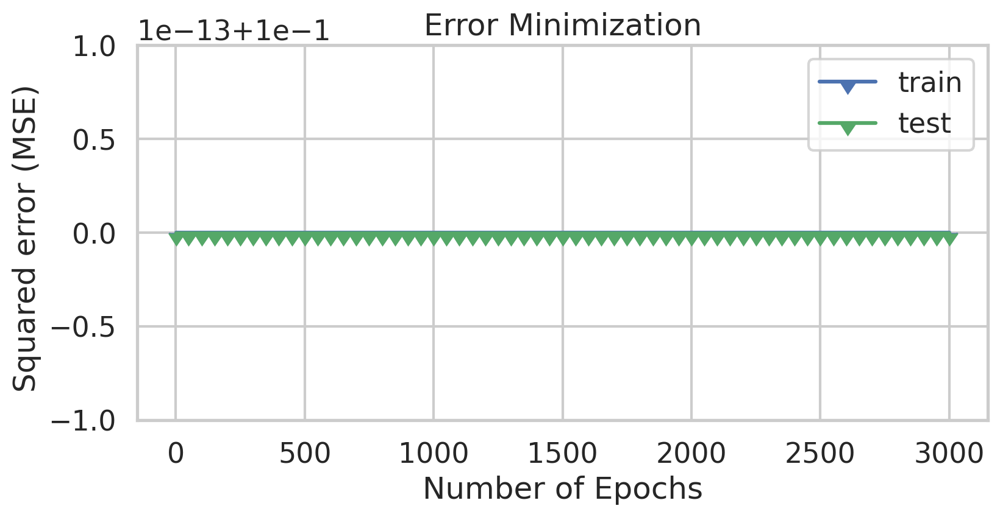

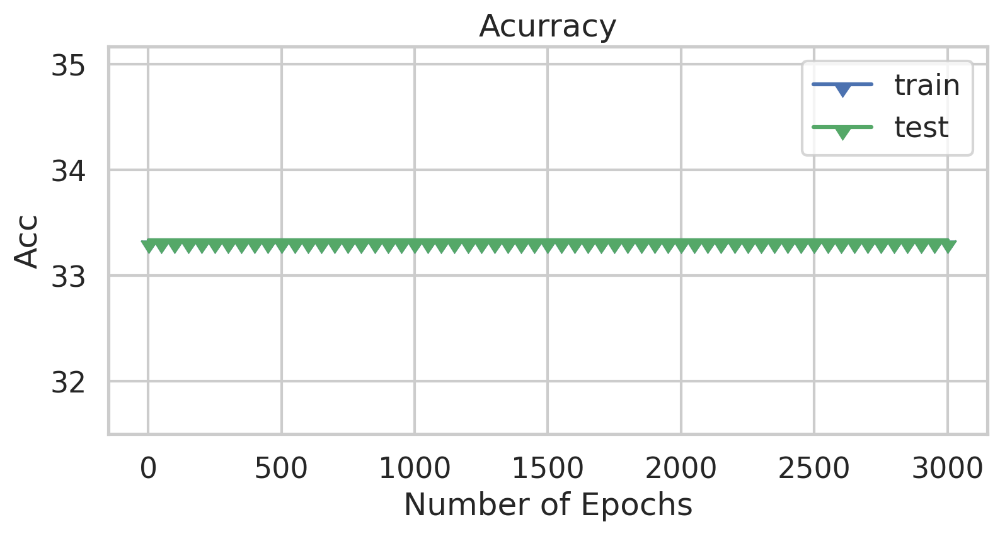

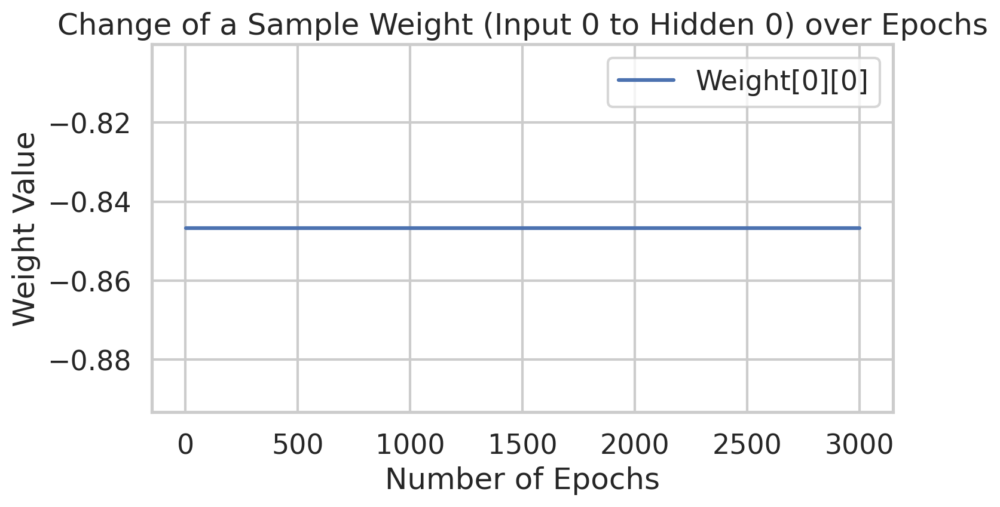

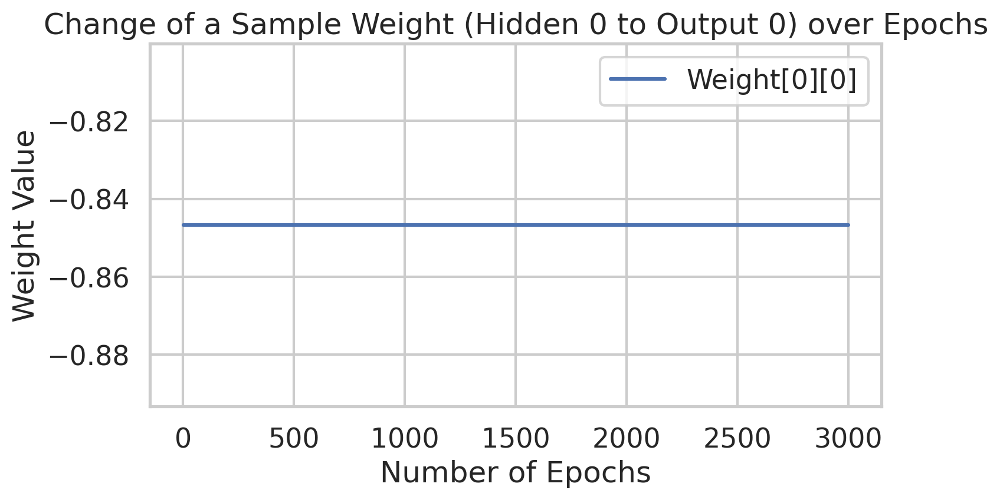

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


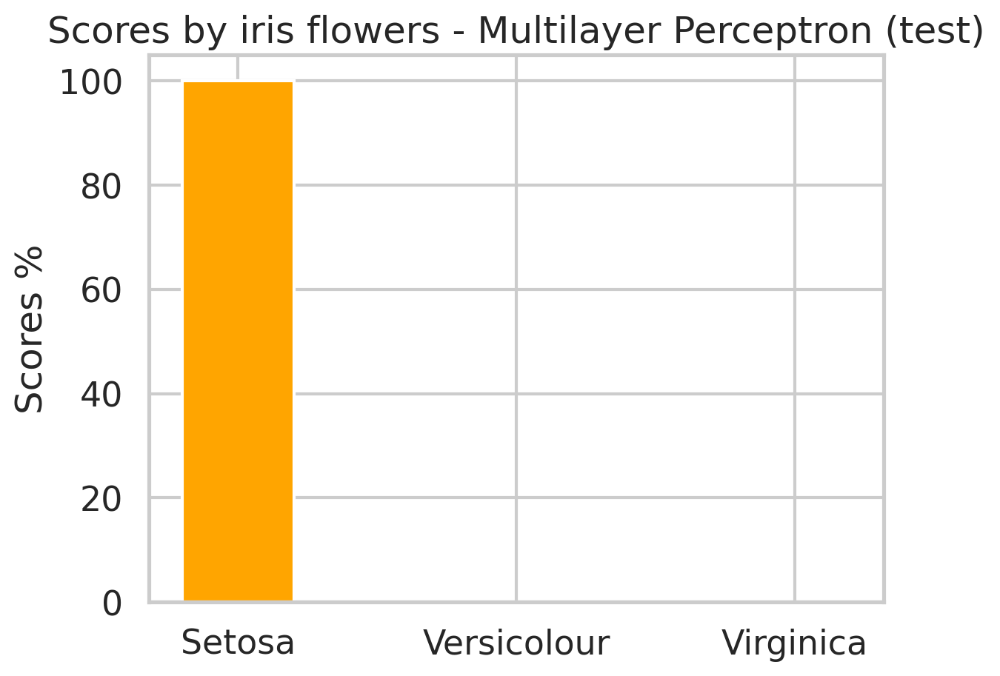

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


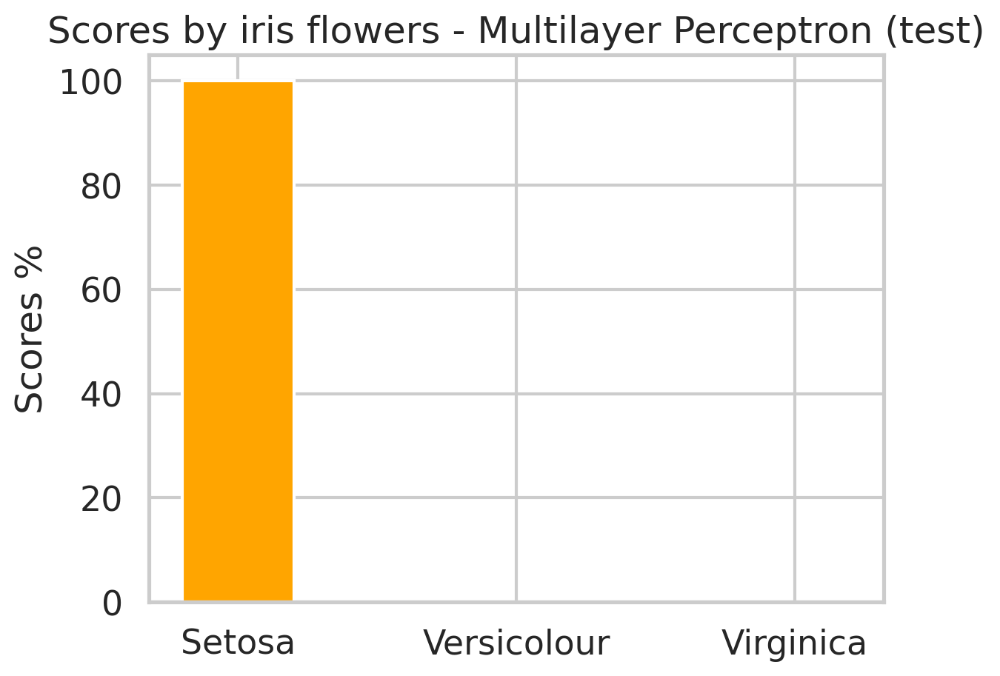

Trying parameters: {'HiddenLayer': 10, 'Epocas': 3000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.21314098548911667
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.07184202913179577
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.06905624238753305
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.06823179313143446
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.06760453264343977
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.06687266587456529
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.06568984089323245
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.06297400548805994
hits test 33.33333333333333
hit

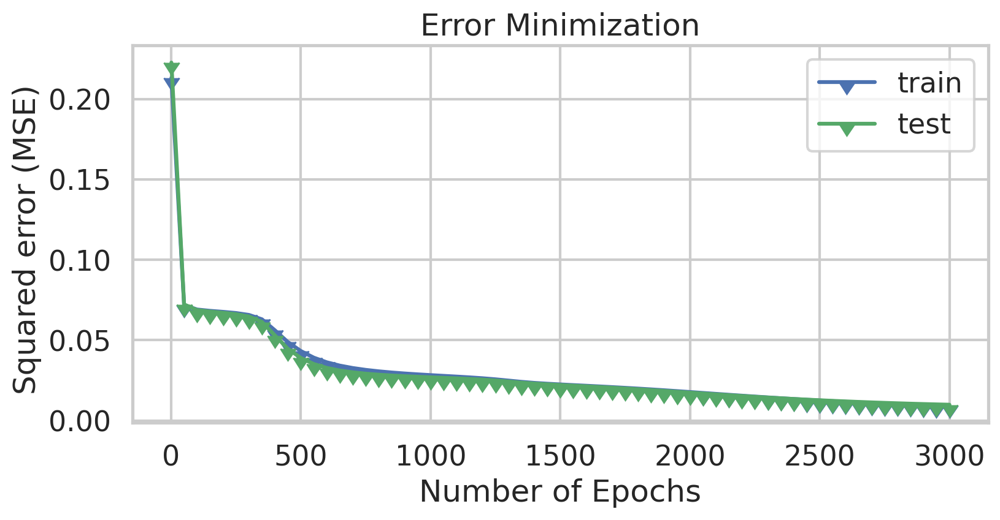

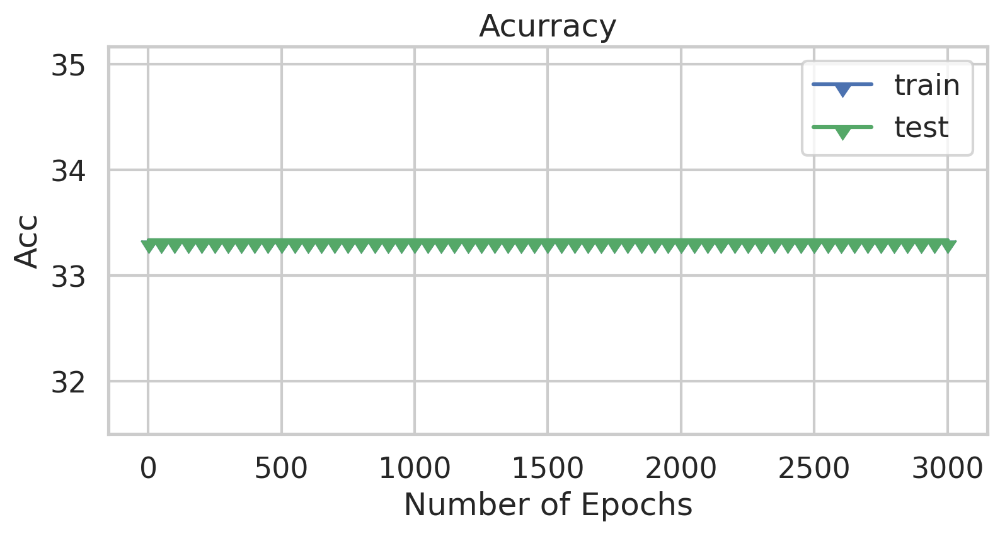

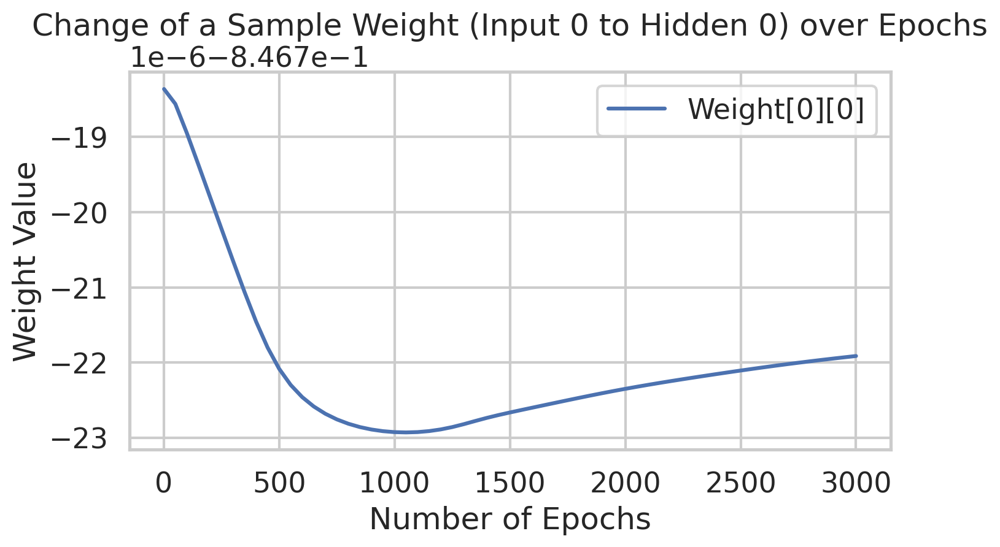

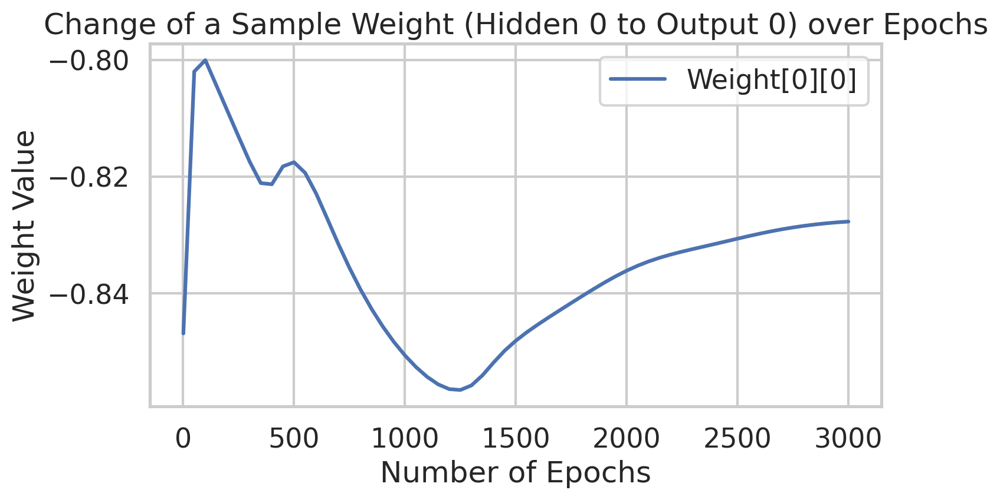

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


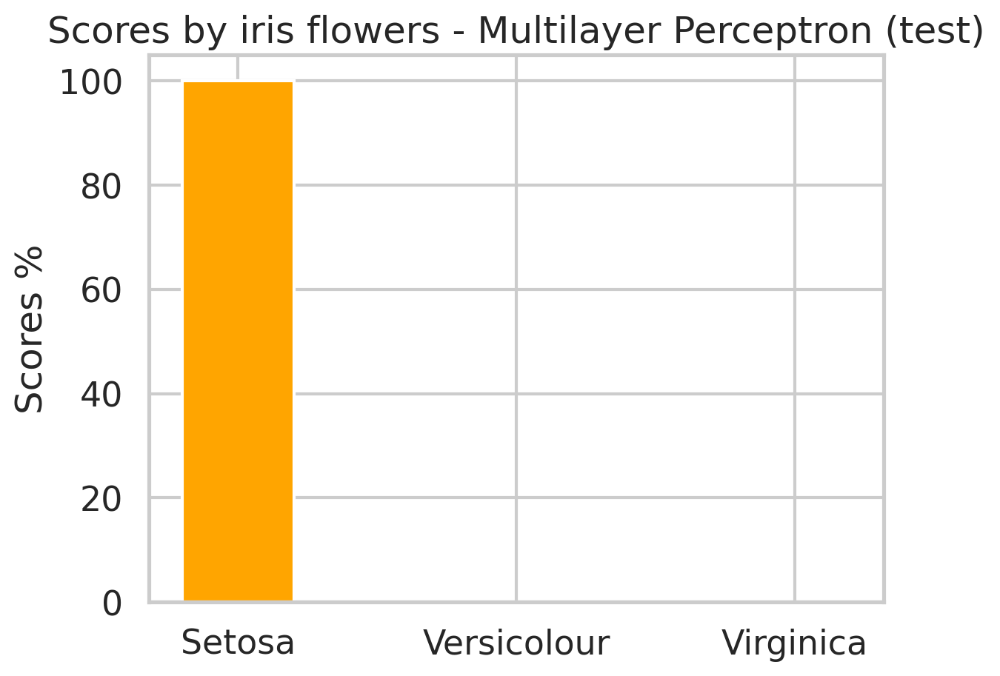

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


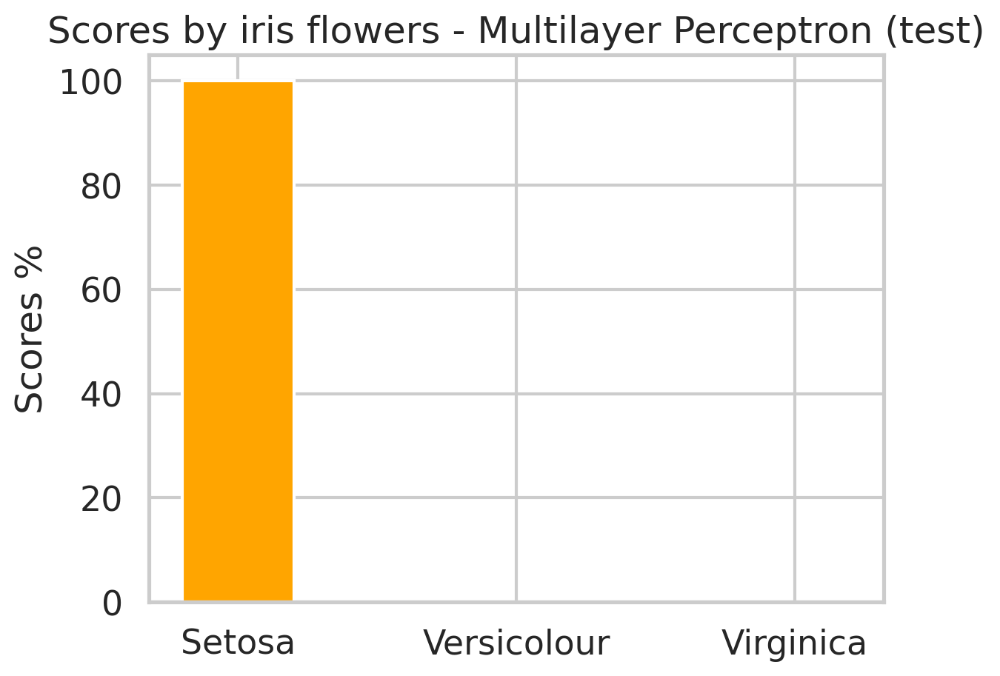

Trying parameters: {'HiddenLayer': 10, 'Epocas': 3000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'sigmoid', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.08418886718808734
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.07871984055073532
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.07473463638565922
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.07217812304845815
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.07052373269104573
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.06941185582048726
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.06862584167580736
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.06803790402036339
hits test 33.33333333333333


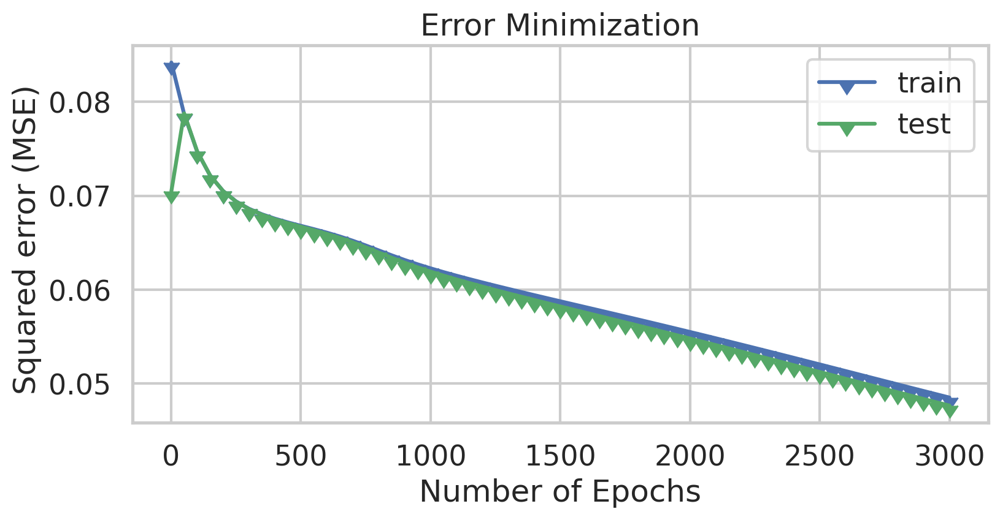

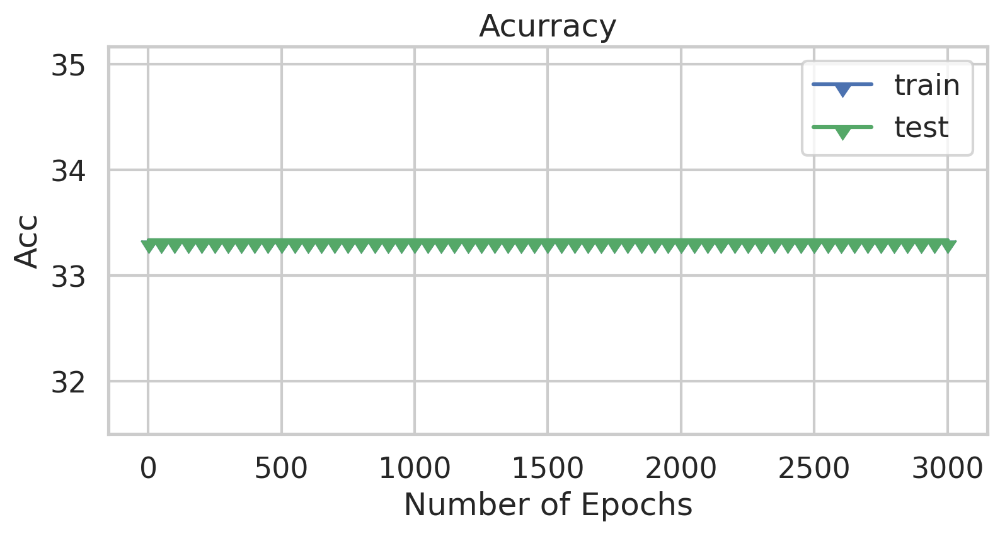

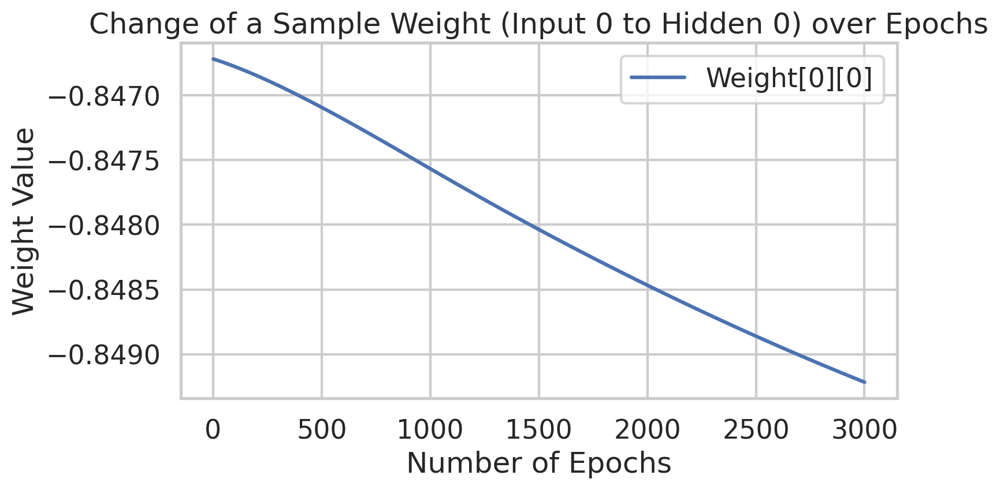

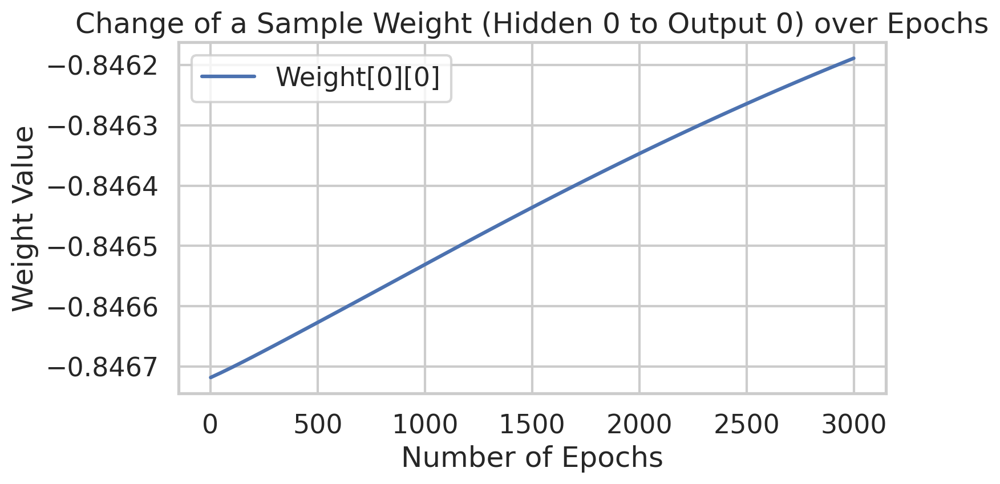

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


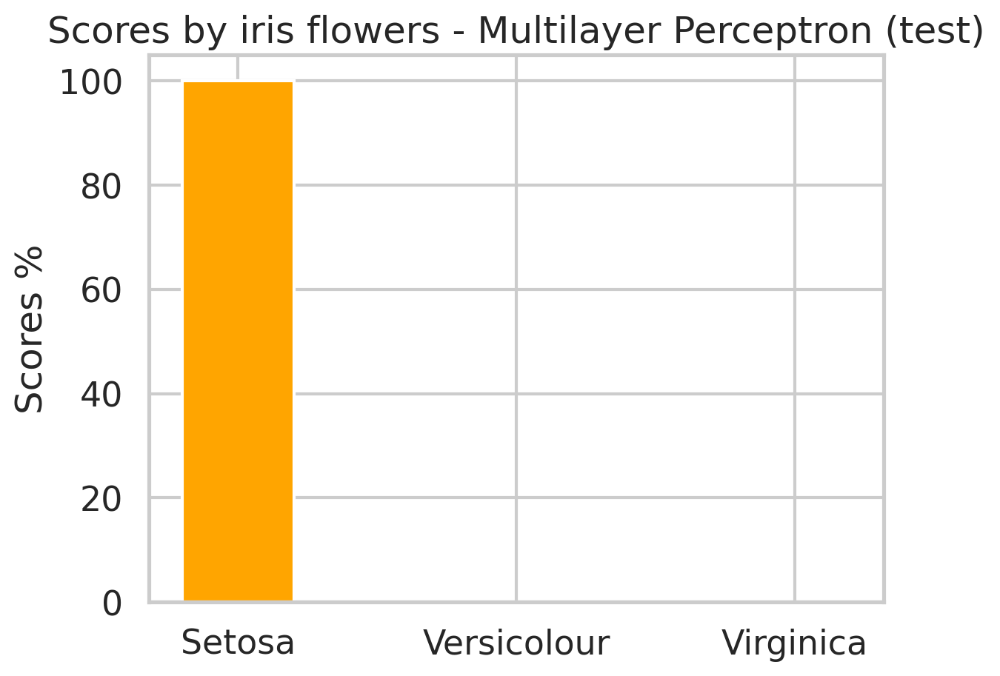

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


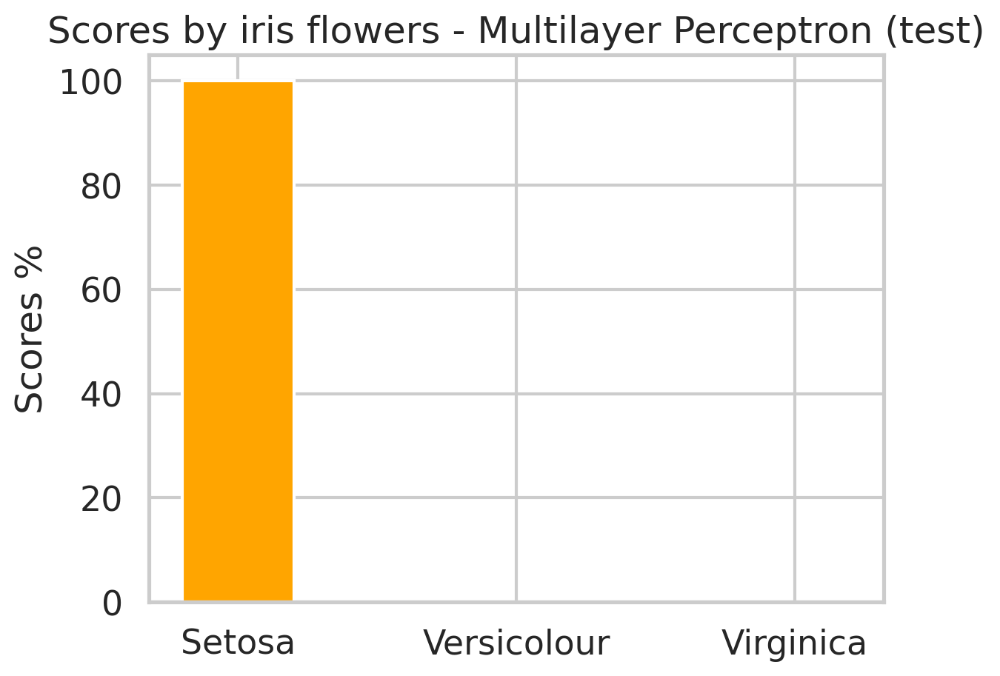

Trying parameters: {'HiddenLayer': 10, 'Epocas': 3000, 'LearningRate': 0.0001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'Relu', 'InputLayer': 4, 'OutputLayer': 3}
Epoch  1 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  50 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  100 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  150 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  200 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  250 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  300 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hits train  33.33333333333333
Epoch  350 - Total Error:  0.10000000000000013
hits test 33.33333333333333
hit

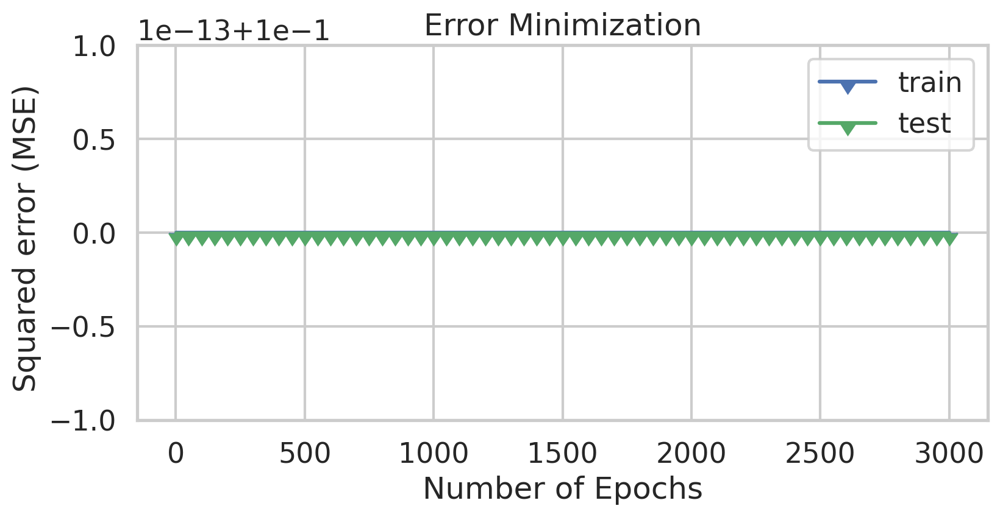

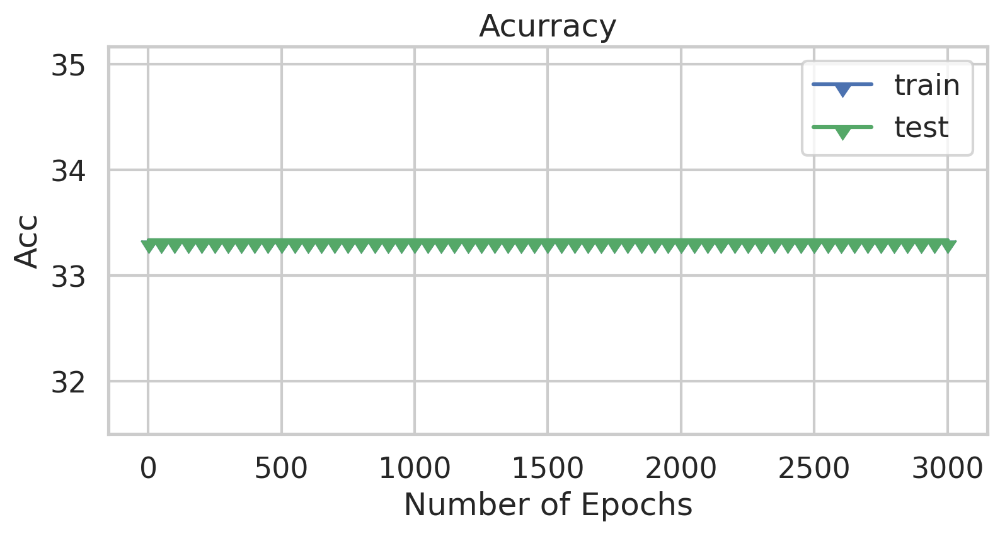

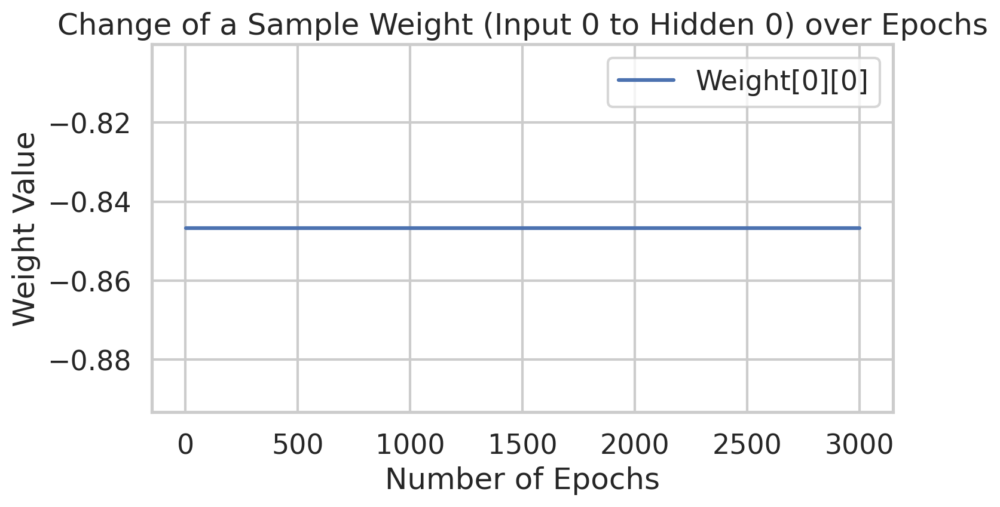

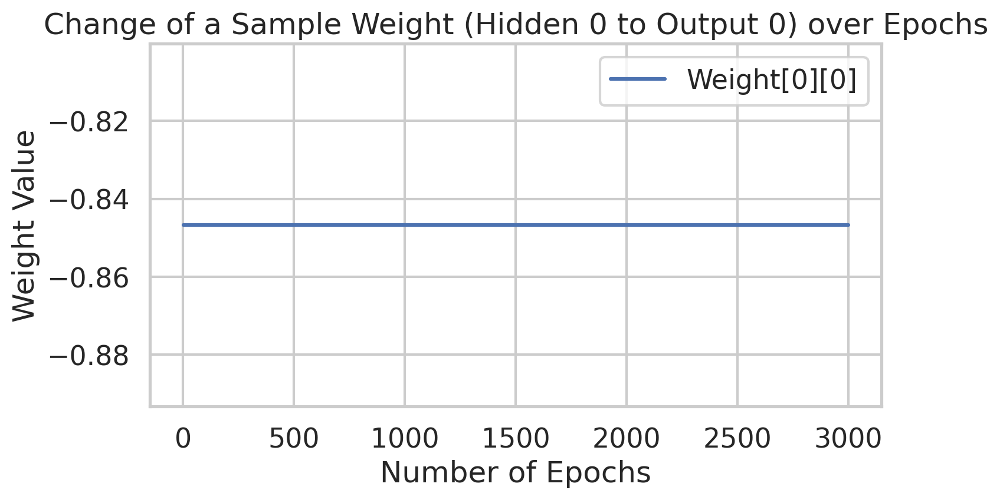

Max test acc =  33.33333333333333
Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 35 samples 35 hits
*Iris-Versicolour: 35 samples 0 hits
*Iris-Virginica: 35 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


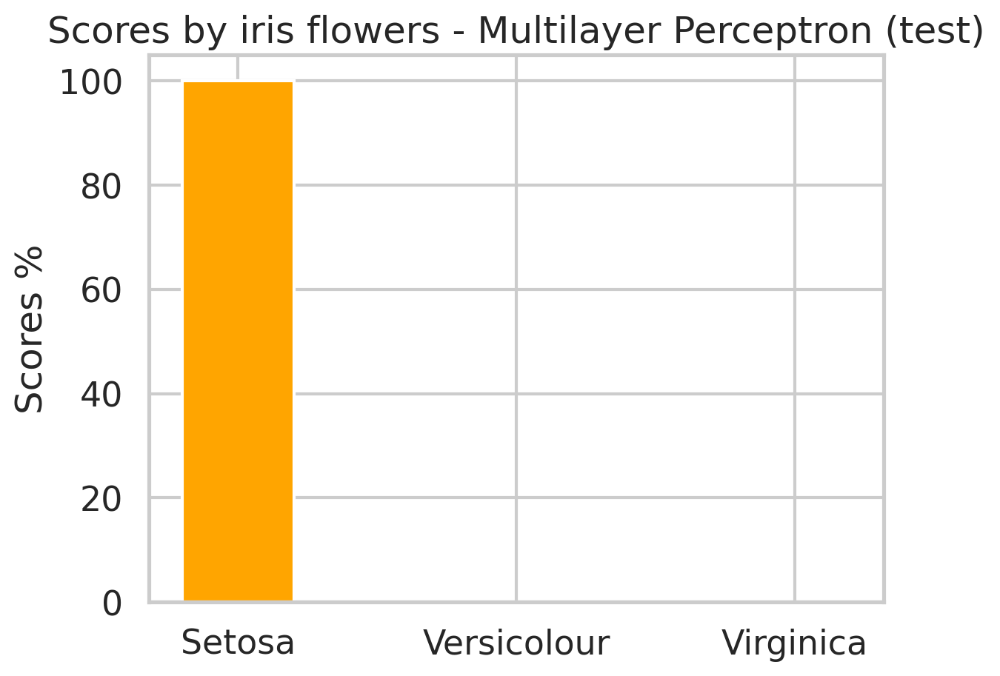

Porcents : 33.33 % hits and 66.67 % faults
Total samples of test 105
*Iris-Setosa: 15 samples 15 hits
*Iris-Versicolour: 15 samples 0 hits
*Iris-Virginica: 15 samples 0 hits
- Acurracy Iris-Setosa: 100.00 %
- Acurracy Iris-Versicolour: 0.00 %
- Acurracy Iris-Virginica: 0.00 %


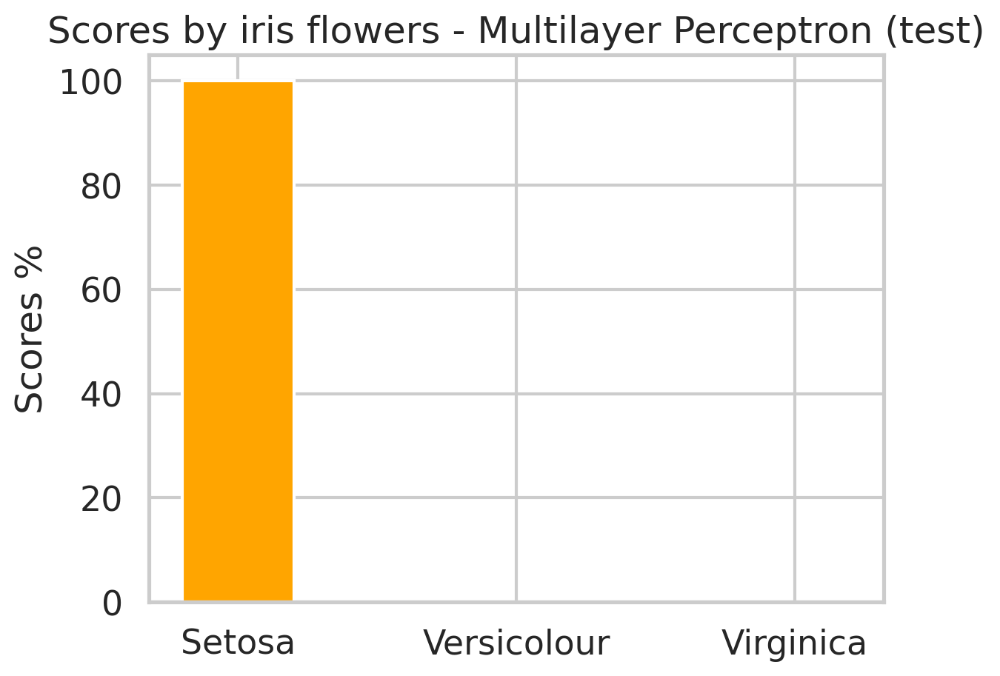


--- Grid Search Complete ---
Best test score: 33.33333333333333
Best parameters found: {'HiddenLayer': 5, 'Epocas': 500, 'LearningRate': 0.001, 'BiasHiddenValue': -1, 'BiasOutputValue': -1, 'ActivationFunction': 'tanh', 'InputLayer': 4, 'OutputLayer': 3}


In [99]:
import itertools
import numpy as np
from sklearn.model_selection import KFold

def score_test(test_X, test_y, train_X, train_y):

  prev, dataframe = Perceptron.predict(train_X, train_y)
  hits = n_set = n_vers = n_virg = 0
  score_set = score_vers = score_virg = 0
  for j in range(len(train_y)):
      if(train_y[j] == 0): n_set += 1
      elif(train_y[j] == 1): n_vers += 1
      elif(train_y[j] == 2): n_virg += 1

  for i in range(len(train_y)):
      if train_y[i] == prev[i]:
          hits += 1
      if train_y[i] == prev[i] and train_y[i] == 0:
          score_set += 1
      elif train_y[i] == prev[i] and train_y[i] == 1:
          score_vers += 1
      elif train_y[i] == prev[i] and train_y[i] == 2:
          score_virg += 1

  hits = (hits / len(train_y)) * 100
  faults = 100 - hits

  print("Porcents :","%.2f"%(hits),"% hits","and","%.2f"%(faults),"% faults")
  print("Total samples of test",len(train_y))
  print("*Iris-Setosa:",n_set,"samples", score_set, "hits")
  print("*Iris-Versicolour:",n_vers,"samples", score_vers, "hits")
  print("*Iris-Virginica:",n_virg,"samples", score_virg, "hits")

  acc_set = (score_set/n_set)*100
  acc_vers = (score_vers/n_vers)*100
  acc_virg = (score_virg/n_virg)*100
  print("- Acurracy Iris-Setosa:","%.2f"%acc_set, "%")
  print("- Acurracy Iris-Versicolour:","%.2f"%acc_vers, "%")
  print("- Acurracy Iris-Virginica:","%.2f"%acc_virg, "%")
  names = ["Setosa","Versicolour","Virginica"]
  x1 = [2.0,4.0,6.0]
  fig, ax = plt.subplots()
  r1 = plt.bar(x1[0], acc_set,color='orange',label='Iris-Setosa')
  r2 = plt.bar(x1[1], acc_vers,color='green',label='Iris-Versicolour')
  r3 = plt.bar(x1[2], acc_virg,color='purple',label='Iris-Virginica')
  plt.ylabel('Scores %')
  plt.xticks(x1, names);plt.title('Scores by iris flowers - Multilayer Perceptron (test)')
  plt.show()


  prev, dataframe = Perceptron.predict(test_X, test_y)
  hits = n_set = n_vers = n_virg = 0
  score_set = score_vers = score_virg = 0
  for j in range(len(test_y)):
      if(test_y[j] == 0): n_set += 1
      elif(test_y[j] == 1): n_vers += 1
      elif(test_y[j] == 2): n_virg += 1

  for i in range(len(test_y)):
      if test_y[i] == prev[i]:
          hits += 1
      if test_y[i] == prev[i] and test_y[i] == 0:
          score_set += 1
      elif test_y[i] == prev[i] and test_y[i] == 1:
          score_vers += 1
      elif test_y[i] == prev[i] and test_y[i] == 2:
          score_virg += 1

  hits = (hits / len(test_y)) * 100
  faults = 100 - hits

  print("Porcents :","%.2f"%(hits),"% hits","and","%.2f"%(faults),"% faults")
  print("Total samples of test",len(train_y))
  print("*Iris-Setosa:",n_set,"samples", score_set, "hits")
  print("*Iris-Versicolour:",n_vers,"samples", score_vers, "hits")
  print("*Iris-Virginica:",n_virg,"samples", score_virg, "hits")

  acc_set = (score_set/n_set)*100
  acc_vers = (score_vers/n_vers)*100
  acc_virg = (score_virg/n_virg)*100
  print("- Acurracy Iris-Setosa:","%.2f"%acc_set, "%")
  print("- Acurracy Iris-Versicolour:","%.2f"%acc_vers, "%")
  print("- Acurracy Iris-Virginica:","%.2f"%acc_virg, "%")
  names = ["Setosa","Versicolour","Virginica"]
  x1 = [2.0,4.0,6.0]
  fig, ax = plt.subplots()
  r1 = plt.bar(x1[0], acc_set,color='orange',label='Iris-Setosa')
  r2 = plt.bar(x1[1], acc_vers,color='green',label='Iris-Versicolour')
  r3 = plt.bar(x1[2], acc_virg,color='purple',label='Iris-Virginica')
  plt.ylabel('Scores %')
  plt.xticks(x1, names);plt.title('Scores by iris flowers - Multilayer Perceptron (test)')
  plt.show()

  return hits

param_grid = {
    'HiddenLayer': [5,10],
    'Epocas': [500,1000,3000],
    'LearningRate': [0.001, 0.0001],
    'BiasHiddenValue': [-1],
    'BiasOutputValue': [-1],
    'ActivationFunction': ['tanh', 'sigmoid', 'Relu']
}

# 2. Prepare for grid search and cross-validation
best_score = -float('inf') # Initialize with a very low score to find the maximum
best_params = {}

# Extract the keys and their lists of values from the parameter grid
param_names = param_grid.keys()
param_values = param_grid.values()

scores = []
# Determine the fixed parameters from your data
input_layer_size = 4
output_layer_size = 3

for combination in itertools.product(*param_values):

    current_params = dict(zip(param_names, combination))

    current_params['InputLayer'] = input_layer_size
    current_params['OutputLayer'] = output_layer_size

    print(f"Trying parameters: {current_params}")
    model = MultiLayerPerceptron(current_params)

    model.fit(train_X, train_y, test_X, test_y)

    prev, dataframe = model.predict(test_X, test_y)

    prev_train, dataframe = model.predict(train_X, train_y)

    score = score_test(test_X, test_y, train_X, train_y)

    if score > best_score:
        best_score = score
        best_params = current_params
        print("--> New best parameters found!")

print("\n--- Grid Search Complete ---")
print(f"Best test score: {best_score}")
print(f"Best parameters found: {best_params}")


In [ ]:
import itertools

param_values = [[5], [1000], [0.001], [-1], [-1], ['tanh', 'sigmoid', 'Relu']]

for combination in itertools.product(*param_values):
    print(combination)

(5, 1000, 0.001, -1, -1, 'tanh')
(5, 1000, 0.001, -1, -1, 'sigmoid')
(5, 1000, 0.001, -1, -1, 'Relu')
